# Pediatric Obesity Prediction

#### This notebook contains the results of the most up to date analyses for predicting childhood obesity at age 5 (4.5 - 5.5 years) with data for the first two years of life (0 - 24 months).

This set of analyses considers the following views of the data for boys and girls separately using both regression and classification algorithms:
<ul>
    <li>No feature selection</li>
    <ul>
        <li>All eligibile patients</li>
        <li>No census data included</li>
        <li>No weight or BMI data included</li>
        <li>Single Feature: The average weight for length Z score reading between 19 and 24 months - "Vital: Wt for Length ZScore-avg19to24"</li>
        <li>Single Feature: The latest weight for length Z score reading in the data "Vital: Wt for Length ZScore-latest"</li>
        <li>Single Feature: The average BMI reading between 19 and 24 month "Vital: BMI-avg19to24"</li>
        <li>Single Feature: The latest weight for length Z score reading in the data "Vital: BMI-latest"</li>
    </ul>
    <br /><li>Any features with at least 5 observations</li>
    <ul>
        <li>All eligibile patients</li>
        <li>No census data included</li>
        <li>No weight or BMI data included</li>
    </ul>
    <br /><li>Only features that have are deemed to be important by a 10-fold bootstrap LASSO cross validation</li>
    <ul>
        <li>All eligibile patients</li>
        <li>No census data included</li>
        <li>No weight or BMI data included</li>
    </ul>
</ul>

In [1]:
import train
import build_features

import os
import time
import pickle
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from datetime import datetime

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
pd.options.display.max_columns = 500
pd.options.display.max_rows = 500

### Load the data

In [2]:
# Get the data
d1 = pickle.load(open('../python objects/patientdata_20170823.pkl', 'rb'))
d1mom = pickle.load(open('../python objects/patient_mother_data_20170724.pkl', 'rb'))
lat_lon_dic = pickle.load(open('../python objects/lat_lon_data_20180329.pkl', 'rb'))
env_dic= pickle.load(open('../python objects/census_data_20170920.pkl', 'rb'))
d1mom_hist = pickle.load(open('../python objects/full_lutheran_mother_data.pkl', 'rb'))


### Initialize variables for predicting using data from 0 to 24 months to predict at 4.5 to 5.5 years

In [3]:
timestr = time.strftime("%Y%m%d")
newdir='../outputs_24_months_final_'+timestr
if not os.path.isdir(newdir):
    os.mkdir(newdir)

In [4]:
agex_low = 4.5
agex_high = 5.5
months_from = 0
months_to = 24

### Create the base level data with all patients

In [5]:
x1,y1,y1label,feature_headers,mrns = build_features.call_build_function(d1, d1mom, d1mom_hist, lat_lon_dic, env_dic, agex_low, agex_high, months_from, months_to, False, prediction='multi')

# np.savez_compressed(newdir+'/raw_matrix_data_'+str(months_to)+'months', x=x1, y=y1, ylabel=y1label, mrns=mrns, features=np.array(feature_headers))

Processing 52,945 patients: 52945it [03:10, 277.40it/s]   


In [6]:
label_ix = {'underweight':0,'normal':1,'overweight':2,'obese':3,'class I severe obesity':4,'class II severe obesity':5}
for label, ix in label_ix.items():
    print('Number of {0:s} children: {1:,d}'.format(label,int(y1label[:,ix].sum())))

Number of underweight children: 257
Number of normal children: 6,924
Number of overweight children: 2,035
Number of obese children: 2,278
Number of class I severe obesity children: 375
Number of class II severe obesity children: 98


### Get modeling subset and split into boys and girls data sets for predicting the Obese label

In [7]:
no_wt_bmi = ['Census', 'Lab','Number of Visits','MatDeliveryAge','Maternal','Diagnosis','Newborn Diagnosis']+[fh for fh in feature_headers if fh.startswith('Vital') and not any([x in fh for x in ('Wt','BMI')])]
no_census = ['Vital','Lab','Number of Visits','MatDeliveryAge','Maternal','Diagnosis','Newborn Diagnosis']

data = {
    'boys':{
        'no_min':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:0']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:0']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:0']},
            'wfl_19_24':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-avg19to24'], 'filt_str':['Gender:0']},
            'wfl_latest':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-latest'], 'filt_str':['Gender:0']},
            'bmi_19_24':{'data':[], 'variablesubset':['Vital: BMI-avg19to24'], 'filt_str':['Gender:0']},
            'bmi_latest':{'data':[], 'variablesubset':['Vital: BMI-latest'], 'filt_str':['Gender:0']}
            },
        'min_5':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:0']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:0']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:0']}
            },
        'lasso_fts':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:0']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:0']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:0']}
            },
    },
    'girls':{
        'no_min':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:1']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:1']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:1']},
            'wfl_19_24':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-avg19to24'], 'filt_str':['Gender:1']},
            'wfl_latest':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-latest'], 'filt_str':['Gender:1']},
            'bmi_19_24':{'data':[], 'variablesubset':['Vital: BMI-avg19to24'], 'filt_str':['Gender:1']},
            'bmi_latest':{'data':[], 'variablesubset':['Vital: BMI-latest'], 'filt_str':['Gender:1']}
            },
        'min_5':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:1']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:1']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:1']}
            },
        'lasso_fts':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:1']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:1']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:1']}
            }
        }
    }

In [8]:
start = datetime.now() 
for gender in [*data]:
    for subset in [*data[gender]]:
        min_occ = 5 if subset == 'min_5' else 0
        lasso_sel = True if subset == 'lasso_fts' else False
        for filt in [*data[gender][subset]]:
            print(gender, subset, filt)
            x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corrs_matrix_filtered, ix_corr_headers = \
                train.prepare_data_for_analysis({}, {}, {}, {}, {},
                    x1, y1, y1label[:,label_ix['obese']], feature_headers, mrns,
                    agex_low, agex_high, months_from, months_to,
                    filterSTR=data[gender][subset][filt]['filt_str'],
                    variablesubset=data[gender][subset][filt]['variablesubset'],
                    do_impute=False,
                    do_normalize=True,
                    min_occur=min_occ,
                    feature_info=False,
                    delay_print=False,
                    lasso_selection=lasso_sel)
            corr_headers_filtered = np.array(corr_headers_filtered) if type(corr_headers_filtered) == list else corr_headers_filtered
            ix_corr_headers = np.array(ix_corr_headers) if type(ix_corr_headers) == list else ix_corr_headers
            data[gender][subset][filt]['data'] = [x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corrs_matrix_filtered, ix_corr_headers]
            fname=newdir+'/'+'_'.join(['x2',str(gender),str(months_to),'months_obese',str(subset),str(filt)])
            np.savez_compressed(fname, x2=x2, mrns2=mrns2, features2=np.array(feature_headers2), y2=y2, y2label=y2label, corr_mat=corrs_matrix_filtered, ix_corr_headers=ix_corr_headers, corr_headers_filtered=corr_headers_filtered)
            print('data saved to',fname)
            print('Time elapsed {}'.format(datetime.now() - start))
            print('-----------------------------------------------------\n')



boys no_min full
Using pre-prepared data

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:0 male']  is: 5775
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..


/home/rob/ObesityPY/src/train.py:463: RuntimeWarning: Mean of empty slice
  mu = np.nanmean(xcop, axis=0)
/home/rob/anaconda3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1427: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)
/home/rob/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3167: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/rob/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3168: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


filtered correlated features to: 18,947
corr matrix is filtered to size: (19290, 18947)
output is: average: 16.875, min: 11.260, max: 30.480
total patients: 1,751, positive: 386.00, negative: 1,365.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:0']
total size: 1,751 x 19,290
data saved to ../outputs_24_months_final_20180517/x2_boys_24_months_obese_no_min_full
Time elapsed 0:01:00.040782
-----------------------------------------------------

boys no_min no_census
Using pre-prepared data

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:0 male']  is: 5775
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..
subsetting variab

total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..
subsetting variables that are only: ['Vital: Wt for Length ZScore-avg19to24']
from  19290  variables to  1
filtered correlated features to: 0
corr matrix is filtered to size: (1, 0)
output is: average: 16.875, min: 11.260, max: 30.480
total patients: 1,751, positive: 386.00, negative: 1,365.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:0']
total size: 1,751 x 1
data saved to ../outputs_24_months_final_20180517/x2_boys_24_months_obese_no_min_wfl_19_24
Time elapsed 0:02:20.616294
-----------------------------------------------------

boys no_min wfl_latest
Using pre-prepared data

Original cohort size is: 52945 num 

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:0 male']  is: 5775
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 2 has 15 non-zero features and 19,275 zero-weight features
AUC Train: 0.771,  Explained Variance Score Train: 0.283
AUC Test: 0.765,  Explained Variance Score Test: 0.328

Run 4 has 12 non-zero features and 19,278 zero-weight features
AUC Train: 0.774,  Explained Variance Score Train: 0.313
AUC Test: 0.752,  Explained Variance Score Test: 0.282

Run 6 has 16 non-zero features and 19,274 zero-weight features
AUC Train: 0.760,  Explained Variance Score Train: 0.292
AUC Test: 0.788,  Explained Variance Score Test: 0.336

Run 5 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.767,  Explained Variance Score Train: 0.289
AUC Test: 0.780,  Explained Variance Score Test: 0.343

Run 0 has 9 non-zero features and 19,281 zero-weight features
AUC Train: 0.760,  Explained Variance Score Train: 0.331
AUC Test: 0.789,  Explained Variance Score Test: 0.253

Run 8 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.788,  Explained Variance Score Train: 0.316
A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 1 has 13 non-zero features and 2,013 zero-weight features
AUC Train: 0.792,  Explained Variance Score Train: 0.340
AUC Test: 0.754,  Explained Variance Score Test: 0.270



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 8 has 14 non-zero features and 2,012 zero-weight features
AUC Train: 0.757,  Explained Variance Score Train: 0.296
AUC Test: 0.819,  Explained Variance Score Test: 0.351

Run 7 has 12 non-zero features and 2,014 zero-weight features
AUC Train: 0.780,  Explained Variance Score Train: 0.326
AUC Test: 0.774,  Explained Variance Score Test: 0.285

Run 4 has 12 non-zero features and 2,014 zero-weight features
AUC Train: 0.775,  Explained Variance Score Train: 0.309
AUC Test: 0.779,  Explained Variance Score Test: 0.336

Run 0 has 16 non-zero features and 2,010 zero-weight features
AUC Train: 0.774,  Explained Variance Score Train: 0.320
AUC Test: 0.785,  Explained Variance Score Test: 0.303

Run 5 has 7 non-zero features and 2,019 zero-weight features
AUC Train: 0.786,  Explained Variance Score Train: 0.332
AUC Test: 0.753,  Explained Variance Score Test: 0.267

Run 2 has 11 non-zero features and 2,015 zero-weight features
AUC Train: 0.764,  Explained Variance Score Train: 0.310
AUC Tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 2 has 109 non-zero features and 1,809 zero-weight features
AUC Train: 0.739,  Explained Variance Score Train: 0.189
AUC Test: 0.623,  Explained Variance Score Test: 0.044



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 9 has 9 non-zero features and 1,909 zero-weight features
AUC Train: 0.636,  Explained Variance Score Train: 0.047
AUC Test: 0.577,  Explained Variance Score Test: 0.023

Run 4 has 9 non-zero features and 1,909 zero-weight features
AUC Train: 0.629,  Explained Variance Score Train: 0.041
AUC Test: 0.570,  Explained Variance Score Test: 0.030

Run 7 has 7 non-zero features and 1,911 zero-weight features
AUC Train: 0.630,  Explained Variance Score Train: 0.054
AUC Test: 0.548,  Explained Variance Score Test: 0.010

Run 6 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.635,  Explained Variance Score Train: 0.042
AUC Test: 0.604,  Explained Variance Score Test: 0.030

Run 1 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.637,  Explained Variance Score Train: 0.044
AUC Test: 0.555,  Explained Variance Score Test: 0.018

Run 5 has 14 non-zero features and 1,904 zero-weight features
AUC Train: 0.641,  Explained Variance Score Train: 0.053
AUC Test:

filtered correlated features to: 1,717
corr matrix is filtered to size: (1918, 1717)
output is: average: 16.487, min: 10.470, max: 35.320
total patients: 1,698, positive: 256.00, negative: 1,442.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:1']
total size: 1,698 x 1,918
data saved to ../outputs_24_months_final_20180517/x2_girls_24_months_obese_no_min_no_wt_bmi
Time elapsed 0:09:14.210847
-----------------------------------------------------

girls no_min wfl_19_24
Using pre-prepared data

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:1 female']  is: 5719
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5719
total number of people who have maternal data available: 3451
intersection of the three above is: 1698
1698 patients selected..
subsetting v

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:1 female']  is: 5719
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5719
total number of people who have maternal data available: 3451
intersection of the three above is: 1698
1698 patients selected..


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 1 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.801,  Explained Variance Score Train: 0.371
AUC Test: 0.770,  Explained Variance Score Test: 0.233



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 2 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.802,  Explained Variance Score Train: 0.343
AUC Test: 0.752,  Explained Variance Score Test: 0.292



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 3 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.802,  Explained Variance Score Train: 0.350
AUC Test: 0.759,  Explained Variance Score Test: 0.288

Run 7 has 16 non-zero features and 19,274 zero-weight features
AUC Train: 0.777,  Explained Variance Score Train: 0.333
AUC Test: 0.813,  Explained Variance Score Test: 0.310

Run 9 has 15 non-zero features and 19,275 zero-weight features
AUC Train: 0.820,  Explained Variance Score Train: 0.372
AUC Test: 0.723,  Explained Variance Score Test: 0.245

Run 5 has 23 non-zero features and 19,267 zero-weight features
AUC Train: 0.789,  Explained Variance Score Train: 0.314
AUC Test: 0.804,  Explained Variance Score Test: 0.375

Run 0 has 17 non-zero features and 19,273 zero-weight features
AUC Train: 0.797,  Explained Variance Score Train: 0.312
AUC Test: 0.761,  Explained Variance Score Test: 0.321

Run 8 has 15 non-zero features and 19,275 zero-weight features
AUC Train: 0.795,  Explained Variance Score Train: 0.321


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 4 has 16 non-zero features and 2,010 zero-weight features
AUC Train: 0.805,  Explained Variance Score Train: 0.340
AUC Test: 0.770,  Explained Variance Score Test: 0.348

Run 8 has 14 non-zero features and 2,012 zero-weight features
AUC Train: 0.791,  Explained Variance Score Train: 0.311
AUC Test: 0.797,  Explained Variance Score Test: 0.391



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 3 has 11 non-zero features and 2,015 zero-weight features
AUC Train: 0.793,  Explained Variance Score Train: 0.370
AUC Test: 0.814,  Explained Variance Score Test: 0.303

Run 1 has 15 non-zero features and 2,011 zero-weight features
AUC Train: 0.797,  Explained Variance Score Train: 0.355
AUC Test: 0.798,  Explained Variance Score Test: 0.345

Run 7 has 14 non-zero features and 2,012 zero-weight features
AUC Train: 0.818,  Explained Variance Score Train: 0.383
AUC Test: 0.721,  Explained Variance Score Test: 0.258

Run 5 has 13 non-zero features and 2,013 zero-weight features
AUC Train: 0.805,  Explained Variance Score Train: 0.381
AUC Test: 0.778,  Explained Variance Score Test: 0.294

Run 0 has 11 non-zero features and 2,015 zero-weight features
AUC Train: 0.805,  Explained Variance Score Train: 0.376
AUC Test: 0.776,  Explained Variance Score Test: 0.278

Run 9 has 13 non-zero features and 2,013 zero-weight features
AUC Train: 0.797,  Explained Variance Score Train: 0.355
AUC Te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 0 has 7 non-zero features and 1,911 zero-weight features
AUC Train: 0.640,  Explained Variance Score Train: 0.049
AUC Test: 0.644,  Explained Variance Score Test: 0.038

Run 5 has 8 non-zero features and 1,910 zero-weight features
AUC Train: 0.662,  Explained Variance Score Train: 0.057
AUC Test: 0.605,  Explained Variance Score Test: 0.041



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 1 has 9 non-zero features and 1,909 zero-weight features
AUC Train: 0.670,  Explained Variance Score Train: 0.065
AUC Test: 0.612,  Explained Variance Score Test: 0.044

Run 3 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.660,  Explained Variance Score Train: 0.067
AUC Test: 0.600,  Explained Variance Score Test: 0.023

Run 7 has 12 non-zero features and 1,906 zero-weight features
AUC Train: 0.673,  Explained Variance Score Train: 0.064
AUC Test: 0.626,  Explained Variance Score Test: 0.038

Run 8 has 8 non-zero features and 1,910 zero-weight features
AUC Train: 0.652,  Explained Variance Score Train: 0.045
AUC Test: 0.635,  Explained Variance Score Test: 0.052

Run 2 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.658,  Explained Variance Score Train: 0.057
AUC Test: 0.613,  Explained Variance Score Test: 0.045

Run 4 has 10 non-zero features and 1,908 zero-weight features
AUC Train: 0.661,  Explained Variance Score Train: 0.060
AUC Test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 6 has 8 non-zero features and 1,910 zero-weight features
AUC Train: 0.682,  Explained Variance Score Train: 0.073
AUC Test: 0.562,  Explained Variance Score Test: 0.027

Run 9 has 10 non-zero features and 1,908 zero-weight features
AUC Train: 0.656,  Explained Variance Score Train: 0.056
AUC Test: 0.605,  Explained Variance Score Test: 0.033

1,895 features with 0 weights being filtered. 23 features remaining.
filtered correlated features to: 6
corr matrix is filtered to size: (23, 6)
output is: average: 16.487, min: 10.470, max: 35.320
total patients: 1,698, positive: 256.00, negative: 1,442.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:1']
total size: 1,698 x 23
data saved to ../outputs_24_months_final_20180517/x2_girls_24_months_obese_lasso_fts_no_wt_bmi
Time elapsed 0:14:41.236525
-----------------------------------------------------



In [9]:
for gender in [*data]:
    for subset in [*data[gender]]:
        for filt in [*data[gender][subset]]:
            x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data[gender][subset][filt]['data']
            print(gender, subset, filt, 'children:',x2.shape[0], 'features:',x2.shape[1],'pos:', y2label.sum())

boys no_min full children: 1751 features: 19290 pos: 386.0
boys no_min no_census children: 1751 features: 2026 pos: 386.0
boys no_min no_wt_bmi children: 1751 features: 1918 pos: 386.0
boys no_min wfl_19_24 children: 1751 features: 1 pos: 386.0
boys no_min wfl_latest children: 1751 features: 1 pos: 386.0
boys no_min bmi_19_24 children: 1751 features: 1 pos: 386.0
boys no_min bmi_latest children: 1751 features: 1 pos: 386.0
boys min_5 full children: 1751 features: 858 pos: 386.0
boys min_5 no_census children: 1751 features: 328 pos: 386.0
boys min_5 no_wt_bmi children: 1751 features: 254 pos: 386.0
boys lasso_fts full children: 1751 features: 35 pos: 386.0
boys lasso_fts no_census children: 1751 features: 28 pos: 386.0
boys lasso_fts no_wt_bmi children: 1751 features: 116 pos: 386.0
girls no_min full children: 1698 features: 19290 pos: 256.0
girls no_min no_census children: 1698 features: 2026 pos: 256.0
girls no_min no_wt_bmi children: 1698 features: 1918 pos: 256.0
girls no_min wfl_19

### Create the test sets and instatiate the results lists

In [10]:
title_list = []
auc_list = []
metric2_list = [] # R^2 for regression and accuracy for classification
metric3_list = [] # explained variance for regression and matthew's correlation coefficient for classification
results_list = []
features_list = []

# Boys test set creation
# x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data['boys']['no_min']['full']['data']
# N = x2.shape[0]
# test_ix_boys = list(range(0,N))
# random.shuffle(test_ix_boys)
# test_ix_boys = test_ix_boys[:int(N*0.2)]

# Girls test set creation
# x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data['girls']['no_min']['full']['data']
# N = x2.shape[0]
# test_ix_girls = list(range(0,N))
# random.shuffle(test_ix_girls)
# test_ix_girls = test_ix_girls[:int(N*0.2)]

# np.savez_compressed(newdir+'/test_ix', boys=test_ix_boys, girls=test_ix_girls)
test_ix = np.load('../outputs_24_months_final_20180420/test_ix.npz')
test_ix_boys = test_ix['boys']
test_ix_girls = test_ix['girls']

In [11]:
len(test_ix_boys), len(test_ix_girls)

(350, 339)

### Run all the models

In [12]:
start = datetime.now()
for gender in [*data]:
    test_ix = test_ix_boys if gender == 'boys' else test_ix_girls
    for subset in [*data[gender]]:
        for filt in [*data[gender][subset]]:
            x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data[gender][subset][filt]['data']
            for model_type in ('lasso','randomforest','gradientboost'):
                for pred in ['regression']:
                    analysis_start = datetime.now()
                    reg = True if pred == 'regression' else False
                    print(gender, subset, filt, model_type, pred)
                    title = ' '.join([gender.title(),'-',model_type.title(),pred.title(),subset,filt,'@'+str(months_to), 'obese'])
                    (model_list, randix_track, ix_train_track, ix_val_track, test_ix, 
                     results_arr, results_cols, feature_data, feature_data_cols, 
                     auc_val_mean, auc_val_mean_ste, metric2_val_mean, metric2_val_mean_ste, metric3_val_mean, metric3_val_mean_ste,
                     auc_test_mean, auc_test_mean_ste, metric2_test_mean, metric2_test_mean_ste, metric3_test_mean, metric3_test_mean_ste) = \
                            train.train_model_for_bmi_parallel(x2, y2, y2label, feature_headers2, mrns2,
                                corr_headers_filtered, corr_matrix_filtered, ix_corr_headers,
                                modelType=model_type,
                                regression=reg,
                                test_ix=test_ix,
                                iters=100,
                                percentile=False,
                                feature_info=True)

                    title_list.append(title)
                    auc_list.append([auc_val_mean, auc_val_mean_ste, auc_test_mean, auc_test_mean_ste])
                    metric2_list.append([metric2_val_mean, metric2_val_mean_ste, metric2_test_mean, metric2_test_mean_ste])
                    metric3_list.append([metric3_val_mean, metric3_val_mean_ste, metric3_test_mean, metric3_test_mean_ste])
                    results_list.append(results_arr)
                    features_list.append(feature_data)
#                     fname = newdir+'_'.join(['/'+str(gender),str(months_to),'months_obese',str(model_type),str(pred),'index',str(subset),str(filt)])
#                     np.savez_compressed(fname, cv_ix=randix_track, train_ix=ix_train_track, val_ix=ix_val_track, test_ix=test_ix)
#                     print('Train/Validation/Test indices saved to:',fname)
#                     fname = newdir+'_'.join(['/'+str(gender),str(months_to),'months_obese',str(model_type),str(pred),'results',str(subset),str(filt)])
#                     np.savez_compressed(fname, results=results_arr, results_cols=results_cols, features=feature_data, feature_cols=feature_data_cols)
#                     print('Results saved to:',fname)
#                     fname = newdir+'_'.join(['/'+str(gender),str(months_to),'months_obese',str(model_type),str(pred),'models',str(subset),str(filt)])+'.pkl'
#                     pickle.dump(model_list, open(fname, 'wb'))
#                     print('Models saved to:',fname)
                    end_time = datetime.now()
                    print('Time to run analysis {}'.format(end_time - analysis_start))
                    print('Total Time elapsed {}'.format(end_time - start))
                    print('-----------------------------------------------------\n')
                

boys no_min full lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.985, R^2 test: -2.358
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.830, R^2 test: -0.469
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.690, R^2 test: 0.013
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.270, R^2 test: 0.337
best alpha via bootstrap CV: 0.1
AUC Train: 0.753, Explained Variance Score Train: 0.270
AUC Validation: 0.808, Explained Variance Score Validation: 0.386
AUC Test: 0.761, Explained Variance Score Test: 0.301

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.990, R^2 test: -1.341
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.904, R^2 test: -0.508
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.812, R^2 test: -0.236
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.296, R^2 test: 0.156
best alpha via bootstrap CV: 0.1
AUC Train: 0.784, Explained Variance Score Train: 0.296
AUC Validation: 0.696, Explained Variance Score Validation: 0.162
AUC Test: 0.774, Explained Variance Score Test: 0.290



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 8, alpha = 0.001, R^2 train: 0.981, R^2 test: -1.724
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.880, R^2 test: -0.373
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.781, R^2 test: -0.053
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.362, R^2 test: 0.315
best alpha via bootstrap CV: 0.1
AUC Train: 0.752, Explained Variance Score Train: 0.362
AUC Validation: 0.789, Explained Variance Score Validation: 0.334
AUC Test: 0.767, Explained Variance Score Test: 0.299

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.978, R^2 test: -1.207
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.830, R^2 test: -0.253
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.684, R^2 test: 0.056
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.272, R^2 test: 0.241
best alpha via bootstrap CV: 0.1
AUC Train: 0.796, Explained Variance Score Train: 0.272
AUC Validation: 0.742, Explained Variance Score Validation: 0.241
AUC Test: 0.769, Explained Variance Score Test: 0.275



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 7, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.810
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.909, R^2 test: -0.038
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.832, R^2 test: 0.070
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.330, R^2 test: 0.231
best alpha via bootstrap CV: 0.1
AUC Train: 0.744, Explained Variance Score Train: 0.330
AUC Validation: 0.738, Explained Variance Score Validation: 0.232
AUC Test: 0.760, Explained Variance Score Test: 0.307

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.991, R^2 test: -0.197
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.911, R^2 test: 0.194
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.809, R^2 test: 0.257
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.283, R^2 test: 0.281
best alpha via bootstrap CV: 0.1
AUC Train: 0.830, Explained Variance Score Train: 0.283
AUC Validation: 0.816, Explained Variance Score Validation: 0.301
AUC Test: 0.756, Explained Variance Score Test: 0.289

Bootstrap CV 13, alpha = 0.001, R^2 train: 0.987, R^2 test: -1.

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 14, alpha = 0.001, R^2 train: 0.989, R^2 test: -0.849
Bootstrap CV 14, alpha = 0.005, R^2 train: 0.915, R^2 test: -0.076
Bootstrap CV 14, alpha = 0.01, R^2 train: 0.827, R^2 test: 0.026
Bootstrap CV 14, alpha = 0.1, R^2 train: 0.438, R^2 test: 0.235
best alpha via bootstrap CV: 0.1
AUC Train: 0.866, Explained Variance Score Train: 0.438
AUC Validation: 0.673, Explained Variance Score Validation: 0.238
AUC Test: 0.770, Explained Variance Score Test: 0.309

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.989, R^2 test: -1.363
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.892, R^2 test: -0.327
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.777, R^2 test: -0.046
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.242, R^2 test: 0.210
best alpha via bootstrap CV: 0.1
AUC Train: 0.753, Explained Variance Score Train: 0.242
AUC Validation: 0.739, Explained Variance Score Validation: 0.230
AUC Test: 0.760, Explained Variance Score Test: 0.258

Bootstrap CV 3, alpha = 0.001, R^2 train: 0.982, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 17, alpha = 0.001, R^2 train: 0.985, R^2 test: -2.199
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.861, R^2 test: -0.572
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.755, R^2 test: -0.200
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.280, R^2 test: 0.267
best alpha via bootstrap CV: 0.1
AUC Train: 0.775, Explained Variance Score Train: 0.280
AUC Validation: 0.793, Explained Variance Score Validation: 0.400
AUC Test: 0.774, Explained Variance Score Test: 0.284



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.993, R^2 test: -0.430
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.922, R^2 test: -0.117
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.828, R^2 test: 0.018
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.330, R^2 test: 0.227
best alpha via bootstrap CV: 0.1
AUC Train: 0.721, Explained Variance Score Train: 0.330
AUC Validation: 0.748, Explained Variance Score Validation: 0.227
AUC Test: 0.757, Explained Variance Score Test: 0.296


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 22, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.566
Bootstrap CV 22, alpha = 0.005, R^2 train: 0.895, R^2 test: 0.068
Bootstrap CV 22, alpha = 0.01, R^2 train: 0.791, R^2 test: 0.260
Bootstrap CV 22, alpha = 0.1, R^2 train: 0.398, R^2 test: 0.311
best alpha via bootstrap CV: 0.1
AUC Train: 0.802, Explained Variance Score Train: 0.398
AUC Validation: 0.780, Explained Variance Score Validation: 0.314
AUC Test: 0.770, Explained Variance Score Test: 0.284
Bootstrap CV 23, alpha = 0.001, R^2 train: 0.979, R^2 test: -2.913
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.830, R^2 test: -0.515
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.706, R^2 test: -0.200
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.270, R^2 test: 0.241
best alpha via bootstrap CV: 0.1
AUC Train: 0.751, Explained Variance Score Train: 0.270
AUC Validation: 0.756, Explained Variance Score Validation: 0.241
AUC Test: 0.750, Explained Variance Score Test: 0.256

Bootstrap CV 20, alpha = 0.001, R^2 train: 0.988, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 24, alpha = 0.001, R^2 train: 0.984, R^2 test: -2.192
Bootstrap CV 24, alpha = 0.005, R^2 train: 0.851, R^2 test: -0.353
Bootstrap CV 24, alpha = 0.01, R^2 train: 0.730, R^2 test: 0.010
Bootstrap CV 24, alpha = 0.1, R^2 train: 0.255, R^2 test: 0.288
best alpha via bootstrap CV: 0.1
AUC Train: 0.761, Explained Variance Score Train: 0.255
AUC Validation: 0.706, Explained Variance Score Validation: 0.296
AUC Test: 0.750, Explained Variance Score Test: 0.283



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 21, alpha = 0.001, R^2 train: 0.976, R^2 test: -5.078
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.850, R^2 test: -1.708
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.718, R^2 test: -0.671
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.293, R^2 test: 0.256
best alpha via bootstrap CV: 0.1
AUC Train: 0.820, Explained Variance Score Train: 0.293
AUC Validation: 0.676, Explained Variance Score Validation: 0.277
AUC Test: 0.755, Explained Variance Score Test: 0.309

Bootstrap CV 25, alpha = 0.001, R^2 train: 0.982, R^2 test: -1.282
Bootstrap CV 25, alpha = 0.005, R^2 train: 0.867, R^2 test: -0.559
Bootstrap CV 25, alpha = 0.01, R^2 train: 0.749, R^2 test: -0.339
Bootstrap CV 25, alpha = 0.1, R^2 train: 0.307, R^2 test: 0.059
best alpha via bootstrap CV: 0.1
AUC Train: 0.813, Explained Variance Score Train: 0.307
AUC Validation: 0.588, Explained Variance Score Validation: 0.067
AUC Test: 0.755, Explained Variance Score Test: 0.284

Bootstrap CV 27, alpha = 0.001, R^2 train: 0.991, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 33, alpha = 0.001, R^2 train: 0.991, R^2 test: -0.501
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.900, R^2 test: 0.016
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.797, R^2 test: 0.144
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.372, R^2 test: 0.277
best alpha via bootstrap CV: 0.1
AUC Train: 0.760, Explained Variance Score Train: 0.372
AUC Validation: 0.801, Explained Variance Score Validation: 0.279
AUC Test: 0.753, Explained Variance Score Test: 0.280



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 42, alpha = 0.001, R^2 train: 0.987, R^2 test: -0.470
Bootstrap CV 42, alpha = 0.005, R^2 train: 0.889, R^2 test: -0.034
Bootstrap CV 42, alpha = 0.01, R^2 train: 0.807, R^2 test: 0.150
Bootstrap CV 42, alpha = 0.1, R^2 train: 0.411, R^2 test: 0.264
best alpha via bootstrap CV: 0.1
AUC Train: 0.818, Explained Variance Score Train: 0.411
AUC Validation: 0.750, Explained Variance Score Validation: 0.265
AUC Test: 0.755, Explained Variance Score Test: 0.286



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 44, alpha = 0.001, R^2 train: 0.984, R^2 test: -1.115
Bootstrap CV 44, alpha = 0.005, R^2 train: 0.886, R^2 test: -0.519
Bootstrap CV 44, alpha = 0.01, R^2 train: 0.757, R^2 test: -0.075
Bootstrap CV 44, alpha = 0.1, R^2 train: 0.236, R^2 test: 0.265
best alpha via bootstrap CV: 0.1
AUC Train: 0.741, Explained Variance Score Train: 0.236
AUC Validation: 0.726, Explained Variance Score Validation: 0.265
AUC Test: 0.764, Explained Variance Score Test: 0.271

Bootstrap CV 40, alpha = 0.001, R^2 train: 0.993, R^2 test: -1.063
Bootstrap CV 40, alpha = 0.005, R^2 train: 0.918, R^2 test: -0.268
Bootstrap CV 40, alpha = 0.01, R^2 train: 0.829, R^2 test: -0.035
Bootstrap CV 40, alpha = 0.1, R^2 train: 0.333, R^2 test: 0.233
best alpha via bootstrap CV: 0.1
AUC Train: 0.804, Explained Variance Score Train: 0.333
AUC Validation: 0.753, Explained Variance Score Validation: 0.256
AUC Test: 0.769, Explained Variance Score Test: 0.305

Bootstrap CV 43, alpha = 0.001, R^2 train: 0.979, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 49, alpha = 0.001, R^2 train: 0.989, R^2 test: -0.919
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.928, R^2 test: -0.358
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.834, R^2 test: 0.015
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.375, R^2 test: 0.314
best alpha via bootstrap CV: 0.1
AUC Train: 0.786, Explained Variance Score Train: 0.375
AUC Validation: 0.791, Explained Variance Score Validation: 0.314
AUC Test: 0.757, Explained Variance Score Test: 0.293

Bootstrap CV 48, alpha = 0.001, R^2 train: 0.965, R^2 test: -0.828
Bootstrap CV 48, alpha = 0.005, R^2 train: 0.825, R^2 test: -0.153
Bootstrap CV 48, alpha = 0.01, R^2 train: 0.695, R^2 test: -0.029
Bootstrap CV 48, alpha = 0.1, R^2 train: 0.314, R^2 test: 0.109
best alpha via bootstrap CV: 0.1
AUC Train: 0.870, Explained Variance Score Train: 0.314
AUC Validation: 0.673, Explained Variance Score Validation: 0.149
AUC Test: 0.766, Explained Variance Score Test: 0.290


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 52, alpha = 0.001, R^2 train: 0.990, R^2 test: -0.708
Bootstrap CV 52, alpha = 0.005, R^2 train: 0.899, R^2 test: -0.189
Bootstrap CV 52, alpha = 0.01, R^2 train: 0.804, R^2 test: -0.082
Bootstrap CV 52, alpha = 0.1, R^2 train: 0.279, R^2 test: 0.140
best alpha via bootstrap CV: 0.1
AUC Train: 0.729, Explained Variance Score Train: 0.279
AUC Validation: 0.724, Explained Variance Score Validation: 0.147
AUC Test: 0.729, Explained Variance Score Test: 0.258



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 56, alpha = 0.001, R^2 train: 0.993, R^2 test: -1.901
Bootstrap CV 56, alpha = 0.005, R^2 train: 0.920, R^2 test: -0.908
Bootstrap CV 56, alpha = 0.01, R^2 train: 0.825, R^2 test: -0.486
Bootstrap CV 56, alpha = 0.1, R^2 train: 0.360, R^2 test: -0.020
best alpha via bootstrap CV: 0.1
AUC Train: 0.773, Explained Variance Score Train: 0.360
AUC Validation: 0.699, Explained Variance Score Validation: 0.073
AUC Test: 0.769, Explained Variance Score Test: 0.320



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 60, alpha = 0.001, R^2 train: 0.987, R^2 test: -1.956
Bootstrap CV 60, alpha = 0.005, R^2 train: 0.866, R^2 test: -0.505
Bootstrap CV 60, alpha = 0.01, R^2 train: 0.742, R^2 test: 0.030
Bootstrap CV 60, alpha = 0.1, R^2 train: 0.274, R^2 test: 0.336
best alpha via bootstrap CV: 0.1
AUC Train: 0.811, Explained Variance Score Train: 0.274
AUC Validation: 0.839, Explained Variance Score Validation: 0.340
AUC Test: 0.747, Explained Variance Score Test: 0.287

Bootstrap CV 57, alpha = 0.001, R^2 train: 0.993, R^2 test: -3.010
Bootstrap CV 57, alpha = 0.005, R^2 train: 0.897, R^2 test: -1.143
Bootstrap CV 57, alpha = 0.01, R^2 train: 0.771, R^2 test: -0.467
Bootstrap CV 57, alpha = 0.1, R^2 train: 0.273, R^2 test: 0.073
best alpha via bootstrap CV: 0.1
AUC Train: 0.801, Explained Variance Score Train: 0.273
AUC Validation: 0.652, Explained Variance Score Validation: 0.078
AUC Test: 0.769, Explained Variance Score Test: 0.296

Bootstrap CV 61, alpha = 0.001, R^2 train: 0.987, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 59, alpha = 0.001, R^2 train: 0.984, R^2 test: -1.262
Bootstrap CV 59, alpha = 0.005, R^2 train: 0.858, R^2 test: -0.373
Bootstrap CV 59, alpha = 0.01, R^2 train: 0.749, R^2 test: -0.070
Bootstrap CV 59, alpha = 0.1, R^2 train: 0.260, R^2 test: 0.204
best alpha via bootstrap CV: 0.1
AUC Train: 0.831, Explained Variance Score Train: 0.260
AUC Validation: 0.776, Explained Variance Score Validation: 0.218
AUC Test: 0.776, Explained Variance Score Test: 0.273

Bootstrap CV 55, alpha = 0.001, R^2 train: 0.990, R^2 test: -0.641
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.908, R^2 test: 0.059
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.810, R^2 test: 0.194
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.332, R^2 test: 0.282
best alpha via bootstrap CV: 0.1
AUC Train: 0.814, Explained Variance Score Train: 0.332
AUC Validation: 0.802, Explained Variance Score Validation: 0.282
AUC Test: 0.758, Explained Variance Score Test: 0.299

Bootstrap CV 50, alpha = 0.001, R^2 train: 0.987, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 65, alpha = 0.001, R^2 train: 0.989, R^2 test: -1.447
Bootstrap CV 65, alpha = 0.005, R^2 train: 0.895, R^2 test: -0.358
Bootstrap CV 65, alpha = 0.01, R^2 train: 0.791, R^2 test: -0.073
Bootstrap CV 65, alpha = 0.1, R^2 train: 0.326, R^2 test: 0.211
best alpha via bootstrap CV: 0.1
AUC Train: 0.795, Explained Variance Score Train: 0.326
AUC Validation: 0.639, Explained Variance Score Validation: 0.211
AUC Test: 0.760, Explained Variance Score Test: 0.305



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 75, alpha = 0.001, R^2 train: 0.981, R^2 test: -0.189
Bootstrap CV 75, alpha = 0.005, R^2 train: 0.867, R^2 test: 0.060
Bootstrap CV 75, alpha = 0.01, R^2 train: 0.742, R^2 test: 0.183
Bootstrap CV 75, alpha = 0.1, R^2 train: 0.280, R^2 test: 0.222
best alpha via bootstrap CV: 0.1
AUC Train: 0.772, Explained Variance Score Train: 0.280
AUC Validation: 0.758, Explained Variance Score Validation: 0.223
AUC Test: 0.766, Explained Variance Score Test: 0.276



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 69, alpha = 0.001, R^2 train: 0.992, R^2 test: -0.562
Bootstrap CV 69, alpha = 0.005, R^2 train: 0.921, R^2 test: -0.075
Bootstrap CV 69, alpha = 0.01, R^2 train: 0.827, R^2 test: 0.160
Bootstrap CV 69, alpha = 0.1, R^2 train: 0.371, R^2 test: 0.279
best alpha via bootstrap CV: 0.1
AUC Train: 0.748, Explained Variance Score Train: 0.371
AUC Validation: 0.745, Explained Variance Score Validation: 0.283
AUC Test: 0.749, Explained Variance Score Test: 0.259



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 66, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.782
Bootstrap CV 66, alpha = 0.005, R^2 train: 0.884, R^2 test: -0.329
Bootstrap CV 66, alpha = 0.01, R^2 train: 0.788, R^2 test: -0.138
Bootstrap CV 66, alpha = 0.1, R^2 train: 0.336, R^2 test: 0.188
best alpha via bootstrap CV: 0.1
AUC Train: 0.784, Explained Variance Score Train: 0.336
AUC Validation: 0.763, Explained Variance Score Validation: 0.212
AUC Test: 0.761, Explained Variance Score Test: 0.304



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 67, alpha = 0.001, R^2 train: 0.983, R^2 test: -1.885
Bootstrap CV 67, alpha = 0.005, R^2 train: 0.871, R^2 test: -0.226
Bootstrap CV 67, alpha = 0.01, R^2 train: 0.743, R^2 test: 0.145
Bootstrap CV 67, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.298
best alpha via bootstrap CV: 0.1
AUC Train: 0.774, Explained Variance Score Train: 0.249
AUC Validation: 0.834, Explained Variance Score Validation: 0.305
AUC Test: 0.752, Explained Variance Score Test: 0.255

Bootstrap CV 70, alpha = 0.001, R^2 train: 0.987, R^2 test: -2.510
Bootstrap CV 70, alpha = 0.005, R^2 train: 0.868, R^2 test: -0.379
Bootstrap CV 70, alpha = 0.01, R^2 train: 0.761, R^2 test: 0.011
Bootstrap CV 70, alpha = 0.1, R^2 train: 0.317, R^2 test: 0.309
best alpha via bootstrap CV: 0.1
AUC Train: 0.744, Explained Variance Score Train: 0.317
AUC Validation: 0.690, Explained Variance Score Validation: 0.313
AUC Test: 0.745, Explained Variance Score Test: 0.281

Bootstrap CV 71, alpha = 0.001, R^2 train: 0.983, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 84, alpha = 0.001, R^2 train: 0.991, R^2 test: -1.122
Bootstrap CV 84, alpha = 0.005, R^2 train: 0.908, R^2 test: -0.296
Bootstrap CV 84, alpha = 0.01, R^2 train: 0.784, R^2 test: 0.125
Bootstrap CV 84, alpha = 0.1, R^2 train: 0.304, R^2 test: 0.271
best alpha via bootstrap CV: 0.1
AUC Train: 0.783, Explained Variance Score Train: 0.304
AUC Validation: 0.784, Explained Variance Score Validation: 0.271
AUC Test: 0.765, Explained Variance Score Test: 0.271



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 82, alpha = 0.001, R^2 train: 0.990, R^2 test: -2.294
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.879, R^2 test: -1.054
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.756, R^2 test: -0.422
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.245, R^2 test: 0.206
best alpha via bootstrap CV: 0.1
AUC Train: 0.734, Explained Variance Score Train: 0.245
AUC Validation: 0.588, Explained Variance Score Validation: 0.213
AUC Test: 0.740, Explained Variance Score Test: 0.248


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 85, alpha = 0.001, R^2 train: 0.990, R^2 test: -1.250
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.877, R^2 test: -0.080
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.731, R^2 test: 0.293
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.382
best alpha via bootstrap CV: 0.1
AUC Train: 0.777, Explained Variance Score Train: 0.249
AUC Validation: 0.799, Explained Variance Score Validation: 0.387
AUC Test: 0.751, Explained Variance Score Test: 0.277



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 91, alpha = 0.001, R^2 train: 0.991, R^2 test: -2.284
Bootstrap CV 91, alpha = 0.005, R^2 train: 0.918, R^2 test: -0.451
Bootstrap CV 91, alpha = 0.01, R^2 train: 0.837, R^2 test: -0.048
Bootstrap CV 91, alpha = 0.1, R^2 train: 0.493, R^2 test: 0.227
best alpha via bootstrap CV: 0.1
AUC Train: 0.862, Explained Variance Score Train: 0.493
AUC Validation: 0.772, Explained Variance Score Validation: 0.237
AUC Test: 0.765, Explained Variance Score Test: 0.280



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 88, alpha = 0.001, R^2 train: 0.992, R^2 test: -1.489
Bootstrap CV 88, alpha = 0.005, R^2 train: 0.919, R^2 test: -0.357
Bootstrap CV 88, alpha = 0.01, R^2 train: 0.823, R^2 test: 0.005
Bootstrap CV 88, alpha = 0.1, R^2 train: 0.396, R^2 test: 0.210
best alpha via bootstrap CV: 0.1
AUC Train: 0.813, Explained Variance Score Train: 0.396
AUC Validation: 0.694, Explained Variance Score Validation: 0.215
AUC Test: 0.746, Explained Variance Score Test: 0.274

Bootstrap CV 80, alpha = 0.001, R^2 train: 0.986, R^2 test: -0.927
Bootstrap CV 80, alpha = 0.005, R^2 train: 0.887, R^2 test: -0.155
Bootstrap CV 80, alpha = 0.01, R^2 train: 0.801, R^2 test: 0.005
Bootstrap CV 80, alpha = 0.1, R^2 train: 0.346, R^2 test: 0.229
best alpha via bootstrap CV: 0.1
AUC Train: 0.804, Explained Variance Score Train: 0.346
AUC Validation: 0.636, Explained Variance Score Validation: 0.235
AUC Test: 0.744, Explained Variance Score Test: 0.257

Bootstrap CV 89, alpha = 0.001, R^2 train: 0.987, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 96, alpha = 0.001, R^2 train: 0.986, R^2 test: -1.032
Bootstrap CV 96, alpha = 0.005, R^2 train: 0.878, R^2 test: -0.223
Bootstrap CV 96, alpha = 0.01, R^2 train: 0.757, R^2 test: 0.029
Bootstrap CV 96, alpha = 0.1, R^2 train: 0.327, R^2 test: 0.331
best alpha via bootstrap CV: 0.1
AUC Train: 0.797, Explained Variance Score Train: 0.327
AUC Validation: 0.731, Explained Variance Score Validation: 0.348
AUC Test: 0.769, Explained Variance Score Test: 0.301

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.978, R^2 test: -2.040
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.875, R^2 test: -0.389
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.753, R^2 test: -0.047
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.314, R^2 test: 0.221
best alpha via bootstrap CV: 0.1
AUC Train: 0.796, Explained Variance Score Train: 0.314
AUC Validation: 0.644, Explained Variance Score Validation: 0.238
AUC Test: 0.776, Explained Variance Score Test: 0.307

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.991, R^2

  Vital: Ht Percentile-gain3to7 | coef 0.000 95% CI: [-0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 514 | OR_unadj: 0.967 [0.692 1.353] | indivs AUC:0.509
Correlated most with:
Maternal Diagnosis:9ccs172:Ovarian cyst:0.110
    Newborn Diagnosis:9ccs166:Oth male gen:0.094
    Lab:294199 BILIRUBIN SCAN - LMC:0.094
    Maternal Maternal Lab History: LEAD LEVEL-otherPregnancy:0.088
    Maternal Maternal Diagnosis:9ccs67:Subst-r mntl-postPregnancy:-0.085
    Maternal Maternal Lab History: ANION GAP-postPregnancy:-0.083
    Maternal Maternal Lab History: IRON-otherPregnancy:0.080
    Maternal Maternal Lab History: GFR Calculation-postPregnancy:-0.080
    Maternal Maternal Lab History: GFR in African American-postPregnancy:-0.080
    Maternal Diagnosis:9ccs208:Acq foot def:0.079

  Vital: BMI-gain7to13 | coef -0.000 95% CI: [-0.001 , 0.000] | OR_adj 1.000 [0.999 1.000] | occ: 1496 | OR_unadj: 1.138 [0.883 1.468] | indivs AUC:0.480
Correlated most with:
Maternal Maternal Lab History: Var

MatDeliveryAge : 0.00743705163012
Census : 0.00624334627267
Number of Visits : 0.00105931798465
Maternal Maternal Lab History : 0.000338346774572
Diagnosis : -0.000148535137124
Time to run analysis 0:03:48.453124
Total Time elapsed 0:03:48.453509
-----------------------------------------------------

boys no_min full randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.221
Bootstrap CV 2, alpha = (3000, 2, 2), R^2 train: 0.865, R^2 test: 0.225
Bootstrap CV 2, alpha = (3000, 2, 5), R^2 train: 0.743, R^2 test: 0.246
Bootstrap CV 2, alpha = (3000, 2, 7), R^2 train: 0.672, R^2 test: 0.253
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.933, Explained Variance Score Train: 0.672
AUC Validation: 0.727, Explained Variance Score Validation: 0.261
AUC Test: 0.766, Explained Variance Score Test: 0.308

Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.898, R^2 test: 0.192
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 t


Running batch 2 of 7 with 16 nodes
Bootstrap CV 21, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: 0.263
Bootstrap CV 21, alpha = (3000, 2, 2), R^2 train: 0.869, R^2 test: 0.259
Bootstrap CV 21, alpha = (3000, 2, 5), R^2 train: 0.755, R^2 test: 0.234
Bootstrap CV 21, alpha = (3000, 2, 7), R^2 train: 0.686, R^2 test: 0.230
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.923, Explained Variance Score Train: 0.686
AUC Validation: 0.759, Explained Variance Score Validation: 0.261
AUC Test: 0.762, Explained Variance Score Test: 0.279

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.906, R^2 test: 0.299
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.878, R^2 test: 0.304
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.767, R^2 test: 0.305
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.700, R^2 test: 0.286
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.944, Explained Variance Score Train: 0.700
AUC Validation: 0.767, Explained Variance Score Validation: 0.2


Running batch 3 of 7 with 16 nodes
Bootstrap CV 35, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.147
Bootstrap CV 35, alpha = (3000, 2, 2), R^2 train: 0.866, R^2 test: 0.162
Bootstrap CV 35, alpha = (3000, 2, 5), R^2 train: 0.735, R^2 test: 0.223
Bootstrap CV 35, alpha = (3000, 2, 7), R^2 train: 0.660, R^2 test: 0.247
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.917, Explained Variance Score Train: 0.660
AUC Validation: 0.798, Explained Variance Score Validation: 0.257
AUC Test: 0.772, Explained Variance Score Test: 0.286

Bootstrap CV 32, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: 0.205
Bootstrap CV 32, alpha = (3000, 2, 2), R^2 train: 0.852, R^2 test: 0.210
Bootstrap CV 32, alpha = (3000, 2, 5), R^2 train: 0.710, R^2 test: 0.222
Bootstrap CV 32, alpha = (3000, 2, 7), R^2 train: 0.627, R^2 test: 0.232
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.903, Explained Variance Score Train: 0.627
AUC Validation: 0.807, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 48, alpha = (3000, 2, 1), R^2 train: 0.906, R^2 test: 0.057
Bootstrap CV 48, alpha = (3000, 2, 2), R^2 train: 0.880, R^2 test: 0.062
Bootstrap CV 48, alpha = (3000, 2, 5), R^2 train: 0.761, R^2 test: 0.085
Bootstrap CV 48, alpha = (3000, 2, 7), R^2 train: 0.682, R^2 test: 0.081
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.936, Explained Variance Score Train: 0.761
AUC Validation: 0.733, Explained Variance Score Validation: 0.114
AUC Test: 0.732, Explained Variance Score Test: 0.228

Bootstrap CV 51, alpha = (3000, 2, 1), R^2 train: 0.885, R^2 test: 0.186
Bootstrap CV 51, alpha = (3000, 2, 2), R^2 train: 0.847, R^2 test: 0.178
Bootstrap CV 51, alpha = (3000, 2, 5), R^2 train: 0.704, R^2 test: 0.174
Bootstrap CV 51, alpha = (3000, 2, 7), R^2 train: 0.629, R^2 test: 0.173
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.957, Explained Variance Score Train: 0.704
AUC Validation: 0.722, Explained Variance Score Validation: 0.1


Running batch 5 of 7 with 16 nodes
Bootstrap CV 66, alpha = (3000, 2, 1), R^2 train: 0.887, R^2 test: 0.211
Bootstrap CV 66, alpha = (3000, 2, 2), R^2 train: 0.842, R^2 test: 0.215
Bootstrap CV 66, alpha = (3000, 2, 5), R^2 train: 0.694, R^2 test: 0.270
Bootstrap CV 66, alpha = (3000, 2, 7), R^2 train: 0.620, R^2 test: 0.293
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.941, Explained Variance Score Train: 0.620
AUC Validation: 0.744, Explained Variance Score Validation: 0.295
AUC Test: 0.769, Explained Variance Score Test: 0.310

Bootstrap CV 65, alpha = (3000, 2, 1), R^2 train: 0.877, R^2 test: 0.231
Bootstrap CV 65, alpha = (3000, 2, 2), R^2 train: 0.817, R^2 test: 0.252
Bootstrap CV 65, alpha = (3000, 2, 5), R^2 train: 0.649, R^2 test: 0.266
Bootstrap CV 65, alpha = (3000, 2, 7), R^2 train: 0.570, R^2 test: 0.265
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.940, Explained Variance Score Train: 0.570
AUC Validation: 0.734, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 84, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.230
Bootstrap CV 84, alpha = (3000, 2, 2), R^2 train: 0.856, R^2 test: 0.237
Bootstrap CV 84, alpha = (3000, 2, 5), R^2 train: 0.664, R^2 test: 0.239
Bootstrap CV 84, alpha = (3000, 2, 7), R^2 train: 0.586, R^2 test: 0.228
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.917, Explained Variance Score Train: 0.586
AUC Validation: 0.719, Explained Variance Score Validation: 0.233
AUC Test: 0.759, Explained Variance Score Test: 0.277

Bootstrap CV 86, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.158
Bootstrap CV 86, alpha = (3000, 2, 2), R^2 train: 0.842, R^2 test: 0.163
Bootstrap CV 86, alpha = (3000, 2, 5), R^2 train: 0.709, R^2 test: 0.173
Bootstrap CV 86, alpha = (3000, 2, 7), R^2 train: 0.643, R^2 test: 0.161
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.953, Explained Variance Score Train: 0.709
AUC Validation: 0.711, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.911, R^2 test: 0.256
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.879, R^2 test: 0.245
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.754, R^2 test: 0.289
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.691, R^2 test: 0.312
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.925, Explained Variance Score Train: 0.691
AUC Validation: 0.890, Explained Variance Score Validation: 0.322
AUC Test: 0.731, Explained Variance Score Test: 0.238

Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.875, R^2 test: 0.235
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.808, R^2 test: 0.285
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.662, R^2 test: 0.250
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.581, R^2 test: 0.238
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.929, Explained Variance Score Train: 0.581
AUC Validation: 0.832, Explained Variance Score Validation: 0.23

* Vital: Wt-gain3to7 | coef 0.004 95% CI: [0.003 , 0.005] | OR_adj 1.004 [1.003 1.005] | occ: 1487 | OR_unadj: 1.284 [1.021 1.614] | indivs AUC:0.520
Correlated most with:
Diagnosis:9ccs126:Ot up rsp in:0.097
    Diagnosis:9ccs92:Otitis media:0.091
    Number of Visits:0.090
    Maternal Maternal Lab History: HEMATOCRIT-postPregnancy:-0.086
    Maternal Maternal Lab History: HEMOGLOBIN-postPregnancy:-0.084
    Lab:294048 STOOL CULTURE - LMC:-0.080
    Maternal Maternal Diagnosis:9ccs160:Urin stone-otherPregnancy:0.080
    Maternal Diagnosis:9ccs244:Other injury:0.078
    Diagnosis:9ccs127:COPD:0.078
    Maternal Vital: BP-postPregnancy:0.077

  Vital: Temp-avg3to5 | coef 0.004 95% CI: [0.003 , 0.004] | OR_adj 1.004 [1.003 1.004] | occ: 1345 | OR_unadj: 1.059 [0.839 1.337] | indivs AUC:0.533
Correlated most with:
Maternal Maternal Procedure History:99000-otherPregnancy:0.085
    Lab:294205 TSH REFLEX TO FT4 - LMC:-0.083
    Maternal Maternal Lab History: URINE CULTURE-postPregnancy:-0.0

* Census:Percent; Estimate; Population 25 years and over - Associate's degree-latest | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 1129 | OR_unadj: 1.293 [1.010 1.656] | indivs AUC:0.499
Correlated most with:
Census:Percent; Estimate; Population 25 years and over - Associate's degree-latest:1.000
    Census:Percent; Estimate; Population 25 years and over - Associate's degree-birth:0.998
    Census:Percent; Estimate; Percent high school graduate or higher-latest:0.487
    Census:Percent; Estimate; Percent high school graduate or higher-birth:0.486
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-latest:-0.463
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-birth:-0.462
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-latest:-0.440
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-birth:-0.438
    Census:Percent; Es

  Vital: RR-avg1to3 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 165 | OR_unadj: 1.209 [0.727 2.010] | indivs AUC:0.470
Correlated most with:
Diagnosis:9ccs230:Fx leg:-0.146
    Maternal Maternal Diagnosis:9ccs258:Other screen-otherPregnancy:-0.114
    Maternal Maternal Lab History: MATERNAL WEIGHT-otherPregnancy:-0.107
    Maternal Diagnosis:9ccs133:Oth low resp:-0.103
    Maternal Diagnosis:9ccs259:Unclassified:-0.083
    Diagnosis:9ccs75:Hx mental dx:-0.080
    Maternal Maternal Lab History: ABSOLUTE EOS-otherPregnancy:0.070
    Lab:321098 OCCULT BLOOD FECES - Sunrise:-0.070
    Maternal Maternal Diagnosis:9ccs172:Ovarian cyst-postPregnancy:-0.065
    Diagnosis:9ccs244:Other injury:-0.063

  Maternal Maternal Lab History: HEMOGLOBIN-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 550 | OR_unadj: 1.000 [0.742 1.347] | indivs AUC:0.522
Correlated most with:
Maternal Maternal Lab History: HEMOGLOBIN-postPregnancy:1.000


  Maternal Maternal Lab History: MONOCYTES-5P-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 194 | OR_unadj: 0.948 [0.556 1.615] | indivs AUC:0.463
Correlated most with:
Maternal Maternal Lab History: MONOCYTES-5P-otherPregnancy:1.000
    Maternal Maternal Lab History: ABS MONOCYTES-otherPregnancy:0.611
    Maternal Maternal Lab History: MONOCYTES-5P-postPregnancy:0.273
    Maternal Maternal Lab History: FIBRINOGEN-otherPregnancy:0.233
    Maternal Maternal Lab History: NEUTROPHILS-5P-otherPregnancy:-0.208
    Maternal Maternal Lab History: BLOOD UREA NITROGEN-otherPregnancy:-0.186
    Maternal Maternal Lab History: Alk Phos-otherPregnancy:0.178
    Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:-0.176
    Maternal Maternal Lab History: MAGNESIUM-otherPregnancy:0.171
    Maternal Vital: Ht-otherPregnancy:0.161

  Maternal Maternal Lab History: CHLORIDE-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000

  Maternal Maternal Lab History: hCG MoM-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 79 | OR_unadj: 0.951 [0.410 2.208] | indivs AUC:0.491
Correlated most with:
Maternal Maternal Lab History: hCG MoM-otherPregnancy:1.000
    Maternal Maternal Lab History: BETA HCG FREE-otherPregnancy:0.803
    Maternal Maternal Lab History: INHIBIN A MOM-otherPregnancy:0.434
    Maternal Maternal Lab History: HCG-otherPregnancy:0.311
    Maternal Maternal Lab History: ESTRIOL-otherPregnancy:-0.276
    Maternal Maternal Lab History: NO. OF FETUSES-otherPregnancy:0.272
    Maternal Maternal Lab History: PAPP-A MoM-otherPregnancy:0.271
    Maternal Maternal Lab History: CROWN RUMP LENGTH-otherPregnancy:-0.262
    Maternal Maternal Lab History: hCG MoM-postPregnancy:0.259
    Maternal Maternal Lab History: NT MoM-otherPregnancy:0.254

  Maternal Maternal Lab History: TSH THIRD GENERATION-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.0

  Vital: BMI Percentile-gain7to13 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Diagnosis:9ccs208:Acq foot def:0.268
    Diagnosis:9ccs159:UTI:0.088
    Diagnosis:9ccs259:Unclassified:0.068
    Diagnosis:9ccs127:COPD:0.067
    Maternal Diagnosis:9ccs176:Contraceptiv:-0.060
    Diagnosis:9ccs91:Other eye dx:-0.059
    Census:Percent; Estimate; Population 18 to 24 years - Less than high school graduate-birth:0.052
    Census:Percent; Estimate; Population 18 to 24 years - Less than high school graduate-latest:0.052
    MatDeliveryAge:-0.048
    Diagnosis:9ccs10:Immuniz/scrn:-0.044

  Maternal Maternal Lab History: PT-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 31 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.496
Correlated most with:
Maternal Maternal Lab History: PT-postPregnancy:1.000
    Maternal Maternal Lab History: INR-postPregnancy:0.675
    

  Maternal Maternal Diagnosis:10ccs196:Nml preg/del-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 3 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Diagnosis:10ccs196:Nml preg/del-postPregnancy:1.000
    Maternal Maternal Diagnosis:10ccs181:Ot preg comp-postPregnancy:0.866
    Maternal Maternal Diagnosis:9ccs168:PID-otherPregnancy:0.499
    Maternal Maternal Diagnosis:9ccs163:Other GU dx-postPregnancy:0.480
    Maternal Maternal Diagnosis:9ccs168:PID-postPregnancy:0.386
    Maternal Maternal Lab History: URINE HEMOGLOBIN-otherPregnancy:0.312
    Maternal Maternal Diagnosis:10ccs175:Ot femal gen-postPregnancy:0.289
    Maternal Maternal Lab History: IRON BINDING CAPACITY-otherPregnancy:-0.271
    Maternal Maternal Lab History: IRON-postPregnancy:0.262
    Maternal Maternal Lab History: IRON BINDING CAPACITY-postPregnancy:-0.251

  Maternal Maternal Lab History: MUMPS IGG-postPregnancy | coef 0.000 95% CI: 

  Maternal Maternal Lab History: URINE CREAT.RANDOM-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 5 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.492
Correlated most with:
Maternal Maternal Lab History: URINE CREAT.RANDOM-postPregnancy:1.000
    Maternal Maternal Lab History: 24HR UR. TTL PROTEIN-postPregnancy:0.349
    Maternal Maternal Diagnosis:9ccs98:HTN-otherPregnancy:-0.318
    Maternal Maternal Diagnosis:9ccs98:HTN-postPregnancy:-0.313
    Maternal Maternal Lab History: CREATININE CLEARANCE-otherPregnancy:-0.311
    Maternal Maternal Diagnosis:9ccs91:Other eye dx-postPregnancy:0.295
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-postPregnancy:-0.261
    Lab:306617 OCCULT BLOOD TEST (FECAL):0.249
    Maternal Maternal Diagnosis:9ccs117:Ot circul dx-postPregnancy:-0.225
    Maternal Maternal Lab History: T-3(Total)-postPregnancy:-0.211

  Maternal Maternal Diagnosis:9ccs136:Teeth dx-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | 

  Maternal Maternal Lab History: IRON % SATURATION-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 3 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Maternal Maternal Lab History: IRON % SATURATION-postPregnancy:1.000
    Maternal Maternal Lab History: PATIENT-postPregnancy:-0.783
    Maternal Maternal Diagnosis:9ccs69:Affective dx-postPregnancy:-0.723
    Maternal Maternal Diagnosis:9ccs128:Asthma-postPregnancy:-0.710
    Maternal Maternal Diagnosis:9ccs259:Unclassified-postPregnancy:-0.621
    Maternal Maternal Lab History: APTT-postPregnancy:0.585
    Maternal Maternal Lab History: VITAMIN A(RETINOL)-postPregnancy:-0.577
    Maternal Maternal Diagnosis:9ccs72:Anxiety dx-postPregnancy:-0.536
    Maternal Maternal Diagnosis:9ccs74:Ot mentl cnd-postPregnancy:0.527
    Maternal Maternal Lab History: Immunoglobulin E-postPregnancy:-0.470

  Lab:306854 PLATELET COUNT - Sunrise | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.00


Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.794, R^2 test: 0.220
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.879, R^2 test: 0.211
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.865, R^2 test: 0.155
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.984, Explained Variance Score Train: 0.879
AUC Validation: 0.732, Explained Variance Score Validation: 0.193
AUC Test: 0.766, Explained Variance Score Test: 0.261

Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.768, R^2 test: 0.205
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.847, R^2 test: 0.233
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.870, R^2 test: 0.237
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.980, Explained Variance Score Train: 0.875
AUC Validation: 0.731, Explained Variance Score Validation: 0.239
AUC Test: 0.739, Explained Variance Score Test: 0.250

Bootstrap CV 10, alpha = 


Bootstrap CV 29, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.716, R^2 test: 0.240
Bootstrap CV 29, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.756, R^2 test: 0.224
Bootstrap CV 29, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.775, R^2 test: 0.266
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.812
AUC Validation: 0.793, Explained Variance Score Validation: 0.298
AUC Test: 0.712, Explained Variance Score Test: 0.222

Bootstrap CV 20, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.875, R^2 test: 0.185
Bootstrap CV 20, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.842, R^2 test: 0.225
Bootstrap CV 20, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.887, R^2 test: 0.236
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.876
AUC Validation: 0.798, Explained Variance Score Validation: 0.246
AUC Test: 0.718, Explained Variance Score Test: 0.207

Bootstrap CV 22, al


Bootstrap CV 42, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.599, R^2 test: 0.140
Bootstrap CV 42, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.633, R^2 test: 0.138
Bootstrap CV 42, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.664, R^2 test: 0.123
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.984, Explained Variance Score Train: 0.686
AUC Validation: 0.713, Explained Variance Score Validation: 0.149
AUC Test: 0.751, Explained Variance Score Test: 0.261

Bootstrap CV 45, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.625, R^2 test: 0.024
Bootstrap CV 45, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.701, R^2 test: 0.055
Bootstrap CV 45, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.704, R^2 test: 0.079
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.749
AUC Validation: 0.563, Explained Variance Score Validation: 0.066
AUC Test: 0.757, Explained Variance Score Test: 0.264

Bootstrap CV 46, al


Bootstrap CV 60, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.852, R^2 test: 0.249
Bootstrap CV 60, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.901, R^2 test: 0.252
Bootstrap CV 60, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.894, R^2 test: 0.271
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.990, Explained Variance Score Train: 0.902
AUC Validation: 0.774, Explained Variance Score Validation: 0.280
AUC Test: 0.766, Explained Variance Score Test: 0.295

Bootstrap CV 57, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.853, R^2 test: 0.272
Bootstrap CV 57, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.874, R^2 test: 0.282
Bootstrap CV 57, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.902, R^2 test: 0.289
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.976, Explained Variance Score Train: 0.915
AUC Validation: 0.745, Explained Variance Score Validation: 0.359
AUC Test: 0.745, Explained Variance Score Test: 0.279

Running batch 5 of 


Bootstrap CV 77, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.683, R^2 test: 0.066
Bootstrap CV 77, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.704, R^2 test: 0.059
Bootstrap CV 77, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.775, R^2 test: 0.051
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.983, Explained Variance Score Train: 0.777
AUC Validation: 0.675, Explained Variance Score Validation: 0.072
AUC Test: 0.715, Explained Variance Score Test: 0.238

Running batch 6 of 7 with 16 nodes
Bootstrap CV 81, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.832, R^2 test: 0.388
Bootstrap CV 81, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.768, R^2 test: 0.389
Bootstrap CV 81, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.830, R^2 test: 0.397
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.979, Explained Variance Score Train: 0.797
AUC Validation: 0.873, Explained Variance Score Validation: 0.420
AUC Test: 0.743, Explained Variance Sco


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.874, R^2 test: 0.291
Bootstrap CV 99, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.896, R^2 test: 0.316
Bootstrap CV 99, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.965, R^2 test: 0.301
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.994, Explained Variance Score Train: 0.879
AUC Validation: 0.798, Explained Variance Score Validation: 0.303
AUC Test: 0.693, Explained Variance Score Test: 0.196

Bootstrap CV 96, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.735, R^2 test: 0.259
Bootstrap CV 96, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.751, R^2 test: 0.239
Bootstrap CV 96, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.825, R^2 test: 0.256
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.980, Explained Variance Score Train: 0.684
AUC Validation: 0.757, Explained Variance Score Validation: 0.267
AUC Test: 0.730, Explained Variance Scor

* Vital: Wt-gain0to24 | coef 0.004 95% CI: [0.003 , 0.004] | OR_adj 1.004 [1.003 1.004] | occ: 1411 | OR_unadj: 3.949 [3.118 5.001] | indivs AUC:0.735
Correlated most with:
Maternal Diagnosis:9ccs185:Long pregncy:0.102
    Maternal Vital: Wt-postPregnancy:0.101
    Maternal Diagnosis:9ccs184:Early labor:-0.095
    Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:0.091
    Newborn Diagnosis:9ccs191:Amnios dx:0.090
    Maternal Maternal Lab History: WBC-otherPregnancy:0.088
    Diagnosis:9ccs128:Asthma:0.084
    Diagnosis:9ccs120:Hemmorhoids:0.084
    Diagnosis:9ccs2618:E Codes: Other specified and classifiable:0.084
    Maternal Diagnosis:9ccs244:Other injury:0.078

* Vital: Ht-latest | coef 0.004 95% CI: [0.003 , 0.005] | OR_adj 1.004 [1.003 1.005] | occ: 1665 | OR_unadj: 1.383 [1.078 1.773] | indivs AUC:0.555
Correlated most with:
Number of Visits:0.416
    Diagnosis:9ccs126:Ot up rsp in:0.347
    Diagnosis:9ccs10:Immuniz/scrn:0.289
    Diagnosis:9ccs92:Otitis media:0.280

  Vital: Ht Percentile-avg3to5 | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 407 | OR_unadj: 1.123 [0.792 1.592] | indivs AUC:0.524
Correlated most with:
Diagnosis:9ccs223:Birth trauma:0.105
    Maternal Maternal Lab History: TEST NAME-otherPregnancy:0.104
    Maternal Maternal Lab History: HERPES II IgG-otherPregnancy:0.100
    Maternal Maternal Lab History: UIBC-postPregnancy:-0.095
    Maternal Diagnosis:9ccs185:Long pregncy:0.091
    Maternal Maternal Lab History: PROGESTERONE-postPregnancy:-0.091
    Maternal Maternal Lab History: FOLLICLE STIMULATING HORMONE-postPregnancy:-0.086
    Maternal Maternal Lab History: HEPATITIS C ANTIBODY-otherPregnancy:-0.084
    Newborn Diagnosis:9ccs219:Low birth wt:-0.084
    Diagnosis:9ccs162:Ot dx bladdr:0.084

  Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-latest | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 1126 | OR_unadj: 1.098 [0.851 1.416] | i


  Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 193 | OR_unadj: 1.190 [0.724 1.954] | indivs AUC:0.517
Correlated most with:
Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:1.000
    Maternal Maternal Lab History: WBC-otherPregnancy:0.839
    Maternal Maternal Lab History: NEUTROPHILS-5P-otherPregnancy:0.693
    Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:-0.587
    Maternal Maternal Lab History: ABS MONOCYTES-otherPregnancy:0.580
    Diagnosis:10ccs238:Complic proc:0.285
    Diagnosis:9ccs2604:E Codes: Fire/burn:0.285
    Maternal Maternal Lab History: WBC-postPregnancy:0.228
    Maternal Maternal Lab History: ABS NEUTROPHILS-postPregnancy:0.227
    Maternal Maternal Lab History: URIC ACID-otherPregnancy:-0.222

  Maternal Maternal Lab History: HEMOGLOBIN A2-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 205 | OR_unadj: 0.903 [0.

* Diagnosis:9ccs83:Epilepsy/cnv | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 22 | OR_unadj: 2.483 [1.053 5.853] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs83:Epilepsy/cnv:1.000
    Diagnosis:9ccs245:Syncope:0.243
    Newborn Diagnosis:9ccs62:Coag/hemr dx:0.212
    Maternal Diagnosis:9ccs126:Ot up rsp in:0.212
    Maternal Maternal Diagnosis:9ccs49:DiabMel no c-postPregnancy:0.170
    Diagnosis:9ccs70:Schizo/rl dx:0.148
    Newborn Diagnosis:9ccs47:Ot bnign neo:0.148
    Diagnosis:9ccs62:Coag/hemr dx:0.144
    Diagnosis:9ccs231:Oth fracture:0.119
    Diagnosis:9ccs229:Fx arm:0.119

  Maternal Diagnosis:9ccs128:Asthma | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 32 | OR_unadj: 1.393 [0.639 3.036] | indivs AUC:0.499
Correlated most with:
Maternal Diagnosis:9ccs128:Asthma:1.000
    Maternal Maternal Diagnosis:9ccs74:Ot mentl cnd-postPregnancy:0.205
    Maternal Diagnosis:9ccs181:Ot preg comp:0.203
    Maternal Maternal Lab

  Maternal Maternal Lab History: REFERRING PHYSICIAL NPI-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 30 | OR_unadj: 1.179 [0.122 11.369] | indivs AUC:0.492
Correlated most with:
Maternal Maternal Lab History: REFERRING PHYSICIAL NPI-postPregnancy:1.000
    Maternal Maternal Lab History: REFERRING PHYSICIAL NPI-otherPregnancy:0.438
    Maternal Maternal Diagnosis:9ccs198:Ot infl skin-postPregnancy:0.394
    Maternal Maternal Diagnosis:9ccs72:Anxiety dx-postPregnancy:0.348
    Maternal Maternal Lab History: PAPP-A-otherPregnancy:0.330
    Maternal Maternal Procedure History:96372-postPregnancy:0.312
    Maternal Maternal Lab History: NUCHAL TRANSLUCENCY-postPregnancy:0.282
    Maternal Maternal Lab History: CROWN RUMP LENGTH-otherPregnancy:0.268
    Maternal Maternal Lab History: NUCHAL TRANSLUCENCY-otherPregnancy:0.265
    Maternal Maternal Lab History: CROWN RUMP LENGTH-postPregnancy:0.246

  Maternal Maternal Procedure History:90772-postPregn

  Maternal Maternal Procedure History:85018-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 10 | OR_unadj: 1.770 [0.160 19.574] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Procedure History:85018-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs177:Spont abortn-postPregnancy:-0.388
    Maternal Maternal Procedure History:92551-postPregnancy:0.342
    Maternal Maternal Lab History: BICARBONATE-postPregnancy:-0.339
    Maternal Maternal Procedure History:76830-postPregnancy:0.337
    Maternal Maternal Lab History: BASE DEFICIT-postPregnancy:0.306
    Maternal Maternal Diagnosis:9ccs9:Sexual Infxs-postPregnancy:0.289
    Maternal Maternal Procedure History:87880-postPregnancy:0.239
    Maternal Maternal Lab History: GTT 90 MIN-postPregnancy:-0.200
    Maternal Vital: SpO2-postPregnancy:-0.197

  Maternal Maternal Lab History: TSH THIRD GENERATION-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | 


  Maternal Maternal Lab History: Oak Tree IgE-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: Cottonwood Tree IgE-postPregnancy:1.000
    Maternal Maternal Lab History: Oak Tree IgE-postPregnancy:1.000
    Maternal Maternal Lab History: Peanut IgE-postPregnancy:1.000
    Maternal Maternal Lab History: Birch Tree IgE-postPregnancy:1.000
    Maternal Maternal Lab History: Elm Tree IgE-postPregnancy:1.000
    Maternal Maternal Lab History: Maple Tree IgE-postPregnancy:1.000
    Maternal Maternal Lab History: Walnut Tree IgE-postPregnancy:1.000
    Maternal Maternal Procedure History:90649-postPregnancy:-0.231
    Maternal Maternal Procedure History:90471-postPregnancy:-0.224
    Maternal Maternal Lab History: UREA NITROGEN-postPregnancy:0.169

  Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-otherPregnancy | coef 0.000 95% CI: [0.00

  Maternal Maternal Lab History: LEAD LEVEL-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 4 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: LEAD LEVEL-otherPregnancy:1.000
    Maternal Maternal Lab History: NY HBV DNA VIRAL LOG-postPregnancy:-0.613
    Maternal Maternal Diagnosis:10ccs205:Back problem-postPregnancy:0.533
    Maternal Maternal Lab History: AFP TUMOR MARKER(DPC IMMULITE 2000)-postPregnancy:-0.485
    Maternal Maternal Lab History: A/G-otherPregnancy:-0.471
    Maternal Maternal Diagnosis:9ccs3:Oth bact inf-postPregnancy:-0.371
    Maternal Maternal Lab History: UREA NITROGEN-otherPregnancy:-0.335
    Maternal Maternal Lab History: GLOBULIN-otherPregnancy:0.314
    Maternal Maternal Diagnosis:9ccs251:Abdomnl pain-otherPregnancy:0.275
    Maternal Maternal Procedure History:97014-postPregnancy:0.254

  Newborn Diagnosis:9ccs162:Ot dx bladdr | coef 0.000 95% CI: [-0.000 , 0.000] |

Vital : 0.753297450738
Number of Visits : 0.00689253626164
MatDeliveryAge : 0.00566441496342
Maternal Vital : 0.0231761412783
Census : 0.0743305135644
Maternal Maternal Lab History : 0.0834752588026
Diagnosis : 0.0237451706132
Maternal Maternal Diagnosis : 0.00935529226231
Maternal Diagnosis : 0.00983734603501
Lab : 0.00249003592735
Newborn Diagnosis : 0.00390646814966
Maternal Maternal Procedure History : 0.00382937140389
Time to run analysis 2:08:30.563704
Total Time elapsed 4:25:11.940179
-----------------------------------------------------

boys no_min no_census lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.947, R^2 test: -0.830
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.759, R^2 test: 0.151
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.655, R^2 test: 0.200
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.256, R^2 test: 0.230
best alpha via bootstrap CV: 0.1
AUC Train: 0.733, Explained Variance Score Train: 0.256
AUC Validation: 0.746, Explained Variance Score Validation: 0.234
AUC Test: 0.755, Explained Variance Score Test: 0.232



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 1, alpha = 0.001, R^2 train: 0.887, R^2 test: -0.723
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.694, R^2 test: 0.097
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.572, R^2 test: 0.186
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.278, R^2 test: 0.224
best alpha via bootstrap CV: 0.1
AUC Train: 0.768, Explained Variance Score Train: 0.278
AUC Validation: 0.785, Explained Variance Score Validation: 0.226
AUC Test: 0.767, Explained Variance Score Test: 0.289



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 4, alpha = 0.001, R^2 train: 0.950, R^2 test: -0.533
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.803, R^2 test: 0.039
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.695, R^2 test: 0.146
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.333, R^2 test: 0.272
best alpha via bootstrap CV: 0.1
AUC Train: 0.774, Explained Variance Score Train: 0.333
AUC Validation: 0.859, Explained Variance Score Validation: 0.286
AUC Test: 0.757, Explained Variance Score Test: 0.302


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 3, alpha = 0.001, R^2 train: 0.935, R^2 test: -0.270
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.756, R^2 test: 0.131
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.658, R^2 test: 0.167
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.432, R^2 test: 0.154
best alpha via bootstrap CV: 0.1
AUC Train: 0.832, Explained Variance Score Train: 0.432
AUC Validation: 0.785, Explained Variance Score Validation: 0.191
AUC Test: 0.739, Explained Variance Score Test: 0.269



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 6, alpha = 0.001, R^2 train: 0.893, R^2 test: -1.477
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.731, R^2 test: -0.397
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.591, R^2 test: -0.068
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.234, R^2 test: 0.214
best alpha via bootstrap CV: 0.1
AUC Train: 0.739, Explained Variance Score Train: 0.234
AUC Validation: 0.712, Explained Variance Score Validation: 0.217
AUC Test: 0.748, Explained Variance Score Test: 0.273

Bootstrap CV 0, alpha = 0.001, R^2 train: 0.929, R^2 test: -1.512
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.801, R^2 test: -0.474
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.720, R^2 test: -0.220
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.302, R^2 test: 0.226
best alpha via bootstrap CV: 0.1
AUC Train: 0.749, Explained Variance Score Train: 0.302
AUC Validation: 0.821, Explained Variance Score Validation: 0.272
AUC Test: 0.766, Explained Variance Score Test: 0.296

Bootstrap CV 10, alpha = 0.001, R^2 train: 0.921, R^2 test: 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 8, alpha = 0.001, R^2 train: 0.931, R^2 test: -1.801
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.764, R^2 test: -0.069
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.641, R^2 test: 0.134
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.310, R^2 test: 0.206
best alpha via bootstrap CV: 0.1
AUC Train: 0.794, Explained Variance Score Train: 0.310
AUC Validation: 0.749, Explained Variance Score Validation: 0.220
AUC Test: 0.772, Explained Variance Score Test: 0.307

Bootstrap CV 12, alpha = 0.001, R^2 train: 0.897, R^2 test: -1.467
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.717, R^2 test: -0.144
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.589, R^2 test: 0.098
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.289, R^2 test: 0.234
best alpha via bootstrap CV: 0.1
AUC Train: 0.719, Explained Variance Score Train: 0.289
AUC Validation: 0.783, Explained Variance Score Validation: 0.239
AUC Test: 0.768, Explained Variance Score Test: 0.273



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 7, alpha = 0.001, R^2 train: 0.906, R^2 test: -1.550
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.768, R^2 test: 0.022
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.672, R^2 test: 0.150
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.378, R^2 test: 0.261
best alpha via bootstrap CV: 0.1
AUC Train: 0.836, Explained Variance Score Train: 0.378
AUC Validation: 0.686, Explained Variance Score Validation: 0.267
AUC Test: 0.757, Explained Variance Score Test: 0.308

Bootstrap CV 13, alpha = 0.001, R^2 train: 0.944, R^2 test: -2.531
Bootstrap CV 13, alpha = 0.005, R^2 train: 0.755, R^2 test: -0.114
Bootstrap CV 13, alpha = 0.01, R^2 train: 0.637, R^2 test: 0.104
Bootstrap CV 13, alpha = 0.1, R^2 train: 0.256, R^2 test: 0.210
best alpha via bootstrap CV: 0.1
AUC Train: 0.774, Explained Variance Score Train: 0.256
AUC Validation: 0.741, Explained Variance Score Validation: 0.210
AUC Test: 0.757, Explained Variance Score Test: 0.275

Bootstrap CV 14, alpha = 0.001, R^2 train: 0.950, R^2 test:

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.925, R^2 test: -0.398
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.800, R^2 test: -0.115
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.705, R^2 test: 0.031
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.418, R^2 test: 0.214
best alpha via bootstrap CV: 0.1
AUC Train: 0.804, Explained Variance Score Train: 0.418
AUC Validation: 0.791, Explained Variance Score Validation: 0.228
AUC Test: 0.759, Explained Variance Score Test: 0.306



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 17, alpha = 0.001, R^2 train: 0.884, R^2 test: -1.662
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.696, R^2 test: 0.058
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.578, R^2 test: 0.289
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.323, R^2 test: 0.362
best alpha via bootstrap CV: 0.1
AUC Train: 0.766, Explained Variance Score Train: 0.323
AUC Validation: 0.838, Explained Variance Score Validation: 0.371
AUC Test: 0.753, Explained Variance Score Test: 0.290



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 


Bootstrap CV 20, alpha = 0.001, R^2 train: 0.950, R^2 test: -1.156
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.821, R^2 test: -0.202
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.712, R^2 test: 0.074
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.382, R^2 test: 0.297
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.382
AUC Validation: 0.751, Explained Variance Score Validation: 0.299
AUC Test: 0.768, Explained Variance Score Test: 0.299


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 19, alpha = 0.001, R^2 train: 0.887, R^2 test: -2.384
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.752, R^2 test: -0.066
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.677, R^2 test: 0.172
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.342, R^2 test: 0.317
best alpha via bootstrap CV: 0.1
AUC Train: 0.792, Explained Variance Score Train: 0.342
AUC Validation: 0.700, Explained Variance Score Validation: 0.339
AUC Test: 0.761, Explained Variance Score Test: 0.299



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 24, alpha = 0.001, R^2 train: 0.969, R^2 test: -1.620
Bootstrap CV 24, alpha = 0.005, R^2 train: 0.826, R^2 test: -0.525
Bootstrap CV 24, alpha = 0.01, R^2 train: 0.693, R^2 test: -0.161
Bootstrap CV 24, alpha = 0.1, R^2 train: 0.327, R^2 test: 0.197
best alpha via bootstrap CV: 0.1
AUC Train: 0.807, Explained Variance Score Train: 0.327
AUC Validation: 0.709, Explained Variance Score Validation: 0.205
AUC Test: 0.780, Explained Variance Score Test: 0.313



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 25, alpha = 0.001, R^2 train: 0.952, R^2 test: -0.800
Bootstrap CV 25, alpha = 0.005, R^2 train: 0.793, R^2 test: -0.045
Bootstrap CV 25, alpha = 0.01, R^2 train: 0.682, R^2 test: 0.064
Bootstrap CV 25, alpha = 0.1, R^2 train: 0.236, R^2 test: 0.174
best alpha via bootstrap CV: 0.1
AUC Train: 0.696, Explained Variance Score Train: 0.236
AUC Validation: 0.772, Explained Variance Score Validation: 0.194
AUC Test: 0.758, Explained Variance Score Test: 0.225
Bootstrap CV 21, alpha = 0.001, R^2 train: 0.939, R^2 test: -1.303
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.737, R^2 test: -0.195
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.611, R^2 test: 0.066
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.220, R^2 test: 0.192
best alpha via bootstrap CV: 0.1
AUC Train: 0.764, Explained Variance Score Train: 0.220
AUC Validation: 0.726, Explained Variance Score Validation: 0.196
AUC Test: 0.758, Explained Variance Score Test: 0.274

Bootstrap CV 26, alpha = 0.001, R^2 train: 0.915, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 34, alpha = 0.001, R^2 train: 0.945, R^2 test: -2.090
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.832, R^2 test: -0.736
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.756, R^2 test: -0.439
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.356, R^2 test: 0.152
best alpha via bootstrap CV: 0.1
AUC Train: 0.798, Explained Variance Score Train: 0.356
AUC Validation: 0.742, Explained Variance Score Validation: 0.194
AUC Test: 0.771, Explained Variance Score Test: 0.317

Bootstrap CV 46, alpha = 0.001, R^2 train: 0.950, R^2 test: -1.144
Bootstrap CV 46, alpha = 0.005, R^2 train: 0.807, R^2 test: -0.111
Bootstrap CV 46, alpha = 0.01, R^2 train: 0.696, R^2 test: 0.055
Bootstrap CV 46, alpha = 0.1, R^2 train: 0.288, R^2 test: 0.176
best alpha via bootstrap CV: 0.1
AUC Train: 0.776, Explained Variance Score Train: 0.288
AUC Validation: 0.748, Explained Variance Score Validation: 0.194
AUC Test: 0.757, Explained Variance Score Test: 0.268

Bootstrap CV 33, alpha = 0.001, R^2 train: 0.947, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 48, alpha = 0.001, R^2 train: 0.937, R^2 test: -4.221
Bootstrap CV 48, alpha = 0.005, R^2 train: 0.770, R^2 test: -1.181
Bootstrap CV 48, alpha = 0.01, R^2 train: 0.660, R^2 test: -0.655
Bootstrap CV 48, alpha = 0.1, R^2 train: 0.203, R^2 test: 0.226
best alpha via bootstrap CV: 0.1
AUC Train: 0.738, Explained Variance Score Train: 0.203
AUC Validation: 0.748, Explained Variance Score Validation: 0.227
AUC Test: 0.769, Explained Variance Score Test: 0.286

Bootstrap CV 50, alpha = 0.001, R^2 train: 0.936, R^2 test: -0.917
Bootstrap CV 50, alpha = 0.005, R^2 train: 0.815, R^2 test: 0.005
Bootstrap CV 50, alpha = 0.01, R^2 train: 0.730, R^2 test: 0.300
Bootstrap CV 50, alpha = 0.1, R^2 train: 0.476, R^2 test: 0.418
best alpha via bootstrap CV: 0.1
AUC Train: 0.803, Explained Variance Score Train: 0.476
AUC Validation: 0.855, Explained Variance Score Validation: 0.422
AUC Test: 0.771, Explained Variance Score Test: 0.311



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 49, alpha = 0.001, R^2 train: 0.955, R^2 test: -0.989
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.805, R^2 test: -0.071
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.683, R^2 test: 0.117
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.314, R^2 test: 0.269
best alpha via bootstrap CV: 0.1
AUC Train: 0.819, Explained Variance Score Train: 0.314
AUC Validation: 0.751, Explained Variance Score Validation: 0.285
AUC Test: 0.759, Explained Variance Score Test: 0.302


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 52, alpha = 0.001, R^2 train: 0.922, R^2 test: -0.848
Bootstrap CV 52, alpha = 0.005, R^2 train: 0.788, R^2 test: 0.045
Bootstrap CV 52, alpha = 0.01, R^2 train: 0.678, R^2 test: 0.169
Bootstrap CV 52, alpha = 0.1, R^2 train: 0.294, R^2 test: 0.277
best alpha via bootstrap CV: 0.1
AUC Train: 0.734, Explained Variance Score Train: 0.294
AUC Validation: 0.776, Explained Variance Score Validation: 0.289
AUC Test: 0.761, Explained Variance Score Test: 0.288

Bootstrap CV 54, alpha = 0.001, R^2 train: 0.942, R^2 test: -1.319
Bootstrap CV 54, alpha = 0.005, R^2 train: 0.809, R^2 test: -0.008
Bootstrap CV 54, alpha = 0.01, R^2 train: 0.703, R^2 test: 0.115
Bootstrap CV 54, alpha = 0.1, R^2 train: 0.310, R^2 test: 0.229
best alpha via bootstrap CV: 0.1
AUC Train: 0.781, Explained Variance Score Train: 0.310
AUC Validation: 0.789, Explained Variance Score Validation: 0.251
AUC Test: 0.757, Explained Variance Score Test: 0.313

Bootstrap CV 51, alpha = 0.001, R^2 train: 0.947, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 55, alpha = 0.001, R^2 train: 0.942, R^2 test: -1.478
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.822, R^2 test: -0.370
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.733, R^2 test: -0.061
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.263, R^2 test: 0.234
best alpha via bootstrap CV: 0.1
AUC Train: 0.737, Explained Variance Score Train: 0.263
AUC Validation: 0.706, Explained Variance Score Validation: 0.250
AUC Test: 0.750, Explained Variance Score Test: 0.297



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 58, alpha = 0.001, R^2 train: 0.862, R^2 test: -1.044
Bootstrap CV 58, alpha = 0.005, R^2 train: 0.715, R^2 test: -0.114
Bootstrap CV 58, alpha = 0.01, R^2 train: 0.608, R^2 test: 0.051
Bootstrap CV 58, alpha = 0.1, R^2 train: 0.347, R^2 test: 0.297
best alpha via bootstrap CV: 0.01
AUC Train: 0.888, Explained Variance Score Train: 0.608
AUC Validation: 0.721, Explained Variance Score Validation: 0.056
AUC Test: 0.775, Explained Variance Score Test: 0.307


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 53, alpha = 0.001, R^2 train: 0.879, R^2 test: -0.800
Bootstrap CV 53, alpha = 0.005, R^2 train: 0.724, R^2 test: -0.002
Bootstrap CV 53, alpha = 0.01, R^2 train: 0.632, R^2 test: 0.090
Bootstrap CV 53, alpha = 0.1, R^2 train: 0.232, R^2 test: 0.223
best alpha via bootstrap CV: 0.1
AUC Train: 0.766, Explained Variance Score Train: 0.232
AUC Validation: 0.748, Explained Variance Score Validation: 0.224
AUC Test: 0.762, Explained Variance Score Test: 0.288

Bootstrap CV 62, alpha = 0.001, R^2 train: 0.969, R^2 test: -0.628
Bootstrap CV 62, alpha = 0.005, R^2 train: 0.854, R^2 test: -0.114
Bootstrap CV 62, alpha = 0.01, R^2 train: 0.756, R^2 test: 0.045
Bootstrap CV 62, alpha = 0.1, R^2 train: 0.352, R^2 test: 0.222
best alpha via bootstrap CV: 0.1
AUC Train: 0.773, Explained Variance Score Train: 0.352
AUC Validation: 0.738, Explained Variance Score Validation: 0.230
AUC Test: 0.764, Explained Variance Score Test: 0.288

Bootstrap CV 56, alpha = 0.001, R^2 train: 0.967, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 65, alpha = 0.001, R^2 train: 0.969, R^2 test: -0.896
Bootstrap CV 65, alpha = 0.005, R^2 train: 0.815, R^2 test: -0.182
Bootstrap CV 65, alpha = 0.01, R^2 train: 0.690, R^2 test: -0.038
Bootstrap CV 65, alpha = 0.1, R^2 train: 0.251, R^2 test: 0.150
best alpha via bootstrap CV: 0.1
AUC Train: 0.733, Explained Variance Score Train: 0.251
AUC Validation: 0.680, Explained Variance Score Validation: 0.151
AUC Test: 0.749, Explained Variance Score Test: 0.263



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 67, alpha = 0.001, R^2 train: 0.944, R^2 test: -0.981
Bootstrap CV 67, alpha = 0.005, R^2 train: 0.791, R^2 test: -0.242
Bootstrap CV 67, alpha = 0.01, R^2 train: 0.659, R^2 test: 0.011
Bootstrap CV 67, alpha = 0.1, R^2 train: 0.355, R^2 test: 0.158
best alpha via bootstrap CV: 0.1
AUC Train: 0.828, Explained Variance Score Train: 0.355
AUC Validation: 0.712, Explained Variance Score Validation: 0.158
AUC Test: 0.768, Explained Variance Score Test: 0.292



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 68, alpha = 0.001, R^2 train: 0.902, R^2 test: -1.254
Bootstrap CV 68, alpha = 0.005, R^2 train: 0.767, R^2 test: -0.438
Bootstrap CV 68, alpha = 0.01, R^2 train: 0.649, R^2 test: -0.110
Bootstrap CV 68, alpha = 0.1, R^2 train: 0.231, R^2 test: 0.204
best alpha via bootstrap CV: 0.1
AUC Train: 0.804, Explained Variance Score Train: 0.231
AUC Validation: 0.826, Explained Variance Score Validation: 0.209
AUC Test: 0.770, Explained Variance Score Test: 0.259



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 69, alpha = 0.001, R^2 train: 0.928, R^2 test: -0.725
Bootstrap CV 69, alpha = 0.005, R^2 train: 0.814, R^2 test: -0.245
Bootstrap CV 69, alpha = 0.01, R^2 train: 0.738, R^2 test: -0.097
Bootstrap CV 69, alpha = 0.1, R^2 train: 0.294, R^2 test: 0.136
best alpha via bootstrap CV: 0.1
AUC Train: 0.714, Explained Variance Score Train: 0.294
AUC Validation: 0.800, Explained Variance Score Validation: 0.193
AUC Test: 0.770, Explained Variance Score Test: 0.291



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 66, alpha = 0.001, R^2 train: 0.882, R^2 test: -1.581
Bootstrap CV 66, alpha = 0.005, R^2 train: 0.730, R^2 test: -0.339
Bootstrap CV 66, alpha = 0.01, R^2 train: 0.625, R^2 test: -0.092
Bootstrap CV 66, alpha = 0.1, R^2 train: 0.286, R^2 test: 0.209
best alpha via bootstrap CV: 0.1
AUC Train: 0.761, Explained Variance Score Train: 0.286
AUC Validation: 0.748, Explained Variance Score Validation: 0.219
AUC Test: 0.752, Explained Variance Score Test: 0.261

Bootstrap CV 70, alpha = 0.001, R^2 train: 0.910, R^2 test: -1.824
Bootstrap CV 70, alpha = 0.005, R^2 train: 0.750, R^2 test: -0.285
Bootstrap CV 70, alpha = 0.01, R^2 train: 0.649, R^2 test: 0.021
Bootstrap CV 70, alpha = 0.1, R^2 train: 0.310, R^2 test: 0.261
best alpha via bootstrap CV: 0.1
AUC Train: 0.703, Explained Variance Score Train: 0.310
AUC Validation: 0.779, Explained Variance Score Validation: 0.261
AUC Test: 0.759, Explained Variance Score Test: 0.277

Bootstrap CV 72, alpha = 0.001, R^2 train: 0.928, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.929, R^2 test: -1.794
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.729, R^2 test: -0.350
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.607, R^2 test: -0.066
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.283, R^2 test: 0.196
best alpha via bootstrap CV: 0.1
AUC Train: 0.766, Explained Variance Score Train: 0.283
AUC Validation: 0.806, Explained Variance Score Validation: 0.197
AUC Test: 0.769, Explained Variance Score Test: 0.277

Bootstrap CV 84, alpha = 0.001, R^2 train: 0.908, R^2 test: -0.557
Bootstrap CV 84, alpha = 0.005, R^2 train: 0.759, R^2 test: -0.009
Bootstrap CV 84, alpha = 0.01, R^2 train: 0.657, R^2 test: 0.094
Bootstrap CV 84, alpha = 0.1, R^2 train: 0.384, R^2 test: 0.226
best alpha via bootstrap CV: 0.1
AUC Train: 0.763, Explained Variance Score Train: 0.384
AUC Validation: 0.822, Explained Variance Score Validation: 0.229
AUC Test: 0.752, Explained Variance Score Test: 0.264



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 87, alpha = 0.001, R^2 train: 0.922, R^2 test: -0.455
Bootstrap CV 87, alpha = 0.005, R^2 train: 0.786, R^2 test: 0.080
Bootstrap CV 87, alpha = 0.01, R^2 train: 0.668, R^2 test: 0.228
Bootstrap CV 87, alpha = 0.1, R^2 train: 0.289, R^2 test: 0.323
best alpha via bootstrap CV: 0.1
AUC Train: 0.797, Explained Variance Score Train: 0.289
AUC Validation: 0.777, Explained Variance Score Validation: 0.326
AUC Test: 0.764, Explained Variance Score Test: 0.290



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 83, alpha = 0.001, R^2 train: 0.964, R^2 test: -1.329
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.827, R^2 test: -0.374
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.690, R^2 test: -0.098
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.192, R^2 test: 0.176
best alpha via bootstrap CV: 0.1
AUC Train: 0.694, Explained Variance Score Train: 0.192
AUC Validation: 0.710, Explained Variance Score Validation: 0.176
AUC Test: 0.766, Explained Variance Score Test: 0.265

Bootstrap CV 89, alpha = 0.001, R^2 train: 0.910, R^2 test: -4.960
Bootstrap CV 89, alpha = 0.005, R^2 train: 0.695, R^2 test: -0.215
Bootstrap CV 89, alpha = 0.01, R^2 train: 0.591, R^2 test: -0.135
Bootstrap CV 89, alpha = 0.1, R^2 train: 0.253, R^2 test: 0.314
best alpha via bootstrap CV: 0.1
AUC Train: 0.778, Explained Variance Score Train: 0.253
AUC Validation: 0.776, Explained Variance Score Validation: 0.355
AUC Test: 0.769, Explained Variance Score Test: 0.296

Bootstrap CV 81, alpha = 0.001, R^2 train: 0.907, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.939, R^2 test: -1.092
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.802, R^2 test: -0.059
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.698, R^2 test: 0.091
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.323, R^2 test: 0.248
best alpha via bootstrap CV: 0.1
AUC Train: 0.753, Explained Variance Score Train: 0.323
AUC Validation: 0.730, Explained Variance Score Validation: 0.257
AUC Test: 0.761, Explained Variance Score Test: 0.290

Bootstrap CV 97, alpha = 0.001, R^2 train: 0.931, R^2 test: -1.840
Bootstrap CV 97, alpha = 0.005, R^2 train: 0.770, R^2 test: -0.490
Bootstrap CV 97, alpha = 0.01, R^2 train: 0.645, R^2 test: -0.129
Bootstrap CV 97, alpha = 0.1, R^2 train: 0.251, R^2 test: 0.223
best alpha via bootstrap CV: 0.1
AUC Train: 0.753, Explained Variance Score Train: 0.251
AUC Validation: 0.750, Explained Variance Score Validation: 0.236
AUC Test: 0.774, Explained Variance Score Test: 0.297

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.921, R^2

Diagnosis : -0.00265897942713
Newborn Diagnosis : -0.00033583282612
Number of Visits : -0.000757902647339
Time to run analysis 0:00:41.530622
Total Time elapsed 4:25:53.470981
-----------------------------------------------------

boys no_min no_census randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.240
Bootstrap CV 3, alpha = (3000, 2, 2), R^2 train: 0.824, R^2 test: 0.241
Bootstrap CV 3, alpha = (3000, 2, 5), R^2 train: 0.670, R^2 test: 0.303
Bootstrap CV 3, alpha = (3000, 2, 7), R^2 train: 0.603, R^2 test: 0.286
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.916, Explained Variance Score Train: 0.604
AUC Validation: 0.871, Explained Variance Score Validation: 0.361
AUC Test: 0.768, Explained Variance Score Test: 0.291

Bootstrap CV 6, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.175
Bootstrap CV 6, alpha = (3000, 2, 2), R^2 train: 0.850, R^2 test: 0.180
Bootstrap CV 6, alpha = (3000, 2, 5),


Running batch 2 of 7 with 16 nodes
Bootstrap CV 28, alpha = (3000, 2, 1), R^2 train: 0.916, R^2 test: -0.037
Bootstrap CV 28, alpha = (3000, 2, 2), R^2 train: 0.884, R^2 test: -0.010
Bootstrap CV 28, alpha = (3000, 2, 5), R^2 train: 0.772, R^2 test: -0.010
Bootstrap CV 28, alpha = (3000, 2, 7), R^2 train: 0.715, R^2 test: -0.002
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.950, Explained Variance Score Train: 0.715
AUC Validation: 0.642, Explained Variance Score Validation: -0.002
AUC Test: 0.776, Explained Variance Score Test: 0.247

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.147
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.835, R^2 test: 0.149
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.683, R^2 test: 0.208
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.611, R^2 test: 0.218
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.932, Explained Variance Score Train: 0.611
AUC Validation: 0.668, Explained Variance Score Validation


Running batch 3 of 7 with 16 nodes
Bootstrap CV 39, alpha = (3000, 2, 1), R^2 train: 0.899, R^2 test: 0.076
Bootstrap CV 39, alpha = (3000, 2, 2), R^2 train: 0.859, R^2 test: 0.081
Bootstrap CV 39, alpha = (3000, 2, 5), R^2 train: 0.736, R^2 test: 0.105
Bootstrap CV 39, alpha = (3000, 2, 7), R^2 train: 0.671, R^2 test: 0.115
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.671
AUC Validation: 0.709, Explained Variance Score Validation: 0.131
AUC Test: 0.750, Explained Variance Score Test: 0.301

Bootstrap CV 36, alpha = (3000, 2, 1), R^2 train: 0.911, R^2 test: 0.244
Bootstrap CV 36, alpha = (3000, 2, 2), R^2 train: 0.880, R^2 test: 0.247
Bootstrap CV 36, alpha = (3000, 2, 5), R^2 train: 0.763, R^2 test: 0.251
Bootstrap CV 36, alpha = (3000, 2, 7), R^2 train: 0.700, R^2 test: 0.242
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.914, Explained Variance Score Train: 0.700
AUC Validation: 0.723, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 56, alpha = (3000, 2, 1), R^2 train: 0.893, R^2 test: 0.311
Bootstrap CV 56, alpha = (3000, 2, 2), R^2 train: 0.835, R^2 test: 0.338
Bootstrap CV 56, alpha = (3000, 2, 5), R^2 train: 0.675, R^2 test: 0.362
Bootstrap CV 56, alpha = (3000, 2, 7), R^2 train: 0.605, R^2 test: 0.361
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.901, Explained Variance Score Train: 0.605
AUC Validation: 0.823, Explained Variance Score Validation: 0.367
AUC Test: 0.755, Explained Variance Score Test: 0.261

Bootstrap CV 59, alpha = (3000, 2, 1), R^2 train: 0.899, R^2 test: 0.040
Bootstrap CV 59, alpha = (3000, 2, 2), R^2 train: 0.854, R^2 test: 0.045
Bootstrap CV 59, alpha = (3000, 2, 5), R^2 train: 0.712, R^2 test: 0.048
Bootstrap CV 59, alpha = (3000, 2, 7), R^2 train: 0.647, R^2 test: 0.058
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.647
AUC Validation: 0.637, Explained Variance Score Validation: 0.0


Running batch 5 of 7 with 16 nodes
Bootstrap CV 72, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.144
Bootstrap CV 72, alpha = (3000, 2, 2), R^2 train: 0.871, R^2 test: 0.130
Bootstrap CV 72, alpha = (3000, 2, 5), R^2 train: 0.760, R^2 test: 0.115
Bootstrap CV 72, alpha = (3000, 2, 7), R^2 train: 0.703, R^2 test: 0.111
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.952, Explained Variance Score Train: 0.760
AUC Validation: 0.715, Explained Variance Score Validation: 0.134
AUC Test: 0.760, Explained Variance Score Test: 0.261

Bootstrap CV 65, alpha = (3000, 2, 1), R^2 train: 0.904, R^2 test: 0.114
Bootstrap CV 65, alpha = (3000, 2, 2), R^2 train: 0.868, R^2 test: 0.119
Bootstrap CV 65, alpha = (3000, 2, 5), R^2 train: 0.745, R^2 test: 0.129
Bootstrap CV 65, alpha = (3000, 2, 7), R^2 train: 0.670, R^2 test: 0.142
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.928, Explained Variance Score Train: 0.670
AUC Validation: 0.726, Explained Variance Score Validation: 0.1


Running batch 6 of 7 with 16 nodes
Bootstrap CV 82, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.160
Bootstrap CV 82, alpha = (3000, 2, 2), R^2 train: 0.855, R^2 test: 0.161
Bootstrap CV 82, alpha = (3000, 2, 5), R^2 train: 0.728, R^2 test: 0.175
Bootstrap CV 82, alpha = (3000, 2, 7), R^2 train: 0.654, R^2 test: 0.179
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.926, Explained Variance Score Train: 0.654
AUC Validation: 0.707, Explained Variance Score Validation: 0.182
AUC Test: 0.749, Explained Variance Score Test: 0.292

Bootstrap CV 85, alpha = (3000, 2, 1), R^2 train: 0.879, R^2 test: 0.168
Bootstrap CV 85, alpha = (3000, 2, 2), R^2 train: 0.798, R^2 test: 0.161
Bootstrap CV 85, alpha = (3000, 2, 5), R^2 train: 0.626, R^2 test: 0.162
Bootstrap CV 85, alpha = (3000, 2, 7), R^2 train: 0.553, R^2 test: 0.153
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.911, Explained Variance Score Train: 0.553
AUC Validation: 0.753, Explained Variance Score Validation: 0.1


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.878, R^2 test: 0.058
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.823, R^2 test: 0.071
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.658, R^2 test: 0.137
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.569, R^2 test: 0.130
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.922, Explained Variance Score Train: 0.570
AUC Validation: 0.718, Explained Variance Score Validation: 0.173
AUC Test: 0.741, Explained Variance Score Test: 0.245

Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.899, R^2 test: 0.265
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.857, R^2 test: 0.260
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.716, R^2 test: 0.266
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.640, R^2 test: 0.267
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.640
AUC Validation: 0.767, Explained Variance Score Validation: 0.29

  Vital: HR-avg10to13 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 456 | OR_unadj: 1.345 [0.952 1.900] | indivs AUC:0.510
Correlated most with:
Diagnosis:9ccs129:Asp pneumon:0.094
    Diagnosis:9ccs244:Other injury:-0.076
    Diagnosis:9ccs159:UTI:0.068
    Diagnosis:9ccs58:Ot nutrit dx:0.066
    Diagnosis:9ccs7:Viral infect:0.056
    Diagnosis:9ccs106:Dysrhythmia:0.056
    Diagnosis:9ccs92:Otitis media:0.056
    Diagnosis:9ccs151:Oth liver dx:0.050
    Newborn Diagnosis:9ccs133:Oth low resp:0.050
    Diagnosis:9ccs162:Ot dx bladdr:-0.049

* Vital: Ht Percentile-avg19to24 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 931 | OR_unadj: 1.595 [1.246 2.040] | indivs AUC:0.596
Correlated most with:
Diagnosis:9ccs229:Fx arm:0.084
    Diagnosis:9ccs136:Teeth dx:-0.078
    Diagnosis:9ccs59:Anemia:-0.076
    Diagnosis:9ccs212:Ot bone dx:-0.061
    Diagnosis:9ccs120:Hemmorhoids:0.060
    Diagnosis:9ccs2618:E Codes: Other specified and classif

Correlated most with:
Diagnosis:9ccs2620:E Codes: Unspecified:1.000
    Diagnosis:9ccs117:Ot circul dx:0.126
    Diagnosis:9ccs223:Birth trauma:0.122
    Diagnosis:9ccs8:Oth infectns:0.122
    Diagnosis:9ccs89:Blindness:0.103
    Diagnosis:9ccs2603:E Codes: Fall:0.091
    Diagnosis:9ccs258:Other screen:0.090
    Diagnosis:9ccs4:Mycoses:0.076
    Number of Visits:0.066
    Diagnosis:9ccs198:Ot infl skin:0.064

  Lab:294205 TSH REFLEX TO FT4 - LMC | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 9 | OR_unadj: 3.549 [0.498 25.281] | indivs AUC:0.506
Correlated most with:
Lab:294205 TSH REFLEX TO FT4 - LMC:1.000
    Lab:294147 FREE T4 - LMC:-0.386
    Diagnosis:9ccs204:Ot joint dx:0.350
    Diagnosis:9ccs165:Inf male gen:0.089
    Diagnosis:9ccs223:Birth trauma:-0.087
    Newborn Diagnosis:9ccs223:Birth trauma:-0.074
    Diagnosis:9ccs239:Superfic inj:0.065
    Diagnosis:9ccs136:Teeth dx:0.056
    Diagnosis:9ccs259:Unclassified:0.050
    Newborn Diagnosis:9ccs215:g

Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.826, R^2 test: 0.024
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.901, R^2 test: 0.038
Bootstrap CV 10, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.903, R^2 test: 0.028
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.978, Explained Variance Score Train: 0.812
AUC Validation: 0.722, Explained Variance Score Validation: 0.103
AUC Test: 0.753, Explained Variance Score Test: 0.241

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.815, R^2 test: 0.191
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.879, R^2 test: 0.204
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.941, R^2 test: 0.178
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.984, Explained Variance Score Train: 0.848
AUC Validation: 0.698, Explained Variance Score Validation: 0.215
AUC Test: 0.767, Explained Variance Score T


Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.759, R^2 test: 0.205
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.779, R^2 test: 0.229
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.872, R^2 test: 0.238
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.968, Explained Variance Score Train: 0.654
AUC Validation: 0.644, Explained Variance Score Validation: 0.237
AUC Test: 0.716, Explained Variance Score Test: 0.234

Bootstrap CV 28, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.711, R^2 test: 0.238
Bootstrap CV 28, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.779, R^2 test: 0.274
Bootstrap CV 28, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.781, R^2 test: 0.217
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.967, Explained Variance Score Train: 0.784
AUC Validation: 0.776, Explained Variance Score Validation: 0.296
AUC Test: 0.720, Explained Variance Score Test: 0.214

Bootstrap CV 22, al


Bootstrap CV 40, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.853, R^2 test: 0.211
Bootstrap CV 40, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.908, R^2 test: 0.240
Bootstrap CV 40, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.912, R^2 test: 0.226
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.975, Explained Variance Score Train: 0.864
AUC Validation: 0.764, Explained Variance Score Validation: 0.215
AUC Test: 0.757, Explained Variance Score Test: 0.269

Bootstrap CV 45, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.838, R^2 test: 0.143
Bootstrap CV 45, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.839, R^2 test: 0.117
Bootstrap CV 45, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.871, R^2 test: 0.140
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.805
AUC Validation: 0.659, Explained Variance Score Validation: 0.130
AUC Test: 0.722, Explained Variance Score Test: 0.245

Bootstrap CV 44, al


Bootstrap CV 61, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.799, R^2 test: 0.236
Bootstrap CV 61, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.882, R^2 test: 0.133
Bootstrap CV 61, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.862, R^2 test: 0.251
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.784
AUC Validation: 0.746, Explained Variance Score Validation: 0.317
AUC Test: 0.710, Explained Variance Score Test: 0.184

Bootstrap CV 53, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.735, R^2 test: 0.319
Bootstrap CV 53, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.842, R^2 test: 0.336
Bootstrap CV 53, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.819, R^2 test: 0.349
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.967, Explained Variance Score Train: 0.790
AUC Validation: 0.747, Explained Variance Score Validation: 0.341
AUC Test: 0.732, Explained Variance Score Test: 0.270

Bootstrap CV 54, al


Bootstrap CV 78, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.690, R^2 test: 0.217
Bootstrap CV 78, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.715, R^2 test: 0.233
Bootstrap CV 78, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.757, R^2 test: 0.204
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.952, Explained Variance Score Train: 0.712
AUC Validation: 0.776, Explained Variance Score Validation: 0.224
AUC Test: 0.744, Explained Variance Score Test: 0.223

Bootstrap CV 68, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.702, R^2 test: 0.094
Bootstrap CV 68, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.802, R^2 test: 0.097
Bootstrap CV 68, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.822, R^2 test: 0.088
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.975, Explained Variance Score Train: 0.752
AUC Validation: 0.756, Explained Variance Score Validation: 0.163
AUC Test: 0.723, Explained Variance Score Test: 0.236

Bootstrap CV 67, al


Bootstrap CV 84, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: 0.182
Bootstrap CV 84, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.860, R^2 test: 0.182
Bootstrap CV 84, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.875, R^2 test: 0.182
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.971, Explained Variance Score Train: 0.892
AUC Validation: 0.719, Explained Variance Score Validation: 0.189
AUC Test: 0.745, Explained Variance Score Test: 0.272

Bootstrap CV 93, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.835, R^2 test: 0.082
Bootstrap CV 93, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.924, R^2 test: 0.031
Bootstrap CV 93, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.936, R^2 test: 0.048
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.981, Explained Variance Score Train: 0.895
AUC Validation: 0.714, Explained Variance Score Validation: 0.061
AUC Test: 0.765, Explained Variance Score Test: 0.259

Bootstrap CV 81, al

  Diagnosis:9ccs217:Ot cong anom | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 137 | OR_unadj: 0.657 [0.410 1.052] | indivs AUC:0.499
Correlated most with:
Diagnosis:9ccs217:Ot cong anom:1.000
    Diagnosis:9ccs89:Blindness:0.212
    Newborn Diagnosis:9ccs217:Ot cong anom:0.147
    Number of Visits:0.123
    Diagnosis:9ccs2619:e codes: other specified- nec:0.116
    Diagnosis:9ccs91:Other eye dx:0.110
    Diagnosis:9ccs95:Oth nerv dx:0.107
    Diagnosis:9ccs10:Immuniz/scrn:0.089
    Diagnosis:9ccs257:Ot aftercare:0.089
    Diagnosis:9ccs133:Oth low resp:0.085

  Diagnosis:9ccs94:Other ear dx | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 166 | OR_unadj: 1.404 [0.979 2.013] | indivs AUC:0.513
Correlated most with:
Diagnosis:9ccs94:Other ear dx:1.000
    Number of Visits:0.257
    Diagnosis:9ccs74:Ot mentl cnd:0.205
    Diagnosis:9ccs113:Late eff CVD:0.198
    Diagnosis:9ccs92:Otitis media:0.119
    Diagnosis:9ccs126:Ot up rsp in:0.101

Vital : 0.941285518001
Number of Visits : 0.00975679593693
MatDeliveryAge : 0.00737221852104
Diagnosis : 0.0334046857051
Lab : 0.00330996359575
Newborn Diagnosis : 0.00487081824049
Time to run analysis 0:13:20.672044
Total Time elapsed 5:05:51.476556
-----------------------------------------------------

boys no_min no_wt_bmi lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.815, R^2 test: -0.813
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.618, R^2 test: -0.279
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.475, R^2 test: -0.155
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.052, R^2 test: -0.018
best alpha via bootstrap CV: 0.1
AUC Train: 0.720, Explained Variance Score Train: 0.052
AUC Validation: 0.527, Explained Variance Score Validation: -0.011
AUC Test: 0.553, Explained Variance Score Test: 0.007



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 7, alpha = 0.001, R^2 train: 0.811, R^2 test: -0.958
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.577, R^2 test: -0.164
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.444, R^2 test: -0.097
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.063, R^2 test: -0.017
best alpha via bootstrap CV: 0.1
AUC Train: 0.702, Explained Variance Score Train: 0.063
AUC Validation: 0.431, Explained Variance Score Validation: -0.015
AUC Test: 0.594, Explained Variance Score Test: 0.030

Bootstrap CV 3, alpha = 0.001, R^2 train: 0.861, R^2 test: -4.145
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.641, R^2 test: -0.825
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.496, R^2 test: -0.283
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.022, R^2 test: 0.018
best alpha via bootstrap CV: 0.1
AUC Train: 0.679, Explained Variance Score Train: 0.022
AUC Validation: 0.646, Explained Variance Score Validation: 0.018
AUC Test: 0.556, Explained Variance Score Test: 0.000

Bootstrap CV 0, alpha = 0.001, R^2 train: 0.867, R^2 test:

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.845, R^2 test: -1.232
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.512, R^2 test: -0.192
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.341, R^2 test: -0.071
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.000, R^2 test: -0.027
best alpha via bootstrap CV: 0.1
AUC Train: 0.500, Explained Variance Score Train: 0.000
AUC Validation: 0.500, Explained Variance Score Validation: 0.000
AUC Test: 0.500, Explained Variance Score Test: 0.000

Bootstrap CV 23, alpha = 0.001, R^2 train: 0.802, R^2 test: -1.846
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.477, R^2 test: -0.218
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.338, R^2 test: -0.120
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.001, R^2 test: -0.018
best alpha via bootstrap CV: 0.1
AUC Train: 0.663, Explained Variance Score Train: 0.001
AUC Validation: 0.627, Explained Variance Score Validation: 0.001
AUC Test: 0.611, Explained Variance Score Test: 0.002


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 20, alpha = 0.001, R^2 train: 0.792, R^2 test: -1.903
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.601, R^2 test: -0.511
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.463, R^2 test: -0.162
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.044, R^2 test: -0.025
best alpha via bootstrap CV: 0.1
AUC Train: 0.735, Explained Variance Score Train: 0.044
AUC Validation: 0.459, Explained Variance Score Validation: 0.001
AUC Test: 0.521, Explained Variance Score Test: 0.004



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 21, alpha = 0.001, R^2 train: 0.943, R^2 test: -1.396
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.802, R^2 test: -0.731
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.685, R^2 test: -0.432
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.069, R^2 test: -0.082
best alpha via bootstrap CV: 0.1
AUC Train: 0.638, Explained Variance Score Train: 0.069
AUC Validation: 0.498, Explained Variance Score Validation: -0.023
AUC Test: 0.546, Explained Variance Score Test: 0.013

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.830, R^2 test: -1.359
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.600, R^2 test: -0.190
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.479, R^2 test: -0.151
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.037, R^2 test: -0.016
best alpha via bootstrap CV: 0.1
AUC Train: 0.716, Explained Variance Score Train: 0.037
AUC Validation: 0.423, Explained Variance Score Validation: -0.014
AUC Test: 0.542, Explained Variance Score Test: 0.001

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.854

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 32, alpha = 0.001, R^2 train: 0.881, R^2 test: -1.901
Bootstrap CV 32, alpha = 0.005, R^2 train: 0.648, R^2 test: -0.564
Bootstrap CV 32, alpha = 0.01, R^2 train: 0.492, R^2 test: -0.286
Bootstrap CV 32, alpha = 0.1, R^2 train: 0.065, R^2 test: -0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.602, Explained Variance Score Train: 0.065
AUC Validation: 0.627, Explained Variance Score Validation: 0.006
AUC Test: 0.614, Explained Variance Score Test: 0.034



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 35, alpha = 0.001, R^2 train: 0.923, R^2 test: -1.442
Bootstrap CV 35, alpha = 0.005, R^2 train: 0.695, R^2 test: -0.487
Bootstrap CV 35, alpha = 0.01, R^2 train: 0.531, R^2 test: -0.346
Bootstrap CV 35, alpha = 0.1, R^2 train: 0.034, R^2 test: -0.026
best alpha via bootstrap CV: 0.1
AUC Train: 0.666, Explained Variance Score Train: 0.034
AUC Validation: 0.398, Explained Variance Score Validation: -0.016
AUC Test: 0.528, Explained Variance Score Test: -0.002

Bootstrap CV 34, alpha = 0.001, R^2 train: 0.833, R^2 test: -1.208
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.635, R^2 test: -0.424
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.516, R^2 test: -0.237
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.067, R^2 test: -0.027
best alpha via bootstrap CV: 0.1
AUC Train: 0.587, Explained Variance Score Train: 0.067
AUC Validation: 0.596, Explained Variance Score Validation: -0.026
AUC Test: 0.553, Explained Variance Score Test: -0.013

Bootstrap CV 38, alpha = 0.001, R^2 train: 0.8

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 33, alpha = 0.001, R^2 train: 0.893, R^2 test: -1.745
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.690, R^2 test: -0.896
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.571, R^2 test: -0.564
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.039, R^2 test: -0.008
best alpha via bootstrap CV: 0.1
AUC Train: 0.639, Explained Variance Score Train: 0.039
AUC Validation: 0.558, Explained Variance Score Validation: -0.008
AUC Test: 0.478, Explained Variance Score Test: -0.003


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 46, alpha = 0.001, R^2 train: 0.899, R^2 test: -3.417
Bootstrap CV 46, alpha = 0.005, R^2 train: 0.706, R^2 test: -0.760
Bootstrap CV 46, alpha = 0.01, R^2 train: 0.593, R^2 test: -0.263
Bootstrap CV 46, alpha = 0.1, R^2 train: 0.055, R^2 test: -0.059
best alpha via bootstrap CV: 0.1
AUC Train: 0.687, Explained Variance Score Train: 0.055
AUC Validation: 0.591, Explained Variance Score Validation: 0.015
AUC Test: 0.534, Explained Variance Score Test: 0.003

Bootstrap CV 42, alpha = 0.001, R^2 train: 0.838, R^2 test: -3.202
Bootstrap CV 42, alpha = 0.005, R^2 train: 0.570, R^2 test: -0.548
Bootstrap CV 42, alpha = 0.01, R^2 train: 0.398, R^2 test: -0.277
Bootstrap CV 42, alpha = 0.1, R^2 train: 0.006, R^2 test: 0.005
best alpha via bootstrap CV: 0.1
AUC Train: 0.544, Explained Variance Score Train: 0.006
AUC Validation: 0.643, Explained Variance Score Validation: 0.012
AUC Test: 0.483, Explained Variance Score Test: -0.003

Bootstrap CV 43, alpha = 0.001, R^2 train: 0.931, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 48, alpha = 0.001, R^2 train: 0.811, R^2 test: -2.602
Bootstrap CV 48, alpha = 0.005, R^2 train: 0.560, R^2 test: -0.766
Bootstrap CV 48, alpha = 0.01, R^2 train: 0.423, R^2 test: -0.375
Bootstrap CV 48, alpha = 0.1, R^2 train: 0.045, R^2 test: 0.005
best alpha via bootstrap CV: 0.1
AUC Train: 0.561, Explained Variance Score Train: 0.045
AUC Validation: 0.590, Explained Variance Score Validation: 0.007
AUC Test: 0.438, Explained Variance Score Test: -0.021



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 51, alpha = 0.001, R^2 train: 0.873, R^2 test: -4.368
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.674, R^2 test: -0.595
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.547, R^2 test: -0.201
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.020, R^2 test: -0.049
best alpha via bootstrap CV: 0.1
AUC Train: 0.634, Explained Variance Score Train: 0.020
AUC Validation: 0.671, Explained Variance Score Validation: 0.030
AUC Test: 0.523, Explained Variance Score Test: 0.003



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 55, alpha = 0.001, R^2 train: 0.850, R^2 test: -1.399
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.642, R^2 test: -0.385
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.505, R^2 test: -0.240
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.069, R^2 test: -0.014
best alpha via bootstrap CV: 0.1
AUC Train: 0.712, Explained Variance Score Train: 0.069
AUC Validation: 0.515, Explained Variance Score Validation: -0.013
AUC Test: 0.578, Explained Variance Score Test: 0.013



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 62, alpha = 0.001, R^2 train: 0.847, R^2 test: -3.603
Bootstrap CV 62, alpha = 0.005, R^2 train: 0.600, R^2 test: -1.030
Bootstrap CV 62, alpha = 0.01, R^2 train: 0.472, R^2 test: -0.548
Bootstrap CV 62, alpha = 0.1, R^2 train: 0.015, R^2 test: -0.037
best alpha via bootstrap CV: 0.1
AUC Train: 0.567, Explained Variance Score Train: 0.015
AUC Validation: 0.526, Explained Variance Score Validation: 0.000
AUC Test: 0.544, Explained Variance Score Test: 0.005

Bootstrap CV 50, alpha = 0.001, R^2 train: 0.828, R^2 test: -1.797
Bootstrap CV 50, alpha = 0.005, R^2 train: 0.623, R^2 test: -0.393
Bootstrap CV 50, alpha = 0.01, R^2 train: 0.465, R^2 test: -0.190
Bootstrap CV 50, alpha = 0.1, R^2 train: 0.027, R^2 test: -0.040
best alpha via bootstrap CV: 0.1
AUC Train: 0.691, Explained Variance Score Train: 0.027
AUC Validation: 0.467, Explained Variance Score Validation: 0.015
AUC Test: 0.490, Explained Variance Score Test: -0.011

Bootstrap CV 58, alpha = 0.001, R^2 train: 0.855,

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 78, alpha = 0.001, R^2 train: 0.884, R^2 test: -0.922
Bootstrap CV 78, alpha = 0.005, R^2 train: 0.635, R^2 test: -0.210
Bootstrap CV 78, alpha = 0.01, R^2 train: 0.459, R^2 test: -0.090
Bootstrap CV 78, alpha = 0.1, R^2 train: 0.025, R^2 test: -0.035
best alpha via bootstrap CV: 0.1
AUC Train: 0.666, Explained Variance Score Train: 0.025
AUC Validation: 0.483, Explained Variance Score Validation: 0.006
AUC Test: 0.487, Explained Variance Score Test: 0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 75, alpha = 0.001, R^2 train: 0.775, R^2 test: -2.007
Bootstrap CV 75, alpha = 0.005, R^2 train: 0.574, R^2 test: -0.619
Bootstrap CV 75, alpha = 0.01, R^2 train: 0.468, R^2 test: -0.410
Bootstrap CV 75, alpha = 0.1, R^2 train: 0.018, R^2 test: -0.025
best alpha via bootstrap CV: 0.1
AUC Train: 0.671, Explained Variance Score Train: 0.018
AUC Validation: 0.592, Explained Variance Score Validation: 0.006
AUC Test: 0.600, Explained Variance Score Test: 0.011

Bootstrap CV 76, alpha = 0.001, R^2 train: 0.859, R^2 test: -1.090
Bootstrap CV 76, alpha = 0.005, R^2 train: 0.649, R^2 test: -0.174
Bootstrap CV 76, alpha = 0.01, R^2 train: 0.515, R^2 test: -0.027
Bootstrap CV 76, alpha = 0.1, R^2 train: 0.015, R^2 test: -0.023
best alpha via bootstrap CV: 0.1
AUC Train: 0.550, Explained Variance Score Train: 0.015
AUC Validation: 0.560, Explained Variance Score Validation: 0.011
AUC Test: 0.555, Explained Variance Score Test: 0.006

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.894, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 83, alpha = 0.001, R^2 train: 0.854, R^2 test: -2.427
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.553, R^2 test: -0.618
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.406, R^2 test: -0.245
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.002, R^2 test: -0.000
best alpha via bootstrap CV: 0.1
AUC Train: 0.450, Explained Variance Score Train: 0.002
AUC Validation: 0.568, Explained Variance Score Validation: 0.000
AUC Test: 0.464, Explained Variance Score Test: -0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 85, alpha = 0.001, R^2 train: 0.832, R^2 test: -1.426
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.629, R^2 test: -0.376
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.490, R^2 test: -0.354
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.062, R^2 test: -0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.679, Explained Variance Score Train: 0.062
AUC Validation: 0.445, Explained Variance Score Validation: -0.004
AUC Test: 0.554, Explained Variance Score Test: 0.001

Bootstrap CV 88, alpha = 0.001, R^2 train: 0.867, R^2 test: -1.022
Bootstrap CV 88, alpha = 0.005, R^2 train: 0.661, R^2 test: -0.252
Bootstrap CV 88, alpha = 0.01, R^2 train: 0.550, R^2 test: -0.084
Bootstrap CV 88, alpha = 0.1, R^2 train: 0.032, R^2 test: -0.018
best alpha via bootstrap CV: 0.1
AUC Train: 0.606, Explained Variance Score Train: 0.032
AUC Validation: 0.445, Explained Variance Score Validation: -0.006
AUC Test: 0.520, Explained Variance Score Test: 0.007
Bootstrap CV 80, alpha = 0.001, R^2 train: 0.869,

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 86, alpha = 0.001, R^2 train: 0.900, R^2 test: -0.420
Bootstrap CV 86, alpha = 0.005, R^2 train: 0.697, R^2 test: -0.180
Bootstrap CV 86, alpha = 0.01, R^2 train: 0.557, R^2 test: -0.086
Bootstrap CV 86, alpha = 0.1, R^2 train: 0.104, R^2 test: -0.072
best alpha via bootstrap CV: 0.1
AUC Train: 0.668, Explained Variance Score Train: 0.104
AUC Validation: 0.485, Explained Variance Score Validation: -0.025
AUC Test: 0.544, Explained Variance Score Test: 0.010



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 81, alpha = 0.001, R^2 train: 0.813, R^2 test: -0.668
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.607, R^2 test: -0.185
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.472, R^2 test: -0.132
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.072, R^2 test: -0.065
best alpha via bootstrap CV: 0.1
AUC Train: 0.628, Explained Variance Score Train: 0.072
AUC Validation: 0.472, Explained Variance Score Validation: -0.031
AUC Test: 0.482, Explained Variance Score Test: -0.027

Bootstrap CV 93, alpha = 0.001, R^2 train: 0.925, R^2 test: -1.613
Bootstrap CV 93, alpha = 0.005, R^2 train: 0.756, R^2 test: -0.748
Bootstrap CV 93, alpha = 0.01, R^2 train: 0.597, R^2 test: -0.289
Bootstrap CV 93, alpha = 0.1, R^2 train: 0.069, R^2 test: 0.008
best alpha via bootstrap CV: 0.1
AUC Train: 0.669, Explained Variance Score Train: 0.069
AUC Validation: 0.519, Explained Variance Score Validation: 0.009
AUC Test: 0.517, Explained Variance Score Test: -0.011
Bootstrap CV 94, alpha = 0.001, R^2 train: 0.760,

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 89, alpha = 0.001, R^2 train: 0.901, R^2 test: -1.809
Bootstrap CV 89, alpha = 0.005, R^2 train: 0.702, R^2 test: -0.663
Bootstrap CV 89, alpha = 0.01, R^2 train: 0.577, R^2 test: -0.348
Bootstrap CV 89, alpha = 0.1, R^2 train: 0.083, R^2 test: 0.011
best alpha via bootstrap CV: 0.1
AUC Train: 0.724, Explained Variance Score Train: 0.083
AUC Validation: 0.489, Explained Variance Score Validation: 0.011
AUC Test: 0.638, Explained Variance Score Test: 0.045

Bootstrap CV 95, alpha = 0.001, R^2 train: 0.883, R^2 test: -2.654
Bootstrap CV 95, alpha = 0.005, R^2 train: 0.677, R^2 test: -0.614
Bootstrap CV 95, alpha = 0.01, R^2 train: 0.552, R^2 test: -0.241
Bootstrap CV 95, alpha = 0.1, R^2 train: 0.079, R^2 test: -0.016
best alpha via bootstrap CV: 0.1
AUC Train: 0.665, Explained Variance Score Train: 0.079
AUC Validation: 0.559, Explained Variance Score Validation: -0.016
AUC Test: 0.620, Explained Variance Score Test: 0.046

Bootstrap CV 82, alpha = 0.001, R^2 train: 0.875, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 97, alpha = 0.001, R^2 train: 0.871, R^2 test: -1.205
Bootstrap CV 97, alpha = 0.005, R^2 train: 0.661, R^2 test: -0.296
Bootstrap CV 97, alpha = 0.01, R^2 train: 0.543, R^2 test: -0.099
Bootstrap CV 97, alpha = 0.1, R^2 train: 0.064, R^2 test: 0.003
best alpha via bootstrap CV: 0.1
AUC Train: 0.701, Explained Variance Score Train: 0.064
AUC Validation: 0.493, Explained Variance Score Validation: 0.007
AUC Test: 0.542, Explained Variance Score Test: -0.021



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 96, alpha = 0.001, R^2 train: 0.851, R^2 test: -0.932
Bootstrap CV 96, alpha = 0.005, R^2 train: 0.627, R^2 test: -0.263
Bootstrap CV 96, alpha = 0.01, R^2 train: 0.464, R^2 test: -0.079
Bootstrap CV 96, alpha = 0.1, R^2 train: 0.000, R^2 test: -0.011
best alpha via bootstrap CV: 0.1
AUC Train: 0.500, Explained Variance Score Train: 0.000
AUC Validation: 0.500, Explained Variance Score Validation: -0.000
AUC Test: 0.500, Explained Variance Score Test: 0.000

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.849, R^2 test: -1.591
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.614, R^2 test: -0.347
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.468, R^2 test: -0.126
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.027, R^2 test: 0.000
best alpha via bootstrap CV: 0.1
AUC Train: 0.636, Explained Variance Score Train: 0.027
AUC Validation: 0.648, Explained Variance Score Validation: 0.020
AUC Test: 0.523, Explained Variance Score Test: 0.003

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.894, 

Census : 0.0112800887297
Number of Visits : 0.00166007495861
Diagnosis : 0.000567345857583
Newborn Diagnosis : 9.67914796105e-05
Time to run analysis 0:00:45.543741
Total Time elapsed 5:06:37.022133
-----------------------------------------------------

boys no_min no_wt_bmi randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.847, R^2 test: -0.078
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.788, R^2 test: -0.038
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.594, R^2 test: -0.029
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.502, R^2 test: -0.028
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.953, Explained Variance Score Train: 0.502
AUC Validation: 0.618, Explained Variance Score Validation: -0.019
AUC Test: 0.608, Explained Variance Score Test: -0.007

Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.856, R^2 test: -0.075
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.783, R^2 test: -0.030



Running batch 2 of 7 with 16 nodes
Bootstrap CV 21, alpha = (3000, 2, 1), R^2 train: 0.854, R^2 test: -0.032
Bootstrap CV 21, alpha = (3000, 2, 2), R^2 train: 0.799, R^2 test: 0.008
Bootstrap CV 21, alpha = (3000, 2, 5), R^2 train: 0.612, R^2 test: 0.053
Bootstrap CV 21, alpha = (3000, 2, 7), R^2 train: 0.522, R^2 test: 0.059
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.956, Explained Variance Score Train: 0.523
AUC Validation: 0.653, Explained Variance Score Validation: 0.063
AUC Test: 0.612, Explained Variance Score Test: 0.009

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.861, R^2 test: -0.115
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.767, R^2 test: -0.091
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.559, R^2 test: 0.070
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.472, R^2 test: 0.061
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.974, Explained Variance Score Train: 0.559
AUC Validation: 0.686, Explained Variance Score Validation: 


Running batch 3 of 7 with 16 nodes
Bootstrap CV 37, alpha = (3000, 2, 1), R^2 train: 0.849, R^2 test: -0.009
Bootstrap CV 37, alpha = (3000, 2, 2), R^2 train: 0.745, R^2 test: 0.001
Bootstrap CV 37, alpha = (3000, 2, 5), R^2 train: 0.563, R^2 test: -0.014
Bootstrap CV 37, alpha = (3000, 2, 7), R^2 train: 0.465, R^2 test: -0.022
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.964, Explained Variance Score Train: 0.563
AUC Validation: 0.575, Explained Variance Score Validation: 0.017
AUC Test: 0.564, Explained Variance Score Test: -0.029

Bootstrap CV 44, alpha = (3000, 2, 1), R^2 train: 0.834, R^2 test: 0.005
Bootstrap CV 44, alpha = (3000, 2, 2), R^2 train: 0.739, R^2 test: -0.000
Bootstrap CV 44, alpha = (3000, 2, 5), R^2 train: 0.530, R^2 test: 0.013
Bootstrap CV 44, alpha = (3000, 2, 7), R^2 train: 0.427, R^2 test: 0.008
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.936, Explained Variance Score Train: 0.427
AUC Validation: 0.628, Explained Variance Score Validation


Running batch 4 of 7 with 16 nodes
Bootstrap CV 59, alpha = (3000, 2, 1), R^2 train: 0.860, R^2 test: -0.107
Bootstrap CV 59, alpha = (3000, 2, 2), R^2 train: 0.779, R^2 test: -0.084
Bootstrap CV 59, alpha = (3000, 2, 5), R^2 train: 0.575, R^2 test: -0.052
Bootstrap CV 59, alpha = (3000, 2, 7), R^2 train: 0.488, R^2 test: -0.039
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.926, Explained Variance Score Train: 0.488
AUC Validation: 0.501, Explained Variance Score Validation: -0.039
AUC Test: 0.654, Explained Variance Score Test: 0.057

Bootstrap CV 55, alpha = (3000, 2, 1), R^2 train: 0.852, R^2 test: -0.063
Bootstrap CV 55, alpha = (3000, 2, 2), R^2 train: 0.801, R^2 test: -0.070
Bootstrap CV 55, alpha = (3000, 2, 5), R^2 train: 0.601, R^2 test: -0.090
Bootstrap CV 55, alpha = (3000, 2, 7), R^2 train: 0.500, R^2 test: -0.046
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.951, Explained Variance Score Train: 0.500
AUC Validation: 0.541, Explained Variance Score Valida


Running batch 5 of 7 with 16 nodes
Bootstrap CV 67, alpha = (3000, 2, 1), R^2 train: 0.852, R^2 test: 0.074
Bootstrap CV 67, alpha = (3000, 2, 2), R^2 train: 0.789, R^2 test: 0.086
Bootstrap CV 67, alpha = (3000, 2, 5), R^2 train: 0.583, R^2 test: 0.085
Bootstrap CV 67, alpha = (3000, 2, 7), R^2 train: 0.482, R^2 test: 0.082
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.939, Explained Variance Score Train: 0.482
AUC Validation: 0.681, Explained Variance Score Validation: 0.092
AUC Test: 0.599, Explained Variance Score Test: 0.018

Bootstrap CV 73, alpha = (3000, 2, 1), R^2 train: 0.873, R^2 test: -0.090
Bootstrap CV 73, alpha = (3000, 2, 2), R^2 train: 0.797, R^2 test: -0.118
Bootstrap CV 73, alpha = (3000, 2, 5), R^2 train: 0.564, R^2 test: -0.088
Bootstrap CV 73, alpha = (3000, 2, 7), R^2 train: 0.481, R^2 test: -0.082
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.481
AUC Validation: 0.479, Explained Variance Score Validation:


Running batch 6 of 7 with 16 nodes
Bootstrap CV 82, alpha = (3000, 2, 1), R^2 train: 0.847, R^2 test: -0.172
Bootstrap CV 82, alpha = (3000, 2, 2), R^2 train: 0.779, R^2 test: -0.137
Bootstrap CV 82, alpha = (3000, 2, 5), R^2 train: 0.597, R^2 test: -0.091
Bootstrap CV 82, alpha = (3000, 2, 7), R^2 train: 0.491, R^2 test: -0.091
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.940, Explained Variance Score Train: 0.491
AUC Validation: 0.485, Explained Variance Score Validation: -0.090
AUC Test: 0.596, Explained Variance Score Test: 0.050

Bootstrap CV 83, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: 0.019
Bootstrap CV 83, alpha = (3000, 2, 2), R^2 train: 0.820, R^2 test: 0.020
Bootstrap CV 83, alpha = (3000, 2, 5), R^2 train: 0.650, R^2 test: -0.008
Bootstrap CV 83, alpha = (3000, 2, 7), R^2 train: 0.557, R^2 test: -0.005
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.948, Explained Variance Score Train: 0.557
AUC Validation: 0.608, Explained Variance Score Validati


Running batch 7 of 7 with 4 nodes
Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.848, R^2 test: -0.024
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.739, R^2 test: -0.112
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.541, R^2 test: 0.050
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.458, R^2 test: 0.052
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.971, Explained Variance Score Train: 0.459
AUC Validation: 0.612, Explained Variance Score Validation: 0.061
AUC Test: 0.571, Explained Variance Score Test: -0.011

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.853, R^2 test: 0.100
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.777, R^2 test: 0.095
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.567, R^2 test: 0.084
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.477, R^2 test: 0.069
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.477
AUC Validation: 0.653, Explained Variance Score Validation: 0

  Diagnosis:9ccs166:Oth male gen | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 92 | OR_unadj: 1.049 [0.636 1.730] | indivs AUC:0.513
Correlated most with:
Diagnosis:9ccs166:Oth male gen:1.000
    Diagnosis:9ccs165:Inf male gen:0.102
    Diagnosis:9ccs142:Appendicitis:0.102
    Diagnosis:9ccs230:Fx leg:0.102
    Newborn Diagnosis:9ccs2620:E Codes: Unspecified:0.102
    Newborn Diagnosis:9ccs2621:E Codes: Place of occurrence:0.102
    Newborn Diagnosis:9ccs229:Fx arm:0.102
    Diagnosis:9ccs62:Coag/hemr dx:0.098
    Lab:323854 CULTURE FECES - Sunrise:0.093
    Diagnosis:9ccs257:Ot aftercare:0.087

  Diagnosis:9ccs59:Anemia | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 182 | OR_unadj: 1.032 [0.714 1.490] | indivs AUC:0.518
Correlated most with:
Diagnosis:9ccs59:Anemia:1.000
    Lab:297262 HEMOGLOBIN (HEMOCUE):-0.135
    Diagnosis:9ccs216:Nerv cong an:0.108
    Number of Visits:0.088
    Diagnosis:9ccs10:Immuniz/scrn:0.085
    Diagnosis

Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.756, R^2 test: 0.049
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.807, R^2 test: 0.058
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.879, R^2 test: 0.011
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.760
AUC Validation: 0.659, Explained Variance Score Validation: 0.066
AUC Test: 0.556, Explained Variance Score Test: -0.048

Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.664, R^2 test: -0.093
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.764, R^2 test: -0.105
Bootstrap CV 10, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.794, R^2 test: -0.108
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.965, Explained Variance Score Train: 0.759
AUC Validation: 0.578, Explained Variance Score Validation: -0.076
AUC Test: 0.596, Explained Variance Sc


Bootstrap CV 23, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.736, R^2 test: -0.113
Bootstrap CV 23, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.776, R^2 test: -0.119
Bootstrap CV 23, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: -0.160
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.965, Explained Variance Score Train: 0.709
AUC Validation: 0.511, Explained Variance Score Validation: -0.108
AUC Test: 0.602, Explained Variance Score Test: 0.019

Bootstrap CV 24, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.675, R^2 test: -0.013
Bootstrap CV 24, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.830, R^2 test: 0.020
Bootstrap CV 24, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.792, R^2 test: -0.032
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.975, Explained Variance Score Train: 0.725
AUC Validation: 0.596, Explained Variance Score Validation: -0.013
AUC Test: 0.591, Explained Variance Score Test: -0.046

Bootstrap C


Bootstrap CV 36, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.700, R^2 test: -0.053
Bootstrap CV 36, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.781, R^2 test: -0.035
Bootstrap CV 36, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.879, R^2 test: -0.004
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.699
AUC Validation: 0.593, Explained Variance Score Validation: -0.016
AUC Test: 0.544, Explained Variance Score Test: -0.059

Bootstrap CV 40, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.575, R^2 test: -0.092
Bootstrap CV 40, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.682, R^2 test: -0.079
Bootstrap CV 40, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.805, R^2 test: -0.094
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.955, Explained Variance Score Train: 0.684
AUC Validation: 0.545, Explained Variance Score Validation: -0.043
AUC Test: 0.541, Explained Variance Score Test: -0.043

Bootstrap


Bootstrap CV 52, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.663, R^2 test: -0.046
Bootstrap CV 52, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.720, R^2 test: -0.135
Bootstrap CV 52, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.789, R^2 test: -0.071
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.989, Explained Variance Score Train: 0.643
AUC Validation: 0.532, Explained Variance Score Validation: -0.055
AUC Test: 0.597, Explained Variance Score Test: 0.026

Bootstrap CV 61, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.507, R^2 test: -0.015
Bootstrap CV 61, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.655, R^2 test: 0.010
Bootstrap CV 61, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.651, R^2 test: -0.008
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.958, Explained Variance Score Train: 0.560
AUC Validation: 0.612, Explained Variance Score Validation: -0.039
AUC Test: 0.536, Explained Variance Score Test: -0.047


Bootstrap 


Bootstrap CV 68, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.740, R^2 test: -0.074
Bootstrap CV 68, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.838, R^2 test: -0.047
Bootstrap CV 68, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.791, R^2 test: -0.060
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.986, Explained Variance Score Train: 0.824
AUC Validation: 0.612, Explained Variance Score Validation: -0.040
AUC Test: 0.553, Explained Variance Score Test: -0.022

Bootstrap CV 76, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.527, R^2 test: -0.102
Bootstrap CV 76, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.698, R^2 test: -0.153
Bootstrap CV 76, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.707, R^2 test: -0.101
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.966, Explained Variance Score Train: 0.593
AUC Validation: 0.461, Explained Variance Score Validation: -0.073
AUC Test: 0.528, Explained Variance Score Test: -0.018

Bootstrap


Bootstrap CV 90, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.578, R^2 test: -0.094
Bootstrap CV 90, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.787, R^2 test: -0.069
Bootstrap CV 90, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.800, R^2 test: -0.027
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.971, Explained Variance Score Train: 0.729
AUC Validation: 0.598, Explained Variance Score Validation: -0.005
AUC Test: 0.560, Explained Variance Score Test: -0.026

Bootstrap CV 87, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.729, R^2 test: -0.074
Bootstrap CV 87, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.812, R^2 test: -0.105
Bootstrap CV 87, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.855, R^2 test: -0.124
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.753
AUC Validation: 0.618, Explained Variance Score Validation: -0.065
AUC Test: 0.581, Explained Variance Score Test: -0.005

Bootstrap

  Diagnosis:9ccs95:Oth nerv dx | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 48 | OR_unadj: 0.403 [0.159 1.026] | indivs AUC:0.487
Correlated most with:
Diagnosis:9ccs95:Oth nerv dx:1.000
    Diagnosis:9ccs74:Ot mentl cnd:0.179
    Diagnosis:9ccs216:Nerv cong an:0.156
    Diagnosis:9ccs211:Ot conn tiss:0.147
    Newborn Diagnosis:9ccs166:Oth male gen:0.142
    Diagnosis:9ccs86:Cataract:0.142
    Diagnosis:9ccs129:Asp pneumon:0.142
    Number of Visits:0.117
    Diagnosis:9ccs217:Ot cong anom:0.107
    Newborn Diagnosis:9ccs219:Low birth wt:0.105

  Diagnosis:9ccs2603:E Codes: Fall | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 36 | OR_unadj: 1.370 [0.655 2.866] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs2603:E Codes: Fall:1.000
    Diagnosis:10ccs58:Ot nutrit dx:0.703
    Diagnosis:9ccs8:Oth infectns:0.132
    Diagnosis:9ccs64:Ot hematl dx:0.128
    Diagnosis:9ccs165:Inf male gen:0.124
    Diagnosis:9ccs2619:e codes: othe

Newborn Diagnosis : 0.00794496052836
Time to run analysis 0:10:21.255380
Total Time elapsed 5:39:19.153843
-----------------------------------------------------

boys no_min wfl_19_24 lasso regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 0, alpha = 0.001, R^2 train: 0.290, R^2 test: 0.180
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.290, R^2 test: 0.181
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.290, R^2 test: 0.183
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.279, R^2 test: 0.202
best alpha via bootstrap CV: 0.1
AUC Train: 0.748, Explained Variance Score Train: 0.279
AUC Validation: 0.842, Explained Variance Score Validation: 0.225
AUC Test: 0.774, Explained Variance Score Test: 0.293
Bootstrap CV 7, alpha = 0.001, R^2 train: 0.280, R^2 test: 0.318
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.280, R^2 test: 0.319
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.280, R^2 test: 0.320
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.267, R^2 test: 0.325
best alpha via bootstrap CV: 0.1
AUC Trai


Bootstrap CV 17, alpha = 0.001, R^2 train: 0.216, R^2 test: 0.253
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.216, R^2 test: 0.253
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.216, R^2 test: 0.252
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.200, R^2 test: 0.226
best alpha via bootstrap CV: 0.001
AUC Train: 0.740, Explained Variance Score Train: 0.216
AUC Validation: 0.709, Explained Variance Score Validation: 0.255
AUC Test: 0.774, Explained Variance Score Test: 0.287
Bootstrap CV 21, alpha = 0.001, R^2 train: 0.287, R^2 test: 0.236
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.287, R^2 test: 0.236
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.287, R^2 test: 0.236
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.275, R^2 test: 0.227
best alpha via bootstrap CV: 0.01
AUC Train: 0.797, Explained Variance Score Train: 0.287
AUC Validation: 0.737, Explained Variance Score Validation: 0.236
AUC Test: 0.774, Explained Variance Score Test: 0.292
Bootstrap CV 20, alpha = 0.001, R^2 train: 0.250, R^2 te



Bootstrap CV 35, alpha = 0.001, R^2 train: 0.261, R^2 test: 0.201
Bootstrap CV 35, alpha = 0.005, R^2 train: 0.261, R^2 test: 0.201
Bootstrap CV 35, alpha = 0.01, R^2 train: 0.261, R^2 test: 0.202
Bootstrap CV 35, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.203
best alpha via bootstrap CV: 0.01
AUC Train: 0.768, Explained Variance Score Train: 0.261
AUC Validation: 0.745, Explained Variance Score Validation: 0.202
AUC Test: 0.774, Explained Variance Score Test: 0.292
Bootstrap CV 34, alpha = 0.001, R^2 train: 0.220, R^2 test: 0.215
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.219, R^2 test: 0.215
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.219, R^2 test: 0.215
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.206, R^2 test: 0.207
best alpha via bootstrap CV: 0.001
AUC Train: 0.740, Explained Variance Score Train: 0.220
AUC Validation: 0.678, Explained Variance Score Validation: 0.215
AUC Test: 0.774, Explained Variance Score Test: 0.289
Bootstrap CV 36, alpha = 0.001, R^2 train: 0.243, R^2 t

Bootstrap CV 54, alpha = 0.001, R^2 train: 0.203, R^2 test: 0.334
Bootstrap CV 54, alpha = 0.005, R^2 train: 0.203, R^2 test: 0.333
Bootstrap CV 54, alpha = 0.01, R^2 train: 0.202, R^2 test: 0.333
Bootstrap CV 54, alpha = 0.1, R^2 train: 0.188, R^2 test: 0.303
best alpha via bootstrap CV: 0.001
AUC Train: 0.753, Explained Variance Score Train: 0.203
AUC Validation: 0.744, Explained Variance Score Validation: 0.335
AUC Test: 0.774, Explained Variance Score Test: 0.288
Bootstrap CV 55, alpha = 0.001, R^2 train: 0.192, R^2 test: 0.260
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.192, R^2 test: 0.259
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.192, R^2 test: 0.258
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.178, R^2 test: 0.220
best alpha via bootstrap CV: 0.001
AUC Train: 0.743, Explained Variance Score Train: 0.192
AUC Validation: 0.743, Explained Variance Score Validation: 0.262
AUC Test: 0.774, Explained Variance Score Test: 0.284
Bootstrap CV 56, alpha = 0.001, R^2 train: 0.211, R^2 te







Bootstrap CV 71, alpha = 0.001, R^2 train: 0.250, R^2 test: 0.261
Bootstrap CV 71, alpha = 0.005, R^2 train: 0.250, R^2 test: 0.261
Bootstrap CV 71, alpha = 0.01, R^2 train: 0.250, R^2 test: 0.260
Bootstrap CV 71, alpha = 0.1, R^2 train: 0.243, R^2 test: 0.242
best alpha via bootstrap CV: 0.01
AUC Train: 0.794, Explained Variance Score Train: 0.250
AUC Validation: 0.759, Explained Variance Score Validation: 0.262
AUC Test: 0.774, Explained Variance Score Test: 0.291
Bootstrap CV 73, alpha = 0.001, R^2 train: 0.163, R^2 test: 0.372
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.163, R^2 test: 0.370
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.163, R^2 test: 0.368
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.152, R^2 test: 0.322
best alpha via bootstrap CV: 0.001
AUC Train: 0.735, Explained Variance Score Train: 0.163
AUC Validation: 0.839, Explained Variance Score Validation: 0.398
AUC Test: 0.774, Explained Variance Score Test: 0.290


Bootstrap CV 74, alpha = 0.001, R^2 train: 0.214,





Bootstrap CV 91, alpha = 0.001, R^2 train: 0.197, R^2 test: 0.230
Bootstrap CV 91, alpha = 0.005, R^2 train: 0.197, R^2 test: 0.229
Bootstrap CV 91, alpha = 0.01, R^2 train: 0.197, R^2 test: 0.228
Bootstrap CV 91, alpha = 0.1, R^2 train: 0.183, R^2 test: 0.195
best alpha via bootstrap CV: 0.001
AUC Train: 0.750, Explained Variance Score Train: 0.197
AUC Validation: 0.745, Explained Variance Score Validation: 0.238
AUC Test: 0.774, Explained Variance Score Test: 0.292


Bootstrap CV 81, alpha = 0.001, R^2 train: 0.261, R^2 test: 0.271
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.261, R^2 test: 0.272
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.261, R^2 test: 0.272
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.244, R^2 test: 0.260
best alpha via bootstrap CV: 0.01
AUC Train: 0.781, Explained Variance Score Train: 0.261
AUC Validation: 0.721, Explained Variance Score Validation: 0.277
AUC Test: 0.774, Explained Variance Score Test: 0.292
Bootstrap CV 90, alpha = 0.001, R^2 train: 0.173, R

* Vital: Wt for Length ZScore-avg19to24 | coef 0.528 95% CI: [0.517 , 0.540] | OR_adj 1.696 [1.677 1.716] | occ: 1392 | OR_unadj: 4.002 [3.155 5.076] | indivs AUC:0.774
Correlated most with:

Vital : 0.528387819932
Time to run analysis 0:00:30.757274
Total Time elapsed 5:39:49.912637
-----------------------------------------------------

boys no_min wfl_19_24 randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 8, alpha = (3000, 2, 1), R^2 train: 0.782, R^2 test: 0.006
Bootstrap CV 8, alpha = (3000, 2, 2), R^2 train: 0.631, R^2 test: 0.037
Bootstrap CV 8, alpha = (3000, 2, 5), R^2 train: 0.444, R^2 test: 0.106
Bootstrap CV 8, alpha = (3000, 2, 7), R^2 train: 0.368, R^2 test: 0.099
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.837, Explained Variance Score Train: 0.368
AUC Validation: 0.705, Explained Variance Score Validation: 0.119
AUC Test: 0.755, Explained Variance Score Test: 0.267

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.690, R^2 test: 0.140


Running batch 2 of 7 with 16 nodes
Bootstrap CV 30, alpha = (3000, 2, 1), R^2 train: 0.777, R^2 test: -1.764
Bootstrap CV 30, alpha = (3000, 2, 2), R^2 train: 0.683, R^2 test: -1.129
Bootstrap CV 30, alpha = (3000, 2, 5), R^2 train: 0.440, R^2 test: -0.358
Bootstrap CV 30, alpha = (3000, 2, 7), R^2 train: 0.373, R^2 test: -0.313
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.860, Explained Variance Score Train: 0.373
AUC Validation: 0.740, Explained Variance Score Validation: -0.160
AUC Test: 0.761, Explained Variance Score Test: 0.220

Bootstrap CV 23, alpha = (3000, 2, 1), R^2 train: 0.661, R^2 test: -0.040
Bootstrap CV 23, alpha = (3000, 2, 2), R^2 train: 0.515, R^2 test: 0.085
Bootstrap CV 23, alpha = (3000, 2, 5), R^2 train: 0.322, R^2 test: 0.088
Bootstrap CV 23, alpha = (3000, 2, 7), R^2 train: 0.264, R^2 test: 0.117
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.796, Explained Variance Score Train: 0.264
AUC Validation: 0.660, Explained Variance Score Validatio


Running batch 3 of 7 with 16 nodes
Bootstrap CV 46, alpha = (3000, 2, 1), R^2 train: 0.684, R^2 test: -0.174
Bootstrap CV 46, alpha = (3000, 2, 2), R^2 train: 0.567, R^2 test: -0.042
Bootstrap CV 46, alpha = (3000, 2, 5), R^2 train: 0.442, R^2 test: 0.037
Bootstrap CV 46, alpha = (3000, 2, 7), R^2 train: 0.412, R^2 test: 0.030
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.879, Explained Variance Score Train: 0.412
AUC Validation: 0.681, Explained Variance Score Validation: 0.030
AUC Test: 0.768, Explained Variance Score Test: 0.266

Bootstrap CV 36, alpha = (3000, 2, 1), R^2 train: 0.704, R^2 test: 0.058
Bootstrap CV 36, alpha = (3000, 2, 2), R^2 train: 0.492, R^2 test: 0.138
Bootstrap CV 36, alpha = (3000, 2, 5), R^2 train: 0.318, R^2 test: 0.213
Bootstrap CV 36, alpha = (3000, 2, 7), R^2 train: 0.291, R^2 test: 0.226
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.765, Explained Variance Score Train: 0.291
AUC Validation: 0.747, Explained Variance Score Validation: 0


Running batch 4 of 7 with 16 nodes
Bootstrap CV 56, alpha = (3000, 2, 1), R^2 train: 0.766, R^2 test: -0.112
Bootstrap CV 56, alpha = (3000, 2, 2), R^2 train: 0.565, R^2 test: -0.043
Bootstrap CV 56, alpha = (3000, 2, 5), R^2 train: 0.417, R^2 test: 0.079
Bootstrap CV 56, alpha = (3000, 2, 7), R^2 train: 0.380, R^2 test: 0.110
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.814, Explained Variance Score Train: 0.380
AUC Validation: 0.678, Explained Variance Score Validation: 0.110
AUC Test: 0.774, Explained Variance Score Test: 0.297

Bootstrap CV 48, alpha = (3000, 2, 1), R^2 train: 0.642, R^2 test: 0.052
Bootstrap CV 48, alpha = (3000, 2, 2), R^2 train: 0.467, R^2 test: 0.032
Bootstrap CV 48, alpha = (3000, 2, 5), R^2 train: 0.378, R^2 test: 0.086
Bootstrap CV 48, alpha = (3000, 2, 7), R^2 train: 0.338, R^2 test: 0.156
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.814, Explained Variance Score Train: 0.338
AUC Validation: 0.794, Explained Variance Score Validation: 0


Running batch 5 of 7 with 16 nodes
Bootstrap CV 72, alpha = (3000, 2, 1), R^2 train: 0.670, R^2 test: 0.277
Bootstrap CV 72, alpha = (3000, 2, 2), R^2 train: 0.505, R^2 test: 0.326
Bootstrap CV 72, alpha = (3000, 2, 5), R^2 train: 0.383, R^2 test: 0.334
Bootstrap CV 72, alpha = (3000, 2, 7), R^2 train: 0.365, R^2 test: 0.349
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.815, Explained Variance Score Train: 0.365
AUC Validation: 0.772, Explained Variance Score Validation: 0.349
AUC Test: 0.771, Explained Variance Score Test: 0.290

Bootstrap CV 75, alpha = (3000, 2, 1), R^2 train: 0.652, R^2 test: 0.105
Bootstrap CV 75, alpha = (3000, 2, 2), R^2 train: 0.491, R^2 test: 0.221
Bootstrap CV 75, alpha = (3000, 2, 5), R^2 train: 0.362, R^2 test: 0.257
Bootstrap CV 75, alpha = (3000, 2, 7), R^2 train: 0.339, R^2 test: 0.261
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.791, Explained Variance Score Train: 0.339
AUC Validation: 0.793, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 85, alpha = (3000, 2, 1), R^2 train: 0.713, R^2 test: 0.075
Bootstrap CV 85, alpha = (3000, 2, 2), R^2 train: 0.550, R^2 test: 0.188
Bootstrap CV 85, alpha = (3000, 2, 5), R^2 train: 0.437, R^2 test: 0.274
Bootstrap CV 85, alpha = (3000, 2, 7), R^2 train: 0.397, R^2 test: 0.264
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.821, Explained Variance Score Train: 0.397
AUC Validation: 0.721, Explained Variance Score Validation: 0.264
AUC Test: 0.758, Explained Variance Score Test: 0.271

Bootstrap CV 89, alpha = (3000, 2, 1), R^2 train: 0.707, R^2 test: -0.083
Bootstrap CV 89, alpha = (3000, 2, 2), R^2 train: 0.536, R^2 test: 0.066
Bootstrap CV 89, alpha = (3000, 2, 5), R^2 train: 0.348, R^2 test: 0.129
Bootstrap CV 89, alpha = (3000, 2, 7), R^2 train: 0.313, R^2 test: 0.139
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.806, Explained Variance Score Train: 0.313
AUC Validation: 0.775, Explained Variance Score Validation: 0.


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.636, R^2 test: -0.038
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.435, R^2 test: 0.128
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.278, R^2 test: 0.225
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.249, R^2 test: 0.244
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.764, Explained Variance Score Train: 0.249
AUC Validation: 0.768, Explained Variance Score Validation: 0.244
AUC Test: 0.748, Explained Variance Score Test: 0.253

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.701, R^2 test: -0.396
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.571, R^2 test: -0.198
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.406, R^2 test: -0.071
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.348, R^2 test: 0.006
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.823, Explained Variance Score Train: 0.348
AUC Validation: 0.720, Explained Variance Score Validation: 

Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.490, R^2 test: 0.152
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.490, R^2 test: 0.152
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.490, R^2 test: 0.152
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.874, Explained Variance Score Train: 0.516
AUC Validation: 0.703, Explained Variance Score Validation: 0.183
AUC Test: 0.738, Explained Variance Score Test: 0.210

Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.421, R^2 test: 0.034
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.421, R^2 test: 0.034
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.421, R^2 test: 0.034
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.849, Explained Variance Score Train: 0.439
AUC Validation: 0.596, Explained Variance Score Validation: 0.034
AUC Test: 0.740, Explained Variance Score Test


Bootstrap CV 22, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.355, R^2 test: 0.112
Bootstrap CV 22, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.355, R^2 test: 0.112
Bootstrap CV 22, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.355, R^2 test: 0.112
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.823, Explained Variance Score Train: 0.379
AUC Validation: 0.737, Explained Variance Score Validation: 0.166
AUC Test: 0.749, Explained Variance Score Test: 0.206

Bootstrap CV 27, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.299, R^2 test: 0.083
Bootstrap CV 27, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.300, R^2 test: 0.080
Bootstrap CV 27, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.301, R^2 test: 0.080
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.786, Explained Variance Score Train: 0.349
AUC Validation: 0.713, Explained Variance Score Validation: 0.112
AUC Test: 0.760, Explained Variance Score Test: 0.112

Bootstrap CV 25, al


Bootstrap CV 42, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.429, R^2 test: 0.055
Bootstrap CV 42, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.429, R^2 test: 0.055
Bootstrap CV 42, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.429, R^2 test: 0.055
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.890, Explained Variance Score Train: 0.454
AUC Validation: 0.611, Explained Variance Score Validation: 0.076
AUC Test: 0.737, Explained Variance Score Test: 0.218

Bootstrap CV 38, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.532, R^2 test: 0.100
Bootstrap CV 38, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.532, R^2 test: 0.100
Bootstrap CV 38, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.532, R^2 test: 0.100
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.853, Explained Variance Score Train: 0.558
AUC Validation: 0.741, Explained Variance Score Validation: 0.116
AUC Test: 0.730, Explained Variance Score Test: 0.214

Bootstrap CV 32, al


Bootstrap CV 56, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.461, R^2 test: -0.028
Bootstrap CV 56, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.461, R^2 test: -0.028
Bootstrap CV 56, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.461, R^2 test: -0.028
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.841, Explained Variance Score Train: 0.478
AUC Validation: 0.662, Explained Variance Score Validation: -0.015
AUC Test: 0.748, Explained Variance Score Test: 0.250

Bootstrap CV 58, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.334, R^2 test: 0.080
Bootstrap CV 58, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.334, R^2 test: 0.080
Bootstrap CV 58, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.334, R^2 test: 0.080
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.813, Explained Variance Score Train: 0.378
AUC Validation: 0.667, Explained Variance Score Validation: 0.187
AUC Test: 0.753, Explained Variance Score Test: 0.245

Bootstrap CV 54


Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.203
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.203
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.203
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.783, Explained Variance Score Train: 0.377
AUC Validation: 0.661, Explained Variance Score Validation: 0.220
AUC Test: 0.748, Explained Variance Score Test: 0.209

Bootstrap CV 70, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.365, R^2 test: 0.170
Bootstrap CV 70, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.365, R^2 test: 0.170
Bootstrap CV 70, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.365, R^2 test: 0.170
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.844, Explained Variance Score Train: 0.392
AUC Validation: 0.690, Explained Variance Score Validation: 0.202
AUC Test: 0.743, Explained Variance Score Test: 0.208

Bootstrap CV 72, al


Bootstrap CV 80, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.299, R^2 test: 0.014
Bootstrap CV 80, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.299, R^2 test: 0.014
Bootstrap CV 80, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.299, R^2 test: 0.014
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.814, Explained Variance Score Train: 0.330
AUC Validation: 0.658, Explained Variance Score Validation: 0.075
AUC Test: 0.751, Explained Variance Score Test: 0.236

Bootstrap CV 91, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.314, R^2 test: -0.001
Bootstrap CV 91, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.314, R^2 test: -0.001
Bootstrap CV 91, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.314, R^2 test: -0.001
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.783, Explained Variance Score Train: 0.342
AUC Validation: 0.758, Explained Variance Score Validation: 0.003
AUC Test: 0.762, Explained Variance Score Test: 0.256

Bootstrap CV 82,

Vital : 1.0
Time to run analysis 0:01:52.524986
Total Time elapsed 5:47:43.859962
-----------------------------------------------------

boys no_min wfl_latest lasso regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 9, alpha = 0.001, R^2 train: 0.249, R^2 test: 0.247
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.249, R^2 test: 0.246
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.249, R^2 test: 0.246
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.240, R^2 test: 0.225
best alpha via bootstrap CV: 0.001
AUC Train: 0.777, Explained Variance Score Train: 0.249
AUC Validation: 0.733, Explained Variance Score Validation: 0.253
AUC Test: 0.761, Explained Variance Score Test: 0.269
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.164, R^2 test: 0.173
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.164, R^2 test: 0.172
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.164, R^2 test: 0.171
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.155, R^2 test: 0.151
best alpha via bootstrap CV: 0.001
AUC Train: 0.740, Explained 



Bootstrap CV 19, alpha = 0.001, R^2 train: 0.209, R^2 test: 0.208
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.209, R^2 test: 0.208
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.209, R^2 test: 0.207
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.200, R^2 test: 0.192
best alpha via bootstrap CV: 0.001
AUC Train: 0.739, Explained Variance Score Train: 0.209
AUC Validation: 0.720, Explained Variance Score Validation: 0.211
AUC Test: 0.761, Explained Variance Score Test: 0.269
Bootstrap CV 20, alpha = 0.001, R^2 train: 0.306, R^2 test: 0.139
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.306, R^2 test: 0.141
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.306, R^2 test: 0.142
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.288, R^2 test: 0.158
best alpha via bootstrap CV: 0.01
AUC Train: 0.799, Explained Variance Score Train: 0.306
AUC Validation: 0.752, Explained Variance Score Validation: 0.145
AUC Test: 0.761, Explained Variance Score Test: 0.274
Bootstrap CV 22, alpha = 0.001, R^2 train: 0.226, R^2 t

Bootstrap CV 36, alpha = 0.001, R^2 train: 0.231, R^2 test: -0.011
Bootstrap CV 36, alpha = 0.005, R^2 train: 0.231, R^2 test: -0.007
Bootstrap CV 36, alpha = 0.01, R^2 train: 0.231, R^2 test: -0.003
Bootstrap CV 36, alpha = 0.1, R^2 train: 0.221, R^2 test: 0.060
best alpha via bootstrap CV: 0.01
AUC Train: 0.732, Explained Variance Score Train: 0.231
AUC Validation: 0.707, Explained Variance Score Validation: -0.003
AUC Test: 0.761, Explained Variance Score Test: 0.274


Bootstrap CV 34, alpha = 0.001, R^2 train: 0.185, R^2 test: 0.280
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.185, R^2 test: 0.279
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.185, R^2 test: 0.278
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.172, R^2 test: 0.250
best alpha via bootstrap CV: 0.001
AUC Train: 0.724, Explained Variance Score Train: 0.185
AUC Validation: 0.767, Explained Variance Score Validation: 0.297
AUC Test: 0.761, Explained Variance Score Test: 0.271
Bootstrap CV 37, alpha = 0.001, R^2 train: 0.148, R

Bootstrap CV 51, alpha = 0.001, R^2 train: 0.208, R^2 test: 0.380
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.208, R^2 test: 0.379
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.208, R^2 test: 0.378
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.194, R^2 test: 0.334
best alpha via bootstrap CV: 0.001
AUC Train: 0.715, Explained Variance Score Train: 0.208
AUC Validation: 0.784, Explained Variance Score Validation: 0.381
AUC Test: 0.761, Explained Variance Score Test: 0.273



Bootstrap CV 54, alpha = 0.001, R^2 train: 0.164, R^2 test: 0.276
Bootstrap CV 54, alpha = 0.005, R^2 train: 0.164, R^2 test: 0.275
Bootstrap CV 54, alpha = 0.01, R^2 train: 0.164, R^2 test: 0.274
Bootstrap CV 54, alpha = 0.1, R^2 train: 0.156, R^2 test: 0.247
best alpha via bootstrap CV: 0.001
AUC Train: 0.715, Explained Variance Score Train: 0.164
AUC Validation: 0.736, Explained Variance Score Validation: 0.280
AUC Test: 0.761, Explained Variance Score Test: 0.273

Bootstrap CV 50, alpha = 0.001, R^2 train: 0.283, R^


Bootstrap CV 75, alpha = 0.001, R^2 train: 0.222, R^2 test: 0.296
Bootstrap CV 75, alpha = 0.005, R^2 train: 0.222, R^2 test: 0.295
Bootstrap CV 75, alpha = 0.01, R^2 train: 0.222, R^2 test: 0.293
Bootstrap CV 75, alpha = 0.1, R^2 train: 0.212, R^2 test: 0.263
best alpha via bootstrap CV: 0.001
AUC Train: 0.751, Explained Variance Score Train: 0.222
AUC Validation: 0.853, Explained Variance Score Validation: 0.297
AUC Test: 0.761, Explained Variance Score Test: 0.271
Bootstrap CV 69, alpha = 0.001, R^2 train: 0.214, R^2 test: 0.141
Bootstrap CV 69, alpha = 0.005, R^2 train: 0.214, R^2 test: 0.144
Bootstrap CV 69, alpha = 0.01, R^2 train: 0.214, R^2 test: 0.148
Bootstrap CV 69, alpha = 0.1, R^2 train: 0.204, R^2 test: 0.196
best alpha via bootstrap CV: 0.01
AUC Train: 0.769, Explained Variance Score Train: 0.214
AUC Validation: 0.790, Explained Variance Score Validation: 0.159
AUC Test: 0.761, Explained Variance Score Test: 0.274
Bootstrap CV 73, alpha = 0.001, R^2 train: 0.142, R^2 te






Bootstrap CV 80, alpha = 0.001, R^2 train: 0.260, R^2 test: 0.249
Bootstrap CV 80, alpha = 0.005, R^2 train: 0.260, R^2 test: 0.248
Bootstrap CV 80, alpha = 0.01, R^2 train: 0.260, R^2 test: 0.248
Bootstrap CV 80, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.227
best alpha via bootstrap CV: 0.01
AUC Train: 0.825, Explained Variance Score Train: 0.260
AUC Validation: 0.743, Explained Variance Score Validation: 0.268
AUC Test: 0.761, Explained Variance Score Test: 0.274

Bootstrap CV 94, alpha = 0.001, R^2 train: 0.242, R^2 test: 0.206
Bootstrap CV 94, alpha = 0.005, R^2 train: 0.242, R^2 test: 0.206
Bootstrap CV 94, alpha = 0.01, R^2 train: 0.242, R^2 test: 0.207
Bootstrap CV 94, alpha = 0.1, R^2 train: 0.232, R^2 test: 0.202
best alpha via bootstrap CV: 0.001
AUC Train: 0.805, Explained Variance Score Train: 0.242
AUC Validation: 0.775, Explained Variance Score Validation: 0.206
AUC Test: 0.761, Explained Variance Score Test: 0.272

Bootstrap CV 92, alpha = 0.001, R^2 train: 0.297, 

Vital : 0.462238932172
Time to run analysis 0:00:31.204434
Total Time elapsed 5:48:15.064884
-----------------------------------------------------

boys no_min wfl_latest randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.722, R^2 test: -0.348
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.589, R^2 test: -0.293
Bootstrap CV 5, alpha = (3000, 2, 5), R^2 train: 0.387, R^2 test: -0.137
Bootstrap CV 5, alpha = (3000, 2, 7), R^2 train: 0.337, R^2 test: -0.069
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.819, Explained Variance Score Train: 0.337
AUC Validation: 0.455, Explained Variance Score Validation: -0.052
AUC Test: 0.727, Explained Variance Score Test: 0.177

Bootstrap CV 4, alpha = (3000, 2, 1), R^2 train: 0.748, R^2 test: 0.089
Bootstrap CV 4, alpha = (3000, 2, 2), R^2 train: 0.554, R^2 test: 0.228
Bootstrap CV 4, alpha = (3000, 2, 5), R^2 train: 0.368, R^2 test: 0.306
Bootstrap CV 4, alpha = (3000, 2, 7), R^2 


Running batch 2 of 7 with 16 nodes
Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.713, R^2 test: -0.028
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.598, R^2 test: 0.027
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.449, R^2 test: 0.078
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.407, R^2 test: 0.064
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.850, Explained Variance Score Train: 0.407
AUC Validation: 0.644, Explained Variance Score Validation: 0.064
AUC Test: 0.731, Explained Variance Score Test: 0.242

Bootstrap CV 26, alpha = (3000, 2, 1), R^2 train: 0.715, R^2 test: -0.174
Bootstrap CV 26, alpha = (3000, 2, 2), R^2 train: 0.566, R^2 test: -0.071
Bootstrap CV 26, alpha = (3000, 2, 5), R^2 train: 0.407, R^2 test: 0.073
Bootstrap CV 26, alpha = (3000, 2, 7), R^2 train: 0.364, R^2 test: 0.068
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.803, Explained Variance Score Train: 0.364
AUC Validation: 0.774, Explained Variance Score Validation: 


Running batch 3 of 7 with 16 nodes
Bootstrap CV 38, alpha = (3000, 2, 1), R^2 train: 0.802, R^2 test: -0.067
Bootstrap CV 38, alpha = (3000, 2, 2), R^2 train: 0.661, R^2 test: 0.050
Bootstrap CV 38, alpha = (3000, 2, 5), R^2 train: 0.459, R^2 test: 0.082
Bootstrap CV 38, alpha = (3000, 2, 7), R^2 train: 0.417, R^2 test: 0.117
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.837, Explained Variance Score Train: 0.417
AUC Validation: 0.761, Explained Variance Score Validation: 0.127
AUC Test: 0.751, Explained Variance Score Test: 0.212

Bootstrap CV 43, alpha = (3000, 2, 1), R^2 train: 0.603, R^2 test: -0.015
Bootstrap CV 43, alpha = (3000, 2, 2), R^2 train: 0.492, R^2 test: 0.073
Bootstrap CV 43, alpha = (3000, 2, 5), R^2 train: 0.370, R^2 test: 0.172
Bootstrap CV 43, alpha = (3000, 2, 7), R^2 train: 0.326, R^2 test: 0.185
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.880, Explained Variance Score Train: 0.326
AUC Validation: 0.778, Explained Variance Score Validation: 0


Running batch 4 of 7 with 16 nodes
Bootstrap CV 48, alpha = (3000, 2, 1), R^2 train: 0.707, R^2 test: 0.204
Bootstrap CV 48, alpha = (3000, 2, 2), R^2 train: 0.520, R^2 test: 0.261
Bootstrap CV 48, alpha = (3000, 2, 5), R^2 train: 0.395, R^2 test: 0.348
Bootstrap CV 48, alpha = (3000, 2, 7), R^2 train: 0.356, R^2 test: 0.324
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.804, Explained Variance Score Train: 0.356
AUC Validation: 0.800, Explained Variance Score Validation: 0.369
AUC Test: 0.738, Explained Variance Score Test: 0.230

Bootstrap CV 52, alpha = (3000, 2, 1), R^2 train: 0.557, R^2 test: 0.039
Bootstrap CV 52, alpha = (3000, 2, 2), R^2 train: 0.415, R^2 test: 0.132
Bootstrap CV 52, alpha = (3000, 2, 5), R^2 train: 0.271, R^2 test: 0.182
Bootstrap CV 52, alpha = (3000, 2, 7), R^2 train: 0.224, R^2 test: 0.201
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.762, Explained Variance Score Train: 0.224
AUC Validation: 0.681, Explained Variance Score Validation: 0.2


Running batch 5 of 7 with 16 nodes
Bootstrap CV 65, alpha = (3000, 2, 1), R^2 train: 0.668, R^2 test: -0.105
Bootstrap CV 65, alpha = (3000, 2, 2), R^2 train: 0.476, R^2 test: 0.047
Bootstrap CV 65, alpha = (3000, 2, 5), R^2 train: 0.306, R^2 test: 0.137
Bootstrap CV 65, alpha = (3000, 2, 7), R^2 train: 0.269, R^2 test: 0.143
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.786, Explained Variance Score Train: 0.306
AUC Validation: 0.728, Explained Variance Score Validation: 0.138
AUC Test: 0.741, Explained Variance Score Test: 0.239

Bootstrap CV 79, alpha = (3000, 2, 1), R^2 train: 0.604, R^2 test: -0.045
Bootstrap CV 79, alpha = (3000, 2, 2), R^2 train: 0.465, R^2 test: 0.062
Bootstrap CV 79, alpha = (3000, 2, 5), R^2 train: 0.340, R^2 test: 0.097
Bootstrap CV 79, alpha = (3000, 2, 7), R^2 train: 0.311, R^2 test: 0.101
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.827, Explained Variance Score Train: 0.340
AUC Validation: 0.705, Explained Variance Score Validation: 0


Running batch 6 of 7 with 16 nodes
Bootstrap CV 90, alpha = (3000, 2, 1), R^2 train: 0.729, R^2 test: -0.036
Bootstrap CV 90, alpha = (3000, 2, 2), R^2 train: 0.540, R^2 test: 0.139
Bootstrap CV 90, alpha = (3000, 2, 5), R^2 train: 0.363, R^2 test: 0.218
Bootstrap CV 90, alpha = (3000, 2, 7), R^2 train: 0.305, R^2 test: 0.249
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.778, Explained Variance Score Train: 0.305
AUC Validation: 0.874, Explained Variance Score Validation: 0.306
AUC Test: 0.725, Explained Variance Score Test: 0.217

Bootstrap CV 81, alpha = (3000, 2, 1), R^2 train: 0.764, R^2 test: 0.123
Bootstrap CV 81, alpha = (3000, 2, 2), R^2 train: 0.639, R^2 test: 0.216
Bootstrap CV 81, alpha = (3000, 2, 5), R^2 train: 0.519, R^2 test: 0.255
Bootstrap CV 81, alpha = (3000, 2, 7), R^2 train: 0.474, R^2 test: 0.235
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.819, Explained Variance Score Train: 0.474
AUC Validation: 0.787, Explained Variance Score Validation: 0.


Running batch 7 of 7 with 4 nodes
Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.659, R^2 test: 0.198
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.436, R^2 test: 0.208
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.264, R^2 test: 0.233
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.240, R^2 test: 0.242
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.787, Explained Variance Score Train: 0.240
AUC Validation: 0.767, Explained Variance Score Validation: 0.242
AUC Test: 0.718, Explained Variance Score Test: 0.216

Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.676, R^2 test: -0.105
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.560, R^2 test: 0.029
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.406, R^2 test: 0.179
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.343, R^2 test: 0.256
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.837, Explained Variance Score Train: 0.343
AUC Validation: 0.795, Explained Variance Score Validation: 0.2

Running batch 1 of 7 with 16 nodes
Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.314, R^2 test: 0.140
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.314, R^2 test: 0.140
Bootstrap CV 11, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.314, R^2 test: 0.140
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.793, Explained Variance Score Train: 0.331
AUC Validation: 0.794, Explained Variance Score Validation: 0.192
AUC Test: 0.722, Explained Variance Score Test: 0.170

Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.510, R^2 test: -0.067
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.510, R^2 test: -0.067
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.510, R^2 test: -0.067
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.873, Explained Variance Score Train: 0.524
AUC Validation: 0.535, Explained Variance Score Validation: -0.053
AUC Test: 0.699, Explained Variance Sco


Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.403, R^2 test: 0.256
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.403, R^2 test: 0.256
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.403, R^2 test: 0.256
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.861, Explained Variance Score Train: 0.423
AUC Validation: 0.739, Explained Variance Score Validation: 0.284
AUC Test: 0.745, Explained Variance Score Test: 0.207

Bootstrap CV 30, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.277, R^2 test: 0.086
Bootstrap CV 30, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.277, R^2 test: 0.086
Bootstrap CV 30, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.277, R^2 test: 0.086
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.794, Explained Variance Score Train: 0.311
AUC Validation: 0.725, Explained Variance Score Validation: 0.091
AUC Test: 0.671, Explained Variance Score Test: 0.134

Bootstrap CV 23, al


Bootstrap CV 34, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.296, R^2 test: 0.081
Bootstrap CV 34, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.296, R^2 test: 0.081
Bootstrap CV 34, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.296, R^2 test: 0.081
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.822, Explained Variance Score Train: 0.315
AUC Validation: 0.722, Explained Variance Score Validation: 0.115
AUC Test: 0.726, Explained Variance Score Test: 0.251

Bootstrap CV 45, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.255, R^2 test: 0.109
Bootstrap CV 45, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.255, R^2 test: 0.109
Bootstrap CV 45, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.255, R^2 test: 0.109
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.773, Explained Variance Score Train: 0.306
AUC Validation: 0.731, Explained Variance Score Validation: 0.167
AUC Test: 0.737, Explained Variance Score Test: 0.128

Bootstrap CV 42, al


Bootstrap CV 60, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.293, R^2 test: 0.026
Bootstrap CV 60, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.293, R^2 test: 0.026
Bootstrap CV 60, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.293, R^2 test: 0.026
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.854, Explained Variance Score Train: 0.315
AUC Validation: 0.593, Explained Variance Score Validation: 0.057
AUC Test: 0.737, Explained Variance Score Test: 0.212

Bootstrap CV 52, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.319, R^2 test: 0.301
Bootstrap CV 52, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.319, R^2 test: 0.301
Bootstrap CV 52, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.319, R^2 test: 0.301
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.827, Explained Variance Score Train: 0.345
AUC Validation: 0.805, Explained Variance Score Validation: 0.344
AUC Test: 0.725, Explained Variance Score Test: 0.235

Bootstrap CV 53, al


Bootstrap CV 78, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.372, R^2 test: 0.206
Bootstrap CV 78, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.372, R^2 test: 0.206
Bootstrap CV 78, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.372, R^2 test: 0.206
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.825, Explained Variance Score Train: 0.405
AUC Validation: 0.774, Explained Variance Score Validation: 0.258
AUC Test: 0.730, Explained Variance Score Test: 0.253

Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.285, R^2 test: -0.005
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.285, R^2 test: -0.005
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.285, R^2 test: -0.005
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.815, Explained Variance Score Train: 0.326
AUC Validation: 0.656, Explained Variance Score Validation: 0.045
AUC Test: 0.723, Explained Variance Score Test: 0.243

Bootstrap CV 76,


Bootstrap CV 85, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.306, R^2 test: 0.095
Bootstrap CV 85, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.306, R^2 test: 0.095
Bootstrap CV 85, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.306, R^2 test: 0.095
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.837, Explained Variance Score Train: 0.337
AUC Validation: 0.768, Explained Variance Score Validation: 0.123
AUC Test: 0.743, Explained Variance Score Test: 0.236

Bootstrap CV 94, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.423, R^2 test: 0.106
Bootstrap CV 94, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.423, R^2 test: 0.106
Bootstrap CV 94, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.423, R^2 test: 0.106
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.863, Explained Variance Score Train: 0.442
AUC Validation: 0.689, Explained Variance Score Validation: 0.126
AUC Test: 0.744, Explained Variance Score Test: 0.256

Bootstrap CV 86, al

Running batch 1 of 7 with 16 nodes
Bootstrap CV 6, alpha = 0.001, R^2 train: 0.294, R^2 test: 0.259
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.294, R^2 test: 0.260
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.294, R^2 test: 0.260
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.277, R^2 test: 0.249
best alpha via bootstrap CV: 0.01
AUC Train: 0.820, Explained Variance Score Train: 0.294
AUC Validation: 0.754, Explained Variance Score Validation: 0.275
AUC Test: 0.762, Explained Variance Score Test: 0.280

Bootstrap CV 10, alpha = 0.001, R^2 train: 0.175, R^2 test: 0.346
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.175, R^2 test: 0.343
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.175, R^2 test: 0.340
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.158, R^2 test: 0.272
best alpha via bootstrap CV: 0.001
AUC Train: 0.740, Explained Variance Score Train: 0.175
AUC Validation: 0.832, Explained Variance Score Validation: 0.362
AUC Test: 0.762, Explained Variance Score Test: 0.279

Bootstrap CV 5, alpha = 

Bootstrap CV 20, alpha = 0.001, R^2 train: 0.224, R^2 test: 0.121
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.224, R^2 test: 0.121
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.224, R^2 test: 0.121
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.206, R^2 test: 0.112
best alpha via bootstrap CV: 0.001
AUC Train: 0.765, Explained Variance Score Train: 0.224
AUC Validation: 0.670, Explained Variance Score Validation: 0.134
AUC Test: 0.762, Explained Variance Score Test: 0.280
Bootstrap CV 21, alpha = 0.001, R^2 train: 0.342, R^2 test: 0.126
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.342, R^2 test: 0.127
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.342, R^2 test: 0.128
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.330, R^2 test: 0.144
best alpha via bootstrap CV: 0.1
AUC Train: 0.766, Explained Variance Score Train: 0.330
AUC Validation: 0.650, Explained Variance Score Validation: 0.153
AUC Test: 0.762, Explained Variance Score Test: 0.277
Bootstrap CV 22, alpha = 0.001, R^2 train: 0.267, R^2 test

Bootstrap CV 34, alpha = 0.001, R^2 train: 0.190, R^2 test: 0.256
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.190, R^2 test: 0.257
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.189, R^2 test: 0.258
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.177, R^2 test: 0.263
best alpha via bootstrap CV: 0.01
AUC Train: 0.720, Explained Variance Score Train: 0.189
AUC Validation: 0.734, Explained Variance Score Validation: 0.266
AUC Test: 0.762, Explained Variance Score Test: 0.277
Bootstrap CV 39, alpha = 0.001, R^2 train: 0.239, R^2 test: 0.214
Bootstrap CV 39, alpha = 0.005, R^2 train: 0.239, R^2 test: 0.213
Bootstrap CV 39, alpha = 0.01, R^2 train: 0.239, R^2 test: 0.213
Bootstrap CV 39, alpha = 0.1, R^2 train: 0.217, R^2 test: 0.186
best alpha via bootstrap CV: 0.01
AUC Train: 0.758, Explained Variance Score Train: 0.239
AUC Validation: 0.736, Explained Variance Score Validation: 0.234
AUC Test: 0.762, Explained Variance Score Test: 0.280



Bootstrap CV 32, alpha = 0.001, R^2 train: 0.256, R^2 t

Bootstrap CV 56, alpha = 0.001, R^2 train: 0.323, R^2 test: 0.239
Bootstrap CV 56, alpha = 0.005, R^2 train: 0.323, R^2 test: 0.240
Bootstrap CV 56, alpha = 0.01, R^2 train: 0.322, R^2 test: 0.240
Bootstrap CV 56, alpha = 0.1, R^2 train: 0.307, R^2 test: 0.238
best alpha via bootstrap CV: 0.01
AUC Train: 0.785, Explained Variance Score Train: 0.322
AUC Validation: 0.711, Explained Variance Score Validation: 0.264
AUC Test: 0.762, Explained Variance Score Test: 0.277






Bootstrap CV 55, alpha = 0.001, R^2 train: 0.308, R^2 test: 0.279
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.308, R^2 test: 0.280
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.308, R^2 test: 0.281
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.293, R^2 test: 0.280
best alpha via bootstrap CV: 0.01
AUC Train: 0.750, Explained Variance Score Train: 0.308
AUC Validation: 0.777, Explained Variance Score Validation: 0.334
AUC Test: 0.762, Explained Variance Score Test: 0.279
Bootstrap CV 57, alpha = 0.001, R^2 train: 0.259, R^






Bootstrap CV 72, alpha = 0.001, R^2 train: 0.257, R^2 test: 0.176
Bootstrap CV 72, alpha = 0.005, R^2 train: 0.257, R^2 test: 0.177
Bootstrap CV 72, alpha = 0.01, R^2 train: 0.257, R^2 test: 0.178
Bootstrap CV 72, alpha = 0.1, R^2 train: 0.243, R^2 test: 0.180
best alpha via bootstrap CV: 0.01
AUC Train: 0.748, Explained Variance Score Train: 0.257
AUC Validation: 0.727, Explained Variance Score Validation: 0.185
AUC Test: 0.762, Explained Variance Score Test: 0.280

Bootstrap CV 67, alpha = 0.001, R^2 train: 0.203, R^2 test: 0.125
Bootstrap CV 67, alpha = 0.005, R^2 train: 0.203, R^2 test: 0.127
Bootstrap CV 67, alpha = 0.01, R^2 train: 0.203, R^2 test: 0.129
Bootstrap CV 67, alpha = 0.1, R^2 train: 0.183, R^2 test: 0.147
best alpha via bootstrap CV: 0.001
AUC Train: 0.732, Explained Variance Score Train: 0.203
AUC Validation: 0.660, Explained Variance Score Validation: 0.127
AUC Test: 0.762, Explained Variance Score Test: 0.278

Bootstrap CV 78, alpha = 0.001, R^2 train: 0.239, 

Bootstrap CV 90, alpha = 0.001, R^2 train: 0.199, R^2 test: 0.204
Bootstrap CV 90, alpha = 0.005, R^2 train: 0.199, R^2 test: 0.204
Bootstrap CV 90, alpha = 0.01, R^2 train: 0.199, R^2 test: 0.204
Bootstrap CV 90, alpha = 0.1, R^2 train: 0.182, R^2 test: 0.186
best alpha via bootstrap CV: 0.001
AUC Train: 0.727, Explained Variance Score Train: 0.199
AUC Validation: 0.737, Explained Variance Score Validation: 0.206
AUC Test: 0.762, Explained Variance Score Test: 0.276
Bootstrap CV 95, alpha = 0.001, R^2 train: 0.379, R^2 test: 0.367
Bootstrap CV 95, alpha = 0.005, R^2 train: 0.379, R^2 test: 0.367
Bootstrap CV 95, alpha = 0.01, R^2 train: 0.379, R^2 test: 0.366
Bootstrap CV 95, alpha = 0.1, R^2 train: 0.368, R^2 test: 0.349
best alpha via bootstrap CV: 0.1
AUC Train: 0.800, Explained Variance Score Train: 0.368
AUC Validation: 0.772, Explained Variance Score Validation: 0.349
AUC Test: 0.762, Explained Variance Score Test: 0.280




Bootstrap CV 93, alpha = 0.001, R^2 train: 0.222, R^2 


* Vital: BMI-avg19to24 | coef 0.585 95% CI: [0.575 , 0.595] | OR_adj 1.795 [1.777 1.813] | occ: 1397 | OR_unadj: 4.344 [3.423 5.512] | indivs AUC:0.762
Correlated most with:

Vital : 0.584872640279
Time to run analysis 0:00:31.447167
Total Time elapsed 5:56:48.396204
-----------------------------------------------------

boys no_min bmi_19_24 randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.642, R^2 test: -0.048
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.499, R^2 test: -0.006
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.334, R^2 test: 0.043
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.309, R^2 test: 0.037
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.820, Explained Variance Score Train: 0.309
AUC Validation: 0.622, Explained Variance Score Validation: 0.088
AUC Test: 0.755, Explained Variance Score Test: 0.260

Bootstrap CV 8, alpha = (3000, 2, 1), R^2 train: 0.605, R^2 test: 0.039
Bootstrap 


Running batch 2 of 7 with 16 nodes
Bootstrap CV 25, alpha = (3000, 2, 1), R^2 train: 0.710, R^2 test: -0.004
Bootstrap CV 25, alpha = (3000, 2, 2), R^2 train: 0.492, R^2 test: 0.099
Bootstrap CV 25, alpha = (3000, 2, 5), R^2 train: 0.336, R^2 test: 0.169
Bootstrap CV 25, alpha = (3000, 2, 7), R^2 train: 0.301, R^2 test: 0.186
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.765, Explained Variance Score Train: 0.301
AUC Validation: 0.655, Explained Variance Score Validation: 0.188
AUC Test: 0.757, Explained Variance Score Test: 0.246

Bootstrap CV 20, alpha = (3000, 2, 1), R^2 train: 0.621, R^2 test: 0.207
Bootstrap CV 20, alpha = (3000, 2, 2), R^2 train: 0.495, R^2 test: 0.300
Bootstrap CV 20, alpha = (3000, 2, 5), R^2 train: 0.337, R^2 test: 0.350
Bootstrap CV 20, alpha = (3000, 2, 7), R^2 train: 0.309, R^2 test: 0.356
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.808, Explained Variance Score Train: 0.309
AUC Validation: 0.790, Explained Variance Score Validation: 0.


Running batch 3 of 7 with 16 nodes
Bootstrap CV 41, alpha = (3000, 2, 1), R^2 train: 0.573, R^2 test: 0.127
Bootstrap CV 41, alpha = (3000, 2, 2), R^2 train: 0.441, R^2 test: 0.213
Bootstrap CV 41, alpha = (3000, 2, 5), R^2 train: 0.310, R^2 test: 0.200
Bootstrap CV 41, alpha = (3000, 2, 7), R^2 train: 0.263, R^2 test: 0.197
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.735, Explained Variance Score Train: 0.263
AUC Validation: 0.676, Explained Variance Score Validation: 0.201
AUC Test: 0.759, Explained Variance Score Test: 0.282

Bootstrap CV 37, alpha = (3000, 2, 1), R^2 train: 0.495, R^2 test: 0.040
Bootstrap CV 37, alpha = (3000, 2, 2), R^2 train: 0.371, R^2 test: 0.053
Bootstrap CV 37, alpha = (3000, 2, 5), R^2 train: 0.278, R^2 test: 0.073
Bootstrap CV 37, alpha = (3000, 2, 7), R^2 train: 0.256, R^2 test: 0.086
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.761, Explained Variance Score Train: 0.256
AUC Validation: 0.715, Explained Variance Score Validation: 0.0


Running batch 4 of 7 with 16 nodes
Bootstrap CV 55, alpha = (3000, 2, 1), R^2 train: 0.759, R^2 test: -0.446
Bootstrap CV 55, alpha = (3000, 2, 2), R^2 train: 0.554, R^2 test: -0.190
Bootstrap CV 55, alpha = (3000, 2, 5), R^2 train: 0.360, R^2 test: 0.017
Bootstrap CV 55, alpha = (3000, 2, 7), R^2 train: 0.315, R^2 test: 0.064
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.790, Explained Variance Score Train: 0.315
AUC Validation: 0.629, Explained Variance Score Validation: 0.131
AUC Test: 0.731, Explained Variance Score Test: 0.220

Bootstrap CV 59, alpha = (3000, 2, 1), R^2 train: 0.652, R^2 test: 0.350
Bootstrap CV 59, alpha = (3000, 2, 2), R^2 train: 0.491, R^2 test: 0.420
Bootstrap CV 59, alpha = (3000, 2, 5), R^2 train: 0.349, R^2 test: 0.412
Bootstrap CV 59, alpha = (3000, 2, 7), R^2 train: 0.312, R^2 test: 0.408
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.816, Explained Variance Score Train: 0.312
AUC Validation: 0.788, Explained Variance Score Validation: 0


Running batch 5 of 7 with 16 nodes
Bootstrap CV 67, alpha = (3000, 2, 1), R^2 train: 0.716, R^2 test: -0.178
Bootstrap CV 67, alpha = (3000, 2, 2), R^2 train: 0.511, R^2 test: -0.078
Bootstrap CV 67, alpha = (3000, 2, 5), R^2 train: 0.364, R^2 test: -0.055
Bootstrap CV 67, alpha = (3000, 2, 7), R^2 train: 0.331, R^2 test: -0.041
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.783, Explained Variance Score Train: 0.331
AUC Validation: 0.625, Explained Variance Score Validation: -0.014
AUC Test: 0.700, Explained Variance Score Test: 0.153

Bootstrap CV 75, alpha = (3000, 2, 1), R^2 train: 0.703, R^2 test: -0.151
Bootstrap CV 75, alpha = (3000, 2, 2), R^2 train: 0.547, R^2 test: -0.098
Bootstrap CV 75, alpha = (3000, 2, 5), R^2 train: 0.424, R^2 test: -0.012
Bootstrap CV 75, alpha = (3000, 2, 7), R^2 train: 0.391, R^2 test: 0.040
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.800, Explained Variance Score Train: 0.391
AUC Validation: 0.745, Explained Variance Score Validat


Running batch 6 of 7 with 16 nodes
Bootstrap CV 89, alpha = (3000, 2, 1), R^2 train: 0.777, R^2 test: -0.051
Bootstrap CV 89, alpha = (3000, 2, 2), R^2 train: 0.549, R^2 test: 0.160
Bootstrap CV 89, alpha = (3000, 2, 5), R^2 train: 0.343, R^2 test: 0.255
Bootstrap CV 89, alpha = (3000, 2, 7), R^2 train: 0.299, R^2 test: 0.230
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.813, Explained Variance Score Train: 0.299
AUC Validation: 0.685, Explained Variance Score Validation: 0.240
AUC Test: 0.731, Explained Variance Score Test: 0.226

Bootstrap CV 91, alpha = (3000, 2, 1), R^2 train: 0.518, R^2 test: 0.280
Bootstrap CV 91, alpha = (3000, 2, 2), R^2 train: 0.420, R^2 test: 0.255
Bootstrap CV 91, alpha = (3000, 2, 5), R^2 train: 0.324, R^2 test: 0.278
Bootstrap CV 91, alpha = (3000, 2, 7), R^2 train: 0.289, R^2 test: 0.274
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.739, Explained Variance Score Train: 0.289
AUC Validation: 0.681, Explained Variance Score Validation: 0.


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.489, R^2 test: 0.047
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.373, R^2 test: 0.128
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.265, R^2 test: 0.183
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.246, R^2 test: 0.183
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.792, Explained Variance Score Train: 0.246
AUC Validation: 0.682, Explained Variance Score Validation: 0.183
AUC Test: 0.752, Explained Variance Score Test: 0.257

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.571, R^2 test: 0.068
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.393, R^2 test: 0.084
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.281, R^2 test: 0.118
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.247, R^2 test: 0.141
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.790, Explained Variance Score Train: 0.247
AUC Validation: 0.631, Explained Variance Score Validation: 0.14

Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.461, R^2 test: 0.143
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.461, R^2 test: 0.143
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.461, R^2 test: 0.143
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.838, Explained Variance Score Train: 0.470
AUC Validation: 0.705, Explained Variance Score Validation: 0.150
AUC Test: 0.766, Explained Variance Score Test: 0.214

Bootstrap CV 5, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.278, R^2 test: 0.186
Bootstrap CV 5, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.278, R^2 test: 0.186
Bootstrap CV 5, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.278, R^2 test: 0.186
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.833, Explained Variance Score Train: 0.314
AUC Validation: 0.706, Explained Variance Score Validation: 0.231
AUC Test: 0.729, Explained Variance Score Test


Bootstrap CV 20, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.418, R^2 test: 0.141
Bootstrap CV 20, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.418, R^2 test: 0.141
Bootstrap CV 20, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.418, R^2 test: 0.141
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.803, Explained Variance Score Train: 0.450
AUC Validation: 0.756, Explained Variance Score Validation: 0.143
AUC Test: 0.766, Explained Variance Score Test: 0.160

Bootstrap CV 25, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.356, R^2 test: -0.030
Bootstrap CV 25, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.356, R^2 test: -0.030
Bootstrap CV 25, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.356, R^2 test: -0.030
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.768, Explained Variance Score Train: 0.393
AUC Validation: 0.734, Explained Variance Score Validation: -0.023
AUC Test: 0.734, Explained Variance Score Test: 0.168

Bootstrap CV 19


Bootstrap CV 32, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.378, R^2 test: 0.032
Bootstrap CV 32, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.378, R^2 test: 0.032
Bootstrap CV 32, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.378, R^2 test: 0.032
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.861, Explained Variance Score Train: 0.394
AUC Validation: 0.592, Explained Variance Score Validation: 0.071
AUC Test: 0.724, Explained Variance Score Test: 0.179

Bootstrap CV 44, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.397, R^2 test: 0.171
Bootstrap CV 44, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.397, R^2 test: 0.171
Bootstrap CV 44, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.397, R^2 test: 0.171
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.825, Explained Variance Score Train: 0.432
AUC Validation: 0.764, Explained Variance Score Validation: 0.210
AUC Test: 0.719, Explained Variance Score Test: 0.213

Bootstrap CV 42, al


Bootstrap CV 62, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.354, R^2 test: 0.012
Bootstrap CV 62, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.354, R^2 test: 0.012
Bootstrap CV 62, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.354, R^2 test: 0.012
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.758, Explained Variance Score Train: 0.392
AUC Validation: 0.612, Explained Variance Score Validation: 0.080
AUC Test: 0.748, Explained Variance Score Test: 0.205

Bootstrap CV 51, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.553, R^2 test: -0.115
Bootstrap CV 51, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.553, R^2 test: -0.115
Bootstrap CV 51, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.553, R^2 test: -0.115
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.849, Explained Variance Score Train: 0.578
AUC Validation: 0.602, Explained Variance Score Validation: -0.052
AUC Test: 0.754, Explained Variance Score Test: 0.158

Bootstrap CV 61


Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.281, R^2 test: 0.044
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.281, R^2 test: 0.044
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.281, R^2 test: 0.044
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.810, Explained Variance Score Train: 0.328
AUC Validation: 0.706, Explained Variance Score Validation: 0.044
AUC Test: 0.728, Explained Variance Score Test: 0.155

Bootstrap CV 69, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.201, R^2 test: 0.132
Bootstrap CV 69, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.201, R^2 test: 0.132
Bootstrap CV 69, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.201, R^2 test: 0.132
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.764, Explained Variance Score Train: 0.237
AUC Validation: 0.670, Explained Variance Score Validation: 0.150
AUC Test: 0.734, Explained Variance Score Test: 0.189

Bootstrap CV 67, al


Bootstrap CV 89, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.395, R^2 test: 0.307
Bootstrap CV 89, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.395, R^2 test: 0.307
Bootstrap CV 89, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.395, R^2 test: 0.307
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.781, Explained Variance Score Train: 0.419
AUC Validation: 0.724, Explained Variance Score Validation: 0.339
AUC Test: 0.772, Explained Variance Score Test: 0.226

Bootstrap CV 83, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.332
Bootstrap CV 83, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.332
Bootstrap CV 83, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.332
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.831, Explained Variance Score Train: 0.388
AUC Validation: 0.865, Explained Variance Score Validation: 0.343
AUC Test: 0.749, Explained Variance Score Test: 0.204

Bootstrap CV 82, al

* Vital: BMI-avg19to24 | coef 1.000 95% CI: [1.000 , 1.000] | OR_adj 2.718 [2.718 2.718] | occ: 1397 | OR_unadj: 4.344 [3.423 5.512] | indivs AUC:0.762
Correlated most with:

Vital : 1.0
Time to run analysis 0:01:51.735357
Total Time elapsed 6:04:47.312512
-----------------------------------------------------

boys no_min bmi_latest lasso regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = 0.001, R^2 train: 0.176, R^2 test: 0.124
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.176, R^2 test: 0.123
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.176, R^2 test: 0.123
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.160, R^2 test: 0.101
best alpha via bootstrap CV: 0.001
AUC Train: 0.719, Explained Variance Score Train: 0.176
AUC Validation: 0.725, Explained Variance Score Validation: 0.168
AUC Test: 0.731, Explained Variance Score Test: 0.236
Bootstrap CV 9, alpha = 0.001, R^2 train: 0.228, R^2 test: 0.099
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.228, R^2 test: 0.100
Bootstrap C



Bootstrap CV 23, alpha = 0.001, R^2 train: 0.305, R^2 test: 0.153
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.305, R^2 test: 0.155
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.305, R^2 test: 0.156
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.297, R^2 test: 0.178
best alpha via bootstrap CV: 0.1
AUC Train: 0.775, Explained Variance Score Train: 0.297
AUC Validation: 0.771, Explained Variance Score Validation: 0.209
AUC Test: 0.731, Explained Variance Score Test: 0.241
Bootstrap CV 17, alpha = 0.001, R^2 train: 0.250, R^2 test: 0.106
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.250, R^2 test: 0.107
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.250, R^2 test: 0.108
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.239, R^2 test: 0.118
best alpha via bootstrap CV: 0.1
AUC Train: 0.742, Explained Variance Score Train: 0.239
AUC Validation: 0.703, Explained Variance Score Validation: 0.118
AUC Test: 0.731, Explained Variance Score Test: 0.239
Bootstrap CV 20, alpha = 0.001, R^2 train: 0.163, R^2 test

Bootstrap CV 37, alpha = 0.001, R^2 train: 0.192, R^2 test: 0.245
Bootstrap CV 37, alpha = 0.005, R^2 train: 0.192, R^2 test: 0.244
Bootstrap CV 37, alpha = 0.01, R^2 train: 0.192, R^2 test: 0.242
Bootstrap CV 37, alpha = 0.1, R^2 train: 0.178, R^2 test: 0.204
best alpha via bootstrap CV: 0.001
AUC Train: 0.703, Explained Variance Score Train: 0.192
AUC Validation: 0.734, Explained Variance Score Validation: 0.247
AUC Test: 0.731, Explained Variance Score Test: 0.235
Bootstrap CV 33, alpha = 0.001, R^2 train: 0.220, R^2 test: 0.214
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.220, R^2 test: 0.215
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.220, R^2 test: 0.215
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.212, R^2 test: 0.209
best alpha via bootstrap CV: 0.01
AUC Train: 0.726, Explained Variance Score Train: 0.220
AUC Validation: 0.725, Explained Variance Score Validation: 0.218
AUC Test: 0.731, Explained Variance Score Test: 0.241
Bootstrap CV 36, alpha = 0.001, R^2 train: 0.268, R^2 tes


Bootstrap CV 49, alpha = 0.001, R^2 train: 0.278, R^2 test: 0.315
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.278, R^2 test: 0.313
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.278, R^2 test: 0.312
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.267, R^2 test: 0.280
best alpha via bootstrap CV: 0.01
AUC Train: 0.766, Explained Variance Score Train: 0.278
AUC Validation: 0.747, Explained Variance Score Validation: 0.319
AUC Test: 0.731, Explained Variance Score Test: 0.241




Bootstrap CV 59, alpha = 0.001, R^2 train: 0.218, R^2 test: 0.171
Bootstrap CV 59, alpha = 0.005, R^2 train: 0.218, R^2 test: 0.171
Bootstrap CV 59, alpha = 0.01, R^2 train: 0.217, R^2 test: 0.172
Bootstrap CV 59, alpha = 0.1, R^2 train: 0.204, R^2 test: 0.167
best alpha via bootstrap CV: 0.001
AUC Train: 0.785, Explained Variance Score Train: 0.218
AUC Validation: 0.606, Explained Variance Score Validation: 0.175
AUC Test: 0.731, Explained Variance Score Test: 0.235
Bootstrap CV 58, alpha = 0.001, R^2 train: 0.212, R^

Bootstrap CV 70, alpha = 0.001, R^2 train: 0.256, R^2 test: 0.228
Bootstrap CV 70, alpha = 0.005, R^2 train: 0.256, R^2 test: 0.228
Bootstrap CV 70, alpha = 0.01, R^2 train: 0.256, R^2 test: 0.228
Bootstrap CV 70, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.220
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.249
AUC Validation: 0.804, Explained Variance Score Validation: 0.220
AUC Test: 0.731, Explained Variance Score Test: 0.241

Bootstrap CV 75, alpha = 0.001, R^2 train: 0.230, R^2 test: 0.284
Bootstrap CV 75, alpha = 0.005, R^2 train: 0.230, R^2 test: 0.284
Bootstrap CV 75, alpha = 0.01, R^2 train: 0.230, R^2 test: 0.284
Bootstrap CV 75, alpha = 0.1, R^2 train: 0.216, R^2 test: 0.270
best alpha via bootstrap CV: 0.001
AUC Train: 0.742, Explained Variance Score Train: 0.230
AUC Validation: 0.738, Explained Variance Score Validation: 0.297
AUC Test: 0.731, Explained Variance Score Test: 0.239


Bootstrap CV 78, alpha = 0.001, R^2 train: 0.247, R^2 t

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.173, R^2 test: 0.375
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.173, R^2 test: 0.374
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.173, R^2 test: 0.372
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.161, R^2 test: 0.332
best alpha via bootstrap CV: 0.001
AUC Train: 0.714, Explained Variance Score Train: 0.173
AUC Validation: 0.783, Explained Variance Score Validation: 0.377
AUC Test: 0.731, Explained Variance Score Test: 0.241
Bootstrap CV 81, alpha = 0.001, R^2 train: 0.242, R^2 test: 0.242
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.242, R^2 test: 0.241
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.242, R^2 test: 0.239
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.229, R^2 test: 0.199
best alpha via bootstrap CV: 0.01
AUC Train: 0.713, Explained Variance Score Train: 0.242
AUC Validation: 0.859, Explained Variance Score Validation: 0.268
AUC Test: 0.731, Explained Variance Score Test: 0.241

Bootstrap CV 92, alpha = 0.001, R^2 train: 0.216, R^2 te

* Vital: BMI-latest | coef 0.487 95% CI: [0.478 , 0.496] | OR_adj 1.628 [1.613 1.642] | occ: 1672 | OR_unadj: 4.483 [3.496 5.747] | indivs AUC:0.731
Correlated most with:

Vital : 0.487124021989
Time to run analysis 0:00:31.622237
Total Time elapsed 6:05:18.935814
-----------------------------------------------------

boys no_min bmi_latest randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.729, R^2 test: -0.353
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.556, R^2 test: -0.207
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.387, R^2 test: -0.117
Bootstrap CV 10, alpha = (3000, 2, 7), R^2 train: 0.339, R^2 test: -0.137
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.803, Explained Variance Score Train: 0.339
AUC Validation: 0.616, Explained Variance Score Validation: -0.127
AUC Test: 0.731, Explained Variance Score Test: 0.248

Bootstrap CV 12, alpha = (3000, 2, 1), R^2 train: 0.604, R^2 test: -0.041
Bootstra


Running batch 2 of 7 with 16 nodes
Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.571, R^2 test: -0.068
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.445, R^2 test: 0.047
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.326, R^2 test: 0.111
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.294, R^2 test: 0.152
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.802, Explained Variance Score Train: 0.294
AUC Validation: 0.762, Explained Variance Score Validation: 0.156
AUC Test: 0.706, Explained Variance Score Test: 0.196

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.660, R^2 test: 0.176
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.533, R^2 test: 0.248
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.428, R^2 test: 0.297
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.385, R^2 test: 0.283
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.813, Explained Variance Score Train: 0.385
AUC Validation: 0.731, Explained Variance Score Validation: 0.


Running batch 3 of 7 with 16 nodes
Bootstrap CV 42, alpha = (3000, 2, 1), R^2 train: 0.759, R^2 test: -0.286
Bootstrap CV 42, alpha = (3000, 2, 2), R^2 train: 0.567, R^2 test: -0.140
Bootstrap CV 42, alpha = (3000, 2, 5), R^2 train: 0.421, R^2 test: 0.002
Bootstrap CV 42, alpha = (3000, 2, 7), R^2 train: 0.376, R^2 test: 0.017
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.848, Explained Variance Score Train: 0.376
AUC Validation: 0.655, Explained Variance Score Validation: 0.032
AUC Test: 0.733, Explained Variance Score Test: 0.232

Bootstrap CV 41, alpha = (3000, 2, 1), R^2 train: 0.723, R^2 test: -0.133
Bootstrap CV 41, alpha = (3000, 2, 2), R^2 train: 0.581, R^2 test: 0.061
Bootstrap CV 41, alpha = (3000, 2, 5), R^2 train: 0.453, R^2 test: 0.159
Bootstrap CV 41, alpha = (3000, 2, 7), R^2 train: 0.414, R^2 test: 0.177
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.853, Explained Variance Score Train: 0.414
AUC Validation: 0.676, Explained Variance Score Validation: 


Running batch 4 of 7 with 16 nodes
Bootstrap CV 51, alpha = (3000, 2, 1), R^2 train: 0.675, R^2 test: -0.050
Bootstrap CV 51, alpha = (3000, 2, 2), R^2 train: 0.544, R^2 test: -0.001
Bootstrap CV 51, alpha = (3000, 2, 5), R^2 train: 0.418, R^2 test: 0.078
Bootstrap CV 51, alpha = (3000, 2, 7), R^2 train: 0.349, R^2 test: 0.111
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.798, Explained Variance Score Train: 0.349
AUC Validation: 0.696, Explained Variance Score Validation: 0.118
AUC Test: 0.710, Explained Variance Score Test: 0.193

Bootstrap CV 57, alpha = (3000, 2, 1), R^2 train: 0.747, R^2 test: -0.014
Bootstrap CV 57, alpha = (3000, 2, 2), R^2 train: 0.526, R^2 test: 0.025
Bootstrap CV 57, alpha = (3000, 2, 5), R^2 train: 0.359, R^2 test: 0.134
Bootstrap CV 57, alpha = (3000, 2, 7), R^2 train: 0.329, R^2 test: 0.149
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.770, Explained Variance Score Train: 0.329
AUC Validation: 0.688, Explained Variance Score Validation: 


Running batch 5 of 7 with 16 nodes
Bootstrap CV 77, alpha = (3000, 2, 1), R^2 train: 0.656, R^2 test: -1.138
Bootstrap CV 77, alpha = (3000, 2, 2), R^2 train: 0.512, R^2 test: -0.699
Bootstrap CV 77, alpha = (3000, 2, 5), R^2 train: 0.379, R^2 test: -0.214
Bootstrap CV 77, alpha = (3000, 2, 7), R^2 train: 0.337, R^2 test: -0.104
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.810, Explained Variance Score Train: 0.337
AUC Validation: 0.644, Explained Variance Score Validation: -0.104
AUC Test: 0.684, Explained Variance Score Test: 0.192

Bootstrap CV 79, alpha = (3000, 2, 1), R^2 train: 0.679, R^2 test: 0.026
Bootstrap CV 79, alpha = (3000, 2, 2), R^2 train: 0.530, R^2 test: 0.143
Bootstrap CV 79, alpha = (3000, 2, 5), R^2 train: 0.367, R^2 test: 0.211
Bootstrap CV 79, alpha = (3000, 2, 7), R^2 train: 0.338, R^2 test: 0.206
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.846, Explained Variance Score Train: 0.367
AUC Validation: 0.765, Explained Variance Score Validation


Running batch 6 of 7 with 16 nodes
Bootstrap CV 88, alpha = (3000, 2, 1), R^2 train: 0.704, R^2 test: 0.133
Bootstrap CV 88, alpha = (3000, 2, 2), R^2 train: 0.590, R^2 test: 0.245
Bootstrap CV 88, alpha = (3000, 2, 5), R^2 train: 0.427, R^2 test: 0.284
Bootstrap CV 88, alpha = (3000, 2, 7), R^2 train: 0.393, R^2 test: 0.273
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.827, Explained Variance Score Train: 0.393
AUC Validation: 0.727, Explained Variance Score Validation: 0.315
AUC Test: 0.696, Explained Variance Score Test: 0.221

Bootstrap CV 94, alpha = (3000, 2, 1), R^2 train: 0.758, R^2 test: 0.050
Bootstrap CV 94, alpha = (3000, 2, 2), R^2 train: 0.647, R^2 test: 0.141
Bootstrap CV 94, alpha = (3000, 2, 5), R^2 train: 0.481, R^2 test: 0.239
Bootstrap CV 94, alpha = (3000, 2, 7), R^2 train: 0.420, R^2 test: 0.249
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.809, Explained Variance Score Train: 0.420
AUC Validation: 0.782, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.735, R^2 test: 0.004
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.564, R^2 test: 0.096
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.438, R^2 test: 0.186
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.390, R^2 test: 0.252
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.858, Explained Variance Score Train: 0.390
AUC Validation: 0.811, Explained Variance Score Validation: 0.252
AUC Test: 0.715, Explained Variance Score Test: 0.180

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.558, R^2 test: -0.084
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.418, R^2 test: 0.009
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.276, R^2 test: 0.091
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.245, R^2 test: 0.087
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.771, Explained Variance Score Train: 0.245
AUC Validation: 0.693, Explained Variance Score Validation: 0.0

Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.399, R^2 test: 0.249
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.399, R^2 test: 0.249
Bootstrap CV 10, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.399, R^2 test: 0.249
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.806, Explained Variance Score Train: 0.431
AUC Validation: 0.788, Explained Variance Score Validation: 0.259
AUC Test: 0.722, Explained Variance Score Test: 0.202

Bootstrap CV 5, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.359, R^2 test: 0.171
Bootstrap CV 5, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.359, R^2 test: 0.171
Bootstrap CV 5, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.359, R^2 test: 0.171
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.850, Explained Variance Score Train: 0.391
AUC Validation: 0.809, Explained Variance Score Validation: 0.187
AUC Test: 0.698, Explained Variance Score T


Bootstrap CV 29, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.526, R^2 test: 0.138
Bootstrap CV 29, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.526, R^2 test: 0.138
Bootstrap CV 29, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.526, R^2 test: 0.138
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.853, Explained Variance Score Train: 0.554
AUC Validation: 0.714, Explained Variance Score Validation: 0.170
AUC Test: 0.690, Explained Variance Score Test: -0.014

Bootstrap CV 28, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.262, R^2 test: 0.141
Bootstrap CV 28, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.262, R^2 test: 0.141
Bootstrap CV 28, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.262, R^2 test: 0.141
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.810, Explained Variance Score Train: 0.312
AUC Validation: 0.755, Explained Variance Score Validation: 0.241
AUC Test: 0.704, Explained Variance Score Test: 0.146

Bootstrap CV 21, a


Bootstrap CV 38, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.275, R^2 test: 0.149
Bootstrap CV 38, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.275, R^2 test: 0.148
Bootstrap CV 38, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.275, R^2 test: 0.148
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.762, Explained Variance Score Train: 0.313
AUC Validation: 0.713, Explained Variance Score Validation: 0.201
AUC Test: 0.705, Explained Variance Score Test: 0.173

Bootstrap CV 44, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.190, R^2 test: 0.133
Bootstrap CV 44, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.190, R^2 test: 0.133
Bootstrap CV 44, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.190, R^2 test: 0.133
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.796, Explained Variance Score Train: 0.256
AUC Validation: 0.756, Explained Variance Score Validation: 0.195
AUC Test: 0.748, Explained Variance Score Test: 0.215

Bootstrap CV 39, al


Bootstrap CV 51, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.180, R^2 test: 0.168
Bootstrap CV 51, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.180, R^2 test: 0.168
Bootstrap CV 51, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.180, R^2 test: 0.168
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.814, Explained Variance Score Train: 0.238
AUC Validation: 0.604, Explained Variance Score Validation: 0.186
AUC Test: 0.682, Explained Variance Score Test: 0.218

Bootstrap CV 59, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.086
Bootstrap CV 59, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.086
Bootstrap CV 59, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.350, R^2 test: 0.086
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.832, Explained Variance Score Train: 0.377
AUC Validation: 0.780, Explained Variance Score Validation: 0.113
AUC Test: 0.712, Explained Variance Score Test: 0.263

Bootstrap CV 58, al


Bootstrap CV 69, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.333, R^2 test: 0.084
Bootstrap CV 69, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.333, R^2 test: 0.084
Bootstrap CV 69, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.333, R^2 test: 0.084
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.817, Explained Variance Score Train: 0.360
AUC Validation: 0.734, Explained Variance Score Validation: 0.127
AUC Test: 0.715, Explained Variance Score Test: 0.141

Bootstrap CV 66, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.392, R^2 test: 0.145
Bootstrap CV 66, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.392, R^2 test: 0.145
Bootstrap CV 66, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.392, R^2 test: 0.145
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.860, Explained Variance Score Train: 0.423
AUC Validation: 0.633, Explained Variance Score Validation: 0.217
AUC Test: 0.727, Explained Variance Score Test: 0.272

Bootstrap CV 79, al


Bootstrap CV 82, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.358, R^2 test: 0.061
Bootstrap CV 82, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.358, R^2 test: 0.061
Bootstrap CV 82, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.358, R^2 test: 0.061
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.838, Explained Variance Score Train: 0.384
AUC Validation: 0.712, Explained Variance Score Validation: 0.156
AUC Test: 0.707, Explained Variance Score Test: 0.226


Bootstrap CV 92, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.470, R^2 test: 0.190
Bootstrap CV 92, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.523, R^2 test: 0.190
Bootstrap CV 92, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.523, R^2 test: 0.190
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.902, Explained Variance Score Train: 0.496
AUC Validation: 0.759, Explained Variance Score Validation: 0.191
AUC Test: 0.699, Explained Variance Score Test: 0.185
Bootstrap CV 81, al

Vital : 1.0
Time to run analysis 0:01:53.902700
Total Time elapsed 6:13:23.766573
-----------------------------------------------------

boys min_5 full lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.988, R^2 test: -1.893
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.880, R^2 test: -0.489
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.774, R^2 test: -0.155
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.328, R^2 test: 0.262
best alpha via bootstrap CV: 0.1
AUC Train: 0.782, Explained Variance Score Train: 0.328
AUC Validation: 0.737, Explained Variance Score Validation: 0.277
AUC Test: 0.769, Explained Variance Score Test: 0.299


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 11, alpha = 0.001, R^2 train: 0.981, R^2 test: -2.386
Bootstrap CV 11, alpha = 0.005, R^2 train: 0.858, R^2 test: -0.317
Bootstrap CV 11, alpha = 0.01, R^2 train: 0.740, R^2 test: 0.084
Bootstrap CV 11, alpha = 0.1, R^2 train: 0.287, R^2 test: 0.373
best alpha via bootstrap CV: 0.1
AUC Train: 0.830, Explained Variance Score Train: 0.287
AUC Validation: 0.793, Explained Variance Score Validation: 0.373
AUC Test: 0.775, Explained Variance Score Test: 0.291


Bootstrap CV 0, alpha = 0.001, R^2 train: 0.986, R^2 test: -0.603
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.878, R^2 test: -0.086
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.784, R^2 test: 0.033
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.331, R^2 test: 0.147
best alpha via bootstrap CV: 0.1
AUC Train: 0.746, Explained Variance Score Train: 0.331
AUC Validation: 0.776, Explained Variance Score Validation: 0.163
AUC Test: 0.757, Explained Variance Score Test: 0.273

Bootstrap CV 7, alpha = 0.001, R^2 train: 0.972, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.982, R^2 test: -1.087
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.865, R^2 test: -0.053
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.746, R^2 test: 0.157
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.259, R^2 test: 0.243
best alpha via bootstrap CV: 0.1
AUC Train: 0.785, Explained Variance Score Train: 0.259
AUC Validation: 0.759, Explained Variance Score Validation: 0.251
AUC Test: 0.771, Explained Variance Score Test: 0.284

Bootstrap CV 28, alpha = 0.001, R^2 train: 0.976, R^2 test: -0.507
Bootstrap CV 28, alpha = 0.005, R^2 train: 0.880, R^2 test: 0.203
Bootstrap CV 28, alpha = 0.01, R^2 train: 0.777, R^2 test: 0.293
Bootstrap CV 28, alpha = 0.1, R^2 train: 0.331, R^2 test: 0.350
best alpha via bootstrap CV: 0.1
AUC Train: 0.798, Explained Variance Score Train: 0.331
AUC Validation: 0.794, Explained Variance Score Validation: 0.366
AUC Test: 0.769, Explained Variance Score Test: 0.296

Bootstrap CV 25, alpha = 0.001, R^2 train: 0.978, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 39, alpha = 0.001, R^2 train: 0.985, R^2 test: -1.388
Bootstrap CV 39, alpha = 0.005, R^2 train: 0.902, R^2 test: -0.265
Bootstrap CV 39, alpha = 0.01, R^2 train: 0.810, R^2 test: -0.096
Bootstrap CV 39, alpha = 0.1, R^2 train: 0.407, R^2 test: 0.213
best alpha via bootstrap CV: 0.1
AUC Train: 0.787, Explained Variance Score Train: 0.407
AUC Validation: 0.706, Explained Variance Score Validation: 0.221
AUC Test: 0.748, Explained Variance Score Test: 0.288

Bootstrap CV 47, alpha = 0.001, R^2 train: 0.990, R^2 test: -3.788
Bootstrap CV 47, alpha = 0.005, R^2 train: 0.902, R^2 test: -1.295
Bootstrap CV 47, alpha = 0.01, R^2 train: 0.809, R^2 test: -0.595
Bootstrap CV 47, alpha = 0.1, R^2 train: 0.343, R^2 test: 0.142
best alpha via bootstrap CV: 0.1
AUC Train: 0.835, Explained Variance Score Train: 0.343
AUC Validation: 0.648, Explained Variance Score Validation: 0.155
AUC Test: 0.737, Explained Variance Score Test: 0.268

Bootstrap CV 32, alpha = 0.001, R^2 train: 0.975, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 51, alpha = 0.001, R^2 train: 0.992, R^2 test: -1.703
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.929, R^2 test: -0.711
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.853, R^2 test: -0.343
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.339, R^2 test: 0.243
best alpha via bootstrap CV: 0.1
AUC Train: 0.750, Explained Variance Score Train: 0.339
AUC Validation: 0.743, Explained Variance Score Validation: 0.269
AUC Test: 0.753, Explained Variance Score Test: 0.283

Bootstrap CV 52, alpha = 0.001, R^2 train: 0.985, R^2 test: -1.376
Bootstrap CV 52, alpha = 0.005, R^2 train: 0.884, R^2 test: -0.337
Bootstrap CV 52, alpha = 0.01, R^2 train: 0.778, R^2 test: 0.005
Bootstrap CV 52, alpha = 0.1, R^2 train: 0.306, R^2 test: 0.219
best alpha via bootstrap CV: 0.1
AUC Train: 0.779, Explained Variance Score Train: 0.306
AUC Validation: 0.759, Explained Variance Score Validation: 0.229
AUC Test: 0.770, Explained Variance Score Test: 0.298

Bootstrap CV 61, alpha = 0.001, R^2 train: 0.982, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 72, alpha = 0.001, R^2 train: 0.993, R^2 test: -1.109
Bootstrap CV 72, alpha = 0.005, R^2 train: 0.919, R^2 test: -0.240
Bootstrap CV 72, alpha = 0.01, R^2 train: 0.840, R^2 test: -0.004
Bootstrap CV 72, alpha = 0.1, R^2 train: 0.382, R^2 test: 0.206
best alpha via bootstrap CV: 0.1
AUC Train: 0.801, Explained Variance Score Train: 0.382
AUC Validation: 0.695, Explained Variance Score Validation: 0.213
AUC Test: 0.745, Explained Variance Score Test: 0.284

Bootstrap CV 66, alpha = 0.001, R^2 train: 0.989, R^2 test: -0.961
Bootstrap CV 66, alpha = 0.005, R^2 train: 0.892, R^2 test: -0.353
Bootstrap CV 66, alpha = 0.01, R^2 train: 0.786, R^2 test: -0.026
Bootstrap CV 66, alpha = 0.1, R^2 train: 0.302, R^2 test: 0.152
best alpha via bootstrap CV: 0.1
AUC Train: 0.709, Explained Variance Score Train: 0.302
AUC Validation: 0.768, Explained Variance Score Validation: 0.156
AUC Test: 0.724, Explained Variance Score Test: 0.227

Bootstrap CV 74, alpha = 0.001, R^2 train: 0.986, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 83, alpha = 0.001, R^2 train: 0.989, R^2 test: -0.699
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.894, R^2 test: 0.087
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.794, R^2 test: 0.346
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.327, R^2 test: 0.463
best alpha via bootstrap CV: 0.1
AUC Train: 0.827, Explained Variance Score Train: 0.327
AUC Validation: 0.894, Explained Variance Score Validation: 0.482
AUC Test: 0.771, Explained Variance Score Test: 0.304
Bootstrap CV 89, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.772
Bootstrap CV 89, alpha = 0.005, R^2 train: 0.884, R^2 test: 0.015
Bootstrap CV 89, alpha = 0.01, R^2 train: 0.780, R^2 test: 0.200
Bootstrap CV 89, alpha = 0.1, R^2 train: 0.312, R^2 test: 0.320
best alpha via bootstrap CV: 0.1
AUC Train: 0.720, Explained Variance Score Train: 0.312
AUC Validation: 0.841, Explained Variance Score Validation: 0.323
AUC Test: 0.764, Explained Variance Score Test: 0.284

Bootstrap CV 93, alpha = 0.001, R^2 train: 0.989, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.991, R^2 test: -0.907
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.915, R^2 test: -0.259
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.811, R^2 test: -0.058
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.291, R^2 test: 0.152
best alpha via bootstrap CV: 0.1
AUC Train: 0.733, Explained Variance Score Train: 0.291
AUC Validation: 0.762, Explained Variance Score Validation: 0.175
AUC Test: 0.751, Explained Variance Score Test: 0.281

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.984, R^2 test: -1.522
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.897, R^2 test: -0.578
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.801, R^2 test: -0.229
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.362, R^2 test: 0.126
best alpha via bootstrap CV: 0.1
AUC Train: 0.853, Explained Variance Score Train: 0.362
AUC Validation: 0.646, Explained Variance Score Validation: 0.126
AUC Test: 0.769, Explained Variance Score Test: 0.305

Bootstrap CV 97, alpha = 0.001, R^2 train: 0.975, R^

Census : 0.00690064840935
Number of Visits : 0.000820229385038
Maternal Diagnosis : 0.000677916819739
Maternal Vital : -0.000110329989756
Time to run analysis 0:00:43.836186
Total Time elapsed 6:14:07.603219
-----------------------------------------------------

boys min_5 full randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.048
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 train: 0.846, R^2 test: 0.053
Bootstrap CV 1, alpha = (3000, 2, 5), R^2 train: 0.716, R^2 test: 0.061
Bootstrap CV 1, alpha = (3000, 2, 7), R^2 train: 0.646, R^2 test: 0.049
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.965, Explained Variance Score Train: 0.646
AUC Validation: 0.593, Explained Variance Score Validation: 0.073
AUC Test: 0.780, Explained Variance Score Test: 0.318

Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.889, R^2 test: 0.136
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.850, R^2 test: 0.149
Bootstrap C


Running batch 2 of 7 with 16 nodes
Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.109
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.851, R^2 test: 0.114
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.726, R^2 test: 0.119
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.653, R^2 test: 0.123
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.945, Explained Variance Score Train: 0.653
AUC Validation: 0.647, Explained Variance Score Validation: 0.123
AUC Test: 0.762, Explained Variance Score Test: 0.290

Bootstrap CV 25, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: 0.144
Bootstrap CV 25, alpha = (3000, 2, 2), R^2 train: 0.829, R^2 test: 0.145
Bootstrap CV 25, alpha = (3000, 2, 5), R^2 train: 0.653, R^2 test: 0.197
Bootstrap CV 25, alpha = (3000, 2, 7), R^2 train: 0.573, R^2 test: 0.196
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.904, Explained Variance Score Train: 0.573
AUC Validation: 0.771, Explained Variance Score Validation: 0.1


Running batch 3 of 7 with 16 nodes
Bootstrap CV 41, alpha = (3000, 2, 1), R^2 train: 0.888, R^2 test: 0.088
Bootstrap CV 41, alpha = (3000, 2, 2), R^2 train: 0.859, R^2 test: 0.089
Bootstrap CV 41, alpha = (3000, 2, 5), R^2 train: 0.729, R^2 test: 0.101
Bootstrap CV 41, alpha = (3000, 2, 7), R^2 train: 0.652, R^2 test: 0.099
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.960, Explained Variance Score Train: 0.730
AUC Validation: 0.755, Explained Variance Score Validation: 0.102
AUC Test: 0.753, Explained Variance Score Test: 0.296

Bootstrap CV 37, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.255
Bootstrap CV 37, alpha = (3000, 2, 2), R^2 train: 0.851, R^2 test: 0.280
Bootstrap CV 37, alpha = (3000, 2, 5), R^2 train: 0.725, R^2 test: 0.291
Bootstrap CV 37, alpha = (3000, 2, 7), R^2 train: 0.656, R^2 test: 0.292
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.952, Explained Variance Score Train: 0.725
AUC Validation: 0.765, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 51, alpha = (3000, 2, 1), R^2 train: 0.903, R^2 test: 0.155
Bootstrap CV 51, alpha = (3000, 2, 2), R^2 train: 0.863, R^2 test: 0.197
Bootstrap CV 51, alpha = (3000, 2, 5), R^2 train: 0.734, R^2 test: 0.217
Bootstrap CV 51, alpha = (3000, 2, 7), R^2 train: 0.662, R^2 test: 0.221
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.945, Explained Variance Score Train: 0.662
AUC Validation: 0.705, Explained Variance Score Validation: 0.224
AUC Test: 0.758, Explained Variance Score Test: 0.296

Bootstrap CV 63, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.255
Bootstrap CV 63, alpha = (3000, 2, 2), R^2 train: 0.860, R^2 test: 0.263
Bootstrap CV 63, alpha = (3000, 2, 5), R^2 train: 0.727, R^2 test: 0.261
Bootstrap CV 63, alpha = (3000, 2, 7), R^2 train: 0.660, R^2 test: 0.255
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.942, Explained Variance Score Train: 0.727
AUC Validation: 0.779, Explained Variance Score Validation: 0.2


Running batch 5 of 7 with 16 nodes
Bootstrap CV 66, alpha = (3000, 2, 1), R^2 train: 0.905, R^2 test: 0.221
Bootstrap CV 66, alpha = (3000, 2, 2), R^2 train: 0.883, R^2 test: 0.218
Bootstrap CV 66, alpha = (3000, 2, 5), R^2 train: 0.782, R^2 test: 0.210
Bootstrap CV 66, alpha = (3000, 2, 7), R^2 train: 0.720, R^2 test: 0.208
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.932, Explained Variance Score Train: 0.720
AUC Validation: 0.765, Explained Variance Score Validation: 0.212
AUC Test: 0.754, Explained Variance Score Test: 0.289

Bootstrap CV 76, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.282
Bootstrap CV 76, alpha = (3000, 2, 2), R^2 train: 0.842, R^2 test: 0.298
Bootstrap CV 76, alpha = (3000, 2, 5), R^2 train: 0.707, R^2 test: 0.327
Bootstrap CV 76, alpha = (3000, 2, 7), R^2 train: 0.638, R^2 test: 0.332
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.945, Explained Variance Score Train: 0.638
AUC Validation: 0.776, Explained Variance Score Validation: 0.3


Running batch 6 of 7 with 16 nodes
Bootstrap CV 90, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.215
Bootstrap CV 90, alpha = (3000, 2, 2), R^2 train: 0.866, R^2 test: 0.216
Bootstrap CV 90, alpha = (3000, 2, 5), R^2 train: 0.738, R^2 test: 0.250
Bootstrap CV 90, alpha = (3000, 2, 7), R^2 train: 0.668, R^2 test: 0.256
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.941, Explained Variance Score Train: 0.668
AUC Validation: 0.769, Explained Variance Score Validation: 0.271
AUC Test: 0.760, Explained Variance Score Test: 0.288

Bootstrap CV 84, alpha = (3000, 2, 1), R^2 train: 0.881, R^2 test: 0.212
Bootstrap CV 84, alpha = (3000, 2, 2), R^2 train: 0.823, R^2 test: 0.229
Bootstrap CV 84, alpha = (3000, 2, 5), R^2 train: 0.654, R^2 test: 0.209
Bootstrap CV 84, alpha = (3000, 2, 7), R^2 train: 0.579, R^2 test: 0.207
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.892, Explained Variance Score Train: 0.579
AUC Validation: 0.748, Explained Variance Score Validation: 0.2



Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.080
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.852, R^2 test: 0.085
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.720, R^2 test: 0.113
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.637, R^2 test: 0.118
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.637
AUC Validation: 0.673, Explained Variance Score Validation: 0.124
AUC Test: 0.779, Explained Variance Score Test: 0.314

Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.903, R^2 test: 0.159
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.882, R^2 test: 0.159
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.778, R^2 test: 0.164
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.705, R^2 test: 0.167
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.965, Explained Variance Score Train: 0.778
AUC Validation: 0.795, Explained Variance Score Validation: 0.1

  Vital: Ht Percentile-gain3to7 | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 514 | OR_unadj: 0.967 [0.692 1.353] | indivs AUC:0.509
Correlated most with:
Maternal Maternal Lab History: ANION GAP-postPregnancy:-0.083
    Maternal Maternal Lab History: GFR Calculation-postPregnancy:-0.080
    Maternal Maternal Lab History: GFR in African American-postPregnancy:-0.080
    Maternal Maternal Lab History: URINE CREAT.RANDOM-postPregnancy:0.078
    Diagnosis:9ccs154:Gastroent:-0.076
    Maternal Vital: Wt Percentile-postPregnancy:0.076
    Maternal Maternal Lab History: REFERRING PHYSICIAL NPI-otherPregnancy:-0.075
    Maternal Maternal Diagnosis:9ccs49:DiabMel no c-otherPregnancy:0.074
    Maternal Vital: Wt-postPregnancy:0.073
    Maternal Maternal Lab History: PAPP-A-postPregnancy:-0.072

  Maternal Diagnosis:9ccs195:Ot compl bir | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 794 | OR_unadj: 1.158 [0.923 1.452] | indivs AUC:0.490
Correl

  Maternal Maternal Lab History: CALC GESTATIONAL AGE-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 171 | OR_unadj: 0.665 [0.363 1.217] | indivs AUC:0.488
Correlated most with:
Maternal Maternal Lab History: CALC GESTATIONAL AGE-postPregnancy:1.000
    Maternal Maternal Lab History: AFP-postPregnancy:0.421
    Maternal Maternal Lab History: CALC GESTATIONAL AGE-otherPregnancy:0.307
    Maternal Maternal Lab History: ESTRIOL FREE-postPregnancy:0.303
    Maternal Maternal Lab History: BETA HCG FREE-postPregnancy:-0.303
    Maternal Maternal Diagnosis:9ccs102:Chest pain-postPregnancy:0.224
    Maternal Maternal Lab History: ABSOLUTE NEUTROPHIL-otherPregnancy:-0.185
    Maternal Maternal Diagnosis:9ccs136:Teeth dx-postPregnancy:0.184
    Maternal Maternal Diagnosis:9ccs9:Sexual Infxs-postPregnancy:0.140
    Maternal Maternal Diagnosis:9ccs94:Other ear dx-postPregnancy:0.132

  Maternal Maternal Lab History: TOTAL PROTEIN-postPregnancy | coef 0.000 9

  Maternal Maternal Lab History: ESTRIOL FREE-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 71 | OR_unadj: 0.501 [0.149 1.690] | indivs AUC:0.486
Correlated most with:
Maternal Maternal Lab History: ESTRIOL FREE-otherPregnancy:1.000
    Maternal Maternal Lab History: ESTRIOL-otherPregnancy:0.404
    Maternal Maternal Lab History: FASTING-postPregnancy:0.358
    Maternal Maternal Lab History: FASTING-otherPregnancy:0.358
    Maternal Maternal Lab History: CALC GESTATIONAL AGE-otherPregnancy:0.263
    Maternal Maternal Lab History: BETA HCG FREE-otherPregnancy:-0.261
    Maternal Maternal Lab History: AFP-otherPregnancy:0.240
    Maternal Maternal Lab History: ESTRIOL FREE-postPregnancy:0.197
    Maternal Maternal Lab History: hCG MoM-otherPregnancy:-0.180
    Maternal Maternal Lab History: HEMOGLOBIN-otherPregnancy:-0.174

  Maternal Vital: BMI Percentile-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 48 

  Maternal Vital: Wt Percentile-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 16 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.502
Correlated most with:
Maternal Vital: Wt Percentile-postPregnancy:1.000
    Maternal Vital: Wt Percentile-otherPregnancy:0.686
    Maternal Vital: Ht Percentile-postPregnancy:0.502
    Maternal Vital: Ht Percentile-otherPregnancy:0.501
    Maternal Vital: BMI Percentile-otherPregnancy:0.430
    Maternal Vital: BMI Percentile-postPregnancy:0.423
    Maternal Maternal Lab History: NEUTROPHILS-5P-otherPregnancy:0.250
    Maternal Vital: Wt-otherPregnancy:0.199
    Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:-0.192
    Maternal Maternal Procedure History:87880-postPregnancy:0.179

  Maternal Maternal Lab History: 25-hydroxy Vitamin D-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 9 | OR_unadj: 1.179 [0.122 11.369] | indivs AUC:0.502
Correlated most with:
Maternal Mater

Running batch 1 of 7 with 16 nodes
Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.697, R^2 test: 0.227
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.829, R^2 test: 0.250
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.934, R^2 test: 0.166
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.988, Explained Variance Score Train: 0.771
AUC Validation: 0.735, Explained Variance Score Validation: 0.268
AUC Test: 0.754, Explained Variance Score Test: 0.235

Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.808, R^2 test: 0.176
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.850, R^2 test: 0.153
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.850, R^2 test: 0.114
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.970, Explained Variance Score Train: 0.649
AUC Validation: 0.739, Explained Variance Score Validation: 0.186
AUC Test: 0.738, Explained Variance Score Test


Bootstrap CV 20, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.797, R^2 test: 0.214
Bootstrap CV 20, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.848, R^2 test: 0.251
Bootstrap CV 20, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.840, R^2 test: 0.247
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.964, Explained Variance Score Train: 0.825
AUC Validation: 0.798, Explained Variance Score Validation: 0.221
AUC Test: 0.748, Explained Variance Score Test: 0.258

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.720, R^2 test: 0.303
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.732, R^2 test: 0.247
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.786, R^2 test: 0.254
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.989, Explained Variance Score Train: 0.724
AUC Validation: 0.823, Explained Variance Score Validation: 0.286
AUC Test: 0.748, Explained Variance Score Test: 0.240

Bootstrap CV 17, al


Bootstrap CV 37, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.783, R^2 test: 0.199
Bootstrap CV 37, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.792, R^2 test: 0.181
Bootstrap CV 37, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.857, R^2 test: 0.174
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.965, Explained Variance Score Train: 0.790
AUC Validation: 0.782, Explained Variance Score Validation: 0.193
AUC Test: 0.764, Explained Variance Score Test: 0.261

Bootstrap CV 47, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.805, R^2 test: 0.132
Bootstrap CV 47, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.889, R^2 test: 0.148
Bootstrap CV 47, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.936, R^2 test: 0.132
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.984, Explained Variance Score Train: 0.814
AUC Validation: 0.619, Explained Variance Score Validation: 0.156
AUC Test: 0.789, Explained Variance Score Test: 0.270

Bootstrap CV 38, al


Bootstrap CV 51, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: 0.270
Bootstrap CV 51, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.906, R^2 test: 0.285
Bootstrap CV 51, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.937, R^2 test: 0.284
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.973, Explained Variance Score Train: 0.770
AUC Validation: 0.749, Explained Variance Score Validation: 0.287
AUC Test: 0.703, Explained Variance Score Test: 0.220

Bootstrap CV 59, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.852, R^2 test: 0.327
Bootstrap CV 59, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.918, R^2 test: 0.295
Bootstrap CV 59, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.883, R^2 test: 0.311
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.978, Explained Variance Score Train: 0.855
AUC Validation: 0.784, Explained Variance Score Validation: 0.307
AUC Test: 0.750, Explained Variance Score Test: 0.272

Bootstrap CV 62, al


Bootstrap CV 66, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.671, R^2 test: 0.217
Bootstrap CV 66, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.761, R^2 test: 0.223
Bootstrap CV 66, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.792, R^2 test: 0.241
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.980, Explained Variance Score Train: 0.674
AUC Validation: 0.825, Explained Variance Score Validation: 0.213
AUC Test: 0.718, Explained Variance Score Test: 0.225

Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.888, R^2 test: 0.163
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.921, R^2 test: 0.129
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.946, R^2 test: 0.110
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.859
AUC Validation: 0.683, Explained Variance Score Validation: 0.184
AUC Test: 0.746, Explained Variance Score Test: 0.237

Bootstrap CV 70, al


Bootstrap CV 84, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.848, R^2 test: 0.292
Bootstrap CV 84, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.903, R^2 test: 0.260
Bootstrap CV 84, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.835, R^2 test: 0.220
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.952, Explained Variance Score Train: 0.783
AUC Validation: 0.782, Explained Variance Score Validation: 0.261
AUC Test: 0.747, Explained Variance Score Test: 0.284

Bootstrap CV 80, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.840, R^2 test: 0.277
Bootstrap CV 80, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.897, R^2 test: 0.274
Bootstrap CV 80, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.903, R^2 test: 0.297
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.987, Explained Variance Score Train: 0.859
AUC Validation: 0.815, Explained Variance Score Validation: 0.275
AUC Test: 0.733, Explained Variance Score Test: 0.267

Bootstrap CV 88, al

  Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-birth | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 1123 | OR_unadj: 1.121 [0.884 1.421] | indivs AUC:0.553
Correlated most with:
Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-birth:1.000
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-latest:0.998
    Census:Percent; Estimate; Percent high school graduate or higher-birth:-0.933
    Census:Percent; Estimate; Percent high school graduate or higher-latest:-0.931
    Census:Percent; Estimate; Percent bachelor's degree or higher-birth:-0.726
    Census:Percent; Estimate; Percent bachelor's degree or higher-latest:-0.724
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth:-0.716
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-latest:-0.715
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th

  Diagnosis:9ccs89:Blindness | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 29 | OR_unadj: 0.733 [0.278 1.935] | indivs AUC:0.487
Correlated most with:
Diagnosis:9ccs89:Blindness:1.000
    Diagnosis:9ccs91:Other eye dx:0.242
    Diagnosis:9ccs217:Ot cong anom:0.212
    Diagnosis:9ccs213:Cardiac anom:0.129
    Diagnosis:9ccs223:Birth trauma:0.109
    Newborn Diagnosis:9ccs218:Liveborn:-0.103
    Number of Visits:0.102
    Diagnosis:9ccs7:Viral infect:0.088
    Diagnosis:9ccs257:Ot aftercare:0.081
    Newborn Diagnosis:9ccs191:Amnios dx:0.077

  Maternal Maternal Lab History: MATERNAL WEIGHT-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 52 | OR_unadj: 0.660 [0.191 2.278] | indivs AUC:0.488
Correlated most with:
Maternal Maternal Lab History: MATERNAL WEIGHT-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs128:Asthma-postPregnancy:0.467
    Maternal Maternal Diagnosis:9ccs69:Affective dx-postPregnancy:0.464
    Mate

  Maternal Maternal Lab History: TP VOLUME-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 8 | OR_unadj: 3.549 [0.498 25.281] | indivs AUC:0.512
Correlated most with:
Maternal Maternal Lab History: TP VOLUME-otherPregnancy:1.000
    Maternal Maternal Lab History: CHOLESTEROL-otherPregnancy:0.520
    Maternal Maternal Lab History: CHOL:HDL RATIO-otherPregnancy:0.417
    Maternal Maternal Lab History: LDL-otherPregnancy:0.396
    Maternal Maternal Diagnosis:9ccs259:Unclassified-otherPregnancy:0.394
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-otherPregnancy:-0.388
    Maternal Maternal Lab History: HEMOGLOBIN A1C-otherPregnancy:-0.338
    Maternal Maternal Lab History: TRIGLYCERIDE-otherPregnancy:0.326
    Maternal Maternal Lab History: 24HR UR. TTL PROTEIN-otherPregnancy:0.266
    Maternal Maternal Lab History: GLUCOSE CHALLENGE-otherPregnancy:0.223

* Maternal Diagnosis:9ccs61:Sickle cell | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.0

Number of Visits : 0.00633324170501
MatDeliveryAge : 0.00506432772347
Maternal Maternal Lab History : 0.0828917487684
Maternal Vital : 0.0220787003618
Census : 0.077360834051
Diagnosis : 0.0242678708732
Maternal Maternal Diagnosis : 0.0089098886216
Maternal Diagnosis : 0.0100993407486
Lab : 0.00248798693692
Newborn Diagnosis : 0.00376725832506
Maternal Maternal Procedure History : 0.00416412540184
Time to run analysis 0:15:51.902089
Total Time elapsed 7:01:48.057071
-----------------------------------------------------

boys min_5 no_census lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.951, R^2 test: -1.197
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.823, R^2 test: -0.179
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.746, R^2 test: 0.036
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.339, R^2 test: 0.418
best alpha via bootstrap CV: 0.1
AUC Train: 0.794, Explained Variance Score Train: 0.339
AUC Validation: 0.896, Explained Variance Score Validation: 0.433
AUC Test: 0.765, Explained Variance Score Test: 0.286

Bootstrap CV 9, alpha = 0.001, R^2 train: 0.904, R^2 test: -1.684
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.716, R^2 test: -0.093
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.585, R^2 test: 0.086
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.245, R^2 test: 0.160
best alpha via bootstrap CV: 0.1
AUC Train: 0.720, Explained Variance Score Train: 0.245
AUC Validation: 0.823, Explained Variance Score Validation: 0.166
AUC Test: 0.758, Explained Variance Score Test: 0.267


Bootstrap CV 4, alpha = 0.001, R^2 train: 0.911, R^2 test: -0

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 20, alpha = 0.001, R^2 train: 0.940, R^2 test: -2.218
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.742, R^2 test: -0.331
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.617, R^2 test: 0.029
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.209, R^2 test: 0.194
best alpha via bootstrap CV: 0.1
AUC Train: 0.758, Explained Variance Score Train: 0.209
AUC Validation: 0.700, Explained Variance Score Validation: 0.194
AUC Test: 0.772, Explained Variance Score Test: 0.226

Bootstrap CV 26, alpha = 0.001, R^2 train: 0.951, R^2 test: -1.369
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.829, R^2 test: -0.449
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.752, R^2 test: -0.253
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.395, R^2 test: 0.060
best alpha via bootstrap CV: 0.1
AUC Train: 0.799, Explained Variance Score Train: 0.395
AUC Validation: 0.684, Explained Variance Score Validation: 0.088
AUC Test: 0.750, Explained Variance Score Test: 0.295

Bootstrap CV 28, alpha = 0.001, R^2 train: 0.928, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 34, alpha = 0.001, R^2 train: 0.916, R^2 test: -0.690
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.759, R^2 test: -0.015
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.650, R^2 test: 0.125
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.278, R^2 test: 0.225
best alpha via bootstrap CV: 0.1
AUC Train: 0.774, Explained Variance Score Train: 0.278
AUC Validation: 0.713, Explained Variance Score Validation: 0.230
AUC Test: 0.763, Explained Variance Score Test: 0.271

Bootstrap CV 36, alpha = 0.001, R^2 train: 0.927, R^2 test: -1.163
Bootstrap CV 36, alpha = 0.005, R^2 train: 0.758, R^2 test: -0.176
Bootstrap CV 36, alpha = 0.01, R^2 train: 0.638, R^2 test: 0.063
Bootstrap CV 36, alpha = 0.1, R^2 train: 0.278, R^2 test: 0.196
best alpha via bootstrap CV: 0.1
AUC Train: 0.776, Explained Variance Score Train: 0.278
AUC Validation: 0.643, Explained Variance Score Validation: 0.197
AUC Test: 0.750, Explained Variance Score Test: 0.271

Bootstrap CV 42, alpha = 0.001, R^2 train: 0.867, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 54, alpha = 0.001, R^2 train: 0.907, R^2 test: -0.854
Bootstrap CV 54, alpha = 0.005, R^2 train: 0.766, R^2 test: -0.180
Bootstrap CV 54, alpha = 0.01, R^2 train: 0.656, R^2 test: 0.069
Bootstrap CV 54, alpha = 0.1, R^2 train: 0.315, R^2 test: 0.263
best alpha via bootstrap CV: 0.1
AUC Train: 0.755, Explained Variance Score Train: 0.315
AUC Validation: 0.848, Explained Variance Score Validation: 0.274
AUC Test: 0.768, Explained Variance Score Test: 0.297

Bootstrap CV 60, alpha = 0.001, R^2 train: 0.950, R^2 test: -2.978
Bootstrap CV 60, alpha = 0.005, R^2 train: 0.791, R^2 test: -0.553
Bootstrap CV 60, alpha = 0.01, R^2 train: 0.681, R^2 test: -0.156
Bootstrap CV 60, alpha = 0.1, R^2 train: 0.290, R^2 test: 0.231
best alpha via bootstrap CV: 0.1
AUC Train: 0.775, Explained Variance Score Train: 0.290
AUC Validation: 0.749, Explained Variance Score Validation: 0.293
AUC Test: 0.754, Explained Variance Score Test: 0.275

Bootstrap CV 57, alpha = 0.001, R^2 train: 0.919, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.919, R^2 test: -1.189
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.726, R^2 test: 0.144
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.603, R^2 test: 0.214
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.303, R^2 test: 0.242
best alpha via bootstrap CV: 0.1
AUC Train: 0.839, Explained Variance Score Train: 0.303
AUC Validation: 0.804, Explained Variance Score Validation: 0.252
AUC Test: 0.767, Explained Variance Score Test: 0.277

Bootstrap CV 74, alpha = 0.001, R^2 train: 0.920, R^2 test: -1.753
Bootstrap CV 74, alpha = 0.005, R^2 train: 0.768, R^2 test: -0.192
Bootstrap CV 74, alpha = 0.01, R^2 train: 0.669, R^2 test: 0.021
Bootstrap CV 74, alpha = 0.1, R^2 train: 0.397, R^2 test: 0.122
best alpha via bootstrap CV: 0.1
AUC Train: 0.791, Explained Variance Score Train: 0.397
AUC Validation: 0.761, Explained Variance Score Validation: 0.122
AUC Test: 0.768, Explained Variance Score Test: 0.308

Bootstrap CV 69, alpha = 0.001, R^2 train: 0.950, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 91, alpha = 0.001, R^2 train: 0.919, R^2 test: -1.791
Bootstrap CV 91, alpha = 0.005, R^2 train: 0.752, R^2 test: -0.254
Bootstrap CV 91, alpha = 0.01, R^2 train: 0.617, R^2 test: 0.054
Bootstrap CV 91, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.236
best alpha via bootstrap CV: 0.1
AUC Train: 0.711, Explained Variance Score Train: 0.249
AUC Validation: 0.764, Explained Variance Score Validation: 0.244
AUC Test: 0.776, Explained Variance Score Test: 0.281

Bootstrap CV 81, alpha = 0.001, R^2 train: 0.959, R^2 test: -0.420
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.811, R^2 test: -0.001
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.716, R^2 test: 0.132
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.348, R^2 test: 0.293
best alpha via bootstrap CV: 0.1
AUC Train: 0.788, Explained Variance Score Train: 0.348
AUC Validation: 0.870, Explained Variance Score Validation: 0.305
AUC Test: 0.778, Explained Variance Score Test: 0.298

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.971, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 97, alpha = 0.001, R^2 train: 0.953, R^2 test: -1.177
Bootstrap CV 97, alpha = 0.005, R^2 train: 0.785, R^2 test: -0.069
Bootstrap CV 97, alpha = 0.01, R^2 train: 0.673, R^2 test: 0.126
Bootstrap CV 97, alpha = 0.1, R^2 train: 0.332, R^2 test: 0.223
best alpha via bootstrap CV: 0.1
AUC Train: 0.791, Explained Variance Score Train: 0.332
AUC Validation: 0.768, Explained Variance Score Validation: 0.224
AUC Test: 0.770, Explained Variance Score Test: 0.301

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.949, R^2 test: -1.238
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.794, R^2 test: -0.284
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.661, R^2 test: -0.076
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.270, R^2 test: 0.070
best alpha via bootstrap CV: 0.1
AUC Train: 0.743, Explained Variance Score Train: 0.270
AUC Validation: 0.624, Explained Variance Score Validation: 0.115
AUC Test: 0.770, Explained Variance Score Test: 0.282

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.962, R^2

MatDeliveryAge : 0.00918710365197
Number of Visits : -4.27920370972e-05
Time to run analysis 0:00:40.140832
Total Time elapsed 7:02:28.199901
-----------------------------------------------------

boys min_5 no_census randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.879, R^2 test: 0.246
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.842, R^2 test: 0.248
Bootstrap CV 5, alpha = (3000, 2, 5), R^2 train: 0.707, R^2 test: 0.252
Bootstrap CV 5, alpha = (3000, 2, 7), R^2 train: 0.631, R^2 test: 0.255
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.911, Explained Variance Score Train: 0.631
AUC Validation: 0.768, Explained Variance Score Validation: 0.258
AUC Test: 0.764, Explained Variance Score Test: 0.290

Bootstrap CV 15, alpha = (3000, 2, 1), R^2 train: 0.883, R^2 test: 0.152
Bootstrap CV 15, alpha = (3000, 2, 2), R^2 train: 0.821, R^2 test: 0.146
Bootstrap CV 15, alpha = (3000, 2, 5), R^2 train: 0.668, R^2 test: 0.1


Running batch 2 of 7 with 16 nodes
Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.884, R^2 test: 0.318
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.832, R^2 test: 0.309
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.686, R^2 test: 0.320
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.603, R^2 test: 0.316
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.938, Explained Variance Score Train: 0.603
AUC Validation: 0.836, Explained Variance Score Validation: 0.319
AUC Test: 0.765, Explained Variance Score Test: 0.284

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.898, R^2 test: -0.041
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.854, R^2 test: -0.006
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.735, R^2 test: -0.007
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.667, R^2 test: -0.009
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.936, Explained Variance Score Train: 0.667
AUC Validation: 0.681, Explained Variance Score Validation:


Running batch 3 of 7 with 16 nodes
Bootstrap CV 36, alpha = (3000, 2, 1), R^2 train: 0.873, R^2 test: 0.296
Bootstrap CV 36, alpha = (3000, 2, 2), R^2 train: 0.764, R^2 test: 0.297
Bootstrap CV 36, alpha = (3000, 2, 5), R^2 train: 0.609, R^2 test: 0.275
Bootstrap CV 36, alpha = (3000, 2, 7), R^2 train: 0.542, R^2 test: 0.269
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.947, Explained Variance Score Train: 0.609
AUC Validation: 0.751, Explained Variance Score Validation: 0.280
AUC Test: 0.769, Explained Variance Score Test: 0.268

Bootstrap CV 46, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.268
Bootstrap CV 46, alpha = (3000, 2, 2), R^2 train: 0.839, R^2 test: 0.294
Bootstrap CV 46, alpha = (3000, 2, 5), R^2 train: 0.708, R^2 test: 0.308
Bootstrap CV 46, alpha = (3000, 2, 7), R^2 train: 0.639, R^2 test: 0.303
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.955, Explained Variance Score Train: 0.639
AUC Validation: 0.824, Explained Variance Score Validation: 0.3


Running batch 4 of 7 with 16 nodes
Bootstrap CV 52, alpha = (3000, 2, 1), R^2 train: 0.886, R^2 test: 0.139
Bootstrap CV 52, alpha = (3000, 2, 2), R^2 train: 0.842, R^2 test: 0.141
Bootstrap CV 52, alpha = (3000, 2, 5), R^2 train: 0.706, R^2 test: 0.106
Bootstrap CV 52, alpha = (3000, 2, 7), R^2 train: 0.629, R^2 test: 0.100
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.945, Explained Variance Score Train: 0.706
AUC Validation: 0.634, Explained Variance Score Validation: 0.146
AUC Test: 0.733, Explained Variance Score Test: 0.241

Bootstrap CV 58, alpha = (3000, 2, 1), R^2 train: 0.877, R^2 test: 0.295
Bootstrap CV 58, alpha = (3000, 2, 2), R^2 train: 0.831, R^2 test: 0.291
Bootstrap CV 58, alpha = (3000, 2, 5), R^2 train: 0.682, R^2 test: 0.323
Bootstrap CV 58, alpha = (3000, 2, 7), R^2 train: 0.605, R^2 test: 0.328
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.936, Explained Variance Score Train: 0.682
AUC Validation: 0.776, Explained Variance Score Validation: 0.3


Running batch 5 of 7 with 16 nodes
Bootstrap CV 78, alpha = (3000, 2, 1), R^2 train: 0.870, R^2 test: 0.230
Bootstrap CV 78, alpha = (3000, 2, 2), R^2 train: 0.795, R^2 test: 0.227
Bootstrap CV 78, alpha = (3000, 2, 5), R^2 train: 0.631, R^2 test: 0.227
Bootstrap CV 78, alpha = (3000, 2, 7), R^2 train: 0.554, R^2 test: 0.225
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.912, Explained Variance Score Train: 0.554
AUC Validation: 0.761, Explained Variance Score Validation: 0.228
AUC Test: 0.752, Explained Variance Score Test: 0.275

Bootstrap CV 66, alpha = (3000, 2, 1), R^2 train: 0.904, R^2 test: 0.302
Bootstrap CV 66, alpha = (3000, 2, 2), R^2 train: 0.868, R^2 test: 0.315
Bootstrap CV 66, alpha = (3000, 2, 5), R^2 train: 0.745, R^2 test: 0.317
Bootstrap CV 66, alpha = (3000, 2, 7), R^2 train: 0.670, R^2 test: 0.319
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.922, Explained Variance Score Train: 0.670
AUC Validation: 0.789, Explained Variance Score Validation: 0.3


Running batch 6 of 7 with 16 nodes
Bootstrap CV 88, alpha = (3000, 2, 1), R^2 train: 0.898, R^2 test: 0.160
Bootstrap CV 88, alpha = (3000, 2, 2), R^2 train: 0.863, R^2 test: 0.177
Bootstrap CV 88, alpha = (3000, 2, 5), R^2 train: 0.717, R^2 test: 0.165
Bootstrap CV 88, alpha = (3000, 2, 7), R^2 train: 0.620, R^2 test: 0.157
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.929, Explained Variance Score Train: 0.620
AUC Validation: 0.749, Explained Variance Score Validation: 0.157
AUC Test: 0.738, Explained Variance Score Test: 0.267

Bootstrap CV 84, alpha = (3000, 2, 1), R^2 train: 0.907, R^2 test: 0.221
Bootstrap CV 84, alpha = (3000, 2, 2), R^2 train: 0.870, R^2 test: 0.229
Bootstrap CV 84, alpha = (3000, 2, 5), R^2 train: 0.736, R^2 test: 0.240
Bootstrap CV 84, alpha = (3000, 2, 7), R^2 train: 0.670, R^2 test: 0.246
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.925, Explained Variance Score Train: 0.670
AUC Validation: 0.770, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.884, R^2 test: 0.348
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.813, R^2 test: 0.359
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.646, R^2 test: 0.359
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.562, R^2 test: 0.358
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.890, Explained Variance Score Train: 0.562
AUC Validation: 0.859, Explained Variance Score Validation: 0.359
AUC Test: 0.770, Explained Variance Score Test: 0.268

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.876, R^2 test: 0.252
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.839, R^2 test: 0.253
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.706, R^2 test: 0.271
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.638, R^2 test: 0.273
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.929, Explained Variance Score Train: 0.706
AUC Validation: 0.773, Explained Variance Score Validation: 0.28

  Diagnosis:9ccs74:Ot mentl cnd | coef 0.001 95% CI: [0.000 , 0.002] | OR_adj 1.001 [1.000 1.002] | occ: 204 | OR_unadj: 0.817 [0.565 1.182] | indivs AUC:0.494
Correlated most with:
Diagnosis:9ccs74:Ot mentl cnd:1.000
    Diagnosis:9ccs113:Late eff CVD:0.219
    Diagnosis:9ccs94:Other ear dx:0.205
    Number of Visits:0.187
    Diagnosis:9ccs95:Oth nerv dx:0.179
    Diagnosis:9ccs10:Immuniz/scrn:0.122
    Diagnosis:9ccs126:Ot up rsp in:0.089
    Diagnosis:9ccs216:Nerv cong an:0.078
    Diagnosis:9ccs223:Birth trauma:0.074
    Diagnosis:9ccs255:Social admin:0.073

  Vital: Ht Percentile-gain5to10 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 590 | OR_unadj: 0.909 [0.659 1.253] | indivs AUC:0.501
Correlated most with:
Newborn Diagnosis:9ccs223:Birth trauma:0.074
    Newborn Diagnosis:9ccs191:Amnios dx:-0.062
    Lab:292495 LEAD LEVEL - Sunrise:0.057
    Diagnosis:9ccs243:Poisn nonmed:0.055
    Diagnosis:9ccs250:Nausea/vomit:-0.053
    Diagnosis:9ccs137:Mouth dx

Running batch 1 of 7 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.776, R^2 test: 0.095
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.819, R^2 test: 0.015
Bootstrap CV 8, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.840, R^2 test: 0.130
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.981, Explained Variance Score Train: 0.788
AUC Validation: 0.622, Explained Variance Score Validation: 0.102
AUC Test: 0.745, Explained Variance Score Test: 0.186

Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.862, R^2 test: 0.159
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.863, R^2 test: 0.167
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.889, R^2 test: 0.137
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.947, Explained Variance Score Train: 0.849
AUC Validation: 0.701, Explained Variance Score Validation: 0.149
AUC Test: 0.755, Explained Variance Score Test


Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.817, R^2 test: 0.172
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.846, R^2 test: 0.193
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.891, R^2 test: 0.189
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.876
AUC Validation: 0.625, Explained Variance Score Validation: 0.160
AUC Test: 0.729, Explained Variance Score Test: 0.224

Bootstrap CV 30, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.696, R^2 test: 0.316
Bootstrap CV 30, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.793, R^2 test: 0.294
Bootstrap CV 30, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.847, R^2 test: 0.326
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.984, Explained Variance Score Train: 0.746
AUC Validation: 0.786, Explained Variance Score Validation: 0.313
AUC Test: 0.757, Explained Variance Score Test: 0.280

Bootstrap CV 25, al


Bootstrap CV 40, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.710, R^2 test: 0.138
Bootstrap CV 40, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.741, R^2 test: 0.165
Bootstrap CV 40, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.880, R^2 test: 0.164
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.982, Explained Variance Score Train: 0.690
AUC Validation: 0.684, Explained Variance Score Validation: 0.208
AUC Test: 0.742, Explained Variance Score Test: 0.268

Bootstrap CV 47, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.870, R^2 test: 0.107
Bootstrap CV 47, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.872, R^2 test: 0.091
Bootstrap CV 47, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.914, R^2 test: 0.149
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.970, Explained Variance Score Train: 0.851
AUC Validation: 0.664, Explained Variance Score Validation: 0.167
AUC Test: 0.708, Explained Variance Score Test: 0.173

Bootstrap CV 43, al


Bootstrap CV 55, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.689, R^2 test: 0.153
Bootstrap CV 55, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.725, R^2 test: 0.118
Bootstrap CV 55, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.783, R^2 test: 0.125
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.950, Explained Variance Score Train: 0.591
AUC Validation: 0.731, Explained Variance Score Validation: 0.193
AUC Test: 0.751, Explained Variance Score Test: 0.242

Bootstrap CV 53, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.860, R^2 test: 0.172
Bootstrap CV 53, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.887, R^2 test: 0.149
Bootstrap CV 53, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.909, R^2 test: 0.137
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.887
AUC Validation: 0.628, Explained Variance Score Validation: 0.165
AUC Test: 0.767, Explained Variance Score Test: 0.298

Bootstrap CV 54, al


Bootstrap CV 75, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.764, R^2 test: 0.194
Bootstrap CV 75, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.824, R^2 test: 0.178
Bootstrap CV 75, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.847, R^2 test: 0.190
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.966, Explained Variance Score Train: 0.789
AUC Validation: 0.725, Explained Variance Score Validation: 0.176
AUC Test: 0.732, Explained Variance Score Test: 0.277

Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: 0.238
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.923, R^2 test: 0.244
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.923, R^2 test: 0.173
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.991, Explained Variance Score Train: 0.881
AUC Validation: 0.759, Explained Variance Score Validation: 0.224
AUC Test: 0.756, Explained Variance Score Test: 0.307

Bootstrap CV 67, al


Bootstrap CV 93, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.719, R^2 test: 0.378
Bootstrap CV 93, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.802, R^2 test: 0.369
Bootstrap CV 93, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.790, R^2 test: 0.345
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.981, Explained Variance Score Train: 0.775
AUC Validation: 0.787, Explained Variance Score Validation: 0.372
AUC Test: 0.746, Explained Variance Score Test: 0.308

Bootstrap CV 89, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.849, R^2 test: 0.173
Bootstrap CV 89, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.910, R^2 test: 0.143
Bootstrap CV 89, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.885, R^2 test: 0.154
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.968, Explained Variance Score Train: 0.832
AUC Validation: 0.695, Explained Variance Score Validation: 0.174
AUC Test: 0.759, Explained Variance Score Test: 0.262

Bootstrap CV 88, al

  Diagnosis:9ccs134:Ot uppr resp | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 167 | OR_unadj: 0.755 [0.500 1.141] | indivs AUC:0.484
Correlated most with:
Diagnosis:9ccs134:Ot uppr resp:1.000
    Number of Visits:0.196
    Diagnosis:9ccs124:Tonsillitis:0.127
    Diagnosis:9ccs253:Allergy:0.125
    Diagnosis:9ccs126:Ot up rsp in:0.124
    Diagnosis:9ccs90:Eye infectn:0.115
    Diagnosis:9ccs211:Ot conn tiss:0.111
    Diagnosis:9ccs133:Oth low resp:0.100
    Diagnosis:9ccs127:COPD:0.099
    Diagnosis:9ccs91:Other eye dx:0.096

  Diagnosis:9ccs136:Teeth dx | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 128 | OR_unadj: 1.484 [0.995 2.214] | indivs AUC:0.502
Correlated most with:
Diagnosis:9ccs136:Teeth dx:1.000
    Number of Visits:0.153
    Diagnosis:9ccs7:Viral infect:0.113
    Diagnosis:9ccs10:Immuniz/scrn:0.105
    Newborn Diagnosis:9ccs218:Liveborn:-0.094
    Diagnosis:9ccs155:Other GI dx:0.094
    Diagnosis:9ccs137:Mouth dx:0.085


Number of Visits : 0.00881484710116
MatDeliveryAge : 0.00721932538475
Diagnosis : 0.0310120740814
Lab : 0.00343669717822
Newborn Diagnosis : 0.00447230241525
Time to run analysis 0:09:51.150034
Total Time elapsed 7:33:38.204337
-----------------------------------------------------

boys min_5 no_wt_bmi lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 0, alpha = 0.001, R^2 train: 0.878, R^2 test: -1.390
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.620, R^2 test: -0.196
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.436, R^2 test: -0.021
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.012, R^2 test: -0.035
best alpha via bootstrap CV: 0.1
AUC Train: 0.575, Explained Variance Score Train: 0.012
AUC Validation: 0.460, Explained Variance Score Validation: -0.007
AUC Test: 0.529, Explained Variance Score Test: -0.004

Bootstrap CV 12, alpha = 0.001, R^2 train: 0.853, R^2 test: -4.037
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.667, R^2 test: -1.210
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.536, R^2 test: -0.618
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.038, R^2 test: -0.061
best alpha via bootstrap CV: 0.1
AUC Train: 0.645, Explained Variance Score Train: 0.038
AUC Validation: 0.610, Explained Variance Score Validation: 0.007
AUC Test: 0.578, Explained Variance Score Test: 0.011

Bootstrap CV 9, alpha = 0.001, R^2 train: 0.848, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.824, R^2 test: -0.885
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.568, R^2 test: -0.245
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.389, R^2 test: -0.126
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.026, R^2 test: -0.092
best alpha via bootstrap CV: 0.1
AUC Train: 0.671, Explained Variance Score Train: 0.026
AUC Validation: 0.385, Explained Variance Score Validation: -0.011
AUC Test: 0.564, Explained Variance Score Test: 0.008

Bootstrap CV 23, alpha = 0.001, R^2 train: 0.871, R^2 test: -4.107
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.624, R^2 test: -0.379
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.467, R^2 test: -0.271
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.001, R^2 test: -0.019
best alpha via bootstrap CV: 0.1
AUC Train: 0.544, Explained Variance Score Train: 0.001
AUC Validation: 0.527, Explained Variance Score Validation: 0.002
AUC Test: 0.483, Explained Variance Score Test: -0.001

Bootstrap CV 30, alpha = 0.001, R^2 train: 0.782

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 40, alpha = 0.001, R^2 train: 0.855, R^2 test: -3.985
Bootstrap CV 40, alpha = 0.005, R^2 train: 0.618, R^2 test: -1.323
Bootstrap CV 40, alpha = 0.01, R^2 train: 0.508, R^2 test: -0.886
Bootstrap CV 40, alpha = 0.1, R^2 train: 0.055, R^2 test: -0.088
best alpha via bootstrap CV: 0.1
AUC Train: 0.685, Explained Variance Score Train: 0.055
AUC Validation: 0.434, Explained Variance Score Validation: -0.050
AUC Test: 0.531, Explained Variance Score Test: -0.008

Bootstrap CV 37, alpha = 0.001, R^2 train: 0.850, R^2 test: -2.213
Bootstrap CV 37, alpha = 0.005, R^2 train: 0.578, R^2 test: -0.599
Bootstrap CV 37, alpha = 0.01, R^2 train: 0.421, R^2 test: -0.229
Bootstrap CV 37, alpha = 0.1, R^2 train: 0.000, R^2 test: -0.000
best alpha via bootstrap CV: 0.1
AUC Train: 0.500, Explained Variance Score Train: 0.000
AUC Validation: 0.500, Explained Variance Score Validation: 0.000
AUC Test: 0.500, Explained Variance Score Test: 0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 38, alpha = 0.001, R^2 train: 0.834, R^2 test: -2.334
Bootstrap CV 38, alpha = 0.005, R^2 train: 0.613, R^2 test: -0.642
Bootstrap CV 38, alpha = 0.01, R^2 train: 0.448, R^2 test: -0.233
Bootstrap CV 38, alpha = 0.1, R^2 train: 0.033, R^2 test: -0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.598, Explained Variance Score Train: 0.033
AUC Validation: 0.619, Explained Variance Score Validation: 0.003
AUC Test: 0.588, Explained Variance Score Test: 0.009

Bootstrap CV 45, alpha = 0.001, R^2 train: 0.903, R^2 test: -3.738
Bootstrap CV 45, alpha = 0.005, R^2 train: 0.726, R^2 test: -1.571
Bootstrap CV 45, alpha = 0.01, R^2 train: 0.584, R^2 test: -0.974
Bootstrap CV 45, alpha = 0.1, R^2 train: 0.050, R^2 test: 0.015
best alpha via bootstrap CV: 0.1
AUC Train: 0.607, Explained Variance Score Train: 0.050
AUC Validation: 0.554, Explained Variance Score Validation: 0.016
AUC Test: 0.563, Explained Variance Score Test: -0.002
Bootstrap CV 44, alpha = 0.001, R^2 train: 0.874, R

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 57, alpha = 0.001, R^2 train: 0.873, R^2 test: -3.034
Bootstrap CV 57, alpha = 0.005, R^2 train: 0.639, R^2 test: -0.729
Bootstrap CV 57, alpha = 0.01, R^2 train: 0.519, R^2 test: -0.350
Bootstrap CV 57, alpha = 0.1, R^2 train: 0.076, R^2 test: 0.018
best alpha via bootstrap CV: 0.1
AUC Train: 0.712, Explained Variance Score Train: 0.076
AUC Validation: 0.676, Explained Variance Score Validation: 0.025
AUC Test: 0.590, Explained Variance Score Test: 0.005

Bootstrap CV 56, alpha = 0.001, R^2 train: 0.820, R^2 test: -1.453
Bootstrap CV 56, alpha = 0.005, R^2 train: 0.605, R^2 test: -0.317
Bootstrap CV 56, alpha = 0.01, R^2 train: 0.469, R^2 test: -0.108
Bootstrap CV 56, alpha = 0.1, R^2 train: 0.077, R^2 test: 0.018
best alpha via bootstrap CV: 0.1
AUC Train: 0.627, Explained Variance Score Train: 0.077
AUC Validation: 0.608, Explained Variance Score Validation: 0.022
AUC Test: 0.522, Explained Variance Score Test: -0.017

Bootstrap CV 63, alpha = 0.001, R^2 train: 0.890, R

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 66, alpha = 0.001, R^2 train: 0.848, R^2 test: -1.277
Bootstrap CV 66, alpha = 0.005, R^2 train: 0.644, R^2 test: -0.365
Bootstrap CV 66, alpha = 0.01, R^2 train: 0.506, R^2 test: -0.218
Bootstrap CV 66, alpha = 0.1, R^2 train: 0.050, R^2 test: -0.007
best alpha via bootstrap CV: 0.1
AUC Train: 0.726, Explained Variance Score Train: 0.050
AUC Validation: 0.552, Explained Variance Score Validation: -0.002
AUC Test: 0.580, Explained Variance Score Test: -0.001

Bootstrap CV 77, alpha = 0.001, R^2 train: 0.801, R^2 test: -2.230
Bootstrap CV 77, alpha = 0.005, R^2 train: 0.626, R^2 test: -0.811
Bootstrap CV 77, alpha = 0.01, R^2 train: 0.508, R^2 test: -0.469
Bootstrap CV 77, alpha = 0.1, R^2 train: 0.033, R^2 test: -0.006
best alpha via bootstrap CV: 0.1
AUC Train: 0.613, Explained Variance Score Train: 0.033
AUC Validation: 0.538, Explained Variance Score Validation: -0.005
AUC Test: 0.561, Explained Variance Score Test: -0.001

Bootstrap CV 69, alpha = 0.001, R^2 train: 0.9

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 83, alpha = 0.001, R^2 train: 0.798, R^2 test: -1.399
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.581, R^2 test: 0.003
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.447, R^2 test: 0.146
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.029, R^2 test: -0.011
best alpha via bootstrap CV: 0.1
AUC Train: 0.681, Explained Variance Score Train: 0.029
AUC Validation: 0.451, Explained Variance Score Validation: -0.009
AUC Test: 0.617, Explained Variance Score Test: 0.021



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 91, alpha = 0.001, R^2 train: 0.895, R^2 test: -3.619
Bootstrap CV 91, alpha = 0.005, R^2 train: 0.646, R^2 test: -0.594
Bootstrap CV 91, alpha = 0.01, R^2 train: 0.476, R^2 test: -0.126
Bootstrap CV 91, alpha = 0.1, R^2 train: 0.050, R^2 test: -0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.654, Explained Variance Score Train: 0.050
AUC Validation: 0.625, Explained Variance Score Validation: 0.026
AUC Test: 0.605, Explained Variance Score Test: 0.022

Bootstrap CV 93, alpha = 0.001, R^2 train: 0.818, R^2 test: -2.296
Bootstrap CV 93, alpha = 0.005, R^2 train: 0.628, R^2 test: -0.444
Bootstrap CV 93, alpha = 0.01, R^2 train: 0.495, R^2 test: -0.330
Bootstrap CV 93, alpha = 0.1, R^2 train: 0.037, R^2 test: -0.024
best alpha via bootstrap CV: 0.1
AUC Train: 0.620, Explained Variance Score Train: 0.037
AUC Validation: 0.527, Explained Variance Score Validation: -0.019
AUC Test: 0.522, Explained Variance Score Test: -0.001
Bootstrap CV 88, alpha = 0.001, R^2 train: 0.892,

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.854, R^2 test: -2.715
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.674, R^2 test: -1.219
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.556, R^2 test: -0.639
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.091, R^2 test: 0.033
best alpha via bootstrap CV: 0.1
AUC Train: 0.622, Explained Variance Score Train: 0.091
AUC Validation: 0.641, Explained Variance Score Validation: 0.034
AUC Test: 0.558, Explained Variance Score Test: -0.009

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.876, R^2 test: -2.260
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.687, R^2 test: -0.525
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.580, R^2 test: -0.240
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.071, R^2 test: 0.011
best alpha via bootstrap CV: 0.1
AUC Train: 0.596, Explained Variance Score Train: 0.071
AUC Validation: 0.565, Explained Variance Score Validation: 0.017
AUC Test: 0.525, Explained Variance Score Test: -0.018
Bootstrap CV 96, alpha = 0.001, R^2 train: 0.863, R

Vital : 0.103142907314
MatDeliveryAge : 0.00876728550582
Number of Visits : 0.00478463785113
Census : 0.0120558017688
Diagnosis : 0.00123946720758
Time to run analysis 0:00:41.233651
Total Time elapsed 7:34:19.438156
-----------------------------------------------------

boys min_5 no_wt_bmi randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 9, alpha = (3000, 2, 1), R^2 train: 0.859, R^2 test: -0.217
Bootstrap CV 9, alpha = (3000, 2, 2), R^2 train: 0.774, R^2 test: -0.130
Bootstrap CV 9, alpha = (3000, 2, 5), R^2 train: 0.567, R^2 test: -0.104
Bootstrap CV 9, alpha = (3000, 2, 7), R^2 train: 0.476, R^2 test: -0.085
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.928, Explained Variance Score Train: 0.476
AUC Validation: 0.523, Explained Variance Score Validation: -0.077
AUC Test: 0.581, Explained Variance Score Test: 0.022

Bootstrap CV 0, alpha = (3000, 2, 1), R^2 train: 0.860, R^2 test: -0.038
Bootstrap CV 0, alpha = (3000, 2, 2), R^2 train: 0.778, R^2 tes


Running batch 2 of 7 with 16 nodes
Bootstrap CV 21, alpha = (3000, 2, 1), R^2 train: 0.871, R^2 test: 0.075
Bootstrap CV 21, alpha = (3000, 2, 2), R^2 train: 0.804, R^2 test: 0.067
Bootstrap CV 21, alpha = (3000, 2, 5), R^2 train: 0.624, R^2 test: 0.037
Bootstrap CV 21, alpha = (3000, 2, 7), R^2 train: 0.542, R^2 test: 0.025
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.957, Explained Variance Score Train: 0.543
AUC Validation: 0.619, Explained Variance Score Validation: 0.026
AUC Test: 0.564, Explained Variance Score Test: -0.037

Bootstrap CV 30, alpha = (3000, 2, 1), R^2 train: 0.864, R^2 test: 0.030
Bootstrap CV 30, alpha = (3000, 2, 2), R^2 train: 0.803, R^2 test: 0.032
Bootstrap CV 30, alpha = (3000, 2, 5), R^2 train: 0.647, R^2 test: 0.034
Bootstrap CV 30, alpha = (3000, 2, 7), R^2 train: 0.554, R^2 test: 0.027
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.938, Explained Variance Score Train: 0.554
AUC Validation: 0.610, Explained Variance Score Validation: 0.


Running batch 3 of 7 with 16 nodes
Bootstrap CV 46, alpha = (3000, 2, 1), R^2 train: 0.853, R^2 test: -0.094
Bootstrap CV 46, alpha = (3000, 2, 2), R^2 train: 0.780, R^2 test: -0.090
Bootstrap CV 46, alpha = (3000, 2, 5), R^2 train: 0.583, R^2 test: -0.082
Bootstrap CV 46, alpha = (3000, 2, 7), R^2 train: 0.489, R^2 test: -0.070
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.905, Explained Variance Score Train: 0.490
AUC Validation: 0.563, Explained Variance Score Validation: -0.048
AUC Test: 0.502, Explained Variance Score Test: -0.052

Bootstrap CV 45, alpha = (3000, 2, 1), R^2 train: 0.861, R^2 test: -0.134
Bootstrap CV 45, alpha = (3000, 2, 2), R^2 train: 0.761, R^2 test: -0.072
Bootstrap CV 45, alpha = (3000, 2, 5), R^2 train: 0.584, R^2 test: -0.052
Bootstrap CV 45, alpha = (3000, 2, 7), R^2 train: 0.495, R^2 test: -0.061
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.495
AUC Validation: 0.489, Explained Variance Score Valid


Running batch 4 of 7 with 16 nodes
Bootstrap CV 56, alpha = (3000, 2, 1), R^2 train: 0.858, R^2 test: -0.140
Bootstrap CV 56, alpha = (3000, 2, 2), R^2 train: 0.757, R^2 test: -0.150
Bootstrap CV 56, alpha = (3000, 2, 5), R^2 train: 0.557, R^2 test: -0.104
Bootstrap CV 56, alpha = (3000, 2, 7), R^2 train: 0.467, R^2 test: -0.094
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.973, Explained Variance Score Train: 0.467
AUC Validation: 0.527, Explained Variance Score Validation: -0.086
AUC Test: 0.647, Explained Variance Score Test: 0.035

Bootstrap CV 49, alpha = (3000, 2, 1), R^2 train: 0.873, R^2 test: -0.178
Bootstrap CV 49, alpha = (3000, 2, 2), R^2 train: 0.815, R^2 test: -0.207
Bootstrap CV 49, alpha = (3000, 2, 5), R^2 train: 0.632, R^2 test: -0.108
Bootstrap CV 49, alpha = (3000, 2, 7), R^2 train: 0.543, R^2 test: -0.105
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.543
AUC Validation: 0.629, Explained Variance Score Valida


Running batch 5 of 7 with 16 nodes
Bootstrap CV 67, alpha = (3000, 2, 1), R^2 train: 0.861, R^2 test: 0.015
Bootstrap CV 67, alpha = (3000, 2, 2), R^2 train: 0.774, R^2 test: 0.039
Bootstrap CV 67, alpha = (3000, 2, 5), R^2 train: 0.569, R^2 test: 0.021
Bootstrap CV 67, alpha = (3000, 2, 7), R^2 train: 0.486, R^2 test: 0.018
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.954, Explained Variance Score Train: 0.486
AUC Validation: 0.660, Explained Variance Score Validation: 0.024
AUC Test: 0.602, Explained Variance Score Test: 0.019

Bootstrap CV 77, alpha = (3000, 2, 1), R^2 train: 0.851, R^2 test: -0.043
Bootstrap CV 77, alpha = (3000, 2, 2), R^2 train: 0.781, R^2 test: -0.017
Bootstrap CV 77, alpha = (3000, 2, 5), R^2 train: 0.576, R^2 test: 0.010
Bootstrap CV 77, alpha = (3000, 2, 7), R^2 train: 0.487, R^2 test: 0.023
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.916, Explained Variance Score Train: 0.487
AUC Validation: 0.611, Explained Variance Score Validation: 0


Running batch 6 of 7 with 16 nodes
Bootstrap CV 91, alpha = (3000, 2, 1), R^2 train: 0.852, R^2 test: 0.003
Bootstrap CV 91, alpha = (3000, 2, 2), R^2 train: 0.769, R^2 test: 0.016
Bootstrap CV 91, alpha = (3000, 2, 5), R^2 train: 0.571, R^2 test: 0.036
Bootstrap CV 91, alpha = (3000, 2, 7), R^2 train: 0.474, R^2 test: 0.037
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.947, Explained Variance Score Train: 0.474
AUC Validation: 0.613, Explained Variance Score Validation: 0.038
AUC Test: 0.582, Explained Variance Score Test: -0.026

Bootstrap CV 89, alpha = (3000, 2, 1), R^2 train: 0.872, R^2 test: -0.282
Bootstrap CV 89, alpha = (3000, 2, 2), R^2 train: 0.799, R^2 test: -0.358
Bootstrap CV 89, alpha = (3000, 2, 5), R^2 train: 0.624, R^2 test: -0.235
Bootstrap CV 89, alpha = (3000, 2, 7), R^2 train: 0.542, R^2 test: -0.214
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.542
AUC Validation: 0.487, Explained Variance Score Validation


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.850, R^2 test: -0.189
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.762, R^2 test: -0.106
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.562, R^2 test: -0.037
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.478, R^2 test: -0.033
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.951, Explained Variance Score Train: 0.478
AUC Validation: 0.617, Explained Variance Score Validation: -0.008
AUC Test: 0.584, Explained Variance Score Test: -0.006

Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.848, R^2 test: 0.120
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.782, R^2 test: 0.088
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.594, R^2 test: 0.014
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.504, R^2 test: 0.014
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.948, Explained Variance Score Train: 0.504
AUC Validation: 0.660, Explained Variance Score Validation


* Diagnosis:9ccs213:Cardiac anom | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 56 | OR_unadj: 1.858 [1.056 3.270] | indivs AUC:0.487
Correlated most with:
Diagnosis:9ccs213:Cardiac anom:1.000
    Diagnosis:9ccs96:Hrt valve dx:0.473
    Newborn Diagnosis:9ccs213:Cardiac anom:0.441
    Newborn Diagnosis:9ccs96:Hrt valve dx:0.329
    Diagnosis:9ccs117:Ot circul dx:0.225
    Diagnosis:9ccs89:Blindness:0.129
    Number of Visits:0.123
    Diagnosis:9ccs161:Ot dx kidney:0.101
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.098
    Diagnosis:9ccs140:Gastritis:0.098

  Newborn Diagnosis:9ccs10:Immuniz/scrn | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1654 | OR_unadj: 0.852 [0.530 1.371] | indivs AUC:0.494
Correlated most with:
Newborn Diagnosis:9ccs10:Immuniz/scrn:1.000
    Newborn Diagnosis:9ccs94:Other ear dx:0.397
    Newborn Diagnosis:9ccs0:No DX:-0.357
    Newborn Diagnosis:9ccs259:Unclassified:-0.241
    Newborn Diagnosis:9ccs219:Low 

Running batch 1 of 7 with 16 nodes
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.763, R^2 test: -0.026
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.792, R^2 test: -0.085
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.845, R^2 test: -0.083
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.978, Explained Variance Score Train: 0.778
AUC Validation: 0.496, Explained Variance Score Validation: -0.049
AUC Test: 0.572, Explained Variance Score Test: -0.034

Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.693, R^2 test: -0.146
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.786, R^2 test: -0.160
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.872, R^2 test: -0.131
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.966, Explained Variance Score Train: 0.730
AUC Validation: 0.457, Explained Variance Score Validation: -0.114
AUC Test: 0.526, Explained Variance S


Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.562, R^2 test: 0.008
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.846, R^2 test: 0.041
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.822, R^2 test: 0.009
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.960, Explained Variance Score Train: 0.641
AUC Validation: 0.681, Explained Variance Score Validation: 0.056
AUC Test: 0.602, Explained Variance Score Test: -0.008

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.618, R^2 test: -0.071
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.749, R^2 test: -0.036
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.774, R^2 test: -0.063
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.960, Explained Variance Score Train: 0.667
AUC Validation: 0.533, Explained Variance Score Validation: -0.039
AUC Test: 0.588, Explained Variance Score Test: -0.072

Bootstrap CV 


Bootstrap CV 42, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.639, R^2 test: -0.084
Bootstrap CV 42, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.775, R^2 test: -0.076
Bootstrap CV 42, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.714, R^2 test: -0.089
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.948, Explained Variance Score Train: 0.669
AUC Validation: 0.605, Explained Variance Score Validation: 0.003
AUC Test: 0.548, Explained Variance Score Test: -0.013

Bootstrap CV 34, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.591, R^2 test: -0.015
Bootstrap CV 34, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.604, R^2 test: -0.011
Bootstrap CV 34, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.698, R^2 test: -0.013
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.966, Explained Variance Score Train: 0.686
AUC Validation: 0.613, Explained Variance Score Validation: -0.026
AUC Test: 0.555, Explained Variance Score Test: -0.025

Bootstrap 


Bootstrap CV 56, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.753, R^2 test: 0.052
Bootstrap CV 56, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.808, R^2 test: 0.037
Bootstrap CV 56, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.843, R^2 test: 0.014
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.977, Explained Variance Score Train: 0.747
AUC Validation: 0.616, Explained Variance Score Validation: 0.083
AUC Test: 0.570, Explained Variance Score Test: 0.019

Bootstrap CV 58, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.646, R^2 test: -0.066
Bootstrap CV 58, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.772, R^2 test: -0.138
Bootstrap CV 58, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.814, R^2 test: -0.126
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.967, Explained Variance Score Train: 0.746
AUC Validation: 0.547, Explained Variance Score Validation: -0.124
AUC Test: 0.508, Explained Variance Score Test: -0.118

Bootstrap CV 4


Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.598, R^2 test: -0.043
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.669, R^2 test: -0.027
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.835, R^2 test: -0.039
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.986, Explained Variance Score Train: 0.630
AUC Validation: 0.547, Explained Variance Score Validation: -0.055
AUC Test: 0.563, Explained Variance Score Test: -0.009

Bootstrap CV 67, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.654, R^2 test: -0.052
Bootstrap CV 67, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.726, R^2 test: -0.037
Bootstrap CV 67, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.779, R^2 test: -0.014
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.976, Explained Variance Score Train: 0.782
AUC Validation: 0.594, Explained Variance Score Validation: -0.059
AUC Test: 0.564, Explained Variance Score Test: -0.034

Bootstrap


Bootstrap CV 92, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.686, R^2 test: -0.118
Bootstrap CV 92, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.726, R^2 test: -0.117
Bootstrap CV 92, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.856, R^2 test: -0.093
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.983, Explained Variance Score Train: 0.680
AUC Validation: 0.551, Explained Variance Score Validation: -0.001
AUC Test: 0.500, Explained Variance Score Test: -0.048

Bootstrap CV 81, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.786, R^2 test: 0.043
Bootstrap CV 81, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.830, R^2 test: 0.010
Bootstrap CV 81, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.904, R^2 test: -0.010
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.978, Explained Variance Score Train: 0.815
AUC Validation: 0.635, Explained Variance Score Validation: 0.018
AUC Test: 0.589, Explained Variance Score Test: 0.021

Bootstrap CV 

Vital : 0.768127388551
Number of Visits : 0.0135578450188
MatDeliveryAge : 0.0113410862073
Census : 0.13836024843
Diagnosis : 0.056056983404
Lab : 0.00502767332792
Newborn Diagnosis : 0.0075287750618
Time to run analysis 0:06:56.619134
Total Time elapsed 7:58:25.565848
-----------------------------------------------------

boys lasso_fts full lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.484, R^2 test: 0.198
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.471, R^2 test: 0.240
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.459, R^2 test: 0.256
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.336, R^2 test: 0.291
best alpha via bootstrap CV: 0.1
AUC Train: 0.817, Explained Variance Score Train: 0.336
AUC Validation: 0.741, Explained Variance Score Validation: 0.291
AUC Test: 0.764, Explained Variance Score Test: 0.298

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.385, R^2 test: 0.037
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.357, R^2 test: 0.105
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.338, R^2 test: 0.146
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.237, R^2 test: 0.212
best alpha via bootstrap CV: 0.1
AUC Train: 0.696, Explained Variance Score Train: 0.237
AUC Validation: 0.760, Explained Variance Score Validation: 0.214
AUC Test: 0.762, Explained Variance Score Test: 0.289


Bootstrap CV 14, alpha = 0.001, R^2 train: 0.379, R^2 test: 0.245

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 25, alpha = 0.001, R^2 train: 0.398, R^2 test: 0.047
Bootstrap CV 25, alpha = 0.005, R^2 train: 0.393, R^2 test: 0.088
Bootstrap CV 25, alpha = 0.01, R^2 train: 0.386, R^2 test: 0.138
Bootstrap CV 25, alpha = 0.1, R^2 train: 0.304, R^2 test: 0.227
best alpha via bootstrap CV: 0.01
AUC Train: 0.833, Explained Variance Score Train: 0.386
AUC Validation: 0.694, Explained Variance Score Validation: 0.138
AUC Test: 0.754, Explained Variance Score Test: 0.295
Bootstrap CV 26, alpha = 0.001, R^2 train: 0.378, R^2 test: 0.230
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.373, R^2 test: 0.250
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.364, R^2 test: 0.269
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.310, R^2 test: 0.261
best alpha via bootstrap CV: 0.01
AUC Train: 0.786, Explained Variance Score Train: 0.364
AUC Validation: 0.772, Explained Variance Score Validation: 0.285
AUC Test: 0.745, Explained Variance Score Test: 0.311


Bootstrap CV 19, alpha = 0.001, R^2 train: 0.514, R^2 te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 40, alpha = 0.001, R^2 train: 0.323, R^2 test: 0.372
Bootstrap CV 40, alpha = 0.005, R^2 train: 0.309, R^2 test: 0.366
Bootstrap CV 40, alpha = 0.01, R^2 train: 0.293, R^2 test: 0.361
Bootstrap CV 40, alpha = 0.1, R^2 train: 0.207, R^2 test: 0.298
best alpha via bootstrap CV: 0.01
AUC Train: 0.765, Explained Variance Score Train: 0.293
AUC Validation: 0.772, Explained Variance Score Validation: 0.372
AUC Test: 0.763, Explained Variance Score Test: 0.288

Bootstrap CV 38, alpha = 0.001, R^2 train: 0.392, R^2 test: 0.201
Bootstrap CV 38, alpha = 0.005, R^2 train: 0.383, R^2 test: 0.215
Bootstrap CV 38, alpha = 0.01, R^2 train: 0.373, R^2 test: 0.238
Bootstrap CV 38, alpha = 0.1, R^2 train: 0.275, R^2 test: 0.330
best alpha via bootstrap CV: 0.1
AUC Train: 0.747, Explained Variance Score Train: 0.275
AUC Validation: 0.835, Explained Variance Score Validation: 0.345
AUC Test: 0.745, Explained Variance Score Test: 0.291

Bootstrap CV 34, alpha = 0.001, R^2 train: 0.430, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 60, alpha = 0.001, R^2 train: 0.368, R^2 test: 0.074
Bootstrap CV 60, alpha = 0.005, R^2 train: 0.361, R^2 test: 0.153
Bootstrap CV 60, alpha = 0.01, R^2 train: 0.347, R^2 test: 0.183
Bootstrap CV 60, alpha = 0.1, R^2 train: 0.265, R^2 test: 0.199
best alpha via bootstrap CV: 0.1
AUC Train: 0.811, Explained Variance Score Train: 0.265
AUC Validation: 0.768, Explained Variance Score Validation: 0.199
AUC Test: 0.776, Explained Variance Score Test: 0.271

Bootstrap CV 51, alpha = 0.001, R^2 train: 0.413, R^2 test: 0.157
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.400, R^2 test: 0.173
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.384, R^2 test: 0.186
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.269, R^2 test: 0.150
best alpha via bootstrap CV: 0.01
AUC Train: 0.848, Explained Variance Score Train: 0.384
AUC Validation: 0.666, Explained Variance Score Validation: 0.186
AUC Test: 0.744, Explained Variance Score Test: 0.292
Bootstrap CV 59, alpha = 0.001, R^2 train: 0.490, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.533, R^2 test: 0.151
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.527, R^2 test: 0.162
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.514, R^2 test: 0.169
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.386, R^2 test: 0.204
best alpha via bootstrap CV: 0.1
AUC Train: 0.786, Explained Variance Score Train: 0.386
AUC Validation: 0.725, Explained Variance Score Validation: 0.210
AUC Test: 0.755, Explained Variance Score Test: 0.288

Bootstrap CV 71, alpha = 0.001, R^2 train: 0.385, R^2 test: 0.072
Bootstrap CV 71, alpha = 0.005, R^2 train: 0.375, R^2 test: 0.129
Bootstrap CV 71, alpha = 0.01, R^2 train: 0.358, R^2 test: 0.141
Bootstrap CV 71, alpha = 0.1, R^2 train: 0.260, R^2 test: 0.144
best alpha via bootstrap CV: 0.01
AUC Train: 0.773, Explained Variance Score Train: 0.358
AUC Validation: 0.817, Explained Variance Score Validation: 0.164
AUC Test: 0.737, Explained Variance Score Test: 0.278

Bootstrap CV 66, alpha = 0.001, R^2 train: 0.425, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 84, alpha = 0.001, R^2 train: 0.389, R^2 test: 0.244
Bootstrap CV 84, alpha = 0.005, R^2 train: 0.376, R^2 test: 0.262
Bootstrap CV 84, alpha = 0.01, R^2 train: 0.372, R^2 test: 0.269
Bootstrap CV 84, alpha = 0.1, R^2 train: 0.304, R^2 test: 0.286
best alpha via bootstrap CV: 0.1
AUC Train: 0.785, Explained Variance Score Train: 0.304
AUC Validation: 0.811, Explained Variance Score Validation: 0.286
AUC Test: 0.755, Explained Variance Score Test: 0.288

Bootstrap CV 81, alpha = 0.001, R^2 train: 0.317, R^2 test: 0.352
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.312, R^2 test: 0.394
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.307, R^2 test: 0.417
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.227, R^2 test: 0.360
best alpha via bootstrap CV: 0.01
AUC Train: 0.723, Explained Variance Score Train: 0.307
AUC Validation: 0.810, Explained Variance Score Validation: 0.426
AUC Test: 0.780, Explained Variance Score Test: 0.298

Bootstrap CV 94, alpha = 0.001, R^2 train: 0.453, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 98, alpha = 0.001, R^2 train: 0.420, R^2 test: 0.269
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.412, R^2 test: 0.306
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.399, R^2 test: 0.320
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.312, R^2 test: 0.320
best alpha via bootstrap CV: 0.1
AUC Train: 0.769, Explained Variance Score Train: 0.312
AUC Validation: 0.820, Explained Variance Score Validation: 0.337
AUC Test: 0.762, Explained Variance Score Test: 0.301

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.324, R^2 test: 0.157
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.318, R^2 test: 0.160
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.311, R^2 test: 0.168
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.224, R^2 test: 0.219
best alpha via bootstrap CV: 0.01
AUC Train: 0.803, Explained Variance Score Train: 0.311
AUC Validation: 0.704, Explained Variance Score Validation: 0.169
AUC Test: 0.759, Explained Variance Score Test: 0.284

Bootstrap CV 97, alpha = 0.001, R^2 train: 0.520, R^2 tes

Census : 0.00791676427568
Time to run analysis 0:00:31.532269
Total Time elapsed 7:58:57.099879
-----------------------------------------------------

boys lasso_fts full randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (3000, 2, 1), R^2 train: 0.899, R^2 test: 0.158
Bootstrap CV 2, alpha = (3000, 2, 2), R^2 train: 0.853, R^2 test: 0.186
Bootstrap CV 2, alpha = (3000, 2, 5), R^2 train: 0.702, R^2 test: 0.218
Bootstrap CV 2, alpha = (3000, 2, 7), R^2 train: 0.621, R^2 test: 0.213
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.912, Explained Variance Score Train: 0.621
AUC Validation: 0.734, Explained Variance Score Validation: 0.253
AUC Test: 0.751, Explained Variance Score Test: 0.290

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.911, R^2 test: 0.234
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.861, R^2 test: 0.250
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.722, R^2 test: 0.263
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 t


Running batch 2 of 7 with 16 nodes
Bootstrap CV 28, alpha = (3000, 2, 1), R^2 train: 0.885, R^2 test: 0.280
Bootstrap CV 28, alpha = (3000, 2, 2), R^2 train: 0.827, R^2 test: 0.310
Bootstrap CV 28, alpha = (3000, 2, 5), R^2 train: 0.679, R^2 test: 0.312
Bootstrap CV 28, alpha = (3000, 2, 7), R^2 train: 0.598, R^2 test: 0.306
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.930, Explained Variance Score Train: 0.599
AUC Validation: 0.780, Explained Variance Score Validation: 0.321
AUC Test: 0.762, Explained Variance Score Test: 0.297

Bootstrap CV 31, alpha = (3000, 2, 1), R^2 train: 0.907, R^2 test: 0.164
Bootstrap CV 31, alpha = (3000, 2, 2), R^2 train: 0.858, R^2 test: 0.162
Bootstrap CV 31, alpha = (3000, 2, 5), R^2 train: 0.696, R^2 test: 0.177
Bootstrap CV 31, alpha = (3000, 2, 7), R^2 train: 0.623, R^2 test: 0.189
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.911, Explained Variance Score Train: 0.623
AUC Validation: 0.666, Explained Variance Score Validation: 0.2


Running batch 3 of 7 with 16 nodes
Bootstrap CV 41, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.127
Bootstrap CV 41, alpha = (3000, 2, 2), R^2 train: 0.838, R^2 test: 0.179
Bootstrap CV 41, alpha = (3000, 2, 5), R^2 train: 0.623, R^2 test: 0.302
Bootstrap CV 41, alpha = (3000, 2, 7), R^2 train: 0.540, R^2 test: 0.308
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.950, Explained Variance Score Train: 0.623
AUC Validation: 0.824, Explained Variance Score Validation: 0.333
AUC Test: 0.758, Explained Variance Score Test: 0.313

Bootstrap CV 45, alpha = (3000, 2, 1), R^2 train: 0.905, R^2 test: 0.077
Bootstrap CV 45, alpha = (3000, 2, 2), R^2 train: 0.852, R^2 test: 0.077
Bootstrap CV 45, alpha = (3000, 2, 5), R^2 train: 0.695, R^2 test: 0.070
Bootstrap CV 45, alpha = (3000, 2, 7), R^2 train: 0.621, R^2 test: 0.068
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.621
AUC Validation: 0.803, Explained Variance Score Validation: 0.0


Running batch 4 of 7 with 16 nodes
Bootstrap CV 62, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: 0.435
Bootstrap CV 62, alpha = (3000, 2, 2), R^2 train: 0.842, R^2 test: 0.454
Bootstrap CV 62, alpha = (3000, 2, 5), R^2 train: 0.660, R^2 test: 0.413
Bootstrap CV 62, alpha = (3000, 2, 7), R^2 train: 0.582, R^2 test: 0.379
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.947, Explained Variance Score Train: 0.660
AUC Validation: 0.872, Explained Variance Score Validation: 0.419
AUC Test: 0.752, Explained Variance Score Test: 0.275

Bootstrap CV 57, alpha = (3000, 2, 1), R^2 train: 0.915, R^2 test: 0.101
Bootstrap CV 57, alpha = (3000, 2, 2), R^2 train: 0.883, R^2 test: 0.097
Bootstrap CV 57, alpha = (3000, 2, 5), R^2 train: 0.729, R^2 test: 0.101
Bootstrap CV 57, alpha = (3000, 2, 7), R^2 train: 0.663, R^2 test: 0.113
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.928, Explained Variance Score Train: 0.663
AUC Validation: 0.595, Explained Variance Score Validation: 0.1


Running batch 5 of 7 with 16 nodes
Bootstrap CV 65, alpha = (3000, 2, 1), R^2 train: 0.901, R^2 test: 0.386
Bootstrap CV 65, alpha = (3000, 2, 2), R^2 train: 0.844, R^2 test: 0.398
Bootstrap CV 65, alpha = (3000, 2, 5), R^2 train: 0.695, R^2 test: 0.421
Bootstrap CV 65, alpha = (3000, 2, 7), R^2 train: 0.626, R^2 test: 0.421
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.922, Explained Variance Score Train: 0.626
AUC Validation: 0.795, Explained Variance Score Validation: 0.429
AUC Test: 0.739, Explained Variance Score Test: 0.275

Bootstrap CV 71, alpha = (3000, 2, 1), R^2 train: 0.894, R^2 test: 0.306
Bootstrap CV 71, alpha = (3000, 2, 2), R^2 train: 0.849, R^2 test: 0.315
Bootstrap CV 71, alpha = (3000, 2, 5), R^2 train: 0.693, R^2 test: 0.305
Bootstrap CV 71, alpha = (3000, 2, 7), R^2 train: 0.613, R^2 test: 0.286
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.915, Explained Variance Score Train: 0.613
AUC Validation: 0.701, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 84, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: 0.157
Bootstrap CV 84, alpha = (3000, 2, 2), R^2 train: 0.803, R^2 test: 0.169
Bootstrap CV 84, alpha = (3000, 2, 5), R^2 train: 0.605, R^2 test: 0.162
Bootstrap CV 84, alpha = (3000, 2, 7), R^2 train: 0.516, R^2 test: 0.152
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.933, Explained Variance Score Train: 0.605
AUC Validation: 0.661, Explained Variance Score Validation: 0.162
AUC Test: 0.721, Explained Variance Score Test: 0.235

Bootstrap CV 88, alpha = (3000, 2, 1), R^2 train: 0.881, R^2 test: 0.116
Bootstrap CV 88, alpha = (3000, 2, 2), R^2 train: 0.817, R^2 test: 0.130
Bootstrap CV 88, alpha = (3000, 2, 5), R^2 train: 0.640, R^2 test: 0.153
Bootstrap CV 88, alpha = (3000, 2, 7), R^2 train: 0.557, R^2 test: 0.164
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.890, Explained Variance Score Train: 0.640
AUC Validation: 0.737, Explained Variance Score Validation: 0.1


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.893, R^2 test: 0.269
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.835, R^2 test: 0.267
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.683, R^2 test: 0.259
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.615, R^2 test: 0.254
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.931, Explained Variance Score Train: 0.615
AUC Validation: 0.777, Explained Variance Score Validation: 0.261
AUC Test: 0.761, Explained Variance Score Test: 0.299

Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.277
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.836, R^2 test: 0.265
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.659, R^2 test: 0.255
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.575, R^2 test: 0.246
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.911, Explained Variance Score Train: 0.575
AUC Validation: 0.807, Explained Variance Score Validation: 0.27

Running batch 1 of 7 with 16 nodes
Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.745, R^2 test: 0.144
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.793, R^2 test: 0.151
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.863, R^2 test: 0.072
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.945, Explained Variance Score Train: 0.764
AUC Validation: 0.690, Explained Variance Score Validation: 0.105
AUC Test: 0.740, Explained Variance Score Test: 0.254

Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.779, R^2 test: 0.147
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: 0.145
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.817, R^2 test: 0.140
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.925, Explained Variance Score Train: 0.792
AUC Validation: 0.734, Explained Variance Score Validation: 0.144
AUC Test: 0.720, Explained Variance Score T


Bootstrap CV 24, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.564, R^2 test: 0.216
Bootstrap CV 24, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.617, R^2 test: 0.172
Bootstrap CV 24, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.716, R^2 test: 0.184
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.929, Explained Variance Score Train: 0.624
AUC Validation: 0.752, Explained Variance Score Validation: 0.219
AUC Test: 0.764, Explained Variance Score Test: 0.285

Bootstrap CV 23, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.639, R^2 test: 0.045
Bootstrap CV 23, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.717, R^2 test: 0.033
Bootstrap CV 23, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.766, R^2 test: 0.056
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.929, Explained Variance Score Train: 0.652
AUC Validation: 0.635, Explained Variance Score Validation: 0.117
AUC Test: 0.748, Explained Variance Score Test: 0.271

Bootstrap CV 20, al


Bootstrap CV 36, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.754, R^2 test: 0.165
Bootstrap CV 36, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.801, R^2 test: 0.182
Bootstrap CV 36, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: 0.176
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.952, Explained Variance Score Train: 0.766
AUC Validation: 0.742, Explained Variance Score Validation: 0.248
AUC Test: 0.728, Explained Variance Score Test: 0.270

Bootstrap CV 39, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.740, R^2 test: 0.094
Bootstrap CV 39, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.755, R^2 test: 0.111
Bootstrap CV 39, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.784, R^2 test: 0.100
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.933, Explained Variance Score Train: 0.743
AUC Validation: 0.574, Explained Variance Score Validation: 0.149
AUC Test: 0.744, Explained Variance Score Test: 0.252

Bootstrap CV 42, al


Bootstrap CV 58, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.844, R^2 test: 0.198
Bootstrap CV 58, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.859, R^2 test: 0.233
Bootstrap CV 58, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.870, R^2 test: 0.219
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.867
AUC Validation: 0.814, Explained Variance Score Validation: 0.292
AUC Test: 0.732, Explained Variance Score Test: 0.242

Bootstrap CV 61, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: 0.328
Bootstrap CV 61, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.881, R^2 test: 0.315
Bootstrap CV 61, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.884, R^2 test: 0.330
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.984, Explained Variance Score Train: 0.840
AUC Validation: 0.761, Explained Variance Score Validation: 0.331
AUC Test: 0.726, Explained Variance Score Test: 0.219

Bootstrap CV 50, al


Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.701, R^2 test: 0.165
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.791, R^2 test: 0.135
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.818, R^2 test: 0.133
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.931, Explained Variance Score Train: 0.725
AUC Validation: 0.707, Explained Variance Score Validation: 0.204
AUC Test: 0.720, Explained Variance Score Test: 0.240

Bootstrap CV 76, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.745, R^2 test: 0.065
Bootstrap CV 76, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.803, R^2 test: 0.030
Bootstrap CV 76, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.851, R^2 test: -0.004
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.969, Explained Variance Score Train: 0.742
AUC Validation: 0.701, Explained Variance Score Validation: 0.080
AUC Test: 0.739, Explained Variance Score Test: 0.251

Bootstrap CV 74, a


Bootstrap CV 86, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.752, R^2 test: 0.152
Bootstrap CV 86, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.821, R^2 test: 0.098
Bootstrap CV 86, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.850, R^2 test: 0.121
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.978, Explained Variance Score Train: 0.724
AUC Validation: 0.728, Explained Variance Score Validation: 0.164
AUC Test: 0.766, Explained Variance Score Test: 0.292

Bootstrap CV 94, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.728, R^2 test: 0.226
Bootstrap CV 94, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.770, R^2 test: 0.198
Bootstrap CV 94, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.800, R^2 test: 0.213
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.962, Explained Variance Score Train: 0.789
AUC Validation: 0.799, Explained Variance Score Validation: 0.215
AUC Test: 0.775, Explained Variance Score Test: 0.275

Bootstrap CV 95, al

MatDeliveryAge : 0.0331141199586
Census : 0.120516805005
Time to run analysis 0:03:36.234854
Total Time elapsed 8:11:05.942493
-----------------------------------------------------

boys lasso_fts no_census lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.331, R^2 test: 0.156
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.326, R^2 test: 0.182
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.319, R^2 test: 0.198
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.255, R^2 test: 0.220
best alpha via bootstrap CV: 0.1
AUC Train: 0.762, Explained Variance Score Train: 0.255
AUC Validation: 0.642, Explained Variance Score Validation: 0.225
AUC Test: 0.751, Explained Variance Score Test: 0.299
Bootstrap CV 12, alpha = 0.001, R^2 train: 0.372, R^2 test: 0.263
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.363, R^2 test: 0.267
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.344, R^2 test: 0.266
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.262, R^2 test: 0.233
best alpha via bootstrap CV: 0.1
AUC Train: 0.757, Explained Variance Score Train: 0.262
AUC Validation: 0.721, Explained Variance Score Validation: 0.246
AUC Test: 0.763, Explained Variance Score Test: 0.277




/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 8, alpha = 0.001, R^2 train: 0.397, R^2 test: 0.258
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.384, R^2 test: 0.277
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.379, R^2 test: 0.289
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.301, R^2 test: 0.285
best alpha via bootstrap CV: 0.1
AUC Train: 0.769, Explained Variance Score Train: 0.301
AUC Validation: 0.845, Explained Variance Score Validation: 0.289
AUC Test: 0.765, Explained Variance Score Test: 0.280

Bootstrap CV 11, alpha = 0.001, R^2 train: 0.415, R^2 test: -0.001
Bootstrap CV 11, alpha = 0.005, R^2 train: 0.381, R^2 test: 0.033
Bootstrap CV 11, alpha = 0.01, R^2 train: 0.359, R^2 test: 0.131
Bootstrap CV 11, alpha = 0.1, R^2 train: 0.248, R^2 test: 0.249
best alpha via bootstrap CV: 0.1
AUC Train: 0.766, Explained Variance Score Train: 0.248
AUC Validation: 0.738, Explained Variance Score Validation: 0.251
AUC Test: 0.754, Explained Variance Score Test: 0.268

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.536, R^2 test: 0.

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 23, alpha = 0.001, R^2 train: 0.351, R^2 test: 0.125
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.345, R^2 test: 0.185
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.337, R^2 test: 0.201
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.263, R^2 test: 0.204
best alpha via bootstrap CV: 0.1
AUC Train: 0.784, Explained Variance Score Train: 0.263
AUC Validation: 0.739, Explained Variance Score Validation: 0.213
AUC Test: 0.770, Explained Variance Score Test: 0.282
Bootstrap CV 26, alpha = 0.001, R^2 train: 0.416, R^2 test: 0.235
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.398, R^2 test: 0.252
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.383, R^2 test: 0.244
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.323, R^2 test: 0.202
best alpha via bootstrap CV: 0.01
AUC Train: 0.809, Explained Variance Score Train: 0.383
AUC Validation: 0.796, Explained Variance Score Validation: 0.268
AUC Test: 0.755, Explained Variance Score Test: 0.300


Bootstrap CV 17, alpha = 0.001, R^2 train: 0.356, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 42, alpha = 0.001, R^2 train: 0.275, R^2 test: 0.103
Bootstrap CV 42, alpha = 0.005, R^2 train: 0.271, R^2 test: 0.127
Bootstrap CV 42, alpha = 0.01, R^2 train: 0.270, R^2 test: 0.140
Bootstrap CV 42, alpha = 0.1, R^2 train: 0.224, R^2 test: 0.171
best alpha via bootstrap CV: 0.1
AUC Train: 0.739, Explained Variance Score Train: 0.224
AUC Validation: 0.668, Explained Variance Score Validation: 0.173
AUC Test: 0.758, Explained Variance Score Test: 0.242

Bootstrap CV 37, alpha = 0.001, R^2 train: 0.458, R^2 test: 0.194
Bootstrap CV 37, alpha = 0.005, R^2 train: 0.447, R^2 test: 0.241
Bootstrap CV 37, alpha = 0.01, R^2 train: 0.430, R^2 test: 0.252
Bootstrap CV 37, alpha = 0.1, R^2 train: 0.353, R^2 test: 0.247
best alpha via bootstrap CV: 0.1
AUC Train: 0.771, Explained Variance Score Train: 0.353
AUC Validation: 0.776, Explained Variance Score Validation: 0.254
AUC Test: 0.761, Explained Variance Score Test: 0.290

Bootstrap CV 32, alpha = 0.001, R^2 train: 0.508, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 57, alpha = 0.001, R^2 train: 0.403, R^2 test: 0.273
Bootstrap CV 57, alpha = 0.005, R^2 train: 0.396, R^2 test: 0.299
Bootstrap CV 57, alpha = 0.01, R^2 train: 0.389, R^2 test: 0.320
Bootstrap CV 57, alpha = 0.1, R^2 train: 0.305, R^2 test: 0.376
best alpha via bootstrap CV: 0.1
AUC Train: 0.794, Explained Variance Score Train: 0.305
AUC Validation: 0.773, Explained Variance Score Validation: 0.377
AUC Test: 0.772, Explained Variance Score Test: 0.305

Bootstrap CV 59, alpha = 0.001, R^2 train: 0.426, R^2 test: 0.140
Bootstrap CV 59, alpha = 0.005, R^2 train: 0.419, R^2 test: 0.177
Bootstrap CV 59, alpha = 0.01, R^2 train: 0.413, R^2 test: 0.192
Bootstrap CV 59, alpha = 0.1, R^2 train: 0.355, R^2 test: 0.202
best alpha via bootstrap CV: 0.1
AUC Train: 0.796, Explained Variance Score Train: 0.355
AUC Validation: 0.789, Explained Variance Score Validation: 0.234
AUC Test: 0.777, Explained Variance Score Test: 0.318

Bootstrap CV 50, alpha = 0.001, R^2 train: 0.318, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 69, alpha = 0.001, R^2 train: 0.393, R^2 test: 0.119
Bootstrap CV 69, alpha = 0.005, R^2 train: 0.387, R^2 test: 0.129
Bootstrap CV 69, alpha = 0.01, R^2 train: 0.382, R^2 test: 0.148
Bootstrap CV 69, alpha = 0.1, R^2 train: 0.334, R^2 test: 0.179
best alpha via bootstrap CV: 0.1
AUC Train: 0.762, Explained Variance Score Train: 0.334
AUC Validation: 0.751, Explained Variance Score Validation: 0.179
AUC Test: 0.755, Explained Variance Score Test: 0.306

Bootstrap CV 65, alpha = 0.001, R^2 train: 0.427, R^2 test: 0.221
Bootstrap CV 65, alpha = 0.005, R^2 train: 0.421, R^2 test: 0.263
Bootstrap CV 65, alpha = 0.01, R^2 train: 0.416, R^2 test: 0.281
Bootstrap CV 65, alpha = 0.1, R^2 train: 0.361, R^2 test: 0.341
best alpha via bootstrap CV: 0.1
AUC Train: 0.885, Explained Variance Score Train: 0.361
AUC Validation: 0.797, Explained Variance Score Validation: 0.342
AUC Test: 0.764, Explained Variance Score Test: 0.308

Bootstrap CV 76, alpha = 0.001, R^2 train: 0.281, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 91, alpha = 0.001, R^2 train: 0.395, R^2 test: 0.359
Bootstrap CV 91, alpha = 0.005, R^2 train: 0.388, R^2 test: 0.361
Bootstrap CV 91, alpha = 0.01, R^2 train: 0.379, R^2 test: 0.368
Bootstrap CV 91, alpha = 0.1, R^2 train: 0.280, R^2 test: 0.371
best alpha via bootstrap CV: 0.01
AUC Train: 0.748, Explained Variance Score Train: 0.379
AUC Validation: 0.772, Explained Variance Score Validation: 0.371
AUC Test: 0.770, Explained Variance Score Test: 0.301

Bootstrap CV 82, alpha = 0.001, R^2 train: 0.430, R^2 test: 0.078
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.422, R^2 test: 0.112
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.410, R^2 test: 0.142
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.322, R^2 test: 0.201
best alpha via bootstrap CV: 0.1
AUC Train: 0.767, Explained Variance Score Train: 0.322
AUC Validation: 0.685, Explained Variance Score Validation: 0.219
AUC Test: 0.777, Explained Variance Score Test: 0.299

Bootstrap CV 80, alpha = 0.001, R^2 train: 0.418, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 99, alpha = 0.001, R^2 train: 0.267, R^2 test: 0.291
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.260, R^2 test: 0.304
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.256, R^2 test: 0.319
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.187, R^2 test: 0.277
best alpha via bootstrap CV: 0.01
AUC Train: 0.744, Explained Variance Score Train: 0.256
AUC Validation: 0.746, Explained Variance Score Validation: 0.325
AUC Test: 0.737, Explained Variance Score Test: 0.264

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.456, R^2 test: 0.242
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.410, R^2 test: 0.306
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.357, R^2 test: 0.326
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.261, R^2 test: 0.297
best alpha via bootstrap CV: 0.1
AUC Train: 0.753, Explained Variance Score Train: 0.261
AUC Validation: 0.742, Explained Variance Score Validation: 0.299
AUC Test: 0.757, Explained Variance Score Test: 0.277
Bootstrap CV 97, alpha = 0.001, R^2 train: 0.431, R^2 test

Vital : 0.617693469077
MatDeliveryAge : 0.0213023704786
Time to run analysis 0:00:32.396184
Total Time elapsed 8:11:38.339951
-----------------------------------------------------

boys lasso_fts no_census randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 14, alpha = (3000, 2, 1), R^2 train: 0.883, R^2 test: -0.211
Bootstrap CV 14, alpha = (3000, 2, 2), R^2 train: 0.824, R^2 test: -0.105
Bootstrap CV 14, alpha = (3000, 2, 5), R^2 train: 0.658, R^2 test: 0.032
Bootstrap CV 14, alpha = (3000, 2, 7), R^2 train: 0.587, R^2 test: 0.039
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.935, Explained Variance Score Train: 0.587
AUC Validation: 0.691, Explained Variance Score Validation: 0.047
AUC Test: 0.748, Explained Variance Score Test: 0.287

Bootstrap CV 9, alpha = (3000, 2, 1), R^2 train: 0.902, R^2 test: 0.111
Bootstrap CV 9, alpha = (3000, 2, 2), R^2 train: 0.862, R^2 test: 0.127
Bootstrap CV 9, alpha = (3000, 2, 5), R^2 train: 0.712, R^2 test: 0.145
Bootst


Running batch 2 of 7 with 16 nodes
Bootstrap CV 23, alpha = (3000, 2, 1), R^2 train: 0.882, R^2 test: 0.093
Bootstrap CV 23, alpha = (3000, 2, 2), R^2 train: 0.801, R^2 test: 0.114
Bootstrap CV 23, alpha = (3000, 2, 5), R^2 train: 0.628, R^2 test: 0.164
Bootstrap CV 23, alpha = (3000, 2, 7), R^2 train: 0.552, R^2 test: 0.179
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.936, Explained Variance Score Train: 0.552
AUC Validation: 0.691, Explained Variance Score Validation: 0.182
AUC Test: 0.732, Explained Variance Score Test: 0.236

Bootstrap CV 31, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.195
Bootstrap CV 31, alpha = (3000, 2, 2), R^2 train: 0.833, R^2 test: 0.197
Bootstrap CV 31, alpha = (3000, 2, 5), R^2 train: 0.651, R^2 test: 0.207
Bootstrap CV 31, alpha = (3000, 2, 7), R^2 train: 0.570, R^2 test: 0.192
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.895, Explained Variance Score Train: 0.570
AUC Validation: 0.716, Explained Variance Score Validation: 0.2


Running batch 3 of 7 with 16 nodes
Bootstrap CV 42, alpha = (3000, 2, 1), R^2 train: 0.881, R^2 test: 0.157
Bootstrap CV 42, alpha = (3000, 2, 2), R^2 train: 0.820, R^2 test: 0.178
Bootstrap CV 42, alpha = (3000, 2, 5), R^2 train: 0.632, R^2 test: 0.222
Bootstrap CV 42, alpha = (3000, 2, 7), R^2 train: 0.552, R^2 test: 0.234
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.881, Explained Variance Score Train: 0.552
AUC Validation: 0.745, Explained Variance Score Validation: 0.244
AUC Test: 0.758, Explained Variance Score Test: 0.300

Bootstrap CV 36, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.179
Bootstrap CV 36, alpha = (3000, 2, 2), R^2 train: 0.829, R^2 test: 0.204
Bootstrap CV 36, alpha = (3000, 2, 5), R^2 train: 0.660, R^2 test: 0.227
Bootstrap CV 36, alpha = (3000, 2, 7), R^2 train: 0.583, R^2 test: 0.235
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.925, Explained Variance Score Train: 0.583
AUC Validation: 0.708, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 60, alpha = (3000, 2, 1), R^2 train: 0.906, R^2 test: 0.050
Bootstrap CV 60, alpha = (3000, 2, 2), R^2 train: 0.854, R^2 test: 0.073
Bootstrap CV 60, alpha = (3000, 2, 5), R^2 train: 0.681, R^2 test: 0.087
Bootstrap CV 60, alpha = (3000, 2, 7), R^2 train: 0.584, R^2 test: 0.088
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.897, Explained Variance Score Train: 0.584
AUC Validation: 0.724, Explained Variance Score Validation: 0.088
AUC Test: 0.753, Explained Variance Score Test: 0.240

Bootstrap CV 48, alpha = (3000, 2, 1), R^2 train: 0.872, R^2 test: 0.361
Bootstrap CV 48, alpha = (3000, 2, 2), R^2 train: 0.826, R^2 test: 0.355
Bootstrap CV 48, alpha = (3000, 2, 5), R^2 train: 0.688, R^2 test: 0.340
Bootstrap CV 48, alpha = (3000, 2, 7), R^2 train: 0.621, R^2 test: 0.310
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.931, Explained Variance Score Train: 0.688
AUC Validation: 0.854, Explained Variance Score Validation: 0.3


Running batch 5 of 7 with 16 nodes
Bootstrap CV 72, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: 0.179
Bootstrap CV 72, alpha = (3000, 2, 2), R^2 train: 0.831, R^2 test: 0.186
Bootstrap CV 72, alpha = (3000, 2, 5), R^2 train: 0.675, R^2 test: 0.192
Bootstrap CV 72, alpha = (3000, 2, 7), R^2 train: 0.605, R^2 test: 0.186
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.911, Explained Variance Score Train: 0.605
AUC Validation: 0.759, Explained Variance Score Validation: 0.202
AUC Test: 0.765, Explained Variance Score Test: 0.311

Bootstrap CV 68, alpha = (3000, 2, 1), R^2 train: 0.872, R^2 test: 0.255
Bootstrap CV 68, alpha = (3000, 2, 2), R^2 train: 0.823, R^2 test: 0.260
Bootstrap CV 68, alpha = (3000, 2, 5), R^2 train: 0.662, R^2 test: 0.270
Bootstrap CV 68, alpha = (3000, 2, 7), R^2 train: 0.591, R^2 test: 0.281
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.908, Explained Variance Score Train: 0.591
AUC Validation: 0.816, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 91, alpha = (3000, 2, 1), R^2 train: 0.881, R^2 test: 0.134
Bootstrap CV 91, alpha = (3000, 2, 2), R^2 train: 0.791, R^2 test: 0.194
Bootstrap CV 91, alpha = (3000, 2, 5), R^2 train: 0.604, R^2 test: 0.228
Bootstrap CV 91, alpha = (3000, 2, 7), R^2 train: 0.531, R^2 test: 0.234
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.907, Explained Variance Score Train: 0.531
AUC Validation: 0.826, Explained Variance Score Validation: 0.236
AUC Test: 0.743, Explained Variance Score Test: 0.285

Bootstrap CV 94, alpha = (3000, 2, 1), R^2 train: 0.888, R^2 test: 0.125
Bootstrap CV 94, alpha = (3000, 2, 2), R^2 train: 0.840, R^2 test: 0.112
Bootstrap CV 94, alpha = (3000, 2, 5), R^2 train: 0.683, R^2 test: 0.107
Bootstrap CV 94, alpha = (3000, 2, 7), R^2 train: 0.617, R^2 test: 0.109
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.914, Explained Variance Score Train: 0.617
AUC Validation: 0.717, Explained Variance Score Validation: 0.1


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: -0.068
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.821, R^2 test: 0.018
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.644, R^2 test: 0.084
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.581, R^2 test: 0.095
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.938, Explained Variance Score Train: 0.581
AUC Validation: 0.725, Explained Variance Score Validation: 0.096
AUC Test: 0.767, Explained Variance Score Test: 0.312

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.883, R^2 test: 0.322
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.808, R^2 test: 0.299
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.605, R^2 test: 0.273
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.529, R^2 test: 0.265
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.939, Explained Variance Score Train: 0.605
AUC Validation: 0.709, Explained Variance Score Validation: 0.2

Running batch 1 of 7 with 16 nodes
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.713, R^2 test: 0.291
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.773, R^2 test: 0.316
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.807, R^2 test: 0.335
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.948, Explained Variance Score Train: 0.766
AUC Validation: 0.783, Explained Variance Score Validation: 0.302
AUC Test: 0.710, Explained Variance Score Test: 0.231

Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.818, R^2 test: 0.125
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.826, R^2 test: 0.096
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.875, R^2 test: 0.098
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.830
AUC Validation: 0.674, Explained Variance Score Validation: 0.134
AUC Test: 0.757, Explained Variance Score Test


Bootstrap CV 29, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.649, R^2 test: 0.227
Bootstrap CV 29, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.682, R^2 test: 0.228
Bootstrap CV 29, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.772, R^2 test: 0.171
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.955, Explained Variance Score Train: 0.708
AUC Validation: 0.661, Explained Variance Score Validation: 0.205
AUC Test: 0.741, Explained Variance Score Test: 0.258

Bootstrap CV 24, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.755, R^2 test: 0.086
Bootstrap CV 24, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.835, R^2 test: 0.100
Bootstrap CV 24, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.842, R^2 test: 0.089
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.955, Explained Variance Score Train: 0.827
AUC Validation: 0.781, Explained Variance Score Validation: 0.161
AUC Test: 0.756, Explained Variance Score Test: 0.272

Bootstrap CV 31, al


Bootstrap CV 37, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.592, R^2 test: 0.228
Bootstrap CV 37, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.629, R^2 test: 0.205
Bootstrap CV 37, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.684, R^2 test: 0.204
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.682
AUC Validation: 0.771, Explained Variance Score Validation: 0.272
AUC Test: 0.746, Explained Variance Score Test: 0.265

Bootstrap CV 32, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.703, R^2 test: -0.020
Bootstrap CV 32, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.739, R^2 test: -0.031
Bootstrap CV 32, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.779, R^2 test: -0.018
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.939, Explained Variance Score Train: 0.731
AUC Validation: 0.696, Explained Variance Score Validation: -0.021
AUC Test: 0.741, Explained Variance Score Test: 0.289

Bootstrap CV 40


Bootstrap CV 52, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.672, R^2 test: 0.189
Bootstrap CV 52, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.814, R^2 test: 0.208
Bootstrap CV 52, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.819, R^2 test: 0.256
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.937, Explained Variance Score Train: 0.845
AUC Validation: 0.641, Explained Variance Score Validation: 0.232
AUC Test: 0.742, Explained Variance Score Test: 0.253

Bootstrap CV 48, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.579, R^2 test: 0.159
Bootstrap CV 48, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.713, R^2 test: 0.207
Bootstrap CV 48, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.856, R^2 test: 0.068
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.920, Explained Variance Score Train: 0.639
AUC Validation: 0.764, Explained Variance Score Validation: 0.327
AUC Test: 0.718, Explained Variance Score Test: 0.241

Bootstrap CV 49, al


Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.718, R^2 test: 0.411
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.786, R^2 test: 0.410
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.796, R^2 test: 0.429
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.953, Explained Variance Score Train: 0.762
AUC Validation: 0.753, Explained Variance Score Validation: 0.428
AUC Test: 0.748, Explained Variance Score Test: 0.272

Bootstrap CV 73, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.762, R^2 test: 0.112
Bootstrap CV 73, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.921, R^2 test: -0.003
Bootstrap CV 73, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.927, R^2 test: 0.049
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.979, Explained Variance Score Train: 0.902
AUC Validation: 0.672, Explained Variance Score Validation: 0.126
AUC Test: 0.743, Explained Variance Score Test: 0.296

Bootstrap CV 72, a


Bootstrap CV 82, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.605, R^2 test: 0.233
Bootstrap CV 82, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.752, R^2 test: 0.267
Bootstrap CV 82, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.742, R^2 test: 0.258
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.954, Explained Variance Score Train: 0.761
AUC Validation: 0.775, Explained Variance Score Validation: 0.301
AUC Test: 0.725, Explained Variance Score Test: 0.235

Bootstrap CV 94, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.790, R^2 test: 0.217
Bootstrap CV 94, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.850, R^2 test: 0.229
Bootstrap CV 94, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.886, R^2 test: 0.215
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.947, Explained Variance Score Train: 0.825
AUC Validation: 0.775, Explained Variance Score Validation: 0.236
AUC Test: 0.726, Explained Variance Score Test: 0.257

Bootstrap CV 88, al

Vital : 0.963053780514
MatDeliveryAge : 0.0369462194858
Time to run analysis 0:03:20.791124
Total Time elapsed 8:23:00.929920
-----------------------------------------------------

boys lasso_fts no_wt_bmi lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.472, R^2 test: -0.648
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.400, R^2 test: -0.300
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.308, R^2 test: -0.197
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.030, R^2 test: -0.028
best alpha via bootstrap CV: 0.1
AUC Train: 0.633, Explained Variance Score Train: 0.030
AUC Validation: 0.418, Explained Variance Score Validation: -0.026
AUC Test: 0.502, Explained Variance Score Test: -0.005
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.539, R^2 test: -0.546
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.461, R^2 test: -0.103
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.389, R^2 test: 0.008
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.007, R^2 test: 0.001
best alpha via bootstrap CV: 0.1
AUC Train: 0.564, Explained Variance Score Train: 0.007
AUC Validation: 0.487, Explained Variance Score Validation: 0.001
AUC Test: 0.479, Explained Variance Score Test: -0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 9, alpha = 0.001, R^2 train: 0.521, R^2 test: -0.353
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.467, R^2 test: -0.119
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.396, R^2 test: -0.077
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.006, R^2 test: -0.005
best alpha via bootstrap CV: 0.1
AUC Train: 0.597, Explained Variance Score Train: 0.006
AUC Validation: 0.500, Explained Variance Score Validation: -0.001
AUC Test: 0.461, Explained Variance Score Test: -0.001

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.543, R^2 test: -2.585
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.450, R^2 test: -0.906
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.372, R^2 test: -0.449
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.014, R^2 test: -0.031
best alpha via bootstrap CV: 0.1
AUC Train: 0.641, Explained Variance Score Train: 0.014
AUC Validation: 0.478, Explained Variance Score Validation: 0.008
AUC Test: 0.551, Explained Variance Score Test: 0.003

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.534, R^2 te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 23, alpha = 0.001, R^2 train: 0.662, R^2 test: -0.400
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.600, R^2 test: -0.133
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.504, R^2 test: -0.026
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.067, R^2 test: -0.012
best alpha via bootstrap CV: 0.1
AUC Train: 0.650, Explained Variance Score Train: 0.067
AUC Validation: 0.510, Explained Variance Score Validation: -0.008
AUC Test: 0.525, Explained Variance Score Test: 0.002


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 18, alpha = 0.001, R^2 train: 0.489, R^2 test: -0.595
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.413, R^2 test: -0.174
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.337, R^2 test: -0.064
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.000, R^2 test: -0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.500, Explained Variance Score Train: 0.000
AUC Validation: 0.500, Explained Variance Score Validation: -0.000
AUC Test: 0.500, Explained Variance Score Test: 0.000
Bootstrap CV 19, alpha = 0.001, R^2 train: 0.533, R^2 test: -0.584
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.474, R^2 test: -0.276
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.407, R^2 test: -0.105
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.055, R^2 test: 0.000
best alpha via bootstrap CV: 0.1
AUC Train: 0.675, Explained Variance Score Train: 0.055
AUC Validation: 0.575, Explained Variance Score Validation: 0.000
AUC Test: 0.579, Explained Variance Score Test: 0.021

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.557, R

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 37, alpha = 0.001, R^2 train: 0.572, R^2 test: -1.197
Bootstrap CV 37, alpha = 0.005, R^2 train: 0.496, R^2 test: -0.410
Bootstrap CV 37, alpha = 0.01, R^2 train: 0.406, R^2 test: -0.130
Bootstrap CV 37, alpha = 0.1, R^2 train: 0.034, R^2 test: 0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.653, Explained Variance Score Train: 0.034
AUC Validation: 0.530, Explained Variance Score Validation: 0.008
AUC Test: 0.565, Explained Variance Score Test: 0.005



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 34, alpha = 0.001, R^2 train: 0.539, R^2 test: -0.488
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.463, R^2 test: -0.116
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.383, R^2 test: -0.024
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.053, R^2 test: 0.038
best alpha via bootstrap CV: 0.1
AUC Train: 0.637, Explained Variance Score Train: 0.053
AUC Validation: 0.677, Explained Variance Score Validation: 0.041
AUC Test: 0.552, Explained Variance Score Test: 0.006

Bootstrap CV 36, alpha = 0.001, R^2 train: 0.578, R^2 test: -1.126
Bootstrap CV 36, alpha = 0.005, R^2 train: 0.481, R^2 test: -0.276
Bootstrap CV 36, alpha = 0.01, R^2 train: 0.375, R^2 test: -0.104
Bootstrap CV 36, alpha = 0.1, R^2 train: 0.001, R^2 test: -0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.506, Explained Variance Score Train: 0.001
AUC Validation: 0.499, Explained Variance Score Validation: -0.000
AUC Test: 0.505, Explained Variance Score Test: 0.000

Bootstrap CV 35, alpha = 0.001, R^2 train: 0.540, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 49, alpha = 0.001, R^2 train: 0.594, R^2 test: -0.386
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.540, R^2 test: -0.198
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.471, R^2 test: -0.140
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.036, R^2 test: -0.020
best alpha via bootstrap CV: 0.1
AUC Train: 0.658, Explained Variance Score Train: 0.036
AUC Validation: 0.478, Explained Variance Score Validation: -0.008
AUC Test: 0.547, Explained Variance Score Test: -0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 61, alpha = 0.001, R^2 train: 0.589, R^2 test: -1.180
Bootstrap CV 61, alpha = 0.005, R^2 train: 0.522, R^2 test: -0.460
Bootstrap CV 61, alpha = 0.01, R^2 train: 0.446, R^2 test: -0.234
Bootstrap CV 61, alpha = 0.1, R^2 train: 0.019, R^2 test: -0.041
best alpha via bootstrap CV: 0.1
AUC Train: 0.569, Explained Variance Score Train: 0.019
AUC Validation: 0.471, Explained Variance Score Validation: -0.016
AUC Test: 0.495, Explained Variance Score Test: -0.007
Bootstrap CV 50, alpha = 0.001, R^2 train: 0.528, R^2 test: -0.962
Bootstrap CV 50, alpha = 0.005, R^2 train: 0.467, R^2 test: -0.541
Bootstrap CV 50, alpha = 0.01, R^2 train: 0.390, R^2 test: -0.311
Bootstrap CV 50, alpha = 0.1, R^2 train: 0.019, R^2 test: -0.032
best alpha via bootstrap CV: 0.1
AUC Train: 0.606, Explained Variance Score Train: 0.019
AUC Validation: 0.472, Explained Variance Score Validation: -0.007
AUC Test: 0.527, Explained Variance Score Test: -0.010
Bootstrap CV 52, alpha = 0.001, R^2 train: 0.494

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.539, R^2 test: -0.254
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.487, R^2 test: -0.058
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.420, R^2 test: -0.018
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.038, R^2 test: -0.012
best alpha via bootstrap CV: 0.1
AUC Train: 0.626, Explained Variance Score Train: 0.038
AUC Validation: 0.508, Explained Variance Score Validation: -0.010
AUC Test: 0.535, Explained Variance Score Test: 0.009

Bootstrap CV 69, alpha = 0.001, R^2 train: 0.628, R^2 test: -0.469
Bootstrap CV 69, alpha = 0.005, R^2 train: 0.574, R^2 test: -0.188
Bootstrap CV 69, alpha = 0.01, R^2 train: 0.494, R^2 test: -0.087
Bootstrap CV 69, alpha = 0.1, R^2 train: 0.027, R^2 test: 0.003
best alpha via bootstrap CV: 0.1
AUC Train: 0.706, Explained Variance Score Train: 0.027
AUC Validation: 0.599, Explained Variance Score Validation: 0.003
AUC Test: 0.541, Explained Variance Score Test: 0.005

Bootstrap CV 66, alpha = 0.001, R^2 train: 0.660, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 91, alpha = 0.001, R^2 train: 0.528, R^2 test: -0.758
Bootstrap CV 91, alpha = 0.005, R^2 train: 0.464, R^2 test: -0.341
Bootstrap CV 91, alpha = 0.01, R^2 train: 0.372, R^2 test: -0.147
Bootstrap CV 91, alpha = 0.1, R^2 train: 0.014, R^2 test: 0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.649, Explained Variance Score Train: 0.014
AUC Validation: 0.532, Explained Variance Score Validation: 0.006
AUC Test: 0.501, Explained Variance Score Test: 0.001
Bootstrap CV 80, alpha = 0.001, R^2 train: 0.533, R^2 test: -0.974
Bootstrap CV 80, alpha = 0.005, R^2 train: 0.473, R^2 test: -0.386
Bootstrap CV 80, alpha = 0.01, R^2 train: 0.405, R^2 test: -0.206
Bootstrap CV 80, alpha = 0.1, R^2 train: 0.034, R^2 test: -0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.635, Explained Variance Score Train: 0.034
AUC Validation: 0.511, Explained Variance Score Validation: 0.008
AUC Test: 0.474, Explained Variance Score Test: -0.015


Bootstrap CV 84, alpha = 0.001, R^2 train: 0.501, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 97, alpha = 0.001, R^2 train: 0.534, R^2 test: -0.931
Bootstrap CV 97, alpha = 0.005, R^2 train: 0.489, R^2 test: -0.462
Bootstrap CV 97, alpha = 0.01, R^2 train: 0.425, R^2 test: -0.245
Bootstrap CV 97, alpha = 0.1, R^2 train: 0.019, R^2 test: 0.007
best alpha via bootstrap CV: 0.1
AUC Train: 0.609, Explained Variance Score Train: 0.019
AUC Validation: 0.563, Explained Variance Score Validation: 0.015
AUC Test: 0.574, Explained Variance Score Test: 0.012

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.603, R^2 test: -1.071
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.520, R^2 test: -0.257
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.435, R^2 test: -0.031
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.011, R^2 test: -0.001
best alpha via bootstrap CV: 0.1
AUC Train: 0.535, Explained Variance Score Train: 0.011
AUC Validation: 0.630, Explained Variance Score Validation: 0.016
AUC Test: 0.517, Explained Variance Score Test: 0.000

Bootstrap CV 96, alpha = 0.001, R^2 train: 0.483, R

Diagnosis : 0.00477702266487
Vital : 0.0845926427069
Census : 0.0107701411876
MatDeliveryAge : 0.00462154948993
Number of Visits : 0.00243242208731
Lab : 0.00164648185006
Newborn Diagnosis : 0.00106241843702
Time to run analysis 0:00:33.400309
Total Time elapsed 8:23:34.330416
-----------------------------------------------------

boys lasso_fts no_wt_bmi randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 0, alpha = (3000, 2, 1), R^2 train: 0.846, R^2 test: -0.033
Bootstrap CV 0, alpha = (3000, 2, 2), R^2 train: 0.724, R^2 test: -0.055
Bootstrap CV 0, alpha = (3000, 2, 5), R^2 train: 0.504, R^2 test: -0.072
Bootstrap CV 0, alpha = (3000, 2, 7), R^2 train: 0.420, R^2 test: -0.059
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.958, Explained Variance Score Train: 0.420
AUC Validation: 0.570, Explained Variance Score Validation: -0.034
AUC Test: 0.615, Explained Variance Score Test: 0.034

Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.839, R^2 test: -0.00


Running batch 2 of 7 with 16 nodes
Bootstrap CV 27, alpha = (3000, 2, 1), R^2 train: 0.861, R^2 test: -0.012
Bootstrap CV 27, alpha = (3000, 2, 2), R^2 train: 0.784, R^2 test: -0.051
Bootstrap CV 27, alpha = (3000, 2, 5), R^2 train: 0.586, R^2 test: -0.060
Bootstrap CV 27, alpha = (3000, 2, 7), R^2 train: 0.486, R^2 test: -0.046
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.935, Explained Variance Score Train: 0.486
AUC Validation: 0.731, Explained Variance Score Validation: -0.044
AUC Test: 0.517, Explained Variance Score Test: -0.142

Bootstrap CV 26, alpha = (3000, 2, 1), R^2 train: 0.851, R^2 test: -0.893
Bootstrap CV 26, alpha = (3000, 2, 2), R^2 train: 0.745, R^2 test: -0.322
Bootstrap CV 26, alpha = (3000, 2, 5), R^2 train: 0.534, R^2 test: -0.092
Bootstrap CV 26, alpha = (3000, 2, 7), R^2 train: 0.443, R^2 test: -0.042
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.942, Explained Variance Score Train: 0.443
AUC Validation: 0.678, Explained Variance Score Valid


Running batch 3 of 7 with 16 nodes
Bootstrap CV 36, alpha = (3000, 2, 1), R^2 train: 0.871, R^2 test: -0.200
Bootstrap CV 36, alpha = (3000, 2, 2), R^2 train: 0.791, R^2 test: -0.159
Bootstrap CV 36, alpha = (3000, 2, 5), R^2 train: 0.578, R^2 test: -0.114
Bootstrap CV 36, alpha = (3000, 2, 7), R^2 train: 0.488, R^2 test: -0.102
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.941, Explained Variance Score Train: 0.488
AUC Validation: 0.588, Explained Variance Score Validation: -0.102
AUC Test: 0.597, Explained Variance Score Test: -0.031

Bootstrap CV 38, alpha = (3000, 2, 1), R^2 train: 0.861, R^2 test: -0.372
Bootstrap CV 38, alpha = (3000, 2, 2), R^2 train: 0.782, R^2 test: -0.192
Bootstrap CV 38, alpha = (3000, 2, 5), R^2 train: 0.589, R^2 test: -0.159
Bootstrap CV 38, alpha = (3000, 2, 7), R^2 train: 0.493, R^2 test: -0.156
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.922, Explained Variance Score Train: 0.494
AUC Validation: 0.598, Explained Variance Score Valid


Running batch 4 of 7 with 16 nodes
Bootstrap CV 49, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: -0.228
Bootstrap CV 49, alpha = (3000, 2, 2), R^2 train: 0.805, R^2 test: -0.206
Bootstrap CV 49, alpha = (3000, 2, 5), R^2 train: 0.606, R^2 test: -0.179
Bootstrap CV 49, alpha = (3000, 2, 7), R^2 train: 0.514, R^2 test: -0.153
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.514
AUC Validation: 0.458, Explained Variance Score Validation: -0.143
AUC Test: 0.621, Explained Variance Score Test: 0.043

Bootstrap CV 59, alpha = (3000, 2, 1), R^2 train: 0.845, R^2 test: -0.157
Bootstrap CV 59, alpha = (3000, 2, 2), R^2 train: 0.788, R^2 test: -0.129
Bootstrap CV 59, alpha = (3000, 2, 5), R^2 train: 0.606, R^2 test: -0.115
Bootstrap CV 59, alpha = (3000, 2, 7), R^2 train: 0.504, R^2 test: -0.109
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.931, Explained Variance Score Train: 0.504
AUC Validation: 0.520, Explained Variance Score Valida


Running batch 5 of 7 with 16 nodes
Bootstrap CV 72, alpha = (3000, 2, 1), R^2 train: 0.845, R^2 test: 0.002
Bootstrap CV 72, alpha = (3000, 2, 2), R^2 train: 0.763, R^2 test: 0.006
Bootstrap CV 72, alpha = (3000, 2, 5), R^2 train: 0.544, R^2 test: 0.020
Bootstrap CV 72, alpha = (3000, 2, 7), R^2 train: 0.447, R^2 test: 0.019
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.965, Explained Variance Score Train: 0.544
AUC Validation: 0.646, Explained Variance Score Validation: 0.028
AUC Test: 0.625, Explained Variance Score Test: 0.020

Bootstrap CV 76, alpha = (3000, 2, 1), R^2 train: 0.859, R^2 test: -0.086
Bootstrap CV 76, alpha = (3000, 2, 2), R^2 train: 0.783, R^2 test: -0.112
Bootstrap CV 76, alpha = (3000, 2, 5), R^2 train: 0.579, R^2 test: -0.083
Bootstrap CV 76, alpha = (3000, 2, 7), R^2 train: 0.475, R^2 test: -0.058
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.911, Explained Variance Score Train: 0.475
AUC Validation: 0.539, Explained Variance Score Validation:


Running batch 6 of 7 with 16 nodes
Bootstrap CV 92, alpha = (3000, 2, 1), R^2 train: 0.872, R^2 test: -0.090
Bootstrap CV 92, alpha = (3000, 2, 2), R^2 train: 0.828, R^2 test: -0.049
Bootstrap CV 92, alpha = (3000, 2, 5), R^2 train: 0.648, R^2 test: -0.029
Bootstrap CV 92, alpha = (3000, 2, 7), R^2 train: 0.559, R^2 test: -0.042
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.955, Explained Variance Score Train: 0.560
AUC Validation: 0.507, Explained Variance Score Validation: -0.033
AUC Test: 0.608, Explained Variance Score Test: -0.011

Bootstrap CV 85, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: -0.032
Bootstrap CV 85, alpha = (3000, 2, 2), R^2 train: 0.817, R^2 test: -0.031
Bootstrap CV 85, alpha = (3000, 2, 5), R^2 train: 0.621, R^2 test: 0.009
Bootstrap CV 85, alpha = (3000, 2, 7), R^2 train: 0.509, R^2 test: 0.023
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.951, Explained Variance Score Train: 0.509
AUC Validation: 0.609, Explained Variance Score Validat


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.866, R^2 test: -0.099
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.825, R^2 test: -0.089
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.638, R^2 test: -0.083
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.539, R^2 test: -0.075
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.945, Explained Variance Score Train: 0.539
AUC Validation: 0.625, Explained Variance Score Validation: -0.074
AUC Test: 0.586, Explained Variance Score Test: 0.013

Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.857, R^2 test: -0.029
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.787, R^2 test: -0.037
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.579, R^2 test: -0.016
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.474, R^2 test: -0.030
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.925, Explained Variance Score Train: 0.474
AUC Validation: 0.582, Explained Variance Score Validat

Running batch 1 of 7 with 16 nodes
Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.676, R^2 test: -0.107
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.729, R^2 test: -0.113
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.799, R^2 test: -0.089
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.952, Explained Variance Score Train: 0.640
AUC Validation: 0.417, Explained Variance Score Validation: -0.117
AUC Test: 0.556, Explained Variance Score Test: -0.042

Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.775, R^2 test: -0.091
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.845, R^2 test: -0.028
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.849, R^2 test: -0.064
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.989, Explained Variance Score Train: 0.755
AUC Validation: 0.623, Explained Variance Score Validation: 0.021
AUC Test: 0.536, Explained Variance Sc


Bootstrap CV 20, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.616, R^2 test: -0.067
Bootstrap CV 20, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.737, R^2 test: -0.095
Bootstrap CV 20, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.808, R^2 test: -0.107
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.743
AUC Validation: 0.656, Explained Variance Score Validation: -0.016
AUC Test: 0.588, Explained Variance Score Test: 0.008

Bootstrap CV 25, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.662, R^2 test: -0.021
Bootstrap CV 25, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.834, R^2 test: -0.019
Bootstrap CV 25, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.882, R^2 test: 0.001
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.960, Explained Variance Score Train: 0.676
AUC Validation: 0.509, Explained Variance Score Validation: 0.018
AUC Test: 0.535, Explained Variance Score Test: 0.002

Bootstrap CV 


Bootstrap CV 46, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.623, R^2 test: -0.043
Bootstrap CV 46, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.678, R^2 test: -0.013
Bootstrap CV 46, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.793, R^2 test: -0.066
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.959, Explained Variance Score Train: 0.676
AUC Validation: 0.603, Explained Variance Score Validation: 0.009
AUC Test: 0.531, Explained Variance Score Test: -0.023

Bootstrap CV 42, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.562, R^2 test: -0.074
Bootstrap CV 42, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.707, R^2 test: -0.132
Bootstrap CV 42, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.727, R^2 test: -0.089
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.967, Explained Variance Score Train: 0.569
AUC Validation: 0.565, Explained Variance Score Validation: -0.088
AUC Test: 0.612, Explained Variance Score Test: 0.028

Bootstrap C


Bootstrap CV 59, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.589, R^2 test: 0.064
Bootstrap CV 59, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.673, R^2 test: 0.019
Bootstrap CV 59, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.746, R^2 test: 0.000
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.975, Explained Variance Score Train: 0.644
AUC Validation: 0.538, Explained Variance Score Validation: 0.053
AUC Test: 0.541, Explained Variance Score Test: -0.046

Bootstrap CV 58, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.600, R^2 test: -0.074
Bootstrap CV 58, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.713, R^2 test: -0.068
Bootstrap CV 58, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.753, R^2 test: -0.117
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.967, Explained Variance Score Train: 0.635
AUC Validation: 0.548, Explained Variance Score Validation: -0.069
AUC Test: 0.586, Explained Variance Score Test: -0.001

Bootstrap CV 


Bootstrap CV 77, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.552, R^2 test: 0.028
Bootstrap CV 77, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.633, R^2 test: -0.001
Bootstrap CV 77, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.715, R^2 test: 0.023
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.980, Explained Variance Score Train: 0.579
AUC Validation: 0.649, Explained Variance Score Validation: 0.009
AUC Test: 0.537, Explained Variance Score Test: -0.104

Bootstrap CV 71, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.659, R^2 test: -0.017
Bootstrap CV 71, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.756, R^2 test: -0.108
Bootstrap CV 71, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.753, R^2 test: -0.047
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.608
AUC Validation: 0.531, Explained Variance Score Validation: -0.002
AUC Test: 0.587, Explained Variance Score Test: -0.006

Bootstrap CV


Bootstrap CV 87, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.671, R^2 test: -0.042
Bootstrap CV 87, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.715, R^2 test: -0.121
Bootstrap CV 87, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.725, R^2 test: -0.112
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.969, Explained Variance Score Train: 0.668
AUC Validation: 0.502, Explained Variance Score Validation: -0.032
AUC Test: 0.592, Explained Variance Score Test: -0.029

Bootstrap CV 90, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.552, R^2 test: 0.013
Bootstrap CV 90, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.634, R^2 test: -0.017
Bootstrap CV 90, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.653, R^2 test: -0.018
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.954, Explained Variance Score Train: 0.557
AUC Validation: 0.535, Explained Variance Score Validation: -0.009
AUC Test: 0.582, Explained Variance Score Test: -0.015

Bootstrap 

Vital : 0.74660525906
Number of Visits : 0.0167244707023
MatDeliveryAge : 0.015808605476
Census : 0.162553718018
Lab : 0.00337504406744
Diagnosis : 0.0534970268797
Newborn Diagnosis : 0.0014358757971
Time to run analysis 0:04:37.056508
Total Time elapsed 8:39:58.497997
-----------------------------------------------------

girls no_min full lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.981, R^2 test: -3.676
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.848, R^2 test: -0.666
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.729, R^2 test: -0.156
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.314, R^2 test: 0.284
best alpha via bootstrap CV: 0.1
AUC Train: 0.815, Explained Variance Score Train: 0.314
AUC Validation: 0.772, Explained Variance Score Validation: 0.285
AUC Test: 0.812, Explained Variance Score Test: 0.312


Bootstrap CV 6, alpha = 0.001, R^2 train: 0.990, R^2 test: -0.234
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.884, R^2 test: 0.155
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.776, R^2 test: 0.250
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.347, R^2 test: 0.204
best alpha via bootstrap CV: 0.1
AUC Train: 0.792, Explained Variance Score Train: 0.347
AUC Validation: 0.763, Explained Variance Score Validation: 0.218
AUC Test: 0.807, Explained Variance Score Test: 0.262


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 8, alpha = 0.001, R^2 train: 0.993, R^2 test: -0.885
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.920, R^2 test: -0.160
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.826, R^2 test: 0.059
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.412, R^2 test: 0.263
best alpha via bootstrap CV: 0.1
AUC Train: 0.813, Explained Variance Score Train: 0.412
AUC Validation: 0.759, Explained Variance Score Validation: 0.272
AUC Test: 0.825, Explained Variance Score Test: 0.369

Bootstrap CV 9, alpha = 0.001, R^2 train: 0.992, R^2 test: -0.278
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.908, R^2 test: 0.083
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.806, R^2 test: 0.223
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.354, R^2 test: 0.351
best alpha via bootstrap CV: 0.1
AUC Train: 0.810, Explained Variance Score Train: 0.354
AUC Validation: 0.838, Explained Variance Score Validation: 0.351
AUC Test: 0.807, Explained Variance Score Test: 0.304



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 4, alpha = 0.001, R^2 train: 0.994, R^2 test: -0.706
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.930, R^2 test: -0.250
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.841, R^2 test: -0.034
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.503, R^2 test: 0.345
best alpha via bootstrap CV: 0.1
AUC Train: 0.849, Explained Variance Score Train: 0.503
AUC Validation: 0.807, Explained Variance Score Validation: 0.352
AUC Test: 0.821, Explained Variance Score Test: 0.356



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 10, alpha = 0.001, R^2 train: 0.995, R^2 test: -1.335
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.935, R^2 test: -0.560
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.850, R^2 test: -0.228
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.459, R^2 test: 0.149
best alpha via bootstrap CV: 0.1
AUC Train: 0.829, Explained Variance Score Train: 0.459
AUC Validation: 0.727, Explained Variance Score Validation: 0.152
AUC Test: 0.828, Explained Variance Score Test: 0.385

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.982, R^2 test: -1.328
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.844, R^2 test: -0.234
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.732, R^2 test: -0.018
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.347, R^2 test: 0.165
best alpha via bootstrap CV: 0.1
AUC Train: 0.771, Explained Variance Score Train: 0.347
AUC Validation: 0.805, Explained Variance Score Validation: 0.181
AUC Test: 0.810, Explained Variance Score Test: 0.333



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 15, alpha = 0.001, R^2 train: 0.990, R^2 test: -0.713
Bootstrap CV 15, alpha = 0.005, R^2 train: 0.891, R^2 test: 0.078
Bootstrap CV 15, alpha = 0.01, R^2 train: 0.772, R^2 test: 0.304
Bootstrap CV 15, alpha = 0.1, R^2 train: 0.379, R^2 test: 0.397
best alpha via bootstrap CV: 0.1
AUC Train: 0.812, Explained Variance Score Train: 0.379
AUC Validation: 0.889, Explained Variance Score Validation: 0.419
AUC Test: 0.821, Explained Variance Score Test: 0.301

Bootstrap CV 7, alpha = 0.001, R^2 train: 0.990, R^2 test: -1.548
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.899, R^2 test: -0.667
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.783, R^2 test: -0.265
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.390, R^2 test: 0.149
best alpha via bootstrap CV: 0.1
AUC Train: 0.825, Explained Variance Score Train: 0.390
AUC Validation: 0.698, Explained Variance Score Validation: 0.150
AUC Test: 0.807, Explained Variance Score Test: 0.336

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.993, R^2 test:

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 23, alpha = 0.001, R^2 train: 0.994, R^2 test: -1.604
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.932, R^2 test: -0.719
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.846, R^2 test: -0.386
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.429, R^2 test: 0.119
best alpha via bootstrap CV: 0.1
AUC Train: 0.808, Explained Variance Score Train: 0.429
AUC Validation: 0.734, Explained Variance Score Validation: 0.168
AUC Test: 0.797, Explained Variance Score Test: 0.340



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 27, alpha = 0.001, R^2 train: 0.992, R^2 test: -1.982
Bootstrap CV 27, alpha = 0.005, R^2 train: 0.892, R^2 test: -0.620
Bootstrap CV 27, alpha = 0.01, R^2 train: 0.768, R^2 test: -0.163
Bootstrap CV 27, alpha = 0.1, R^2 train: 0.276, R^2 test: 0.204
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.276
AUC Validation: 0.892, Explained Variance Score Validation: 0.306
AUC Test: 0.794, Explained Variance Score Test: 0.284

Bootstrap CV 21, alpha = 0.001, R^2 train: 0.986, R^2 test: -0.566
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.860, R^2 test: 0.111
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.722, R^2 test: 0.275
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.243, R^2 test: 0.249
best alpha via bootstrap CV: 0.1
AUC Train: 0.702, Explained Variance Score Train: 0.243
AUC Validation: 0.781, Explained Variance Score Validation: 0.249
AUC Test: 0.811, Explained Variance Score Test: 0.258



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 31, alpha = 0.001, R^2 train: 0.990, R^2 test: -1.223
Bootstrap CV 31, alpha = 0.005, R^2 train: 0.900, R^2 test: -0.453
Bootstrap CV 31, alpha = 0.01, R^2 train: 0.784, R^2 test: -0.214
Bootstrap CV 31, alpha = 0.1, R^2 train: 0.235, R^2 test: 0.252
best alpha via bootstrap CV: 0.1
AUC Train: 0.668, Explained Variance Score Train: 0.235
AUC Validation: 0.708, Explained Variance Score Validation: 0.252
AUC Test: 0.813, Explained Variance Score Test: 0.276

Bootstrap CV 22, alpha = 0.001, R^2 train: 0.994, R^2 test: -1.146
Bootstrap CV 22, alpha = 0.005, R^2 train: 0.926, R^2 test: -0.320
Bootstrap CV 22, alpha = 0.01, R^2 train: 0.825, R^2 test: -0.034
Bootstrap CV 22, alpha = 0.1, R^2 train: 0.330, R^2 test: 0.395
best alpha via bootstrap CV: 0.1
AUC Train: 0.869, Explained Variance Score Train: 0.330
AUC Validation: 0.839, Explained Variance Score Validation: 0.402
AUC Test: 0.801, Explained Variance Score Test: 0.319

Bootstrap CV 28, alpha = 0.001, R^2 train: 0.991, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 33, alpha = 0.001, R^2 train: 0.985, R^2 test: -1.441
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.875, R^2 test: -0.511
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.768, R^2 test: -0.243
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.329, R^2 test: 0.199
best alpha via bootstrap CV: 0.1
AUC Train: 0.779, Explained Variance Score Train: 0.329
AUC Validation: 0.809, Explained Variance Score Validation: 0.201
AUC Test: 0.807, Explained Variance Score Test: 0.305



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 37, alpha = 0.001, R^2 train: 0.992, R^2 test: -0.081
Bootstrap CV 37, alpha = 0.005, R^2 train: 0.917, R^2 test: 0.245
Bootstrap CV 37, alpha = 0.01, R^2 train: 0.824, R^2 test: 0.289
Bootstrap CV 37, alpha = 0.1, R^2 train: 0.477, R^2 test: 0.404
best alpha via bootstrap CV: 0.1
AUC Train: 0.840, Explained Variance Score Train: 0.477
AUC Validation: 0.889, Explained Variance Score Validation: 0.408
AUC Test: 0.833, Explained Variance Score Test: 0.342



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 41, alpha = 0.001, R^2 train: 0.993, R^2 test: -0.494
Bootstrap CV 41, alpha = 0.005, R^2 train: 0.919, R^2 test: -0.113
Bootstrap CV 41, alpha = 0.01, R^2 train: 0.826, R^2 test: 0.091
Bootstrap CV 41, alpha = 0.1, R^2 train: 0.411, R^2 test: 0.247
best alpha via bootstrap CV: 0.1
AUC Train: 0.831, Explained Variance Score Train: 0.411
AUC Validation: 0.756, Explained Variance Score Validation: 0.252
AUC Test: 0.820, Explained Variance Score Test: 0.343

Bootstrap CV 32, alpha = 0.001, R^2 train: 0.993, R^2 test: -1.442
Bootstrap CV 32, alpha = 0.005, R^2 train: 0.933, R^2 test: -0.424
Bootstrap CV 32, alpha = 0.01, R^2 train: 0.867, R^2 test: -0.196
Bootstrap CV 32, alpha = 0.1, R^2 train: 0.531, R^2 test: 0.280
best alpha via bootstrap CV: 0.1
AUC Train: 0.850, Explained Variance Score Train: 0.531
AUC Validation: 0.778, Explained Variance Score Validation: 0.294
AUC Test: 0.810, Explained Variance Score Test: 0.363

Bootstrap CV 40, alpha = 0.001, R^2 train: 0.982, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 43, alpha = 0.001, R^2 train: 0.987, R^2 test: -0.901
Bootstrap CV 43, alpha = 0.005, R^2 train: 0.904, R^2 test: -0.262
Bootstrap CV 43, alpha = 0.01, R^2 train: 0.812, R^2 test: -0.061
Bootstrap CV 43, alpha = 0.1, R^2 train: 0.336, R^2 test: 0.270
best alpha via bootstrap CV: 0.1
AUC Train: 0.806, Explained Variance Score Train: 0.336
AUC Validation: 0.772, Explained Variance Score Validation: 0.270
AUC Test: 0.793, Explained Variance Score Test: 0.283



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 38, alpha = 0.001, R^2 train: 0.991, R^2 test: -0.430
Bootstrap CV 38, alpha = 0.005, R^2 train: 0.894, R^2 test: -0.072
Bootstrap CV 38, alpha = 0.01, R^2 train: 0.789, R^2 test: 0.055
Bootstrap CV 38, alpha = 0.1, R^2 train: 0.358, R^2 test: 0.256
best alpha via bootstrap CV: 0.1
AUC Train: 0.795, Explained Variance Score Train: 0.358
AUC Validation: 0.735, Explained Variance Score Validation: 0.273
AUC Test: 0.790, Explained Variance Score Test: 0.275

Bootstrap CV 36, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.295
Bootstrap CV 36, alpha = 0.005, R^2 train: 0.880, R^2 test: 0.169
Bootstrap CV 36, alpha = 0.01, R^2 train: 0.790, R^2 test: 0.211
Bootstrap CV 36, alpha = 0.1, R^2 train: 0.403, R^2 test: 0.259
best alpha via bootstrap CV: 0.1
AUC Train: 0.827, Explained Variance Score Train: 0.403
AUC Validation: 0.787, Explained Variance Score Validation: 0.267
AUC Test: 0.805, Explained Variance Score Test: 0.298



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 34, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.807
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.866, R^2 test: 0.061
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.726, R^2 test: 0.308
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.346, R^2 test: 0.268
best alpha via bootstrap CV: 0.1
AUC Train: 0.767, Explained Variance Score Train: 0.346
AUC Validation: 0.853, Explained Variance Score Validation: 0.269
AUC Test: 0.803, Explained Variance Score Test: 0.279

Bootstrap CV 44, alpha = 0.001, R^2 train: 0.989, R^2 test: -0.930
Bootstrap CV 44, alpha = 0.005, R^2 train: 0.890, R^2 test: -0.329
Bootstrap CV 44, alpha = 0.01, R^2 train: 0.760, R^2 test: -0.055
Bootstrap CV 44, alpha = 0.1, R^2 train: 0.318, R^2 test: 0.191
best alpha via bootstrap CV: 0.1
AUC Train: 0.801, Explained Variance Score Train: 0.318
AUC Validation: 0.657, Explained Variance Score Validation: 0.193
AUC Test: 0.839, Explained Variance Score Test: 0.311

Bootstrap CV 47, alpha = 0.001, R^2 train: 0.989, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 48, alpha = 0.001, R^2 train: 0.993, R^2 test: -0.706
Bootstrap CV 48, alpha = 0.005, R^2 train: 0.925, R^2 test: -0.135
Bootstrap CV 48, alpha = 0.01, R^2 train: 0.843, R^2 test: 0.031
Bootstrap CV 48, alpha = 0.1, R^2 train: 0.452, R^2 test: 0.284
best alpha via bootstrap CV: 0.1
AUC Train: 0.813, Explained Variance Score Train: 0.452
AUC Validation: 0.794, Explained Variance Score Validation: 0.298
AUC Test: 0.800, Explained Variance Score Test: 0.363


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 51, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.628
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.885, R^2 test: -0.050
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.779, R^2 test: 0.139
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.353, R^2 test: 0.321
best alpha via bootstrap CV: 0.1
AUC Train: 0.834, Explained Variance Score Train: 0.353
AUC Validation: 0.847, Explained Variance Score Validation: 0.321
AUC Test: 0.819, Explained Variance Score Test: 0.315



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 49, alpha = 0.001, R^2 train: 0.989, R^2 test: -0.542
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.885, R^2 test: -0.211
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.751, R^2 test: 0.084
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.288, R^2 test: 0.261
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.288
AUC Validation: 0.763, Explained Variance Score Validation: 0.262
AUC Test: 0.807, Explained Variance Score Test: 0.256


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 60, alpha = 0.001, R^2 train: 0.982, R^2 test: -0.451
Bootstrap CV 60, alpha = 0.005, R^2 train: 0.888, R^2 test: -0.072
Bootstrap CV 60, alpha = 0.01, R^2 train: 0.780, R^2 test: 0.007
Bootstrap CV 60, alpha = 0.1, R^2 train: 0.313, R^2 test: 0.268
best alpha via bootstrap CV: 0.1
AUC Train: 0.795, Explained Variance Score Train: 0.313
AUC Validation: 0.806, Explained Variance Score Validation: 0.270
AUC Test: 0.803, Explained Variance Score Test: 0.313



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 53, alpha = 0.001, R^2 train: 0.992, R^2 test: -1.462
Bootstrap CV 53, alpha = 0.005, R^2 train: 0.921, R^2 test: -0.442
Bootstrap CV 53, alpha = 0.01, R^2 train: 0.836, R^2 test: -0.132
Bootstrap CV 53, alpha = 0.1, R^2 train: 0.445, R^2 test: 0.148
best alpha via bootstrap CV: 0.1
AUC Train: 0.843, Explained Variance Score Train: 0.445
AUC Validation: 0.789, Explained Variance Score Validation: 0.180
AUC Test: 0.834, Explained Variance Score Test: 0.386

Bootstrap CV 55, alpha = 0.001, R^2 train: 0.987, R^2 test: 0.050
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.877, R^2 test: 0.315
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.773, R^2 test: 0.360
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.417, R^2 test: 0.366
best alpha via bootstrap CV: 0.1
AUC Train: 0.859, Explained Variance Score Train: 0.417
AUC Validation: 0.758, Explained Variance Score Validation: 0.366
AUC Test: 0.809, Explained Variance Score Test: 0.326

Bootstrap CV 61, alpha = 0.001, R^2 train: 0.990, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 54, alpha = 0.001, R^2 train: 0.994, R^2 test: -1.957
Bootstrap CV 54, alpha = 0.005, R^2 train: 0.923, R^2 test: -0.874
Bootstrap CV 54, alpha = 0.01, R^2 train: 0.829, R^2 test: -0.376
Bootstrap CV 54, alpha = 0.1, R^2 train: 0.348, R^2 test: 0.221
best alpha via bootstrap CV: 0.1
AUC Train: 0.787, Explained Variance Score Train: 0.348
AUC Validation: 0.787, Explained Variance Score Validation: 0.231
AUC Test: 0.786, Explained Variance Score Test: 0.290

Bootstrap CV 52, alpha = 0.001, R^2 train: 0.986, R^2 test: -1.171
Bootstrap CV 52, alpha = 0.005, R^2 train: 0.871, R^2 test: -0.047
Bootstrap CV 52, alpha = 0.01, R^2 train: 0.751, R^2 test: 0.248
Bootstrap CV 52, alpha = 0.1, R^2 train: 0.414, R^2 test: 0.310
best alpha via bootstrap CV: 0.1
AUC Train: 0.849, Explained Variance Score Train: 0.414
AUC Validation: 0.836, Explained Variance Score Validation: 0.320
AUC Test: 0.815, Explained Variance Score Test: 0.334

Bootstrap CV 50, alpha = 0.001, R^2 train: 0.994, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 64, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.534
Bootstrap CV 64, alpha = 0.005, R^2 train: 0.906, R^2 test: -0.032
Bootstrap CV 64, alpha = 0.01, R^2 train: 0.810, R^2 test: 0.101
Bootstrap CV 64, alpha = 0.1, R^2 train: 0.384, R^2 test: 0.179
best alpha via bootstrap CV: 0.1
AUC Train: 0.825, Explained Variance Score Train: 0.384
AUC Validation: 0.733, Explained Variance Score Validation: 0.197
AUC Test: 0.832, Explained Variance Score Test: 0.333



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 66, alpha = 0.001, R^2 train: 0.961, R^2 test: -0.545
Bootstrap CV 66, alpha = 0.005, R^2 train: 0.876, R^2 test: 0.002
Bootstrap CV 66, alpha = 0.01, R^2 train: 0.781, R^2 test: 0.153
Bootstrap CV 66, alpha = 0.1, R^2 train: 0.388, R^2 test: 0.288
best alpha via bootstrap CV: 0.1
AUC Train: 0.772, Explained Variance Score Train: 0.388
AUC Validation: 0.770, Explained Variance Score Validation: 0.289
AUC Test: 0.805, Explained Variance Score Test: 0.335



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 68, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.653
Bootstrap CV 68, alpha = 0.005, R^2 train: 0.885, R^2 test: -0.092
Bootstrap CV 68, alpha = 0.01, R^2 train: 0.766, R^2 test: 0.122
Bootstrap CV 68, alpha = 0.1, R^2 train: 0.404, R^2 test: 0.261
best alpha via bootstrap CV: 0.1
AUC Train: 0.880, Explained Variance Score Train: 0.404
AUC Validation: 0.816, Explained Variance Score Validation: 0.289
AUC Test: 0.808, Explained Variance Score Test: 0.327


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 65, alpha = 0.001, R^2 train: 0.986, R^2 test: -0.721
Bootstrap CV 65, alpha = 0.005, R^2 train: 0.880, R^2 test: 0.091
Bootstrap CV 65, alpha = 0.01, R^2 train: 0.768, R^2 test: 0.262
Bootstrap CV 65, alpha = 0.1, R^2 train: 0.330, R^2 test: 0.283
best alpha via bootstrap CV: 0.1
AUC Train: 0.792, Explained Variance Score Train: 0.330
AUC Validation: 0.852, Explained Variance Score Validation: 0.287
AUC Test: 0.802, Explained Variance Score Test: 0.300


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 70, alpha = 0.001, R^2 train: 0.967, R^2 test: -0.320
Bootstrap CV 70, alpha = 0.005, R^2 train: 0.833, R^2 test: 0.136
Bootstrap CV 70, alpha = 0.01, R^2 train: 0.703, R^2 test: 0.235
Bootstrap CV 70, alpha = 0.1, R^2 train: 0.291, R^2 test: 0.248
best alpha via bootstrap CV: 0.1
AUC Train: 0.721, Explained Variance Score Train: 0.291
AUC Validation: 0.801, Explained Variance Score Validation: 0.253
AUC Test: 0.815, Explained Variance Score Test: 0.289


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 71, alpha = 0.001, R^2 train: 0.975, R^2 test: -2.009
Bootstrap CV 71, alpha = 0.005, R^2 train: 0.892, R^2 test: -0.318
Bootstrap CV 71, alpha = 0.01, R^2 train: 0.826, R^2 test: -0.062
Bootstrap CV 71, alpha = 0.1, R^2 train: 0.478, R^2 test: 0.137
best alpha via bootstrap CV: 0.1
AUC Train: 0.866, Explained Variance Score Train: 0.478
AUC Validation: 0.657, Explained Variance Score Validation: 0.137
AUC Test: 0.829, Explained Variance Score Test: 0.385



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 74, alpha = 0.001, R^2 train: 0.981, R^2 test: -0.421
Bootstrap CV 74, alpha = 0.005, R^2 train: 0.841, R^2 test: 0.073
Bootstrap CV 74, alpha = 0.01, R^2 train: 0.702, R^2 test: 0.102
Bootstrap CV 74, alpha = 0.1, R^2 train: 0.382, R^2 test: 0.134
best alpha via bootstrap CV: 0.01
AUC Train: 0.958, Explained Variance Score Train: 0.702
AUC Validation: 0.643, Explained Variance Score Validation: 0.124
AUC Test: 0.800, Explained Variance Score Test: 0.311

Bootstrap CV 72, alpha = 0.001, R^2 train: 0.991, R^2 test: -0.943
Bootstrap CV 72, alpha = 0.005, R^2 train: 0.899, R^2 test: -0.220
Bootstrap CV 72, alpha = 0.01, R^2 train: 0.777, R^2 test: -0.007
Bootstrap CV 72, alpha = 0.1, R^2 train: 0.317, R^2 test: 0.291
best alpha via bootstrap CV: 0.1
AUC Train: 0.736, Explained Variance Score Train: 0.317
AUC Validation: 0.749, Explained Variance Score Validation: 0.298
AUC Test: 0.806, Explained Variance Score Test: 0.315



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 78, alpha = 0.001, R^2 train: 0.993, R^2 test: -0.592
Bootstrap CV 78, alpha = 0.005, R^2 train: 0.927, R^2 test: -0.114
Bootstrap CV 78, alpha = 0.01, R^2 train: 0.836, R^2 test: 0.041
Bootstrap CV 78, alpha = 0.1, R^2 train: 0.321, R^2 test: 0.342
best alpha via bootstrap CV: 0.1
AUC Train: 0.831, Explained Variance Score Train: 0.321
AUC Validation: 0.929, Explained Variance Score Validation: 0.379
AUC Test: 0.813, Explained Variance Score Test: 0.323

Bootstrap CV 67, alpha = 0.001, R^2 train: 0.987, R^2 test: -0.923
Bootstrap CV 67, alpha = 0.005, R^2 train: 0.898, R^2 test: -0.079
Bootstrap CV 67, alpha = 0.01, R^2 train: 0.778, R^2 test: 0.193
Bootstrap CV 67, alpha = 0.1, R^2 train: 0.339, R^2 test: 0.346
best alpha via bootstrap CV: 0.1
AUC Train: 0.853, Explained Variance Score Train: 0.339
AUC Validation: 0.763, Explained Variance Score Validation: 0.349
AUC Test: 0.824, Explained Variance Score Test: 0.332

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.987, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 81, alpha = 0.001, R^2 train: 0.987, R^2 test: -0.657
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.917, R^2 test: 0.159
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.858, R^2 test: 0.220
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.501, R^2 test: 0.332
best alpha via bootstrap CV: 0.1
AUC Train: 0.863, Explained Variance Score Train: 0.501
AUC Validation: 0.757, Explained Variance Score Validation: 0.346
AUC Test: 0.816, Explained Variance Score Test: 0.383

Bootstrap CV 80, alpha = 0.001, R^2 train: 0.985, R^2 test: 0.035
Bootstrap CV 80, alpha = 0.005, R^2 train: 0.869, R^2 test: 0.248
Bootstrap CV 80, alpha = 0.01, R^2 train: 0.768, R^2 test: 0.305
Bootstrap CV 80, alpha = 0.1, R^2 train: 0.313, R^2 test: 0.287
best alpha via bootstrap CV: 0.1
AUC Train: 0.845, Explained Variance Score Train: 0.313
AUC Validation: 0.893, Explained Variance Score Validation: 0.297
AUC Test: 0.805, Explained Variance Score Test: 0.257



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 82, alpha = 0.001, R^2 train: 0.970, R^2 test: -1.267
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.836, R^2 test: 0.042
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.729, R^2 test: 0.261
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.295, R^2 test: 0.376
best alpha via bootstrap CV: 0.1
AUC Train: 0.741, Explained Variance Score Train: 0.295
AUC Validation: 0.803, Explained Variance Score Validation: 0.377
AUC Test: 0.814, Explained Variance Score Test: 0.312



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 83, alpha = 0.001, R^2 train: 0.979, R^2 test: -2.063
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.834, R^2 test: -0.327
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.714, R^2 test: 0.045
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.248, R^2 test: 0.240
best alpha via bootstrap CV: 0.1
AUC Train: 0.748, Explained Variance Score Train: 0.248
AUC Validation: 0.772, Explained Variance Score Validation: 0.241
AUC Test: 0.821, Explained Variance Score Test: 0.306



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 86, alpha = 0.001, R^2 train: 0.994, R^2 test: -2.494
Bootstrap CV 86, alpha = 0.005, R^2 train: 0.929, R^2 test: -0.880
Bootstrap CV 86, alpha = 0.01, R^2 train: 0.857, R^2 test: -0.428
Bootstrap CV 86, alpha = 0.1, R^2 train: 0.436, R^2 test: 0.395
best alpha via bootstrap CV: 0.1
AUC Train: 0.840, Explained Variance Score Train: 0.436
AUC Validation: 0.811, Explained Variance Score Validation: 0.418
AUC Test: 0.818, Explained Variance Score Test: 0.388

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.992, R^2 test: -1.298
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.905, R^2 test: -0.467
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.784, R^2 test: -0.168
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.443, R^2 test: 0.069
best alpha via bootstrap CV: 0.1
AUC Train: 0.798, Explained Variance Score Train: 0.443
AUC Validation: 0.720, Explained Variance Score Validation: 0.071
AUC Test: 0.809, Explained Variance Score Test: 0.352

Bootstrap CV 84, alpha = 0.001, R^2 train: 0.986, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 92, alpha = 0.001, R^2 train: 0.982, R^2 test: -0.300
Bootstrap CV 92, alpha = 0.005, R^2 train: 0.866, R^2 test: 0.066
Bootstrap CV 92, alpha = 0.01, R^2 train: 0.753, R^2 test: 0.184
Bootstrap CV 92, alpha = 0.1, R^2 train: 0.350, R^2 test: 0.311
best alpha via bootstrap CV: 0.1
AUC Train: 0.796, Explained Variance Score Train: 0.350
AUC Validation: 0.888, Explained Variance Score Validation: 0.316
AUC Test: 0.799, Explained Variance Score Test: 0.287

Bootstrap CV 93, alpha = 0.001, R^2 train: 0.983, R^2 test: -0.788
Bootstrap CV 93, alpha = 0.005, R^2 train: 0.874, R^2 test: -0.142
Bootstrap CV 93, alpha = 0.01, R^2 train: 0.778, R^2 test: 0.018
Bootstrap CV 93, alpha = 0.1, R^2 train: 0.318, R^2 test: 0.137
best alpha via bootstrap CV: 0.1
AUC Train: 0.800, Explained Variance Score Train: 0.318
AUC Validation: 0.722, Explained Variance Score Validation: 0.219
AUC Test: 0.807, Explained Variance Score Test: 0.319

Bootstrap CV 94, alpha = 0.001, R^2 train: 0.993, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 98, alpha = 0.001, R^2 train: 0.992, R^2 test: -0.621
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.925, R^2 test: -0.140
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.841, R^2 test: 0.049
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.444, R^2 test: 0.256
best alpha via bootstrap CV: 0.1
AUC Train: 0.808, Explained Variance Score Train: 0.444
AUC Validation: 0.724, Explained Variance Score Validation: 0.259
AUC Test: 0.806, Explained Variance Score Test: 0.341



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 96, alpha = 0.001, R^2 train: 0.987, R^2 test: -0.525
Bootstrap CV 96, alpha = 0.005, R^2 train: 0.867, R^2 test: -0.014
Bootstrap CV 96, alpha = 0.01, R^2 train: 0.746, R^2 test: 0.207
Bootstrap CV 96, alpha = 0.1, R^2 train: 0.395, R^2 test: 0.230
best alpha via bootstrap CV: 0.1
AUC Train: 0.858, Explained Variance Score Train: 0.395
AUC Validation: 0.682, Explained Variance Score Validation: 0.243
AUC Test: 0.798, Explained Variance Score Test: 0.296

Bootstrap CV 97, alpha = 0.001, R^2 train: 0.984, R^2 test: -1.558
Bootstrap CV 97, alpha = 0.005, R^2 train: 0.868, R^2 test: -0.147
Bootstrap CV 97, alpha = 0.01, R^2 train: 0.761, R^2 test: 0.112
Bootstrap CV 97, alpha = 0.1, R^2 train: 0.350, R^2 test: 0.308
best alpha via bootstrap CV: 0.1
AUC Train: 0.785, Explained Variance Score Train: 0.350
AUC Validation: 0.737, Explained Variance Score Validation: 0.319
AUC Test: 0.805, Explained Variance Score Test: 0.329

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.987, R^2 

  Maternal Maternal Lab History: URINE SPEC GRAVITY-postPregnancy | coef -0.002 95% CI: [-0.004 , 0.001] | OR_adj 0.998 [0.996 1.001] | occ: 282 | OR_unadj: 0.738 [0.443 1.231] | indivs AUC:0.471
Correlated most with:
Maternal Maternal Lab History: URINE SPEC GRAVITY-postPregnancy:1.000
    Maternal Maternal Lab History: URINE SPEC GRAVITY-otherPregnancy:0.261
    Maternal Maternal Lab History: URINE UROBILINOGEN-postPregnancy:0.226
    Maternal Maternal Lab History: ABS NEUTROPHILS-postPregnancy:-0.205
    Maternal Maternal Lab History: ABS MONOCYTES-postPregnancy:-0.202
    Maternal Maternal Lab History: WBC-postPregnancy:-0.186
    Maternal Maternal Lab History: URINE HEMOGLOBIN-postPregnancy:-0.175
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-postPregnancy:-0.146
    Maternal Maternal Lab History: URINE KETONES-postPregnancy:-0.132
    Maternal Maternal Lab History: URINE PROTEIN-postPregnancy:-0.129

  Vital: Ht-gain3to7 | coef 0.002 95% CI: [-0.001 , 0.004] | OR_adj 1.002 

  Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 275 | OR_unadj: 0.925 [0.551 1.552] | indivs AUC:0.517
Correlated most with:
Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:1.000
    Maternal Maternal Lab History: NEUTROPHILS-5P-otherPregnancy:-0.847
    Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:-0.617
    Maternal Maternal Lab History: ABS LYMPH-otherPregnancy:0.538
    Maternal Maternal Lab History: WBC-otherPregnancy:-0.484
    Maternal Maternal Lab History: POLYS-otherPregnancy:-0.392
    Maternal Maternal Lab History: ABS MONOCYTES-otherPregnancy:-0.236
    Maternal Maternal Lab History: LYMPHOCYTE-postPregnancy:0.208
    Maternal Maternal Lab History: NEUTROPHILS-5P-postPregnancy:-0.196
    Maternal Maternal Lab History: ABS LYMPH-postPregnancy:0.181

* Vital: Wt Percentile-avg10to13 | coef -0.000 95% CI: [-0.001 , 0.001] | OR_adj 1.000 [0.999 1.001] | occ: 664 | OR_u

Number of Visits : -0.00528347929501
Maternal Maternal Lab History : 0.00647791131521
Maternal Diagnosis : 0.00738328395453
MatDeliveryAge : 0.00290720401825
Census : 0.00749281423541
Diagnosis : 0.001663679892
Newborn Diagnosis : -0.00127735152413
Maternal Maternal Diagnosis : 0.00023906394665
Maternal Maternal Procedure History : 0.00318298219507
Time to run analysis 0:04:02.827583
Total Time elapsed 8:44:01.327207
-----------------------------------------------------

girls no_min full randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.348
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.854, R^2 test: 0.336
Bootstrap CV 5, alpha = (3000, 2, 5), R^2 train: 0.712, R^2 test: 0.321
Bootstrap CV 5, alpha = (3000, 2, 7), R^2 train: 0.649, R^2 test: 0.314
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.963, Explained Variance Score Train: 0.650
AUC Validation: 0.907, Explained Variance Score Validation: 0


Running batch 2 of 7 with 16 nodes
Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.468
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.860, R^2 test: 0.463
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.743, R^2 test: 0.468
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.673, R^2 test: 0.462
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.948, Explained Variance Score Train: 0.673
AUC Validation: 0.877, Explained Variance Score Validation: 0.462
AUC Test: 0.801, Explained Variance Score Test: 0.323

Bootstrap CV 20, alpha = (3000, 2, 1), R^2 train: 0.894, R^2 test: 0.161
Bootstrap CV 20, alpha = (3000, 2, 2), R^2 train: 0.862, R^2 test: 0.153
Bootstrap CV 20, alpha = (3000, 2, 5), R^2 train: 0.745, R^2 test: 0.189
Bootstrap CV 20, alpha = (3000, 2, 7), R^2 train: 0.675, R^2 test: 0.199
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.973, Explained Variance Score Train: 0.745
AUC Validation: 0.737, Explained Variance Score Validation: 0.1


Running batch 3 of 7 with 16 nodes
Bootstrap CV 32, alpha = (3000, 2, 1), R^2 train: 0.898, R^2 test: 0.195
Bootstrap CV 32, alpha = (3000, 2, 2), R^2 train: 0.828, R^2 test: 0.205
Bootstrap CV 32, alpha = (3000, 2, 5), R^2 train: 0.639, R^2 test: 0.258
Bootstrap CV 32, alpha = (3000, 2, 7), R^2 train: 0.555, R^2 test: 0.256
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.927, Explained Variance Score Train: 0.555
AUC Validation: 0.734, Explained Variance Score Validation: 0.272
AUC Test: 0.806, Explained Variance Score Test: 0.349

Bootstrap CV 36, alpha = (3000, 2, 1), R^2 train: 0.873, R^2 test: 0.367
Bootstrap CV 36, alpha = (3000, 2, 2), R^2 train: 0.790, R^2 test: 0.397
Bootstrap CV 36, alpha = (3000, 2, 5), R^2 train: 0.643, R^2 test: 0.408
Bootstrap CV 36, alpha = (3000, 2, 7), R^2 train: 0.571, R^2 test: 0.409
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.571
AUC Validation: 0.843, Explained Variance Score Validation: 0.4


Running batch 4 of 7 with 16 nodes
Bootstrap CV 56, alpha = (3000, 2, 1), R^2 train: 0.901, R^2 test: 0.418
Bootstrap CV 56, alpha = (3000, 2, 2), R^2 train: 0.869, R^2 test: 0.427
Bootstrap CV 56, alpha = (3000, 2, 5), R^2 train: 0.730, R^2 test: 0.429
Bootstrap CV 56, alpha = (3000, 2, 7), R^2 train: 0.654, R^2 test: 0.427
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.931, Explained Variance Score Train: 0.654
AUC Validation: 0.864, Explained Variance Score Validation: 0.427
AUC Test: 0.786, Explained Variance Score Test: 0.329

Bootstrap CV 60, alpha = (3000, 2, 1), R^2 train: 0.911, R^2 test: 0.049
Bootstrap CV 60, alpha = (3000, 2, 2), R^2 train: 0.860, R^2 test: 0.047
Bootstrap CV 60, alpha = (3000, 2, 5), R^2 train: 0.695, R^2 test: 0.016
Bootstrap CV 60, alpha = (3000, 2, 7), R^2 train: 0.620, R^2 test: 0.015
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.958, Explained Variance Score Train: 0.620
AUC Validation: 0.672, Explained Variance Score Validation: 0.0


Running batch 5 of 7 with 16 nodes
Bootstrap CV 66, alpha = (3000, 2, 1), R^2 train: 0.888, R^2 test: 0.339
Bootstrap CV 66, alpha = (3000, 2, 2), R^2 train: 0.823, R^2 test: 0.330
Bootstrap CV 66, alpha = (3000, 2, 5), R^2 train: 0.671, R^2 test: 0.326
Bootstrap CV 66, alpha = (3000, 2, 7), R^2 train: 0.598, R^2 test: 0.311
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.969, Explained Variance Score Train: 0.671
AUC Validation: 0.865, Explained Variance Score Validation: 0.327
AUC Test: 0.792, Explained Variance Score Test: 0.337

Bootstrap CV 64, alpha = (3000, 2, 1), R^2 train: 0.886, R^2 test: 0.237
Bootstrap CV 64, alpha = (3000, 2, 2), R^2 train: 0.827, R^2 test: 0.234
Bootstrap CV 64, alpha = (3000, 2, 5), R^2 train: 0.678, R^2 test: 0.260
Bootstrap CV 64, alpha = (3000, 2, 7), R^2 train: 0.610, R^2 test: 0.263
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.970, Explained Variance Score Train: 0.678
AUC Validation: 0.794, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 82, alpha = (3000, 2, 1), R^2 train: 0.916, R^2 test: 0.097
Bootstrap CV 82, alpha = (3000, 2, 2), R^2 train: 0.848, R^2 test: 0.030
Bootstrap CV 82, alpha = (3000, 2, 5), R^2 train: 0.690, R^2 test: 0.250
Bootstrap CV 82, alpha = (3000, 2, 7), R^2 train: 0.617, R^2 test: 0.248
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.970, Explained Variance Score Train: 0.690
AUC Validation: 0.807, Explained Variance Score Validation: 0.256
AUC Test: 0.799, Explained Variance Score Test: 0.342

Bootstrap CV 80, alpha = (3000, 2, 1), R^2 train: 0.898, R^2 test: 0.159
Bootstrap CV 80, alpha = (3000, 2, 2), R^2 train: 0.814, R^2 test: 0.170
Bootstrap CV 80, alpha = (3000, 2, 5), R^2 train: 0.647, R^2 test: 0.203
Bootstrap CV 80, alpha = (3000, 2, 7), R^2 train: 0.581, R^2 test: 0.203
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.962, Explained Variance Score Train: 0.581
AUC Validation: 0.677, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.263
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.845, R^2 test: 0.246
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.726, R^2 test: 0.211
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.654, R^2 test: 0.211
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.993, Explained Variance Score Train: 0.845
AUC Validation: 0.791, Explained Variance Score Validation: 0.246
AUC Test: 0.790, Explained Variance Score Test: 0.315

Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.894, R^2 test: 0.168
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.863, R^2 test: 0.163
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.727, R^2 test: 0.164
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.657, R^2 test: 0.167
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.953, Explained Variance Score Train: 0.727
AUC Validation: 0.794, Explained Variance Score Validation: 0.20

  Vital: Wt for Length ZScore-gain10to16 | coef 0.003 95% CI: [0.003 , 0.004] | OR_adj 1.003 [1.003 1.004] | occ: 1476 | OR_unadj: 1.137 [0.870 1.485] | indivs AUC:0.558
Correlated most with:
Maternal Diagnosis:9ccs200:Oth skin dx:0.111
    Diagnosis:9ccs199:Ulcer skin:-0.083
    Diagnosis:9ccs5:HIV infectn:-0.078
    Diagnosis:9ccs120:Hemmorhoids:-0.071
    Maternal Diagnosis:9ccs83:Epilepsy/cnv:0.070
    Diagnosis:9ccs118:Phlebitis:0.069
    Maternal Maternal Lab History: NEUTROPHIL-postPregnancy:-0.068
    Maternal Diagnosis:9ccs5:HIV infectn:-0.067
    Maternal Diagnosis:9ccs198:Ot infl skin:-0.065
    Diagnosis:9ccs16:Liver/ibd ca:0.064

* Vital: Wt-gain3to7 | coef 0.003 95% CI: [0.003 , 0.004] | OR_adj 1.003 [1.003 1.004] | occ: 1439 | OR_unadj: 1.333 [1.022 1.740] | indivs AUC:0.560
Correlated most with:
Maternal Maternal Lab History: PROGESTERONE-otherPregnancy:0.115
    Diagnosis:9ccs236:Opn wnd extr:-0.093
    Lab:292495 LEAD LEVEL - Sunrise:-0.091
    Maternal Maternal Diagn

  Maternal Vital: HR-postPregnancy | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 587 | OR_unadj: 0.960 [0.669 1.378] | indivs AUC:0.514
Correlated most with:
Maternal Vital: HR-postPregnancy:1.000
    Maternal Vital: HR-otherPregnancy:0.327
    Maternal Maternal Lab History: BETA-HCG QUANT-otherPregnancy:-0.169
    Maternal Vital: PL-postPregnancy:0.159
    Maternal Vital: PL-otherPregnancy:0.150
    Maternal Maternal Lab History: TOTAL PROTEIN-otherPregnancy:0.113
    Maternal Maternal Diagnosis:9ccs58:Ot nutrit dx-otherPregnancy:0.107
    Maternal Maternal Lab History: ABS NEUTROPHILS-postPregnancy:0.105
    Maternal Vital: Wt Change-postPregnancy:0.104
    Maternal Maternal Lab History: WBC-postPregnancy:0.104

* Vital: Ht Percentile-latest | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 1043 | OR_unadj: 1.325 [1.003 1.751] | indivs AUC:0.562
Correlated most with:
Maternal Vital: Ht-postPregnancy:0.144
    Newborn Diagnosis:9ccs219

  Maternal Vital: BP-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 314 | OR_unadj: 1.341 [0.868 2.070] | indivs AUC:0.539
Correlated most with:
Maternal Vital: BP-otherPregnancy:1.000
    Maternal Vital: Wt-otherPregnancy:0.437
    Maternal Vital: BP-postPregnancy:0.421
    Maternal Vital: Wt-postPregnancy:0.297
    Maternal Maternal Lab History: RBC-otherPregnancy:0.293
    Maternal Maternal Lab History: MCH-otherPregnancy:-0.209
    Maternal Vital: Ht-otherPregnancy:0.202
    Maternal Maternal Diagnosis:9ccs195:Ot compl bir-otherPregnancy:0.195
    Maternal Maternal Lab History: MATERNAL WEIGHT-postPregnancy:0.173
    Maternal Maternal Lab History: HEMATOCRIT-otherPregnancy:0.168

  Vital: Wt Change-avg3to5 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 376 | OR_unadj: 1.188 [0.778 1.816] | indivs AUC:0.535
Correlated most with:
Maternal Maternal Diagnosis:9ccs217:Ot cong anom-postPregnancy:0.173
    Maternal Materna

Correlated most with:
Maternal Diagnosis:9ccs48:Thyroid dsor:1.000
    Maternal Maternal Lab History: URINE PROT. RANDOM-otherPregnancy:0.244
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-otherPregnancy:0.243
    Maternal Maternal Lab History: CREATININE CLEARANCE-otherPregnancy:-0.224
    Maternal Maternal Lab History: TIMED URINE TOTAL PROTEIN-otherPregnancy:0.219
    Maternal Maternal Lab History: FREE T3-postPregnancy:-0.217
    Maternal Maternal Lab History: MATERNAL WEIGHT-otherPregnancy:0.197
    Maternal Maternal Lab History: TSH-otherPregnancy:-0.197
    Maternal Maternal Lab History: VITAMIN B-12-otherPregnancy:-0.197
    Maternal Maternal Lab History: IRON-otherPregnancy:-0.197

  Diagnosis:9ccs198:Ot infl skin | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 195 | OR_unadj: 0.769 [0.490 1.205] | indivs AUC:0.493
Correlated most with:
Diagnosis:9ccs198:Ot infl skin:1.000
    Diagnosis:9ccs253:Allergy:0.131
    Maternal Maternal Diagnosis:9ccs181

  Maternal Maternal Lab History: TSH THIRD GENERATION-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 17 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.484
Correlated most with:
Maternal Maternal Lab History: TSH THIRD GENERATION-otherPregnancy:1.000
    Diagnosis:9ccs232:Sprain:0.962
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-otherPregnancy:0.772
    Maternal Maternal Lab History: FREE T-4-otherPregnancy:-0.725
    Maternal Maternal Diagnosis:9ccs98:HTN-otherPregnancy:0.680
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-otherPregnancy:-0.435
    Maternal Maternal Lab History: FREE T3-otherPregnancy:-0.433
    Maternal Diagnosis:9ccs98:HTN:0.393
    Maternal Maternal Lab History: PHOSPHOROUS-postPregnancy:0.392
    Maternal Maternal Diagnosis:9ccs98:HTN-postPregnancy:0.320

  Diagnosis:9ccs0:No DX | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 84 | OR_unadj: 0.664 [0.328 1.344] | indivs AUC:0.494
Correlated m

  Vital: HC Percentile-avg3to5 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj: 1.885 [0.378 9.389] | indivs AUC:0.509
Correlated most with:
Diagnosis:9ccs141:Ot dx stomch:-0.292
    Maternal Maternal Procedure History:97014-postPregnancy:-0.111
    Diagnosis:9ccs138:Esophgeal dx:-0.108
    Maternal Maternal Diagnosis:9ccs126:Ot up rsp in-otherPregnancy:0.106
    Diagnosis:9ccs250:Nausea/vomit:-0.100
    Diagnosis:9ccs74:Ot mentl cnd:-0.082
    Maternal Maternal Procedure History:97110-postPregnancy:-0.076
    Diagnosis:9ccs133:Oth low resp:-0.071
    Maternal Maternal Lab History: BETA-HCG QUANT-postPregnancy:0.069
    Newborn Diagnosis:9ccs222:Perint jaund:-0.068

  Diagnosis:9ccs153:GI hemorrhag | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 17 | OR_unadj: 0.749 [0.170 3.295] | indivs AUC:0.495
Correlated most with:
Diagnosis:9ccs153:GI hemorrhag:1.000
    Maternal Diagnosis:9ccs121:Oth vein dx:0.241
    Maternal Mate

Correlated most with:
Maternal Maternal Diagnosis:9ccs163:Other GU dx-otherPregnancy:1.000
    Maternal Maternal Lab History: A/G-otherPregnancy:0.397
    Maternal Maternal Diagnosis:9ccs138:Esophgeal dx-otherPregnancy:-0.384
    Maternal Maternal Lab History: GLOBULIN-otherPregnancy:-0.250
    Maternal Maternal Lab History: AST (SGOT)-otherPregnancy:-0.248
    Maternal Maternal Procedure History:36415-otherPregnancy:0.202
    Maternal Maternal Lab History: FASTING-otherPregnancy:-0.192
    Maternal Maternal Lab History: 2 HOUR-otherPregnancy:-0.191
    Maternal Maternal Lab History: POLYS-otherPregnancy:0.177
    Maternal Maternal Lab History: 3 HOUR-otherPregnancy:-0.168

  Maternal Maternal Diagnosis:9ccs3:Oth bact inf-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.502
Correlated most with:
Maternal Maternal Diagnosis:9ccs3:Oth bact inf-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs72:An

  Maternal Diagnosis:9ccs5:HIV infectn | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 6 | OR_unadj: 2.831 [0.516 15.536] | indivs AUC:0.509
Correlated most with:
Maternal Diagnosis:9ccs5:HIV infectn:1.000
    Diagnosis:9ccs5:HIV infectn:0.408
    Newborn Diagnosis:9ccs5:HIV infectn:0.408
    Maternal Maternal Lab History: TRANSFERRIN-postPregnancy:0.289
    Maternal Maternal Lab History: IRON BINDING CAPACITY-postPregnancy:0.287
    Maternal Maternal Lab History: NEUTROPHIL-otherPregnancy:0.194
    Maternal Maternal Diagnosis:9ccs181:Ot preg comp-otherPregnancy:0.157
    Maternal Maternal Lab History: URINE UROBILINOGEN-otherPregnancy:0.156
    Maternal Maternal Lab History: IRON-postPregnancy:-0.143
    Maternal Diagnosis:9ccs46:Bnign ut neo:0.141

  Maternal Maternal Lab History: HIGH DENSITY LIPOPROTEIN-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 6 | OR_unadj: 2.824 [0.255 31.255] | indivs AUC:0.507
Correlated mos

  Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 8 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-otherPregnancy:1.000
    Maternal Maternal Lab History: ABSOLUTE NEUTROPHIL-otherPregnancy:0.910
    Maternal Maternal Lab History: IMMATURE GRANULOCYTES-otherPregnancy:0.893
    Maternal Maternal Lab History: ABSOLUTE EOS-otherPregnancy:0.782
    Maternal Maternal Procedure History:97803-otherPregnancy:0.517
    Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-postPregnancy:-0.319
    Maternal Maternal Lab History: ABSOLUTE EOS-postPregnancy:-0.319
    Maternal Maternal Lab History: GLUCOSE (Fasting)-postPregnancy:0.319
    Lab:323700 CULTURE THROAT W SENS - Sunrise:0.319
    Maternal Maternal Diagnosis:9ccs138:Esophgeal dx-postPregnancy:-0.296

  Maternal Maternal Diagnosis:9ccs209:Ot acq d

  Maternal Diagnosis:9ccs47:Ot bnign neo | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Diagnosis:9ccs47:Ot bnign neo:1.000
    Maternal Diagnosis:9ccs168:PID:0.207
    Newborn Diagnosis:9ccs259:Unclassified:0.114
    Diagnosis:9ccs0:No DX:0.106
    Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-latest:-0.068
    Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-birth:-0.068
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-latest:0.068
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-birth:0.067
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-birth:0.061
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (incl

Number of Visits : 0.0107892125128
MatDeliveryAge : 0.00751476188997
Maternal Vital : 0.0133370397484
Newborn Diagnosis : 0.00886574682428
Census : 0.0532042192264
Diagnosis : 0.010713797272
Maternal Diagnosis : 0.0196530360303
Maternal Maternal Lab History : 0.0347787771621
Maternal Maternal Diagnosis : 0.00408760589191
Maternal Maternal Procedure History : 0.00159089392241
Lab : 0.000148249269461
Time to run analysis 2:13:28.252728
Total Time elapsed 10:57:29.580150
-----------------------------------------------------

girls no_min full gradientboost regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 5, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.880, R^2 test: 0.097
Bootstrap CV 5, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.893, R^2 test: 0.098
Bootstrap CV 5, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.903, R^2 test: 0.109
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.982, Explained Variance Score Train: 0.874
AUC Validation: 0.663, Expla


Running batch 2 of 7 with 16 nodes
Bootstrap CV 26, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.839, R^2 test: 0.210
Bootstrap CV 26, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.854, R^2 test: 0.170
Bootstrap CV 26, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.896, R^2 test: 0.219
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.971, Explained Variance Score Train: 0.827
AUC Validation: 0.700, Explained Variance Score Validation: 0.184
AUC Test: 0.776, Explained Variance Score Test: 0.275

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.839, R^2 test: 0.273
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.892, R^2 test: 0.248
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.940, R^2 test: 0.176
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.981, Explained Variance Score Train: 0.855
AUC Validation: 0.815, Explained Variance Score Validation: 0.280
AUC Test: 0.805, Explained Variance Sco


Bootstrap CV 42, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.725, R^2 test: 0.266
Bootstrap CV 42, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.739, R^2 test: 0.277
Bootstrap CV 42, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.740, R^2 test: 0.254
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.951, Explained Variance Score Train: 0.735
AUC Validation: 0.842, Explained Variance Score Validation: 0.264
AUC Test: 0.790, Explained Variance Score Test: 0.325

Bootstrap CV 46, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.656, R^2 test: 0.206
Bootstrap CV 46, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.699, R^2 test: 0.236
Bootstrap CV 46, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.699, R^2 test: 0.213
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.943, Explained Variance Score Train: 0.679
AUC Validation: 0.710, Explained Variance Score Validation: 0.238
AUC Test: 0.793, Explained Variance Score Test: 0.256

Bootstrap CV 39, al


Bootstrap CV 48, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.871, R^2 test: 0.164
Bootstrap CV 48, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.873, R^2 test: 0.149
Bootstrap CV 48, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.891, R^2 test: 0.132
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.983, Explained Variance Score Train: 0.761
AUC Validation: 0.665, Explained Variance Score Validation: 0.189
AUC Test: 0.796, Explained Variance Score Test: 0.275

Bootstrap CV 49, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.847, R^2 test: 0.244
Bootstrap CV 49, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.901, R^2 test: 0.260
Bootstrap CV 49, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.937, R^2 test: 0.279
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.994, Explained Variance Score Train: 0.876
AUC Validation: 0.791, Explained Variance Score Validation: 0.247
AUC Test: 0.814, Explained Variance Score Test: 0.313

Bootstrap CV 53, al


Bootstrap CV 77, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.772, R^2 test: 0.307
Bootstrap CV 77, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.783, R^2 test: 0.280
Bootstrap CV 77, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.889, R^2 test: 0.290
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.988, Explained Variance Score Train: 0.767
AUC Validation: 0.684, Explained Variance Score Validation: 0.305
AUC Test: 0.762, Explained Variance Score Test: 0.248

Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.829, R^2 test: 0.300
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.888, R^2 test: 0.286
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.910, R^2 test: 0.254
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.983, Explained Variance Score Train: 0.909
AUC Validation: 0.796, Explained Variance Score Validation: 0.296
AUC Test: 0.787, Explained Variance Score Test: 0.300

Bootstrap CV 66, al


Bootstrap CV 85, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.759, R^2 test: 0.280
Bootstrap CV 85, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.795, R^2 test: 0.297
Bootstrap CV 85, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.778, R^2 test: 0.255
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.970, Explained Variance Score Train: 0.786
AUC Validation: 0.686, Explained Variance Score Validation: 0.251
AUC Test: 0.770, Explained Variance Score Test: 0.302

Bootstrap CV 86, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.687, R^2 test: 0.271
Bootstrap CV 86, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.815, R^2 test: 0.279
Bootstrap CV 86, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.835, R^2 test: 0.280
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.975, Explained Variance Score Train: 0.830
AUC Validation: 0.767, Explained Variance Score Validation: 0.259
AUC Test: 0.809, Explained Variance Score Test: 0.284

Bootstrap CV 93, al

  Vital: Ht Percentile-gain10to16 | coef 0.004 95% CI: [0.003 , 0.004] | OR_adj 1.004 [1.003 1.004] | occ: 768 | OR_unadj: 0.941 [0.680 1.302] | indivs AUC:0.513
Correlated most with:
Maternal Maternal Diagnosis:9ccs204:Ot joint dx-postPregnancy:-0.099
    Newborn Diagnosis:9ccs55:Fluid/elc dx:0.094
    Maternal Maternal Lab History: 25-hydroxy Vitamin D-postPregnancy:0.091
    Maternal Maternal Diagnosis:9ccs89:Blindness-postPregnancy:0.086
    Maternal Maternal Diagnosis:9ccs160:Urin stone-postPregnancy:-0.086
    Diagnosis:9ccs2618:E Codes: Other specified and classifiable:-0.085
    Newborn Diagnosis:9ccs214:GI cong anom:0.084
    Lab:294495 LEAD, BLOOD - LMC:0.084
    Maternal Maternal Procedure History:97014-postPregnancy:-0.083
    Maternal Maternal Lab History: 3 HOUR-postPregnancy:-0.081

  Vital: Ht-gain10to16 | coef 0.004 95% CI: [0.003 , 0.004] | OR_adj 1.004 [1.003 1.004] | occ: 1404 | OR_unadj: 1.132 [0.839 1.528] | indivs AUC:0.537
Correlated most with:
Maternal Maternal

  Vital: RR-avg16to19 | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 154 | OR_unadj: 1.347 [0.768 2.362] | indivs AUC:0.513
Correlated most with:
Maternal Maternal Lab History: RETIC HGB-postPregnancy:-0.179
    Maternal Maternal Lab History: RET %-postPregnancy:0.151
    Maternal Maternal Lab History: RET ABS-postPregnancy:0.146
    Maternal Diagnosis:9ccs1:Tuberculosis:-0.144
    Maternal Diagnosis:9ccs217:Ot cong anom:-0.123
    Maternal Maternal Procedure History:90658-postPregnancy:-0.120
    Maternal Maternal Diagnosis:9ccs209:Ot acq defor-postPregnancy:-0.093
    Newborn Diagnosis:9ccs191:Amnios dx:0.092
    Diagnosis:9ccs240:Burns:0.091
    Maternal Maternal Lab History: URINE SUGAR-postPregnancy:0.089

* Vital: RR-avg5to7 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 164 | OR_unadj: 0.339 [0.136 0.845] | indivs AUC:0.492
Correlated most with:
Maternal Diagnosis:9ccs55:Fluid/elc dx:-0.194
    Diagnosis:9ccs125:Bronchitis:0.12

  Maternal Maternal Lab History: POTASSIUM-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 222 | OR_unadj: 0.922 [0.493 1.724] | indivs AUC:0.477
Correlated most with:
Maternal Maternal Lab History: POTASSIUM-otherPregnancy:1.000
    Maternal Maternal Lab History: POTASSIUM-postPregnancy:0.306
    Maternal Maternal Lab History: PLATELET COUNT-otherPregnancy:0.250
    Maternal Maternal Lab History: CALCIUM-otherPregnancy:0.228
    Maternal Maternal Lab History: ALBUMIN-otherPregnancy:0.213
    Maternal Maternal Lab History: TOTAL PROTEIN-otherPregnancy:0.201
    Maternal Maternal Lab History: MPV-otherPregnancy:-0.190
    Maternal Maternal Lab History: COLONY COUNT-otherPregnancy:-0.157
    Maternal Maternal Lab History: PLATELET COUNT-postPregnancy:0.156
    Maternal Maternal Diagnosis:9ccs163:Other GU dx-otherPregnancy:-0.155

  Maternal Maternal Diagnosis:9ccs255:Social admin-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1


  Maternal Maternal Procedure History:J7300-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 53 | OR_unadj: 2.824 [0.255 31.255] | indivs AUC:0.508
Correlated most with:
Maternal Maternal Procedure History:J7300-postPregnancy:1.000
    Maternal Maternal Procedure History:58300-postPregnancy:0.859
    Maternal Diagnosis:9ccs133:Oth low resp:0.397
    Maternal Maternal Lab History: ESTRIOL-otherPregnancy:0.258
    Maternal Maternal Lab History: TOTAL PROTEIN-otherPregnancy:0.168
    Maternal Maternal Diagnosis:9ccs49:DiabMel no c-otherPregnancy:-0.154
    Maternal Maternal Diagnosis:9ccs59:Anemia-otherPregnancy:0.153
    Diagnosis:9ccs234:Crush injury:0.113
    Maternal Maternal Diagnosis:9ccs257:Ot aftercare-postPregnancy:0.101
    Maternal Maternal Lab History: GAMMA GT-otherPregnancy:-0.098

  Maternal Diagnosis:9ccs182:Hemorr preg | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 21 | OR_unadj: 0.279 [0.037 2.087] | indivs

  Maternal Maternal Lab History: TSH THIRD GENERATION-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 17 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.484
Correlated most with:
Maternal Maternal Lab History: TSH THIRD GENERATION-otherPregnancy:1.000
    Diagnosis:9ccs232:Sprain:0.962
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-otherPregnancy:0.772
    Maternal Maternal Lab History: FREE T-4-otherPregnancy:-0.725
    Maternal Maternal Diagnosis:9ccs98:HTN-otherPregnancy:0.680
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-otherPregnancy:-0.435
    Maternal Maternal Lab History: FREE T3-otherPregnancy:-0.433
    Maternal Diagnosis:9ccs98:HTN:0.393
    Maternal Maternal Lab History: PHOSPHOROUS-postPregnancy:0.392
    Maternal Maternal Diagnosis:9ccs98:HTN-postPregnancy:0.320

  Maternal Maternal Diagnosis:10ccs196:Nml preg/del-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 6 | OR_unadj:  nan [ nan 

  Maternal Maternal Procedure History:90746-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 9 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Procedure History:90746-postPregnancy:1.000
    Maternal Vital: PEF-postPregnancy:-0.458
    Maternal Maternal Procedure History:90772-postPregnancy:-0.451
    Maternal Maternal Procedure History:86580-postPregnancy:0.384
    Maternal Maternal Procedure History:J1055-postPregnancy:-0.363
    Lab:321981 BILIRUBIN TOTAL - Sunrise:0.259
    Lab:306605 BILIRUBIN DIRECT - Sunrise:0.240
    Maternal Diagnosis:9ccs61:Sickle cell:0.217
    Lab:294205 TSH REFLEX TO FT4 - LMC:-0.196
    Maternal Maternal Procedure History:90471-postPregnancy:0.190

  Maternal Maternal Procedure History:97010-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 3 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Procedure Hi

  Maternal Maternal Lab History: CHOLESTEROL-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 10 | OR_unadj: 1.881 [0.195 18.155] | indivs AUC:0.489
Correlated most with:
Maternal Maternal Lab History: CHOLESTEROL-otherPregnancy:1.000
    Maternal Maternal Lab History: LDL-otherPregnancy:0.851
    Maternal Maternal Lab History: CHOL:HDL RATIO-otherPregnancy:0.665
    Maternal Maternal Diagnosis:9ccs72:Anxiety dx-otherPregnancy:-0.605
    Maternal Maternal Lab History: TRIGLYCERIDE-otherPregnancy:0.539
    Maternal Maternal Diagnosis:9ccs74:Ot mentl cnd-otherPregnancy:-0.326
    Maternal Maternal Lab History: HDL CHOLESTEROL-otherPregnancy:0.323
    Maternal Maternal Diagnosis:9ccs182:Hemorr preg-postPregnancy:0.288
    Maternal Maternal Diagnosis:10ccs255:Social admin-otherPregnancy:-0.264
    Maternal Maternal Diagnosis:10ccs258:Other screen-otherPregnancy:-0.264

  Maternal Diagnosis:9ccs245:Syncope | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj

  Maternal Maternal Lab History: T-4-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.502
Correlated most with:
Maternal Maternal Lab History: T-3 UPTAKE-postPregnancy:1.000
    Maternal Maternal Lab History: T-4-postPregnancy:1.000
    Maternal Maternal Lab History: Immunoglobulin E-postPregnancy:0.624
    Maternal Maternal Lab History: T-3(Total)-postPregnancy:0.609
    Maternal Maternal Diagnosis:9ccs69:Affective dx-otherPregnancy:-0.441
    Maternal Maternal Diagnosis:9ccs119:Varicose vn-postPregnancy:0.354
    Maternal Maternal Diagnosis:10ccs196:Nml preg/del-postPregnancy:0.269
    Maternal Maternal Diagnosis:9ccs119:Varicose vn-otherPregnancy:0.258
    Maternal Vital: Wt Change-otherPregnancy:0.238
    Maternal Maternal Lab History: NEUTROPHIL-otherPregnancy:-0.225

  Maternal Maternal Procedure History:93005-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ:

Vital : 0.737090913928
Number of Visits : 0.0070514261125
MatDeliveryAge : 0.00573911735691
Maternal Vital : 0.0279513587902
Maternal Maternal Lab History : 0.0943195855643
Census : 0.0730722508627
Maternal Diagnosis : 0.0119885824021
Maternal Maternal Diagnosis : 0.0130989849543
Diagnosis : 0.0203334309265
Maternal Maternal Procedure History : 0.00504628726367
Lab : 0.00150397951891
Newborn Diagnosis : 0.00280408232004
Time to run analysis 2:08:42.780996
Total Time elapsed 13:06:12.361476
-----------------------------------------------------

girls no_min no_census lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.972, R^2 test: -0.688
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.887, R^2 test: -0.096
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.798, R^2 test: 0.130
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.392, R^2 test: 0.276
best alpha via bootstrap CV: 0.1
AUC Train: 0.813, Explained Variance Score Train: 0.392
AUC Validation: 0.830, Explained Variance Score Validation: 0.278
AUC Test: 0.812, Explained Variance Score Test: 0.347



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 1, alpha = 0.001, R^2 train: 0.900, R^2 test: -0.884
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.758, R^2 test: 0.069
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.636, R^2 test: 0.222
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.340, R^2 test: 0.345
best alpha via bootstrap CV: 0.1
AUC Train: 0.822, Explained Variance Score Train: 0.340
AUC Validation: 0.900, Explained Variance Score Validation: 0.347
AUC Test: 0.810, Explained Variance Score Test: 0.342


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 0, alpha = 0.001, R^2 train: 0.954, R^2 test: -0.530
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.834, R^2 test: -0.046
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.727, R^2 test: 0.067
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.322, R^2 test: 0.233
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.322
AUC Validation: 0.708, Explained Variance Score Validation: 0.234
AUC Test: 0.811, Explained Variance Score Test: 0.287
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.964, R^2 test: -0.185
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.847, R^2 test: 0.160
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.767, R^2 test: 0.230
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.337, R^2 test: 0.282
best alpha via bootstrap CV: 0.1
AUC Train: 0.823, Explained Variance Score Train: 0.337
AUC Validation: 0.862, Explained Variance Score Validation: 0.283
AUC Test: 0.802, Explained Variance Score Test: 0.306




/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 5, alpha = 0.001, R^2 train: 0.949, R^2 test: -1.436
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.840, R^2 test: -0.370
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.769, R^2 test: -0.107
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.450, R^2 test: 0.164
best alpha via bootstrap CV: 0.1
AUC Train: 0.828, Explained Variance Score Train: 0.450
AUC Validation: 0.692, Explained Variance Score Validation: 0.166
AUC Test: 0.815, Explained Variance Score Test: 0.384

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.928, R^2 test: -0.295
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.786, R^2 test: 0.109
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.682, R^2 test: 0.136
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.329, R^2 test: 0.295
best alpha via bootstrap CV: 0.1
AUC Train: 0.777, Explained Variance Score Train: 0.329
AUC Validation: 0.739, Explained Variance Score Validation: 0.312
AUC Test: 0.814, Explained Variance Score Test: 0.319

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.930, R^2 test: -1.

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.892, R^2 test: -1.363
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.679, R^2 test: -0.046
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.542, R^2 test: 0.122
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.276, R^2 test: 0.166
best alpha via bootstrap CV: 0.1
AUC Train: 0.809, Explained Variance Score Train: 0.276
AUC Validation: 0.735, Explained Variance Score Validation: 0.168
AUC Test: 0.800, Explained Variance Score Test: 0.289


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 22, alpha = 0.001, R^2 train: 0.877, R^2 test: -0.748
Bootstrap CV 22, alpha = 0.005, R^2 train: 0.683, R^2 test: 0.074
Bootstrap CV 22, alpha = 0.01, R^2 train: 0.562, R^2 test: 0.158
Bootstrap CV 22, alpha = 0.1, R^2 train: 0.213, R^2 test: 0.180
best alpha via bootstrap CV: 0.1
AUC Train: 0.721, Explained Variance Score Train: 0.213
AUC Validation: 0.756, Explained Variance Score Validation: 0.182
AUC Test: 0.806, Explained Variance Score Test: 0.242



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 20, alpha = 0.001, R^2 train: 0.942, R^2 test: -0.708
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.801, R^2 test: -0.031
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.691, R^2 test: 0.137
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.329, R^2 test: 0.274
best alpha via bootstrap CV: 0.1
AUC Train: 0.803, Explained Variance Score Train: 0.329
AUC Validation: 0.771, Explained Variance Score Validation: 0.275
AUC Test: 0.799, Explained Variance Score Test: 0.326



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 23, alpha = 0.001, R^2 train: 0.822, R^2 test: -0.724
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.671, R^2 test: -0.023
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.573, R^2 test: 0.074
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.231, R^2 test: 0.258
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.231
AUC Validation: 0.772, Explained Variance Score Validation: 0.261
AUC Test: 0.789, Explained Variance Score Test: 0.261

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.972, R^2 test: -2.097
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.866, R^2 test: -1.236
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.767, R^2 test: -0.587
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.377, R^2 test: 0.221
best alpha via bootstrap CV: 0.1
AUC Train: 0.785, Explained Variance Score Train: 0.377
AUC Validation: 0.764, Explained Variance Score Validation: 0.250
AUC Test: 0.820, Explained Variance Score Test: 0.347

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.930, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 24, alpha = 0.001, R^2 train: 0.966, R^2 test: -0.753
Bootstrap CV 24, alpha = 0.005, R^2 train: 0.836, R^2 test: -0.126
Bootstrap CV 24, alpha = 0.01, R^2 train: 0.735, R^2 test: 0.063
Bootstrap CV 24, alpha = 0.1, R^2 train: 0.371, R^2 test: 0.243
best alpha via bootstrap CV: 0.1
AUC Train: 0.810, Explained Variance Score Train: 0.371
AUC Validation: 0.690, Explained Variance Score Validation: 0.249
AUC Test: 0.802, Explained Variance Score Test: 0.298



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 25, alpha = 0.001, R^2 train: 0.965, R^2 test: -1.272
Bootstrap CV 25, alpha = 0.005, R^2 train: 0.810, R^2 test: -0.215
Bootstrap CV 25, alpha = 0.01, R^2 train: 0.709, R^2 test: 0.076
Bootstrap CV 25, alpha = 0.1, R^2 train: 0.328, R^2 test: 0.218
best alpha via bootstrap CV: 0.1
AUC Train: 0.782, Explained Variance Score Train: 0.328
AUC Validation: 0.851, Explained Variance Score Validation: 0.228
AUC Test: 0.812, Explained Variance Score Test: 0.325

Bootstrap CV 26, alpha = 0.001, R^2 train: 0.974, R^2 test: -0.290
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.863, R^2 test: 0.085
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.771, R^2 test: 0.207
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.445, R^2 test: 0.333
best alpha via bootstrap CV: 0.1
AUC Train: 0.755, Explained Variance Score Train: 0.445
AUC Validation: 0.800, Explained Variance Score Validation: 0.334
AUC Test: 0.815, Explained Variance Score Test: 0.364


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 21, alpha = 0.001, R^2 train: 0.938, R^2 test: -0.610
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.828, R^2 test: 0.084
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.735, R^2 test: 0.246
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.391, R^2 test: 0.377
best alpha via bootstrap CV: 0.1
AUC Train: 0.769, Explained Variance Score Train: 0.391
AUC Validation: 0.790, Explained Variance Score Validation: 0.386
AUC Test: 0.794, Explained Variance Score Test: 0.331

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.968, R^2 test: -1.650
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.821, R^2 test: -0.403
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.727, R^2 test: -0.086
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.348, R^2 test: 0.236
best alpha via bootstrap CV: 0.1
AUC Train: 0.849, Explained Variance Score Train: 0.348
AUC Validation: 0.740, Explained Variance Score Validation: 0.245
AUC Test: 0.785, Explained Variance Score Test: 0.289

Bootstrap CV 29, alpha = 0.001, R^2 train: 0.967, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 33, alpha = 0.001, R^2 train: 0.961, R^2 test: -1.221
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.826, R^2 test: -0.271
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.736, R^2 test: -0.033
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.396, R^2 test: 0.221
best alpha via bootstrap CV: 0.1
AUC Train: 0.798, Explained Variance Score Train: 0.396
AUC Validation: 0.666, Explained Variance Score Validation: 0.227
AUC Test: 0.814, Explained Variance Score Test: 0.343

Bootstrap CV 35, alpha = 0.001, R^2 train: 0.953, R^2 test: -1.705
Bootstrap CV 35, alpha = 0.005, R^2 train: 0.798, R^2 test: -0.277
Bootstrap CV 35, alpha = 0.01, R^2 train: 0.665, R^2 test: -0.027
Bootstrap CV 35, alpha = 0.1, R^2 train: 0.333, R^2 test: 0.276
best alpha via bootstrap CV: 0.1
AUC Train: 0.770, Explained Variance Score Train: 0.333
AUC Validation: 0.833, Explained Variance Score Validation: 0.278
AUC Test: 0.804, Explained Variance Score Test: 0.335



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 32, alpha = 0.001, R^2 train: 0.932, R^2 test: -1.585
Bootstrap CV 32, alpha = 0.005, R^2 train: 0.761, R^2 test: 0.043
Bootstrap CV 32, alpha = 0.01, R^2 train: 0.678, R^2 test: 0.183
Bootstrap CV 32, alpha = 0.1, R^2 train: 0.399, R^2 test: 0.357
best alpha via bootstrap CV: 0.1
AUC Train: 0.838, Explained Variance Score Train: 0.399
AUC Validation: 0.807, Explained Variance Score Validation: 0.358
AUC Test: 0.815, Explained Variance Score Test: 0.355


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 38, alpha = 0.001, R^2 train: 0.827, R^2 test: -1.995
Bootstrap CV 38, alpha = 0.005, R^2 train: 0.638, R^2 test: -0.128
Bootstrap CV 38, alpha = 0.01, R^2 train: 0.553, R^2 test: 0.094
Bootstrap CV 38, alpha = 0.1, R^2 train: 0.306, R^2 test: 0.274
best alpha via bootstrap CV: 0.1
AUC Train: 0.856, Explained Variance Score Train: 0.306
AUC Validation: 0.746, Explained Variance Score Validation: 0.283
AUC Test: 0.805, Explained Variance Score Test: 0.324



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 39, alpha = 0.001, R^2 train: 0.946, R^2 test: -0.671
Bootstrap CV 39, alpha = 0.005, R^2 train: 0.807, R^2 test: -0.153
Bootstrap CV 39, alpha = 0.01, R^2 train: 0.723, R^2 test: 0.015
Bootstrap CV 39, alpha = 0.1, R^2 train: 0.437, R^2 test: 0.183
best alpha via bootstrap CV: 0.1
AUC Train: 0.832, Explained Variance Score Train: 0.437
AUC Validation: 0.658, Explained Variance Score Validation: 0.183
AUC Test: 0.816, Explained Variance Score Test: 0.346


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 41, alpha = 0.001, R^2 train: 0.937, R^2 test: -1.380
Bootstrap CV 41, alpha = 0.005, R^2 train: 0.779, R^2 test: -0.013
Bootstrap CV 41, alpha = 0.01, R^2 train: 0.685, R^2 test: 0.143
Bootstrap CV 41, alpha = 0.1, R^2 train: 0.344, R^2 test: 0.306
best alpha via bootstrap CV: 0.1
AUC Train: 0.745, Explained Variance Score Train: 0.344
AUC Validation: 0.785, Explained Variance Score Validation: 0.307
AUC Test: 0.794, Explained Variance Score Test: 0.302

Bootstrap CV 34, alpha = 0.001, R^2 train: 0.912, R^2 test: -1.316
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.771, R^2 test: -0.062
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.655, R^2 test: 0.138
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.348, R^2 test: 0.266
best alpha via bootstrap CV: 0.1
AUC Train: 0.797, Explained Variance Score Train: 0.348
AUC Validation: 0.823, Explained Variance Score Validation: 0.266
AUC Test: 0.809, Explained Variance Score Test: 0.333
Bootstrap CV 37, alpha = 0.001, R^2 train: 0.963, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 45, alpha = 0.001, R^2 train: 0.925, R^2 test: -0.988
Bootstrap CV 45, alpha = 0.005, R^2 train: 0.788, R^2 test: 0.004
Bootstrap CV 45, alpha = 0.01, R^2 train: 0.688, R^2 test: 0.126
Bootstrap CV 45, alpha = 0.1, R^2 train: 0.397, R^2 test: 0.296
best alpha via bootstrap CV: 0.1
AUC Train: 0.898, Explained Variance Score Train: 0.397
AUC Validation: 0.771, Explained Variance Score Validation: 0.298
AUC Test: 0.806, Explained Variance Score Test: 0.334

Bootstrap CV 42, alpha = 0.001, R^2 train: 0.951, R^2 test: -2.243
Bootstrap CV 42, alpha = 0.005, R^2 train: 0.799, R^2 test: -0.581
Bootstrap CV 42, alpha = 0.01, R^2 train: 0.690, R^2 test: -0.315
Bootstrap CV 42, alpha = 0.1, R^2 train: 0.314, R^2 test: 0.144
best alpha via bootstrap CV: 0.1
AUC Train: 0.815, Explained Variance Score Train: 0.314
AUC Validation: 0.742, Explained Variance Score Validation: 0.161
AUC Test: 0.786, Explained Variance Score Test: 0.284

Bootstrap CV 44, alpha = 0.001, R^2 train: 0.949, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 49, alpha = 0.001, R^2 train: 0.941, R^2 test: -0.980
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.773, R^2 test: 0.025
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.658, R^2 test: 0.169
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.412, R^2 test: 0.250
best alpha via bootstrap CV: 0.1
AUC Train: 0.825, Explained Variance Score Train: 0.412
AUC Validation: 0.721, Explained Variance Score Validation: 0.250
AUC Test: 0.799, Explained Variance Score Test: 0.309



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 50, alpha = 0.001, R^2 train: 0.934, R^2 test: -1.135
Bootstrap CV 50, alpha = 0.005, R^2 train: 0.789, R^2 test: -0.018
Bootstrap CV 50, alpha = 0.01, R^2 train: 0.674, R^2 test: 0.235
Bootstrap CV 50, alpha = 0.1, R^2 train: 0.291, R^2 test: 0.299
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.291
AUC Validation: 0.836, Explained Variance Score Validation: 0.306
AUC Test: 0.771, Explained Variance Score Test: 0.224



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 51, alpha = 0.001, R^2 train: 0.871, R^2 test: -2.818
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.723, R^2 test: -0.690
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.617, R^2 test: -0.267
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.285, R^2 test: 0.190
best alpha via bootstrap CV: 0.1
AUC Train: 0.742, Explained Variance Score Train: 0.285
AUC Validation: 0.644, Explained Variance Score Validation: 0.216
AUC Test: 0.790, Explained Variance Score Test: 0.271
Bootstrap CV 53, alpha = 0.001, R^2 train: 0.959, R^2 test: -1.362
Bootstrap CV 53, alpha = 0.005, R^2 train: 0.837, R^2 test: -0.391
Bootstrap CV 53, alpha = 0.01, R^2 train: 0.723, R^2 test: -0.032
Bootstrap CV 53, alpha = 0.1, R^2 train: 0.348, R^2 test: 0.252
best alpha via bootstrap CV: 0.1
AUC Train: 0.811, Explained Variance Score Train: 0.348
AUC Validation: 0.716, Explained Variance Score Validation: 0.257
AUC Test: 0.813, Explained Variance Score Test: 0.323


Bootstrap CV 52, alpha = 0.001, R^2 train: 0.948, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 57, alpha = 0.001, R^2 train: 0.943, R^2 test: -1.985
Bootstrap CV 57, alpha = 0.005, R^2 train: 0.795, R^2 test: -0.387
Bootstrap CV 57, alpha = 0.01, R^2 train: 0.692, R^2 test: -0.042
Bootstrap CV 57, alpha = 0.1, R^2 train: 0.413, R^2 test: 0.313
best alpha via bootstrap CV: 0.1
AUC Train: 0.855, Explained Variance Score Train: 0.413
AUC Validation: 0.782, Explained Variance Score Validation: 0.319
AUC Test: 0.793, Explained Variance Score Test: 0.313

Bootstrap CV 56, alpha = 0.001, R^2 train: 0.968, R^2 test: -1.625
Bootstrap CV 56, alpha = 0.005, R^2 train: 0.846, R^2 test: -0.451
Bootstrap CV 56, alpha = 0.01, R^2 train: 0.738, R^2 test: -0.164
Bootstrap CV 56, alpha = 0.1, R^2 train: 0.380, R^2 test: 0.289
best alpha via bootstrap CV: 0.1
AUC Train: 0.813, Explained Variance Score Train: 0.380
AUC Validation: 0.804, Explained Variance Score Validation: 0.339
AUC Test: 0.814, Explained Variance Score Test: 0.370

Bootstrap CV 58, alpha = 0.001, R^2 train: 0.944, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 64, alpha = 0.001, R^2 train: 0.946, R^2 test: -0.637
Bootstrap CV 64, alpha = 0.005, R^2 train: 0.819, R^2 test: -0.267
Bootstrap CV 64, alpha = 0.01, R^2 train: 0.715, R^2 test: -0.105
Bootstrap CV 64, alpha = 0.1, R^2 train: 0.332, R^2 test: 0.193
best alpha via bootstrap CV: 0.1
AUC Train: 0.838, Explained Variance Score Train: 0.332
AUC Validation: 0.721, Explained Variance Score Validation: 0.212
AUC Test: 0.807, Explained Variance Score Test: 0.290


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 65, alpha = 0.001, R^2 train: 0.903, R^2 test: -1.287
Bootstrap CV 65, alpha = 0.005, R^2 train: 0.768, R^2 test: -0.273
Bootstrap CV 65, alpha = 0.01, R^2 train: 0.673, R^2 test: -0.007
Bootstrap CV 65, alpha = 0.1, R^2 train: 0.348, R^2 test: 0.197
best alpha via bootstrap CV: 0.1
AUC Train: 0.791, Explained Variance Score Train: 0.348
AUC Validation: 0.735, Explained Variance Score Validation: 0.256
AUC Test: 0.811, Explained Variance Score Test: 0.315

Bootstrap CV 68, alpha = 0.001, R^2 train: 0.890, R^2 test: -0.548
Bootstrap CV 68, alpha = 0.005, R^2 train: 0.742, R^2 test: 0.032
Bootstrap CV 68, alpha = 0.01, R^2 train: 0.642, R^2 test: 0.203
Bootstrap CV 68, alpha = 0.1, R^2 train: 0.279, R^2 test: 0.315
best alpha via bootstrap CV: 0.1
AUC Train: 0.759, Explained Variance Score Train: 0.279
AUC Validation: 0.867, Explained Variance Score Validation: 0.315
AUC Test: 0.799, Explained Variance Score Test: 0.277



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 69, alpha = 0.001, R^2 train: 0.956, R^2 test: -2.351
Bootstrap CV 69, alpha = 0.005, R^2 train: 0.861, R^2 test: -0.646
Bootstrap CV 69, alpha = 0.01, R^2 train: 0.762, R^2 test: -0.253
Bootstrap CV 69, alpha = 0.1, R^2 train: 0.443, R^2 test: 0.272
best alpha via bootstrap CV: 0.1
AUC Train: 0.827, Explained Variance Score Train: 0.443
AUC Validation: 0.886, Explained Variance Score Validation: 0.276
AUC Test: 0.821, Explained Variance Score Test: 0.362
Bootstrap CV 66, alpha = 0.001, R^2 train: 0.952, R^2 test: -1.312
Bootstrap CV 66, alpha = 0.005, R^2 train: 0.828, R^2 test: -0.339
Bootstrap CV 66, alpha = 0.01, R^2 train: 0.732, R^2 test: -0.115
Bootstrap CV 66, alpha = 0.1, R^2 train: 0.440, R^2 test: 0.183
best alpha via bootstrap CV: 0.1
AUC Train: 0.848, Explained Variance Score Train: 0.440
AUC Validation: 0.667, Explained Variance Score Validation: 0.186
AUC Test: 0.807, Explained Variance Score Test: 0.347

Bootstrap CV 67, alpha = 0.001, R^2 train: 0.957, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 72, alpha = 0.001, R^2 train: 0.915, R^2 test: -1.511
Bootstrap CV 72, alpha = 0.005, R^2 train: 0.741, R^2 test: -0.099
Bootstrap CV 72, alpha = 0.01, R^2 train: 0.653, R^2 test: 0.094
Bootstrap CV 72, alpha = 0.1, R^2 train: 0.320, R^2 test: 0.331
best alpha via bootstrap CV: 0.1
AUC Train: 0.798, Explained Variance Score Train: 0.320
AUC Validation: 0.770, Explained Variance Score Validation: 0.333
AUC Test: 0.792, Explained Variance Score Test: 0.313



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 70, alpha = 0.001, R^2 train: 0.933, R^2 test: -0.703
Bootstrap CV 70, alpha = 0.005, R^2 train: 0.770, R^2 test: 0.021
Bootstrap CV 70, alpha = 0.01, R^2 train: 0.614, R^2 test: 0.203
Bootstrap CV 70, alpha = 0.1, R^2 train: 0.288, R^2 test: 0.257
best alpha via bootstrap CV: 0.01
AUC Train: 0.933, Explained Variance Score Train: 0.614
AUC Validation: 0.757, Explained Variance Score Validation: 0.203
AUC Test: 0.796, Explained Variance Score Test: 0.297

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.947, R^2 test: -0.787
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.811, R^2 test: -0.161
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.711, R^2 test: 0.016
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.304, R^2 test: 0.313
best alpha via bootstrap CV: 0.1
AUC Train: 0.770, Explained Variance Score Train: 0.304
AUC Validation: 0.758, Explained Variance Score Validation: 0.316
AUC Test: 0.800, Explained Variance Score Test: 0.306

Bootstrap CV 74, alpha = 0.001, R^2 train: 0.942, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 81, alpha = 0.001, R^2 train: 0.967, R^2 test: -0.810
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.829, R^2 test: -0.155
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.710, R^2 test: -0.099
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.277, R^2 test: 0.148
best alpha via bootstrap CV: 0.1
AUC Train: 0.762, Explained Variance Score Train: 0.277
AUC Validation: 0.700, Explained Variance Score Validation: 0.150
AUC Test: 0.787, Explained Variance Score Test: 0.263

Bootstrap CV 80, alpha = 0.001, R^2 train: 0.905, R^2 test: -2.210
Bootstrap CV 80, alpha = 0.005, R^2 train: 0.765, R^2 test: -0.403
Bootstrap CV 80, alpha = 0.01, R^2 train: 0.643, R^2 test: -0.054
Bootstrap CV 80, alpha = 0.1, R^2 train: 0.322, R^2 test: 0.261
best alpha via bootstrap CV: 0.1
AUC Train: 0.769, Explained Variance Score Train: 0.322
AUC Validation: 0.755, Explained Variance Score Validation: 0.305
AUC Test: 0.805, Explained Variance Score Test: 0.318


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 82, alpha = 0.001, R^2 train: 0.945, R^2 test: -0.564
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.774, R^2 test: 0.157
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.692, R^2 test: 0.226
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.420, R^2 test: 0.259
best alpha via bootstrap CV: 0.1
AUC Train: 0.812, Explained Variance Score Train: 0.420
AUC Validation: 0.815, Explained Variance Score Validation: 0.266
AUC Test: 0.810, Explained Variance Score Test: 0.320



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 86, alpha = 0.001, R^2 train: 0.967, R^2 test: -2.131
Bootstrap CV 86, alpha = 0.005, R^2 train: 0.843, R^2 test: -0.416
Bootstrap CV 86, alpha = 0.01, R^2 train: 0.739, R^2 test: -0.021
Bootstrap CV 86, alpha = 0.1, R^2 train: 0.302, R^2 test: 0.349
best alpha via bootstrap CV: 0.1
AUC Train: 0.770, Explained Variance Score Train: 0.302
AUC Validation: 0.817, Explained Variance Score Validation: 0.355
AUC Test: 0.803, Explained Variance Score Test: 0.309



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 84, alpha = 0.001, R^2 train: 0.954, R^2 test: -1.360
Bootstrap CV 84, alpha = 0.005, R^2 train: 0.806, R^2 test: -0.086
Bootstrap CV 84, alpha = 0.01, R^2 train: 0.687, R^2 test: 0.205
Bootstrap CV 84, alpha = 0.1, R^2 train: 0.394, R^2 test: 0.321
best alpha via bootstrap CV: 0.1
AUC Train: 0.863, Explained Variance Score Train: 0.394
AUC Validation: 0.856, Explained Variance Score Validation: 0.321
AUC Test: 0.798, Explained Variance Score Test: 0.323
Bootstrap CV 83, alpha = 0.001, R^2 train: 0.923, R^2 test: -1.173
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.814, R^2 test: 0.078
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.746, R^2 test: 0.217
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.437, R^2 test: 0.355
best alpha via bootstrap CV: 0.1
AUC Train: 0.785, Explained Variance Score Train: 0.437
AUC Validation: 0.843, Explained Variance Score Validation: 0.356
AUC Test: 0.806, Explained Variance Score Test: 0.363


Bootstrap CV 91, alpha = 0.001, R^2 train: 0.935, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 88, alpha = 0.001, R^2 train: 0.901, R^2 test: -2.242
Bootstrap CV 88, alpha = 0.005, R^2 train: 0.739, R^2 test: -0.226
Bootstrap CV 88, alpha = 0.01, R^2 train: 0.637, R^2 test: 0.045
Bootstrap CV 88, alpha = 0.1, R^2 train: 0.301, R^2 test: 0.302
best alpha via bootstrap CV: 0.1
AUC Train: 0.743, Explained Variance Score Train: 0.301
AUC Validation: 0.789, Explained Variance Score Validation: 0.312
AUC Test: 0.825, Explained Variance Score Test: 0.346

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.913, R^2 test: -1.748
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.741, R^2 test: 0.140
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.634, R^2 test: 0.309
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.379, R^2 test: 0.353
best alpha via bootstrap CV: 0.1
AUC Train: 0.817, Explained Variance Score Train: 0.379
AUC Validation: 0.809, Explained Variance Score Validation: 0.364
AUC Test: 0.791, Explained Variance Score Test: 0.292

Bootstrap CV 87, alpha = 0.001, R^2 train: 0.935, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 94, alpha = 0.001, R^2 train: 0.966, R^2 test: -0.698
Bootstrap CV 94, alpha = 0.005, R^2 train: 0.855, R^2 test: -0.075
Bootstrap CV 94, alpha = 0.01, R^2 train: 0.753, R^2 test: 0.082
Bootstrap CV 94, alpha = 0.1, R^2 train: 0.396, R^2 test: 0.211
best alpha via bootstrap CV: 0.1
AUC Train: 0.826, Explained Variance Score Train: 0.396
AUC Validation: 0.657, Explained Variance Score Validation: 0.211
AUC Test: 0.798, Explained Variance Score Test: 0.310

Bootstrap CV 93, alpha = 0.001, R^2 train: 0.969, R^2 test: -1.609
Bootstrap CV 93, alpha = 0.005, R^2 train: 0.838, R^2 test: -0.305
Bootstrap CV 93, alpha = 0.01, R^2 train: 0.729, R^2 test: 0.054
Bootstrap CV 93, alpha = 0.1, R^2 train: 0.391, R^2 test: 0.334
best alpha via bootstrap CV: 0.1
AUC Train: 0.805, Explained Variance Score Train: 0.391
AUC Validation: 0.780, Explained Variance Score Validation: 0.339
AUC Test: 0.816, Explained Variance Score Test: 0.368

Bootstrap CV 95, alpha = 0.001, R^2 train: 0.959, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 96, alpha = 0.001, R^2 train: 0.951, R^2 test: -1.184
Bootstrap CV 96, alpha = 0.005, R^2 train: 0.797, R^2 test: 0.022
Bootstrap CV 96, alpha = 0.01, R^2 train: 0.694, R^2 test: 0.185
Bootstrap CV 96, alpha = 0.1, R^2 train: 0.347, R^2 test: 0.260
best alpha via bootstrap CV: 0.1
AUC Train: 0.828, Explained Variance Score Train: 0.347
AUC Validation: 0.801, Explained Variance Score Validation: 0.279
AUC Test: 0.803, Explained Variance Score Test: 0.324

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.943, R^2 test: -0.522
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.813, R^2 test: -0.058
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.717, R^2 test: 0.084
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.418, R^2 test: 0.151
best alpha via bootstrap CV: 0.1
AUC Train: 0.842, Explained Variance Score Train: 0.418
AUC Validation: 0.728, Explained Variance Score Validation: 0.172
AUC Test: 0.817, Explained Variance Score Test: 0.336

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.947, R^2 t

MatDeliveryAge : 0.0014689326497
Diagnosis : -0.00301973222855
Lab : 0.000143162635991
Time to run analysis 0:00:45.645783
Total Time elapsed 13:06:58.007484
-----------------------------------------------------

girls no_min no_census randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.889, R^2 test: 0.155
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.829, R^2 test: 0.164
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.678, R^2 test: 0.151
Bootstrap CV 10, alpha = (3000, 2, 7), R^2 train: 0.604, R^2 test: 0.155
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.960, Explained Variance Score Train: 0.678
AUC Validation: 0.768, Explained Variance Score Validation: 0.153
AUC Test: 0.789, Explained Variance Score Test: 0.290

Bootstrap CV 6, alpha = (3000, 2, 1), R^2 train: 0.893, R^2 test: 0.171
Bootstrap CV 6, alpha = (3000, 2, 2), R^2 train: 0.839, R^2 test: 0.178
Bootstrap CV 6, alpha = (3000, 2, 5), R^2 train: 0


Running batch 2 of 7 with 16 nodes
Bootstrap CV 21, alpha = (3000, 2, 1), R^2 train: 0.874, R^2 test: 0.132
Bootstrap CV 21, alpha = (3000, 2, 2), R^2 train: 0.812, R^2 test: 0.165
Bootstrap CV 21, alpha = (3000, 2, 5), R^2 train: 0.695, R^2 test: 0.169
Bootstrap CV 21, alpha = (3000, 2, 7), R^2 train: 0.632, R^2 test: 0.172
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.958, Explained Variance Score Train: 0.632
AUC Validation: 0.706, Explained Variance Score Validation: 0.176
AUC Test: 0.791, Explained Variance Score Test: 0.249

Bootstrap CV 23, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.364
Bootstrap CV 23, alpha = (3000, 2, 2), R^2 train: 0.815, R^2 test: 0.409
Bootstrap CV 23, alpha = (3000, 2, 5), R^2 train: 0.694, R^2 test: 0.404
Bootstrap CV 23, alpha = (3000, 2, 7), R^2 train: 0.643, R^2 test: 0.395
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.957, Explained Variance Score Train: 0.695
AUC Validation: 0.838, Explained Variance Score Validation: 0.4


Running batch 3 of 7 with 16 nodes
Bootstrap CV 45, alpha = (3000, 2, 1), R^2 train: 0.908, R^2 test: 0.365
Bootstrap CV 45, alpha = (3000, 2, 2), R^2 train: 0.875, R^2 test: 0.371
Bootstrap CV 45, alpha = (3000, 2, 5), R^2 train: 0.769, R^2 test: 0.356
Bootstrap CV 45, alpha = (3000, 2, 7), R^2 train: 0.703, R^2 test: 0.353
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.957, Explained Variance Score Train: 0.703
AUC Validation: 0.851, Explained Variance Score Validation: 0.360
AUC Test: 0.778, Explained Variance Score Test: 0.265

Bootstrap CV 36, alpha = (3000, 2, 1), R^2 train: 0.894, R^2 test: 0.291
Bootstrap CV 36, alpha = (3000, 2, 2), R^2 train: 0.830, R^2 test: 0.278
Bootstrap CV 36, alpha = (3000, 2, 5), R^2 train: 0.712, R^2 test: 0.238
Bootstrap CV 36, alpha = (3000, 2, 7), R^2 train: 0.650, R^2 test: 0.236
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.984, Explained Variance Score Train: 0.830
AUC Validation: 0.832, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 48, alpha = (3000, 2, 1), R^2 train: 0.883, R^2 test: 0.289
Bootstrap CV 48, alpha = (3000, 2, 2), R^2 train: 0.810, R^2 test: 0.304
Bootstrap CV 48, alpha = (3000, 2, 5), R^2 train: 0.668, R^2 test: 0.290
Bootstrap CV 48, alpha = (3000, 2, 7), R^2 train: 0.596, R^2 test: 0.281
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.941, Explained Variance Score Train: 0.596
AUC Validation: 0.740, Explained Variance Score Validation: 0.285
AUC Test: 0.803, Explained Variance Score Test: 0.314

Bootstrap CV 60, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.140
Bootstrap CV 60, alpha = (3000, 2, 2), R^2 train: 0.845, R^2 test: 0.115
Bootstrap CV 60, alpha = (3000, 2, 5), R^2 train: 0.722, R^2 test: 0.122
Bootstrap CV 60, alpha = (3000, 2, 7), R^2 train: 0.654, R^2 test: 0.125
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.981, Explained Variance Score Train: 0.845
AUC Validation: 0.692, Explained Variance Score Validation: 0.1


Running batch 5 of 7 with 16 nodes
Bootstrap CV 73, alpha = (3000, 2, 1), R^2 train: 0.902, R^2 test: 0.354
Bootstrap CV 73, alpha = (3000, 2, 2), R^2 train: 0.862, R^2 test: 0.355
Bootstrap CV 73, alpha = (3000, 2, 5), R^2 train: 0.740, R^2 test: 0.337
Bootstrap CV 73, alpha = (3000, 2, 7), R^2 train: 0.668, R^2 test: 0.336
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.949, Explained Variance Score Train: 0.668
AUC Validation: 0.828, Explained Variance Score Validation: 0.337
AUC Test: 0.811, Explained Variance Score Test: 0.328

Bootstrap CV 76, alpha = (3000, 2, 1), R^2 train: 0.885, R^2 test: 0.240
Bootstrap CV 76, alpha = (3000, 2, 2), R^2 train: 0.844, R^2 test: 0.238
Bootstrap CV 76, alpha = (3000, 2, 5), R^2 train: 0.718, R^2 test: 0.243
Bootstrap CV 76, alpha = (3000, 2, 7), R^2 train: 0.645, R^2 test: 0.248
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.955, Explained Variance Score Train: 0.718
AUC Validation: 0.736, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 87, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.245
Bootstrap CV 87, alpha = (3000, 2, 2), R^2 train: 0.868, R^2 test: 0.248
Bootstrap CV 87, alpha = (3000, 2, 5), R^2 train: 0.750, R^2 test: 0.264
Bootstrap CV 87, alpha = (3000, 2, 7), R^2 train: 0.686, R^2 test: 0.272
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.923, Explained Variance Score Train: 0.686
AUC Validation: 0.820, Explained Variance Score Validation: 0.284
AUC Test: 0.791, Explained Variance Score Test: 0.286

Bootstrap CV 89, alpha = (3000, 2, 1), R^2 train: 0.885, R^2 test: 0.266
Bootstrap CV 89, alpha = (3000, 2, 2), R^2 train: 0.798, R^2 test: 0.213
Bootstrap CV 89, alpha = (3000, 2, 5), R^2 train: 0.649, R^2 test: 0.268
Bootstrap CV 89, alpha = (3000, 2, 7), R^2 train: 0.583, R^2 test: 0.281
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.934, Explained Variance Score Train: 0.583
AUC Validation: 0.860, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.909, R^2 test: 0.114
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.848, R^2 test: 0.171
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.679, R^2 test: 0.226
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.604, R^2 test: 0.215
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.939, Explained Variance Score Train: 0.604
AUC Validation: 0.780, Explained Variance Score Validation: 0.298
AUC Test: 0.825, Explained Variance Score Test: 0.340

Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.911, R^2 test: 0.065
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.880, R^2 test: 0.054
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.772, R^2 test: 0.078
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.704, R^2 test: 0.104
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.978, Explained Variance Score Train: 0.880
AUC Validation: 0.726, Explained Variance Score Validation: 0.05

  Vital: Ht Percentile-gain10to16 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 768 | OR_unadj: 0.941 [0.680 1.302] | indivs AUC:0.513
Correlated most with:
Newborn Diagnosis:9ccs55:Fluid/elc dx:0.094
    Diagnosis:9ccs2618:E Codes: Other specified and classifiable:-0.085
    Newborn Diagnosis:9ccs214:GI cong anom:0.084
    Lab:294495 LEAD, BLOOD - LMC:0.084
    Diagnosis:9ccs125:Bronchitis:-0.077
    Lab:295669 BILIRUBIN DIRECT - LMC:-0.069
    Diagnosis:9ccs0:No DX:0.063
    Diagnosis:9ccs96:Hrt valve dx:-0.062
    Diagnosis:9ccs223:Birth trauma:-0.053
    Diagnosis:9ccs2:Septicemia:-0.051

  Vital: Ht Percentile-gain7to13 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 713 | OR_unadj: 1.104 [0.782 1.559] | indivs AUC:0.479
Correlated most with:
Diagnosis:9ccs120:Hemmorhoids:0.080
    Diagnosis:9ccs245:Syncope:-0.076
    Newborn Diagnosis:9ccs94:Other ear dx:-0.072
    Diagnosis:9ccs217:Ot cong anom:-0.070
    Diagnosis:9ccs2604:E C

  Lab:294147 FREE T4 - LMC | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 4 | OR_unadj: 2.824 [0.255 31.255] | indivs AUC:0.500
Correlated most with:
Lab:294147 FREE T4 - LMC:1.000
    Lab:294205 TSH REFLEX TO FT4 - LMC:0.502
    Diagnosis:9ccs48:Thyroid dsor:-0.353
    Diagnosis:9ccs204:Ot joint dx:0.126
    Diagnosis:9ccs242:Poisn ot med:0.126
    Diagnosis:9ccs55:Fluid/elc dx:0.086
    Diagnosis:9ccs259:Unclassified:0.084
    Diagnosis:9ccs140:Gastritis:0.083
    Diagnosis:9ccs59:Anemia:-0.077
    Diagnosis:9ccs89:Blindness:0.058

  Diagnosis:9ccs214:GI cong anom | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 12 | OR_unadj: 0.510 [0.066 3.969] | indivs AUC:0.504
Correlated most with:
Diagnosis:9ccs214:GI cong anom:1.000
    Diagnosis:9ccs145:Int obstruct:0.288
    Diagnosis:9ccs199:Ulcer skin:0.288
    Newborn Diagnosis:9ccs0:No DX:0.125
    Number of Visits:0.101
    Diagnosis:9ccs239:Superfic inj:0.097
    Diagnosis:9ccs258:Othe

Running batch 1 of 7 with 16 nodes
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.773, R^2 test: 0.042
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.836, R^2 test: 0.014
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.820, R^2 test: 0.067
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.977, Explained Variance Score Train: 0.825
AUC Validation: 0.618, Explained Variance Score Validation: 0.066
AUC Test: 0.774, Explained Variance Score Test: 0.336

Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.821, R^2 test: 0.224
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.889, R^2 test: 0.247
Bootstrap CV 13, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.870, R^2 test: 0.228
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.983, Explained Variance Score Train: 0.899
AUC Validation: 0.830, Explained Variance Score Validation: 0.219
AUC Test: 0.818, Explained Variance Score T


Bootstrap CV 27, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.668, R^2 test: 0.207
Bootstrap CV 27, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.701, R^2 test: 0.186
Bootstrap CV 27, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.706, R^2 test: 0.241
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.922, Explained Variance Score Train: 0.684
AUC Validation: 0.649, Explained Variance Score Validation: 0.197
AUC Test: 0.772, Explained Variance Score Test: 0.285

Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.792, R^2 test: 0.099
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.839, R^2 test: 0.097
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.835, R^2 test: 0.090
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.965, Explained Variance Score Train: 0.847
AUC Validation: 0.742, Explained Variance Score Validation: 0.107
AUC Test: 0.762, Explained Variance Score Test: 0.267

Bootstrap CV 26, al


Bootstrap CV 41, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.831, R^2 test: 0.128
Bootstrap CV 41, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: 0.136
Bootstrap CV 41, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.863, R^2 test: 0.148
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.971, Explained Variance Score Train: 0.862
AUC Validation: 0.691, Explained Variance Score Validation: 0.121
AUC Test: 0.737, Explained Variance Score Test: 0.196

Bootstrap CV 43, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.777, R^2 test: 0.170
Bootstrap CV 43, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.834, R^2 test: 0.189
Bootstrap CV 43, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.848, R^2 test: 0.206
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.850
AUC Validation: 0.834, Explained Variance Score Validation: 0.181
AUC Test: 0.789, Explained Variance Score Test: 0.314

Bootstrap CV 42, al


Bootstrap CV 51, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.857, R^2 test: 0.264
Bootstrap CV 51, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.890, R^2 test: 0.340
Bootstrap CV 51, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.883, R^2 test: 0.299
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.978, Explained Variance Score Train: 0.837
AUC Validation: 0.886, Explained Variance Score Validation: 0.279
AUC Test: 0.800, Explained Variance Score Test: 0.321

Bootstrap CV 62, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.794, R^2 test: 0.208
Bootstrap CV 62, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.789, R^2 test: 0.241
Bootstrap CV 62, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.839, R^2 test: 0.240
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.972, Explained Variance Score Train: 0.810
AUC Validation: 0.710, Explained Variance Score Validation: 0.249
AUC Test: 0.801, Explained Variance Score Test: 0.296

Bootstrap CV 58, al


Bootstrap CV 66, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.705, R^2 test: 0.314
Bootstrap CV 66, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.728, R^2 test: 0.295
Bootstrap CV 66, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.773, R^2 test: 0.357
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.945, Explained Variance Score Train: 0.733
AUC Validation: 0.748, Explained Variance Score Validation: 0.333
AUC Test: 0.788, Explained Variance Score Test: 0.259

Bootstrap CV 68, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.676, R^2 test: 0.363
Bootstrap CV 68, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.761, R^2 test: 0.349
Bootstrap CV 68, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.806, R^2 test: 0.347
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.956, Explained Variance Score Train: 0.789
AUC Validation: 0.880, Explained Variance Score Validation: 0.378
AUC Test: 0.780, Explained Variance Score Test: 0.294

Bootstrap CV 77, al


Bootstrap CV 88, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.726, R^2 test: 0.280
Bootstrap CV 88, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.785, R^2 test: 0.315
Bootstrap CV 88, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.886, R^2 test: 0.296
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.956, Explained Variance Score Train: 0.769
AUC Validation: 0.782, Explained Variance Score Validation: 0.371
AUC Test: 0.810, Explained Variance Score Test: 0.321

Bootstrap CV 84, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.816, R^2 test: 0.037
Bootstrap CV 84, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.879, R^2 test: 0.020
Bootstrap CV 84, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.919, R^2 test: 0.013
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.982, Explained Variance Score Train: 0.901
AUC Validation: 0.597, Explained Variance Score Validation: 0.019
AUC Test: 0.769, Explained Variance Score Test: 0.263

Bootstrap CV 94, al

  Diagnosis:9ccs0:No DX | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 84 | OR_unadj: 0.664 [0.328 1.344] | indivs AUC:0.494
Correlated most with:
Diagnosis:9ccs0:No DX:1.000
    Diagnosis:9ccs49:DiabMel no c:0.106
    Diagnosis:9ccs10:Immuniz/scrn:0.104
    Diagnosis:9ccs159:UTI:0.067
    Diagnosis:9ccs123:Influenza:0.066
    Lab:306605 BILIRUBIN DIRECT - Sunrise:0.062
    Diagnosis:9ccs250:Nausea/vomit:-0.054
    Diagnosis:9ccs243:Poisn nonmed:0.053
    Lab:292208 CBC/DIFF/PLT - Sunrise:-0.046
    Diagnosis:9ccs212:Ot bone dx:0.046

  Newborn Diagnosis:9ccs217:Ot cong anom | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 52 | OR_unadj: 1.025 [0.477 2.203] | indivs AUC:0.481
Correlated most with:
Newborn Diagnosis:9ccs217:Ot cong anom:1.000
    Diagnosis:9ccs142:Appendicitis:0.137
    Diagnosis:9ccs211:Ot conn tiss:0.107
    Lab:296169 RETICULOCYTE COUNT- LMC:0.100
    Newborn Diagnosis:9ccs214:GI cong anom:0.094
    Diagnosis:9ccs245:

Number of Visits : 0.00895940584829
MatDeliveryAge : 0.00892237750444
Diagnosis : 0.0296204418278
Lab : 0.00263127059721
Newborn Diagnosis : 0.00454493322078
Time to run analysis 0:13:37.245989
Total Time elapsed 13:47:23.703250
-----------------------------------------------------

girls no_min no_wt_bmi lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 8, alpha = 0.001, R^2 train: 0.897, R^2 test: -1.981
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.668, R^2 test: -0.466
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.532, R^2 test: -0.266
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.115, R^2 test: 0.034
best alpha via bootstrap CV: 0.1
AUC Train: 0.744, Explained Variance Score Train: 0.115
AUC Validation: 0.604, Explained Variance Score Validation: 0.046
AUC Test: 0.605, Explained Variance Score Test: 0.032



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 7, alpha = 0.001, R^2 train: 0.885, R^2 test: -1.120
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.687, R^2 test: -0.222
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.556, R^2 test: -0.062
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.040, R^2 test: -0.027
best alpha via bootstrap CV: 0.1
AUC Train: 0.670, Explained Variance Score Train: 0.040
AUC Validation: 0.507, Explained Variance Score Validation: -0.017
AUC Test: 0.520, Explained Variance Score Test: -0.004

Bootstrap CV 3, alpha = 0.001, R^2 train: 0.878, R^2 test: -1.518
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.707, R^2 test: -0.549
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.539, R^2 test: -0.317
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.054, R^2 test: -0.003
best alpha via bootstrap CV: 0.1
AUC Train: 0.683, Explained Variance Score Train: 0.054
AUC Validation: 0.555, Explained Variance Score Validation: -0.003
AUC Test: 0.622, Explained Variance Score Test: 0.034

Bootstrap CV 10, alpha = 0.001, R^2 train: 0.883, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 22, alpha = 0.001, R^2 train: 0.747, R^2 test: -0.863
Bootstrap CV 22, alpha = 0.005, R^2 train: 0.545, R^2 test: -0.163
Bootstrap CV 22, alpha = 0.01, R^2 train: 0.426, R^2 test: -0.110
Bootstrap CV 22, alpha = 0.1, R^2 train: 0.000, R^2 test: -0.014
best alpha via bootstrap CV: 0.1
AUC Train: 0.500, Explained Variance Score Train: 0.000
AUC Validation: 0.500, Explained Variance Score Validation: 0.000
AUC Test: 0.500, Explained Variance Score Test: 0.000

Bootstrap CV 23, alpha = 0.001, R^2 train: 0.867, R^2 test: -3.638
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.601, R^2 test: -0.778
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.454, R^2 test: -0.408
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.008, R^2 test: -0.006
best alpha via bootstrap CV: 0.1
AUC Train: 0.665, Explained Variance Score Train: 0.008
AUC Validation: 0.542, Explained Variance Score Validation: -0.006
AUC Test: 0.512, Explained Variance Score Test: -0.002



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.856, R^2 test: -2.354
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.604, R^2 test: -0.478
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.475, R^2 test: -0.166
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.016, R^2 test: 0.005
best alpha via bootstrap CV: 0.1
AUC Train: 0.653, Explained Variance Score Train: 0.016
AUC Validation: 0.612, Explained Variance Score Validation: 0.005
AUC Test: 0.557, Explained Variance Score Test: 0.003



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 25, alpha = 0.001, R^2 train: 0.891, R^2 test: -2.810
Bootstrap CV 25, alpha = 0.005, R^2 train: 0.698, R^2 test: -1.014
Bootstrap CV 25, alpha = 0.01, R^2 train: 0.517, R^2 test: -0.617
Bootstrap CV 25, alpha = 0.1, R^2 train: 0.087, R^2 test: -0.033
best alpha via bootstrap CV: 0.1
AUC Train: 0.693, Explained Variance Score Train: 0.087
AUC Validation: 0.490, Explained Variance Score Validation: -0.032
AUC Test: 0.573, Explained Variance Score Test: 0.029

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.874, R^2 test: -1.391
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.668, R^2 test: -0.479
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.491, R^2 test: -0.362
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.037, R^2 test: -0.102
best alpha via bootstrap CV: 0.1
AUC Train: 0.693, Explained Variance Score Train: 0.037
AUC Validation: 0.478, Explained Variance Score Validation: -0.016
AUC Test: 0.562, Explained Variance Score Test: 0.017

Bootstrap CV 20, alpha = 0.001, R^2 train: 0.864

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 32, alpha = 0.001, R^2 train: 0.883, R^2 test: -0.506
Bootstrap CV 32, alpha = 0.005, R^2 train: 0.685, R^2 test: -0.108
Bootstrap CV 32, alpha = 0.01, R^2 train: 0.520, R^2 test: 0.025
Bootstrap CV 32, alpha = 0.1, R^2 train: 0.030, R^2 test: 0.015
best alpha via bootstrap CV: 0.1
AUC Train: 0.679, Explained Variance Score Train: 0.030
AUC Validation: 0.626, Explained Variance Score Validation: 0.016
AUC Test: 0.490, Explained Variance Score Test: -0.010

Bootstrap CV 39, alpha = 0.001, R^2 train: 0.782, R^2 test: -0.980
Bootstrap CV 39, alpha = 0.005, R^2 train: 0.593, R^2 test: -0.234
Bootstrap CV 39, alpha = 0.01, R^2 train: 0.448, R^2 test: -0.050
Bootstrap CV 39, alpha = 0.1, R^2 train: 0.051, R^2 test: -0.001
best alpha via bootstrap CV: 0.1
AUC Train: 0.713, Explained Variance Score Train: 0.051
AUC Validation: 0.600, Explained Variance Score Validation: 0.020
AUC Test: 0.563, Explained Variance Score Test: 0.018
Bootstrap CV 46, alpha = 0.001, R^2 train: 0.908, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 55, alpha = 0.001, R^2 train: 0.902, R^2 test: -3.298
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.692, R^2 test: -0.789
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.578, R^2 test: -0.515
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.068, R^2 test: -0.013
best alpha via bootstrap CV: 0.1
AUC Train: 0.703, Explained Variance Score Train: 0.068
AUC Validation: 0.510, Explained Variance Score Validation: -0.003
AUC Test: 0.642, Explained Variance Score Test: 0.044

Bootstrap CV 51, alpha = 0.001, R^2 train: 0.890, R^2 test: -1.135
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.704, R^2 test: -0.484
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.531, R^2 test: -0.210
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.022, R^2 test: -0.016
best alpha via bootstrap CV: 0.1
AUC Train: 0.618, Explained Variance Score Train: 0.022
AUC Validation: 0.475, Explained Variance Score Validation: -0.003
AUC Test: 0.536, Explained Variance Score Test: 0.007
Bootstrap CV 59, alpha = 0.001, R^2 train: 0.867,

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 52, alpha = 0.001, R^2 train: 0.898, R^2 test: -5.320
Bootstrap CV 52, alpha = 0.005, R^2 train: 0.698, R^2 test: -1.777
Bootstrap CV 52, alpha = 0.01, R^2 train: 0.521, R^2 test: -0.780
Bootstrap CV 52, alpha = 0.1, R^2 train: 0.084, R^2 test: -0.053
best alpha via bootstrap CV: 0.1
AUC Train: 0.640, Explained Variance Score Train: 0.084
AUC Validation: 0.532, Explained Variance Score Validation: -0.034
AUC Test: 0.550, Explained Variance Score Test: -0.021
Bootstrap CV 49, alpha = 0.001, R^2 train: 0.879, R^2 test: -1.391
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.681, R^2 test: -0.520
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.528, R^2 test: -0.235
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.033, R^2 test: 0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.704, Explained Variance Score Train: 0.033
AUC Validation: 0.578, Explained Variance Score Validation: 0.021
AUC Test: 0.540, Explained Variance Score Test: 0.015




/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 58, alpha = 0.001, R^2 train: 0.863, R^2 test: -0.782
Bootstrap CV 58, alpha = 0.005, R^2 train: 0.706, R^2 test: -0.277
Bootstrap CV 58, alpha = 0.01, R^2 train: 0.557, R^2 test: -0.135
Bootstrap CV 58, alpha = 0.1, R^2 train: 0.033, R^2 test: 0.009
best alpha via bootstrap CV: 0.1
AUC Train: 0.638, Explained Variance Score Train: 0.033
AUC Validation: 0.571, Explained Variance Score Validation: 0.010
AUC Test: 0.557, Explained Variance Score Test: 0.005

Bootstrap CV 56, alpha = 0.001, R^2 train: 0.903, R^2 test: -1.779
Bootstrap CV 56, alpha = 0.005, R^2 train: 0.709, R^2 test: -0.381
Bootstrap CV 56, alpha = 0.01, R^2 train: 0.549, R^2 test: -0.151
Bootstrap CV 56, alpha = 0.1, R^2 train: 0.066, R^2 test: 0.008
best alpha via bootstrap CV: 0.1
AUC Train: 0.745, Explained Variance Score Train: 0.066
AUC Validation: 0.644, Explained Variance Score Validation: 0.030
AUC Test: 0.604, Explained Variance Score Test: 0.041

Bootstrap CV 62, alpha = 0.001, R^2 train: 0.872, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 72, alpha = 0.001, R^2 train: 0.918, R^2 test: -3.407
Bootstrap CV 72, alpha = 0.005, R^2 train: 0.705, R^2 test: -0.778
Bootstrap CV 72, alpha = 0.01, R^2 train: 0.570, R^2 test: -0.503
Bootstrap CV 72, alpha = 0.1, R^2 train: 0.031, R^2 test: 0.009
best alpha via bootstrap CV: 0.1
AUC Train: 0.764, Explained Variance Score Train: 0.031
AUC Validation: 0.519, Explained Variance Score Validation: 0.013
AUC Test: 0.596, Explained Variance Score Test: 0.022



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 64, alpha = 0.001, R^2 train: 0.824, R^2 test: -2.361
Bootstrap CV 64, alpha = 0.005, R^2 train: 0.555, R^2 test: -0.301
Bootstrap CV 64, alpha = 0.01, R^2 train: 0.419, R^2 test: -0.063
Bootstrap CV 64, alpha = 0.1, R^2 train: 0.073, R^2 test: 0.059
best alpha via bootstrap CV: 0.1
AUC Train: 0.661, Explained Variance Score Train: 0.073
AUC Validation: 0.717, Explained Variance Score Validation: 0.068
AUC Test: 0.634, Explained Variance Score Test: 0.049

Bootstrap CV 69, alpha = 0.001, R^2 train: 0.854, R^2 test: -3.691
Bootstrap CV 69, alpha = 0.005, R^2 train: 0.616, R^2 test: -0.684
Bootstrap CV 69, alpha = 0.01, R^2 train: 0.473, R^2 test: -0.339
Bootstrap CV 69, alpha = 0.1, R^2 train: 0.030, R^2 test: 0.020
best alpha via bootstrap CV: 0.1
AUC Train: 0.536, Explained Variance Score Train: 0.030
AUC Validation: 0.615, Explained Variance Score Validation: 0.020
AUC Test: 0.527, Explained Variance Score Test: 0.009


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 78, alpha = 0.001, R^2 train: 0.878, R^2 test: -2.196
Bootstrap CV 78, alpha = 0.005, R^2 train: 0.630, R^2 test: -0.547
Bootstrap CV 78, alpha = 0.01, R^2 train: 0.488, R^2 test: -0.189
Bootstrap CV 78, alpha = 0.1, R^2 train: 0.032, R^2 test: -0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.661, Explained Variance Score Train: 0.032
AUC Validation: 0.545, Explained Variance Score Validation: -0.003
AUC Test: 0.549, Explained Variance Score Test: 0.002

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.920, R^2 test: -2.926
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.706, R^2 test: -0.994
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.562, R^2 test: -0.484
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.050, R^2 test: -0.026
best alpha via bootstrap CV: 0.1
AUC Train: 0.681, Explained Variance Score Train: 0.050
AUC Validation: 0.464, Explained Variance Score Validation: -0.018
AUC Test: 0.582, Explained Variance Score Test: 0.000

Bootstrap CV 76, alpha = 0.001, R^2 train: 0.891

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 82, alpha = 0.001, R^2 train: 0.886, R^2 test: -1.499
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.700, R^2 test: -0.479
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.536, R^2 test: -0.254
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.024, R^2 test: -0.025
best alpha via bootstrap CV: 0.1
AUC Train: 0.623, Explained Variance Score Train: 0.024
AUC Validation: 0.370, Explained Variance Score Validation: -0.017
AUC Test: 0.498, Explained Variance Score Test: -0.006

Bootstrap CV 95, alpha = 0.001, R^2 train: 0.885, R^2 test: -1.510
Bootstrap CV 95, alpha = 0.005, R^2 train: 0.655, R^2 test: -0.236
Bootstrap CV 95, alpha = 0.01, R^2 train: 0.481, R^2 test: -0.019
Bootstrap CV 95, alpha = 0.1, R^2 train: 0.013, R^2 test: -0.008
best alpha via bootstrap CV: 0.1
AUC Train: 0.555, Explained Variance Score Train: 0.013
AUC Validation: 0.634, Explained Variance Score Validation: 0.009
AUC Test: 0.538, Explained Variance Score Test: 0.005

Bootstrap CV 93, alpha = 0.001, R^2 train: 0.904

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 96, alpha = 0.001, R^2 train: 0.906, R^2 test: -2.505
Bootstrap CV 96, alpha = 0.005, R^2 train: 0.712, R^2 test: -0.792
Bootstrap CV 96, alpha = 0.01, R^2 train: 0.597, R^2 test: -0.530
Bootstrap CV 96, alpha = 0.1, R^2 train: 0.080, R^2 test: -0.012
best alpha via bootstrap CV: 0.1
AUC Train: 0.686, Explained Variance Score Train: 0.080
AUC Validation: 0.468, Explained Variance Score Validation: 0.030
AUC Test: 0.537, Explained Variance Score Test: 0.010

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.857, R^2 test: -2.101
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.627, R^2 test: -0.513
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.488, R^2 test: -0.286
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.035, R^2 test: -0.013
best alpha via bootstrap CV: 0.1
AUC Train: 0.742, Explained Variance Score Train: 0.035
AUC Validation: 0.580, Explained Variance Score Validation: 0.016
AUC Test: 0.573, Explained Variance Score Test: 0.015

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.886, 

Census : 0.0198471338329
Number of Visits : -0.00329727474461
Time to run analysis 0:00:50.717467
Total Time elapsed 13:48:14.422900
-----------------------------------------------------

girls no_min no_wt_bmi randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 0, alpha = (3000, 2, 1), R^2 train: 0.839, R^2 test: -0.048
Bootstrap CV 0, alpha = (3000, 2, 2), R^2 train: 0.754, R^2 test: -0.023
Bootstrap CV 0, alpha = (3000, 2, 5), R^2 train: 0.585, R^2 test: -0.002
Bootstrap CV 0, alpha = (3000, 2, 7), R^2 train: 0.500, R^2 test: 0.001
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.966, Explained Variance Score Train: 0.500
AUC Validation: 0.655, Explained Variance Score Validation: 0.012
AUC Test: 0.568, Explained Variance Score Test: 0.023

Bootstrap CV 8, alpha = (3000, 2, 1), R^2 train: 0.859, R^2 test: -0.284
Bootstrap CV 8, alpha = (3000, 2, 2), R^2 train: 0.787, R^2 test: -0.258
Bootstrap CV 8, alpha = (3000, 2, 5), R^2 train: 0.612, R^2 test: -0.196
B


Running batch 2 of 7 with 16 nodes
Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.852, R^2 test: -0.417
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.758, R^2 test: -0.202
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.556, R^2 test: -0.116
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.468, R^2 test: -0.105
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.923, Explained Variance Score Train: 0.468
AUC Validation: 0.535, Explained Variance Score Validation: -0.083
AUC Test: 0.591, Explained Variance Score Test: 0.036

Bootstrap CV 26, alpha = (3000, 2, 1), R^2 train: 0.872, R^2 test: -0.100
Bootstrap CV 26, alpha = (3000, 2, 2), R^2 train: 0.783, R^2 test: -0.084
Bootstrap CV 26, alpha = (3000, 2, 5), R^2 train: 0.559, R^2 test: -0.006
Bootstrap CV 26, alpha = (3000, 2, 7), R^2 train: 0.479, R^2 test: 0.015
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.967, Explained Variance Score Train: 0.479
AUC Validation: 0.696, Explained Variance Score Validat


Running batch 3 of 7 with 16 nodes
Bootstrap CV 38, alpha = (3000, 2, 1), R^2 train: 0.842, R^2 test: -0.074
Bootstrap CV 38, alpha = (3000, 2, 2), R^2 train: 0.754, R^2 test: -0.068
Bootstrap CV 38, alpha = (3000, 2, 5), R^2 train: 0.588, R^2 test: -0.047
Bootstrap CV 38, alpha = (3000, 2, 7), R^2 train: 0.498, R^2 test: -0.039
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.955, Explained Variance Score Train: 0.498
AUC Validation: 0.460, Explained Variance Score Validation: -0.038
AUC Test: 0.547, Explained Variance Score Test: 0.004

Bootstrap CV 40, alpha = (3000, 2, 1), R^2 train: 0.866, R^2 test: 0.049
Bootstrap CV 40, alpha = (3000, 2, 2), R^2 train: 0.813, R^2 test: 0.070
Bootstrap CV 40, alpha = (3000, 2, 5), R^2 train: 0.632, R^2 test: 0.082
Bootstrap CV 40, alpha = (3000, 2, 7), R^2 train: 0.546, R^2 test: 0.096
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.962, Explained Variance Score Train: 0.632
AUC Validation: 0.675, Explained Variance Score Validation


Running batch 4 of 7 with 16 nodes
Bootstrap CV 63, alpha = (3000, 2, 1), R^2 train: 0.848, R^2 test: -0.032
Bootstrap CV 63, alpha = (3000, 2, 2), R^2 train: 0.754, R^2 test: -0.016
Bootstrap CV 63, alpha = (3000, 2, 5), R^2 train: 0.588, R^2 test: 0.017
Bootstrap CV 63, alpha = (3000, 2, 7), R^2 train: 0.500, R^2 test: 0.056
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.978, Explained Variance Score Train: 0.500
AUC Validation: 0.637, Explained Variance Score Validation: 0.060
AUC Test: 0.558, Explained Variance Score Test: 0.019

Bootstrap CV 50, alpha = (3000, 2, 1), R^2 train: 0.864, R^2 test: -0.633
Bootstrap CV 50, alpha = (3000, 2, 2), R^2 train: 0.749, R^2 test: -0.463
Bootstrap CV 50, alpha = (3000, 2, 5), R^2 train: 0.530, R^2 test: -0.093
Bootstrap CV 50, alpha = (3000, 2, 7), R^2 train: 0.447, R^2 test: -0.059
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.955, Explained Variance Score Train: 0.447
AUC Validation: 0.578, Explained Variance Score Validatio


Running batch 5 of 7 with 16 nodes
Bootstrap CV 65, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: -0.071
Bootstrap CV 65, alpha = (3000, 2, 2), R^2 train: 0.800, R^2 test: -0.041
Bootstrap CV 65, alpha = (3000, 2, 5), R^2 train: 0.605, R^2 test: -0.004
Bootstrap CV 65, alpha = (3000, 2, 7), R^2 train: 0.512, R^2 test: 0.008
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.929, Explained Variance Score Train: 0.512
AUC Validation: 0.581, Explained Variance Score Validation: 0.012
AUC Test: 0.600, Explained Variance Score Test: 0.053

Bootstrap CV 66, alpha = (3000, 2, 1), R^2 train: 0.860, R^2 test: -0.035
Bootstrap CV 66, alpha = (3000, 2, 2), R^2 train: 0.807, R^2 test: 0.003
Bootstrap CV 66, alpha = (3000, 2, 5), R^2 train: 0.624, R^2 test: 0.038
Bootstrap CV 66, alpha = (3000, 2, 7), R^2 train: 0.536, R^2 test: 0.041
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.962, Explained Variance Score Train: 0.536
AUC Validation: 0.772, Explained Variance Score Validation:


Running batch 6 of 7 with 16 nodes
Bootstrap CV 84, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: 0.133
Bootstrap CV 84, alpha = (3000, 2, 2), R^2 train: 0.815, R^2 test: 0.096
Bootstrap CV 84, alpha = (3000, 2, 5), R^2 train: 0.637, R^2 test: 0.087
Bootstrap CV 84, alpha = (3000, 2, 7), R^2 train: 0.542, R^2 test: 0.090
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.964, Explained Variance Score Train: 0.637
AUC Validation: 0.602, Explained Variance Score Validation: 0.088
AUC Test: 0.568, Explained Variance Score Test: 0.027

Bootstrap CV 83, alpha = (3000, 2, 1), R^2 train: 0.858, R^2 test: 0.027
Bootstrap CV 83, alpha = (3000, 2, 2), R^2 train: 0.804, R^2 test: 0.043
Bootstrap CV 83, alpha = (3000, 2, 5), R^2 train: 0.621, R^2 test: 0.044
Bootstrap CV 83, alpha = (3000, 2, 7), R^2 train: 0.527, R^2 test: 0.037
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.968, Explained Variance Score Train: 0.527
AUC Validation: 0.519, Explained Variance Score Validation: 0.0


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.857, R^2 test: -0.429
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.711, R^2 test: -0.115
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.514, R^2 test: -0.026
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.432, R^2 test: -0.015
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.975, Explained Variance Score Train: 0.432
AUC Validation: 0.493, Explained Variance Score Validation: -0.015
AUC Test: 0.571, Explained Variance Score Test: 0.044

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.874, R^2 test: -0.020
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.820, R^2 test: -0.008
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.664, R^2 test: -0.002
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.579, R^2 test: -0.000
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.990, Explained Variance Score Train: 0.874
AUC Validation: 0.559, Explained Variance Score Validat

  Vital: HR-avg10to13 | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 403 | OR_unadj: 1.043 [0.671 1.621] | indivs AUC:0.460
Correlated most with:
Diagnosis:9ccs221:Resp distres:0.123
    Diagnosis:9ccs252:Fatigue:0.091
    Diagnosis:9ccs10:Immuniz/scrn:0.088
    Diagnosis:9ccs212:Ot bone dx:0.069
    Newborn Diagnosis:9ccs191:Amnios dx:0.067
    Diagnosis:9ccs7:Viral infect:0.061
    Diagnosis:9ccs105:Conduction:-0.057
    Newborn Diagnosis:9ccs214:GI cong anom:0.057
    Diagnosis:9ccs117:Ot circul dx:0.055
    Diagnosis:9ccs251:Abdomnl pain:0.055

  Diagnosis:9ccs126:Ot up rsp in | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 1234 | OR_unadj: 1.180 [0.868 1.604] | indivs AUC:0.541
Correlated most with:
Diagnosis:9ccs126:Ot up rsp in:1.000
    Number of Visits:0.430
    Diagnosis:9ccs255:Social admin:0.355
    Diagnosis:9ccs92:Otitis media:0.337
    Diagnosis:9ccs10:Immuniz/scrn:0.312
    Diagnosis:9ccs7:Viral infect:0.236
    Diagnos

  Newborn Diagnosis:9ccs216:Nerv cong an | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Newborn Diagnosis:9ccs216:Nerv cong an:1.000
    Diagnosis:9ccs16:Liver/ibd ca:0.707
    Newborn Diagnosis:9ccs95:Oth nerv dx:0.315
    Diagnosis:9ccs2:Septicemia:0.287
    Diagnosis:9ccs216:Nerv cong an:0.248
    Diagnosis:9ccs127:COPD:0.075
    Diagnosis:9ccs250:Nausea/vomit:0.069
    Diagnosis:9ccs159:UTI:0.069
    Diagnosis:9ccs259:Unclassified:0.060
    Diagnosis:9ccs155:Other GI dx:0.058

  Vital: BP-avg5to7 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs145:Int obstruct:0.707
    Diagnosis:9ccs214:GI cong anom:0.205
    Diagnosis:9ccs209:Ot acq defor:-0.130
    Newborn Diagnosis:9ccs217:Ot cong anom:-0.100
    Diagnosis:9ccs213:Cardiac anom:-0.098
    Diagnosis:9ccs113:Late eff CVD:0.

Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.702, R^2 test: 0.007
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.804, R^2 test: -0.038
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.757, R^2 test: 0.024
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.951, Explained Variance Score Train: 0.672
AUC Validation: 0.650, Explained Variance Score Validation: 0.024
AUC Test: 0.565, Explained Variance Score Test: -0.013

Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.634, R^2 test: -0.010
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.861, R^2 test: -0.105
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.814, R^2 test: -0.091
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.788
AUC Validation: 0.565, Explained Variance Score Validation: -0.016
AUC Test: 0.550, Explained Variance Scor


Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.588, R^2 test: -0.117
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.736, R^2 test: -0.149
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.756, R^2 test: -0.142
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.908, Explained Variance Score Train: 0.590
AUC Validation: 0.533, Explained Variance Score Validation: -0.096
AUC Test: 0.561, Explained Variance Score Test: 0.018

Bootstrap CV 23, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.594, R^2 test: -0.136
Bootstrap CV 23, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.699, R^2 test: -0.185
Bootstrap CV 23, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.766, R^2 test: -0.112
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.937, Explained Variance Score Train: 0.651
AUC Validation: 0.620, Explained Variance Score Validation: -0.036
AUC Test: 0.528, Explained Variance Score Test: 0.014

Bootstrap C


Bootstrap CV 34, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.736, R^2 test: -0.023
Bootstrap CV 34, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.848, R^2 test: -0.030
Bootstrap CV 34, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: -0.027
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.981, Explained Variance Score Train: 0.664
AUC Validation: 0.633, Explained Variance Score Validation: 0.038
AUC Test: 0.531, Explained Variance Score Test: -0.006

Bootstrap CV 45, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.713, R^2 test: -0.037
Bootstrap CV 45, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.764, R^2 test: -0.047
Bootstrap CV 45, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.788, R^2 test: -0.055
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.951, Explained Variance Score Train: 0.756
AUC Validation: 0.515, Explained Variance Score Validation: -0.012
AUC Test: 0.492, Explained Variance Score Test: -0.027

Bootstrap 


Bootstrap CV 53, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.747, R^2 test: 0.057
Bootstrap CV 53, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: 0.069
Bootstrap CV 53, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.831, R^2 test: 0.074
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.951, Explained Variance Score Train: 0.764
AUC Validation: 0.792, Explained Variance Score Validation: 0.038
AUC Test: 0.581, Explained Variance Score Test: 0.038

Bootstrap CV 57, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.721, R^2 test: -0.249
Bootstrap CV 57, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.774, R^2 test: -0.224
Bootstrap CV 57, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.770, R^2 test: -0.245
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.970, Explained Variance Score Train: 0.785
AUC Validation: 0.440, Explained Variance Score Validation: -0.175
AUC Test: 0.546, Explained Variance Score Test: -0.016

Bootstrap CV 6


Bootstrap CV 77, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.604, R^2 test: 0.017
Bootstrap CV 77, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.795, R^2 test: 0.057
Bootstrap CV 77, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.873, R^2 test: 0.079
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.981, Explained Variance Score Train: 0.794
AUC Validation: 0.730, Explained Variance Score Validation: 0.080
AUC Test: 0.525, Explained Variance Score Test: -0.045

Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.531, R^2 test: -0.037
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.704, R^2 test: -0.006
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.694, R^2 test: 0.010
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.937, Explained Variance Score Train: 0.697
AUC Validation: 0.634, Explained Variance Score Validation: 0.028
AUC Test: 0.586, Explained Variance Score Test: 0.018

Bootstrap CV 75,


Bootstrap CV 84, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.488, R^2 test: -0.025
Bootstrap CV 84, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.587, R^2 test: -0.062
Bootstrap CV 84, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.755, R^2 test: -0.076
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.926, Explained Variance Score Train: 0.501
AUC Validation: 0.627, Explained Variance Score Validation: 0.009
AUC Test: 0.511, Explained Variance Score Test: -0.036

Bootstrap CV 86, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.547, R^2 test: -0.088
Bootstrap CV 86, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.650, R^2 test: -0.102
Bootstrap CV 86, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.651, R^2 test: -0.074
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.947, Explained Variance Score Train: 0.545
AUC Validation: 0.556, Explained Variance Score Validation: -0.041
AUC Test: 0.515, Explained Variance Score Test: -0.024

Bootstrap 

  Diagnosis:9ccs142:Appendicitis | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs142:Appendicitis:1.000
    Diagnosis:9ccs143:Abdom hernia:0.141
    Newborn Diagnosis:9ccs217:Ot cong anom:0.137
    Diagnosis:9ccs217:Ot cong anom:0.079
    Diagnosis:9ccs10:Immuniz/scrn:-0.053
    Diagnosis:9ccs135:Intest infct:0.044
    Diagnosis:9ccs125:Bronchitis:0.044
    Diagnosis:9ccs90:Eye infectn:0.044
    Diagnosis:9ccs155:Other GI dx:0.041
    Diagnosis:9ccs200:Oth skin dx:0.040

  Vital: HC Percentile-avg1to3 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 15 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.495
Correlated most with:
Diagnosis:9ccs87:Retinal dx:-0.680
    Diagnosis:9ccs238:Complic proc:-0.304
    Diagnosis:10ccs238:Complic proc:-0.239
    Diagnosis:9ccs2604:E Codes: Fire/burn:-0.239
    Diagnosis:9ccs3:Oth bact inf:0.144
    Diagnosis:9ccs95:Oth ner

Census : 0.135438540011
Lab : 0.00438620109882
Diagnosis : 0.0497535327657
Newborn Diagnosis : 0.00744167766849
Time to run analysis 0:10:28.370944
Total Time elapsed 14:20:33.336034
-----------------------------------------------------

girls no_min wfl_19_24 lasso regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.217, R^2 test: 0.307
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.217, R^2 test: 0.305
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.217, R^2 test: 0.303
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.205, R^2 test: 0.254
best alpha via bootstrap CV: 0.001
AUC Train: 0.717, Explained Variance Score Train: 0.217
AUC Validation: 0.750, Explained Variance Score Validation: 0.323
AUC Test: 0.763, Explained Variance Score Test: 0.272

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.266, R^2 test: 0.257
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.266, R^2 test: 0.256
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.265, R^2 test: 0.255
Bootstrap CV 4, alpha = 

Bootstrap CV 20, alpha = 0.001, R^2 train: 0.272, R^2 test: 0.411
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.272, R^2 test: 0.410
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.272, R^2 test: 0.408
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.259, R^2 test: 0.364
best alpha via bootstrap CV: 0.001
AUC Train: 0.779, Explained Variance Score Train: 0.272
AUC Validation: 0.822, Explained Variance Score Validation: 0.417
AUC Test: 0.763, Explained Variance Score Test: 0.296
Bootstrap CV 21, alpha = 0.001, R^2 train: 0.176, R^2 test: 0.344
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.176, R^2 test: 0.343
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.176, R^2 test: 0.341
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.155, R^2 test: 0.280
best alpha via bootstrap CV: 0.001
AUC Train: 0.685, Explained Variance Score Train: 0.176
AUC Validation: 0.956, Explained Variance Score Validation: 0.345
AUC Test: 0.763, Explained Variance Score Test: 0.280
Bootstrap CV 23, alpha = 0.001, R^2 train: 0.222, R^2 te

Bootstrap CV 39, alpha = 0.001, R^2 train: 0.284, R^2 test: 0.195
Bootstrap CV 39, alpha = 0.005, R^2 train: 0.283, R^2 test: 0.197
Bootstrap CV 39, alpha = 0.01, R^2 train: 0.283, R^2 test: 0.199
Bootstrap CV 39, alpha = 0.1, R^2 train: 0.268, R^2 test: 0.220
best alpha via bootstrap CV: 0.001
AUC Train: 0.763, Explained Variance Score Train: 0.284
AUC Validation: 0.729, Explained Variance Score Validation: 0.204
AUC Test: 0.763, Explained Variance Score Test: 0.296
Bootstrap CV 34, alpha = 0.001, R^2 train: 0.227, R^2 test: 0.262
Bootstrap CV 34, alpha = 0.005, R^2 train: 0.227, R^2 test: 0.263
Bootstrap CV 34, alpha = 0.01, R^2 train: 0.227, R^2 test: 0.264
Bootstrap CV 34, alpha = 0.1, R^2 train: 0.211, R^2 test: 0.259
best alpha via bootstrap CV: 0.001
AUC Train: 0.718, Explained Variance Score Train: 0.227
AUC Validation: 0.730, Explained Variance Score Validation: 0.281
AUC Test: 0.763, Explained Variance Score Test: 0.293
Bootstrap CV 40, alpha = 0.001, R^2 train: 0.235, R^2 te

Bootstrap CV 53, alpha = 0.001, R^2 train: 0.204, R^2 test: 0.173
Bootstrap CV 53, alpha = 0.005, R^2 train: 0.204, R^2 test: 0.174
Bootstrap CV 53, alpha = 0.01, R^2 train: 0.204, R^2 test: 0.174
Bootstrap CV 53, alpha = 0.1, R^2 train: 0.189, R^2 test: 0.167
best alpha via bootstrap CV: 0.001
AUC Train: 0.738, Explained Variance Score Train: 0.204
AUC Validation: 0.747, Explained Variance Score Validation: 0.179
AUC Test: 0.763, Explained Variance Score Test: 0.286
Bootstrap CV 54, alpha = 0.001, R^2 train: 0.202, R^2 test: 0.202
Bootstrap CV 54, alpha = 0.005, R^2 train: 0.202, R^2 test: 0.202
Bootstrap CV 54, alpha = 0.01, R^2 train: 0.202, R^2 test: 0.202
Bootstrap CV 54, alpha = 0.1, R^2 train: 0.183, R^2 test: 0.181
best alpha via bootstrap CV: 0.001
AUC Train: 0.688, Explained Variance Score Train: 0.202
AUC Validation: 0.715, Explained Variance Score Validation: 0.206
AUC Test: 0.763, Explained Variance Score Test: 0.272





Bootstrap CV 49, alpha = 0.001, R^2 train: 0.246, R

Bootstrap CV 68, alpha = 0.001, R^2 train: 0.167, R^2 test: 0.269
Bootstrap CV 68, alpha = 0.005, R^2 train: 0.167, R^2 test: 0.269
Bootstrap CV 68, alpha = 0.01, R^2 train: 0.167, R^2 test: 0.268
Bootstrap CV 68, alpha = 0.1, R^2 train: 0.159, R^2 test: 0.245
best alpha via bootstrap CV: 0.001
AUC Train: 0.754, Explained Variance Score Train: 0.167
AUC Validation: 0.774, Explained Variance Score Validation: 0.269
AUC Test: 0.763, Explained Variance Score Test: 0.282
Bootstrap CV 70, alpha = 0.001, R^2 train: 0.266, R^2 test: 0.215
Bootstrap CV 70, alpha = 0.005, R^2 train: 0.266, R^2 test: 0.216
Bootstrap CV 70, alpha = 0.01, R^2 train: 0.266, R^2 test: 0.217
Bootstrap CV 70, alpha = 0.1, R^2 train: 0.253, R^2 test: 0.218
best alpha via bootstrap CV: 0.001
AUC Train: 0.704, Explained Variance Score Train: 0.266
AUC Validation: 0.691, Explained Variance Score Validation: 0.220
AUC Test: 0.763, Explained Variance Score Test: 0.300
Bootstrap CV 67, alpha = 0.001, R^2 train: 0.171, R^2 te


Bootstrap CV 82, alpha = 0.001, R^2 train: 0.301, R^2 test: 0.388
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.301, R^2 test: 0.389
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.301, R^2 test: 0.389
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.287, R^2 test: 0.377
best alpha via bootstrap CV: 0.001
AUC Train: 0.800, Explained Variance Score Train: 0.301
AUC Validation: 0.810, Explained Variance Score Validation: 0.390
AUC Test: 0.763, Explained Variance Score Test: 0.299

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.213, R^2 test: 0.184
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.212, R^2 test: 0.184
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.212, R^2 test: 0.184
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.199, R^2 test: 0.167
best alpha via bootstrap CV: 0.001
AUC Train: 0.718, Explained Variance Score Train: 0.213
AUC Validation: 0.784, Explained Variance Score Validation: 0.189
AUC Test: 0.763, Explained Variance Score Test: 0.290

Bootstrap CV 91, alpha = 0.001, R^2 train: 0.239, R^2

Correlated most with:

Vital : 0.521310699339
Time to run analysis 0:00:35.395098
Total Time elapsed 14:21:08.732283
-----------------------------------------------------

girls no_min wfl_19_24 randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 0, alpha = (3000, 2, 1), R^2 train: 0.567, R^2 test: 0.069
Bootstrap CV 0, alpha = (3000, 2, 2), R^2 train: 0.453, R^2 test: 0.135
Bootstrap CV 0, alpha = (3000, 2, 5), R^2 train: 0.349, R^2 test: 0.176
Bootstrap CV 0, alpha = (3000, 2, 7), R^2 train: 0.319, R^2 test: 0.194
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.779, Explained Variance Score Train: 0.319
AUC Validation: 0.834, Explained Variance Score Validation: 0.194
AUC Test: 0.716, Explained Variance Score Test: 0.234

Bootstrap CV 8, alpha = (3000, 2, 1), R^2 train: 0.612, R^2 test: 0.244
Bootstrap CV 8, alpha = (3000, 2, 2), R^2 train: 0.489, R^2 test: 0.262
Bootstrap CV 8, alpha = (3000, 2, 5), R^2 train: 0.378, R^2 test: 0.281
Bootstrap CV 8, alpha =


Running batch 2 of 7 with 16 nodes
Bootstrap CV 26, alpha = (3000, 2, 1), R^2 train: 0.550, R^2 test: 0.038
Bootstrap CV 26, alpha = (3000, 2, 2), R^2 train: 0.380, R^2 test: 0.094
Bootstrap CV 26, alpha = (3000, 2, 5), R^2 train: 0.271, R^2 test: 0.139
Bootstrap CV 26, alpha = (3000, 2, 7), R^2 train: 0.243, R^2 test: 0.149
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.755, Explained Variance Score Train: 0.243
AUC Validation: 0.675, Explained Variance Score Validation: 0.153
AUC Test: 0.760, Explained Variance Score Test: 0.244

Bootstrap CV 29, alpha = (3000, 2, 1), R^2 train: 0.671, R^2 test: -0.044
Bootstrap CV 29, alpha = (3000, 2, 2), R^2 train: 0.501, R^2 test: 0.052
Bootstrap CV 29, alpha = (3000, 2, 5), R^2 train: 0.355, R^2 test: 0.086
Bootstrap CV 29, alpha = (3000, 2, 7), R^2 train: 0.329, R^2 test: 0.096
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.794, Explained Variance Score Train: 0.330
AUC Validation: 0.749, Explained Variance Score Validation: 0.


Running batch 3 of 7 with 16 nodes
Bootstrap CV 40, alpha = (3000, 2, 1), R^2 train: 0.642, R^2 test: -0.089
Bootstrap CV 40, alpha = (3000, 2, 2), R^2 train: 0.528, R^2 test: 0.081
Bootstrap CV 40, alpha = (3000, 2, 5), R^2 train: 0.430, R^2 test: 0.203
Bootstrap CV 40, alpha = (3000, 2, 7), R^2 train: 0.387, R^2 test: 0.252
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.821, Explained Variance Score Train: 0.387
AUC Validation: 0.720, Explained Variance Score Validation: 0.265
AUC Test: 0.736, Explained Variance Score Test: 0.203

Bootstrap CV 38, alpha = (3000, 2, 1), R^2 train: 0.574, R^2 test: 0.012
Bootstrap CV 38, alpha = (3000, 2, 2), R^2 train: 0.450, R^2 test: 0.191
Bootstrap CV 38, alpha = (3000, 2, 5), R^2 train: 0.353, R^2 test: 0.263
Bootstrap CV 38, alpha = (3000, 2, 7), R^2 train: 0.326, R^2 test: 0.250
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.830, Explained Variance Score Train: 0.326
AUC Validation: 0.750, Explained Variance Score Validation: 0.


Running batch 4 of 7 with 16 nodes
Bootstrap CV 61, alpha = (3000, 2, 1), R^2 train: 0.747, R^2 test: -0.068
Bootstrap CV 61, alpha = (3000, 2, 2), R^2 train: 0.574, R^2 test: 0.000
Bootstrap CV 61, alpha = (3000, 2, 5), R^2 train: 0.445, R^2 test: 0.082
Bootstrap CV 61, alpha = (3000, 2, 7), R^2 train: 0.397, R^2 test: 0.064
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.791, Explained Variance Score Train: 0.397
AUC Validation: 0.675, Explained Variance Score Validation: 0.065
AUC Test: 0.748, Explained Variance Score Test: 0.240

Bootstrap CV 54, alpha = (3000, 2, 1), R^2 train: 0.578, R^2 test: -0.310
Bootstrap CV 54, alpha = (3000, 2, 2), R^2 train: 0.479, R^2 test: -0.055
Bootstrap CV 54, alpha = (3000, 2, 5), R^2 train: 0.346, R^2 test: 0.124
Bootstrap CV 54, alpha = (3000, 2, 7), R^2 train: 0.309, R^2 test: 0.140
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.839, Explained Variance Score Train: 0.309
AUC Validation: 0.661, Explained Variance Score Validation: 


Running batch 5 of 7 with 16 nodes
Bootstrap CV 79, alpha = (3000, 2, 1), R^2 train: 0.598, R^2 test: 0.048
Bootstrap CV 79, alpha = (3000, 2, 2), R^2 train: 0.457, R^2 test: 0.105
Bootstrap CV 79, alpha = (3000, 2, 5), R^2 train: 0.327, R^2 test: 0.200
Bootstrap CV 79, alpha = (3000, 2, 7), R^2 train: 0.296, R^2 test: 0.205
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.781, Explained Variance Score Train: 0.296
AUC Validation: 0.722, Explained Variance Score Validation: 0.206
AUC Test: 0.763, Explained Variance Score Test: 0.266

Bootstrap CV 67, alpha = (3000, 2, 1), R^2 train: 0.609, R^2 test: -0.530
Bootstrap CV 67, alpha = (3000, 2, 2), R^2 train: 0.460, R^2 test: -0.172
Bootstrap CV 67, alpha = (3000, 2, 5), R^2 train: 0.328, R^2 test: 0.090
Bootstrap CV 67, alpha = (3000, 2, 7), R^2 train: 0.297, R^2 test: 0.162
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.815, Explained Variance Score Train: 0.297
AUC Validation: 0.685, Explained Variance Score Validation: 0


Running batch 6 of 7 with 16 nodes
Bootstrap CV 81, alpha = (3000, 2, 1), R^2 train: 0.695, R^2 test: -0.024
Bootstrap CV 81, alpha = (3000, 2, 2), R^2 train: 0.537, R^2 test: 0.139
Bootstrap CV 81, alpha = (3000, 2, 5), R^2 train: 0.395, R^2 test: 0.219
Bootstrap CV 81, alpha = (3000, 2, 7), R^2 train: 0.374, R^2 test: 0.230
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.790, Explained Variance Score Train: 0.374
AUC Validation: 0.783, Explained Variance Score Validation: 0.231
AUC Test: 0.760, Explained Variance Score Test: 0.255

Bootstrap CV 85, alpha = (3000, 2, 1), R^2 train: 0.629, R^2 test: -0.756
Bootstrap CV 85, alpha = (3000, 2, 2), R^2 train: 0.509, R^2 test: -0.430
Bootstrap CV 85, alpha = (3000, 2, 5), R^2 train: 0.392, R^2 test: -0.183
Bootstrap CV 85, alpha = (3000, 2, 7), R^2 train: 0.366, R^2 test: -0.084
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.845, Explained Variance Score Train: 0.366
AUC Validation: 0.662, Explained Variance Score Validation


Running batch 7 of 7 with 4 nodes
Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.700, R^2 test: 0.113
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.550, R^2 test: 0.139
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.406, R^2 test: 0.175
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.379, R^2 test: 0.171
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.842, Explained Variance Score Train: 0.379
AUC Validation: 0.640, Explained Variance Score Validation: 0.171
AUC Test: 0.743, Explained Variance Score Test: 0.233

Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.630, R^2 test: 0.028
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.481, R^2 test: 0.196
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.365, R^2 test: 0.233
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.336, R^2 test: 0.229
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.778, Explained Variance Score Train: 0.336
AUC Validation: 0.775, Explained Variance Score Validation: 0.24

Running batch 1 of 7 with 16 nodes
Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.436, R^2 test: -0.189
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.436, R^2 test: -0.189
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.436, R^2 test: -0.189
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.774, Explained Variance Score Train: 0.442
AUC Validation: 0.744, Explained Variance Score Validation: -0.162
AUC Test: 0.744, Explained Variance Score Test: 0.206

Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.280, R^2 test: 0.262
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.280, R^2 test: 0.262
Bootstrap CV 13, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.280, R^2 test: 0.262
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.850, Explained Variance Score Train: 0.310
AUC Validation: 0.607, Explained Variance Score Validation: 0.310
AUC Test: 0.756, Explained Variance Sco


Bootstrap CV 26, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.233, R^2 test: 0.102
Bootstrap CV 26, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.233, R^2 test: 0.102
Bootstrap CV 26, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.233, R^2 test: 0.102
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.795, Explained Variance Score Train: 0.278
AUC Validation: 0.637, Explained Variance Score Validation: 0.174
AUC Test: 0.726, Explained Variance Score Test: 0.219

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.412, R^2 test: 0.022
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.421, R^2 test: 0.019
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.421, R^2 test: 0.019
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.809, Explained Variance Score Train: 0.434
AUC Validation: 0.690, Explained Variance Score Validation: 0.051
AUC Test: 0.723, Explained Variance Score Test: 0.208

Bootstrap CV 31, al


Bootstrap CV 32, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.465, R^2 test: 0.117
Bootstrap CV 32, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.465, R^2 test: 0.117
Bootstrap CV 32, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.465, R^2 test: 0.117
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.823, Explained Variance Score Train: 0.480
AUC Validation: 0.693, Explained Variance Score Validation: 0.123
AUC Test: 0.742, Explained Variance Score Test: 0.198

Bootstrap CV 47, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.237, R^2 test: 0.109
Bootstrap CV 47, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.237, R^2 test: 0.109
Bootstrap CV 47, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.237, R^2 test: 0.109
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.791, Explained Variance Score Train: 0.267
AUC Validation: 0.723, Explained Variance Score Validation: 0.163
AUC Test: 0.709, Explained Variance Score Test: 0.150

Bootstrap CV 38, al



Bootstrap CV 63, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.228, R^2 test: 0.369
Bootstrap CV 63, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.228, R^2 test: 0.369
Bootstrap CV 63, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.228, R^2 test: 0.369
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.757, Explained Variance Score Train: 0.247
AUC Validation: 0.704, Explained Variance Score Validation: 0.376
AUC Test: 0.738, Explained Variance Score Test: 0.123
Bootstrap CV 62, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.286, R^2 test: 0.401
Bootstrap CV 62, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.287, R^2 test: 0.400
Bootstrap CV 62, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.287, R^2 test: 0.400
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.711, Explained Variance Score Train: 0.313
AUC Validation: 0.724, Explained Variance Score Validation: 0.423
AUC Test: 0.754, Explained Variance Score Test: 0.189

Bootstrap CV 48, al


Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.383, R^2 test: 0.124
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.383, R^2 test: 0.124
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.383, R^2 test: 0.124
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.804, Explained Variance Score Train: 0.405
AUC Validation: 0.527, Explained Variance Score Validation: 0.128
AUC Test: 0.715, Explained Variance Score Test: 0.165

Bootstrap CV 70, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.412, R^2 test: -0.113
Bootstrap CV 70, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.412, R^2 test: -0.113
Bootstrap CV 70, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.412, R^2 test: -0.113
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.744, Explained Variance Score Train: 0.426
AUC Validation: 0.585, Explained Variance Score Validation: -0.076
AUC Test: 0.669, Explained Variance Score Test: 0.161

Bootstrap CV 76


Bootstrap CV 94, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.372, R^2 test: 0.106
Bootstrap CV 94, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.372, R^2 test: 0.106
Bootstrap CV 94, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.372, R^2 test: 0.106
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.798, Explained Variance Score Train: 0.396
AUC Validation: 0.561, Explained Variance Score Validation: 0.140
AUC Test: 0.744, Explained Variance Score Test: 0.240

Bootstrap CV 80, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.442, R^2 test: 0.474
Bootstrap CV 80, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.442, R^2 test: 0.475
Bootstrap CV 80, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.443, R^2 test: 0.474
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.810, Explained Variance Score Train: 0.464
AUC Validation: 0.882, Explained Variance Score Validation: 0.476
AUC Test: 0.703, Explained Variance Score Test: 0.076

Bootstrap CV 93, al

Running batch 1 of 7 with 16 nodes
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.329, R^2 test: 0.176
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.329, R^2 test: 0.177
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.329, R^2 test: 0.180
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.318, R^2 test: 0.206
best alpha via bootstrap CV: 0.1
AUC Train: 0.752, Explained Variance Score Train: 0.318
AUC Validation: 0.697, Explained Variance Score Validation: 0.229
AUC Test: 0.783, Explained Variance Score Test: 0.254

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.279, R^2 test: 0.367
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.279, R^2 test: 0.368
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.278, R^2 test: 0.369
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.264, R^2 test: 0.369
best alpha via bootstrap CV: 0.01
AUC Train: 0.783, Explained Variance Score Train: 0.278
AUC Validation: 0.895, Explained Variance Score Validation: 0.383
AUC Test: 0.783, Explained Variance Score Test: 0.253
Bootstrap CV 5, alpha = 0.001, 

Bootstrap CV 22, alpha = 0.001, R^2 train: 0.266, R^2 test: 0.312
Bootstrap CV 22, alpha = 0.005, R^2 train: 0.266, R^2 test: 0.314
Bootstrap CV 22, alpha = 0.01, R^2 train: 0.266, R^2 test: 0.316
Bootstrap CV 22, alpha = 0.1, R^2 train: 0.252, R^2 test: 0.329
best alpha via bootstrap CV: 0.1
AUC Train: 0.735, Explained Variance Score Train: 0.252
AUC Validation: 0.728, Explained Variance Score Validation: 0.330
AUC Test: 0.783, Explained Variance Score Test: 0.254
Bootstrap CV 23, alpha = 0.001, R^2 train: 0.315, R^2 test: 0.176
Bootstrap CV 23, alpha = 0.005, R^2 train: 0.315, R^2 test: 0.177
Bootstrap CV 23, alpha = 0.01, R^2 train: 0.315, R^2 test: 0.177
Bootstrap CV 23, alpha = 0.1, R^2 train: 0.304, R^2 test: 0.181
best alpha via bootstrap CV: 0.1
AUC Train: 0.820, Explained Variance Score Train: 0.304
AUC Validation: 0.683, Explained Variance Score Validation: 0.185
AUC Test: 0.783, Explained Variance Score Test: 0.254




Bootstrap CV 18, alpha = 0.001, R^2 train: 0.363, R^2 te

Bootstrap CV 35, alpha = 0.001, R^2 train: 0.261, R^2 test: 0.271
Bootstrap CV 35, alpha = 0.005, R^2 train: 0.261, R^2 test: 0.270
Bootstrap CV 35, alpha = 0.01, R^2 train: 0.261, R^2 test: 0.268
Bootstrap CV 35, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.239
best alpha via bootstrap CV: 0.001
AUC Train: 0.715, Explained Variance Score Train: 0.261
AUC Validation: 0.842, Explained Variance Score Validation: 0.273
AUC Test: 0.783, Explained Variance Score Test: 0.254
Bootstrap CV 40, alpha = 0.001, R^2 train: 0.291, R^2 test: 0.106
Bootstrap CV 40, alpha = 0.005, R^2 train: 0.291, R^2 test: 0.109
Bootstrap CV 40, alpha = 0.01, R^2 train: 0.291, R^2 test: 0.112
Bootstrap CV 40, alpha = 0.1, R^2 train: 0.281, R^2 test: 0.153
best alpha via bootstrap CV: 0.1
AUC Train: 0.799, Explained Variance Score Train: 0.281
AUC Validation: 0.709, Explained Variance Score Validation: 0.165
AUC Test: 0.783, Explained Variance Score Test: 0.255


Bootstrap CV 37, alpha = 0.001, R^2 train: 0.211, R^2 te

Bootstrap CV 56, alpha = 0.001, R^2 train: 0.271, R^2 test: 0.238
Bootstrap CV 56, alpha = 0.005, R^2 train: 0.271, R^2 test: 0.239
Bootstrap CV 56, alpha = 0.01, R^2 train: 0.271, R^2 test: 0.239
Bootstrap CV 56, alpha = 0.1, R^2 train: 0.260, R^2 test: 0.241
best alpha via bootstrap CV: 0.01
AUC Train: 0.740, Explained Variance Score Train: 0.271
AUC Validation: 0.816, Explained Variance Score Validation: 0.240
AUC Test: 0.783, Explained Variance Score Test: 0.255




Bootstrap CV 58, alpha = 0.001, R^2 train: 0.279, R^2 test: 0.196
Bootstrap CV 58, alpha = 0.005, R^2 train: 0.279, R^2 test: 0.195
Bootstrap CV 58, alpha = 0.01, R^2 train: 0.279, R^2 test: 0.194
Bootstrap CV 58, alpha = 0.1, R^2 train: 0.266, R^2 test: 0.169
best alpha via bootstrap CV: 0.005
AUC Train: 0.768, Explained Variance Score Train: 0.279
AUC Validation: 0.711, Explained Variance Score Validation: 0.206
AUC Test: 0.783, Explained Variance Score Test: 0.255


Bootstrap CV 49, alpha = 0.001, R^2 train: 0.307, R



Bootstrap CV 64, alpha = 0.001, R^2 train: 0.326, R^2 test: 0.228
Bootstrap CV 64, alpha = 0.005, R^2 train: 0.326, R^2 test: 0.228
Bootstrap CV 64, alpha = 0.01, R^2 train: 0.326, R^2 test: 0.229
Bootstrap CV 64, alpha = 0.1, R^2 train: 0.316, R^2 test: 0.234
best alpha via bootstrap CV: 0.1
AUC Train: 0.814, Explained Variance Score Train: 0.316
AUC Validation: 0.738, Explained Variance Score Validation: 0.251
AUC Test: 0.783, Explained Variance Score Test: 0.255

Bootstrap CV 79, alpha = 0.001, R^2 train: 0.233, R^2 test: 0.140
Bootstrap CV 79, alpha = 0.005, R^2 train: 0.233, R^2 test: 0.141
Bootstrap CV 79, alpha = 0.01, R^2 train: 0.233, R^2 test: 0.142
Bootstrap CV 79, alpha = 0.1, R^2 train: 0.217, R^2 test: 0.151
best alpha via bootstrap CV: 0.001
AUC Train: 0.758, Explained Variance Score Train: 0.233
AUC Validation: 0.745, Explained Variance Score Validation: 0.147
AUC Test: 0.783, Explained Variance Score Test: 0.250
Bootstrap CV 66, alpha = 0.001, R^2 train: 0.199, R^2 t




Bootstrap CV 80, alpha = 0.001, R^2 train: 0.273, R^2 test: 0.252
Bootstrap CV 80, alpha = 0.005, R^2 train: 0.273, R^2 test: 0.252
Bootstrap CV 80, alpha = 0.01, R^2 train: 0.273, R^2 test: 0.251
Bootstrap CV 80, alpha = 0.1, R^2 train: 0.261, R^2 test: 0.231
best alpha via bootstrap CV: 0.01
AUC Train: 0.782, Explained Variance Score Train: 0.273
AUC Validation: 0.661, Explained Variance Score Validation: 0.252
AUC Test: 0.783, Explained Variance Score Test: 0.255
Bootstrap CV 92, alpha = 0.001, R^2 train: 0.267, R^2 test: 0.311
Bootstrap CV 92, alpha = 0.005, R^2 train: 0.267, R^2 test: 0.310
Bootstrap CV 92, alpha = 0.01, R^2 train: 0.267, R^2 test: 0.309
Bootstrap CV 92, alpha = 0.1, R^2 train: 0.255, R^2 test: 0.281
best alpha via bootstrap CV: 0.001
AUC Train: 0.796, Explained Variance Score Train: 0.267
AUC Validation: 0.764, Explained Variance Score Validation: 0.317
AUC Test: 0.783, Explained Variance Score Test: 0.254

Bootstrap CV 94, alpha = 0.001, R^2 train: 0.249, R^2

Running batch 1 of 7 with 16 nodes
Bootstrap CV 6, alpha = (3000, 2, 1), R^2 train: 0.660, R^2 test: 0.018
Bootstrap CV 6, alpha = (3000, 2, 2), R^2 train: 0.558, R^2 test: 0.032
Bootstrap CV 6, alpha = (3000, 2, 5), R^2 train: 0.447, R^2 test: 0.086
Bootstrap CV 6, alpha = (3000, 2, 7), R^2 train: 0.398, R^2 test: 0.108
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.848, Explained Variance Score Train: 0.398
AUC Validation: 0.661, Explained Variance Score Validation: 0.108
AUC Test: 0.776, Explained Variance Score Test: 0.243

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.792, R^2 test: -0.110
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.609, R^2 test: -0.032
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.397, R^2 test: 0.079
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.355, R^2 test: 0.138
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.859, Explained Variance Score Train: 0.355
AUC Validation: 0.713, Explained Variance Score Validation: 0.138



Running batch 2 of 7 with 16 nodes
Bootstrap CV 22, alpha = (3000, 2, 1), R^2 train: 0.765, R^2 test: 0.006
Bootstrap CV 22, alpha = (3000, 2, 2), R^2 train: 0.569, R^2 test: 0.103
Bootstrap CV 22, alpha = (3000, 2, 5), R^2 train: 0.454, R^2 test: 0.174
Bootstrap CV 22, alpha = (3000, 2, 7), R^2 train: 0.421, R^2 test: 0.172
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.830, Explained Variance Score Train: 0.421
AUC Validation: 0.662, Explained Variance Score Validation: 0.174
AUC Test: 0.772, Explained Variance Score Test: 0.248

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.693, R^2 test: 0.307
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.502, R^2 test: 0.291
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.366, R^2 test: 0.280
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.328, R^2 test: 0.270
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.833, Explained Variance Score Train: 0.328
AUC Validation: 0.773, Explained Variance Score Validation: 0.2


Running batch 3 of 7 with 16 nodes
Bootstrap CV 41, alpha = (3000, 2, 1), R^2 train: 0.812, R^2 test: -0.077
Bootstrap CV 41, alpha = (3000, 2, 2), R^2 train: 0.583, R^2 test: 0.070
Bootstrap CV 41, alpha = (3000, 2, 5), R^2 train: 0.393, R^2 test: 0.191
Bootstrap CV 41, alpha = (3000, 2, 7), R^2 train: 0.364, R^2 test: 0.233
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.759, Explained Variance Score Train: 0.364
AUC Validation: 0.747, Explained Variance Score Validation: 0.241
AUC Test: 0.763, Explained Variance Score Test: 0.181

Bootstrap CV 45, alpha = (3000, 2, 1), R^2 train: 0.746, R^2 test: 0.144
Bootstrap CV 45, alpha = (3000, 2, 2), R^2 train: 0.602, R^2 test: 0.137
Bootstrap CV 45, alpha = (3000, 2, 5), R^2 train: 0.464, R^2 test: 0.177
Bootstrap CV 45, alpha = (3000, 2, 7), R^2 train: 0.423, R^2 test: 0.165
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.819, Explained Variance Score Train: 0.423
AUC Validation: 0.736, Explained Variance Score Validation: 0.


Running batch 4 of 7 with 16 nodes
Bootstrap CV 57, alpha = (3000, 2, 1), R^2 train: 0.777, R^2 test: 0.023
Bootstrap CV 57, alpha = (3000, 2, 2), R^2 train: 0.618, R^2 test: 0.175
Bootstrap CV 57, alpha = (3000, 2, 5), R^2 train: 0.452, R^2 test: 0.257
Bootstrap CV 57, alpha = (3000, 2, 7), R^2 train: 0.407, R^2 test: 0.236
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.786, Explained Variance Score Train: 0.407
AUC Validation: 0.854, Explained Variance Score Validation: 0.242
AUC Test: 0.763, Explained Variance Score Test: 0.225

Bootstrap CV 54, alpha = (3000, 2, 1), R^2 train: 0.709, R^2 test: 0.133
Bootstrap CV 54, alpha = (3000, 2, 2), R^2 train: 0.589, R^2 test: 0.190
Bootstrap CV 54, alpha = (3000, 2, 5), R^2 train: 0.471, R^2 test: 0.274
Bootstrap CV 54, alpha = (3000, 2, 7), R^2 train: 0.430, R^2 test: 0.273
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.829, Explained Variance Score Train: 0.430
AUC Validation: 0.745, Explained Variance Score Validation: 0.2


Running batch 5 of 7 with 16 nodes
Bootstrap CV 77, alpha = (3000, 2, 1), R^2 train: 0.750, R^2 test: 0.192
Bootstrap CV 77, alpha = (3000, 2, 2), R^2 train: 0.581, R^2 test: 0.186
Bootstrap CV 77, alpha = (3000, 2, 5), R^2 train: 0.439, R^2 test: 0.250
Bootstrap CV 77, alpha = (3000, 2, 7), R^2 train: 0.396, R^2 test: 0.229
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.847, Explained Variance Score Train: 0.396
AUC Validation: 0.708, Explained Variance Score Validation: 0.231
AUC Test: 0.770, Explained Variance Score Test: 0.234

Bootstrap CV 70, alpha = (3000, 2, 1), R^2 train: 0.789, R^2 test: 0.211
Bootstrap CV 70, alpha = (3000, 2, 2), R^2 train: 0.667, R^2 test: 0.271
Bootstrap CV 70, alpha = (3000, 2, 5), R^2 train: 0.492, R^2 test: 0.386
Bootstrap CV 70, alpha = (3000, 2, 7), R^2 train: 0.455, R^2 test: 0.379
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.854, Explained Variance Score Train: 0.492
AUC Validation: 0.787, Explained Variance Score Validation: 0.3


Running batch 6 of 7 with 16 nodes
Bootstrap CV 94, alpha = (3000, 2, 1), R^2 train: 0.749, R^2 test: 0.075
Bootstrap CV 94, alpha = (3000, 2, 2), R^2 train: 0.573, R^2 test: 0.105
Bootstrap CV 94, alpha = (3000, 2, 5), R^2 train: 0.426, R^2 test: 0.108
Bootstrap CV 94, alpha = (3000, 2, 7), R^2 train: 0.393, R^2 test: 0.094
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.784, Explained Variance Score Train: 0.393
AUC Validation: 0.632, Explained Variance Score Validation: 0.126
AUC Test: 0.766, Explained Variance Score Test: 0.242

Bootstrap CV 90, alpha = (3000, 2, 1), R^2 train: 0.727, R^2 test: -0.120
Bootstrap CV 90, alpha = (3000, 2, 2), R^2 train: 0.549, R^2 test: 0.028
Bootstrap CV 90, alpha = (3000, 2, 5), R^2 train: 0.407, R^2 test: 0.105
Bootstrap CV 90, alpha = (3000, 2, 7), R^2 train: 0.377, R^2 test: 0.146
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.839, Explained Variance Score Train: 0.377
AUC Validation: 0.752, Explained Variance Score Validation: 0.


Running batch 7 of 7 with 4 nodes
Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.666, R^2 test: 0.023
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.524, R^2 test: 0.115
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.367, R^2 test: 0.151
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.335, R^2 test: 0.172
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.824, Explained Variance Score Train: 0.335
AUC Validation: 0.689, Explained Variance Score Validation: 0.177
AUC Test: 0.748, Explained Variance Score Test: 0.206

Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.804, R^2 test: -0.346
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.622, R^2 test: -0.167
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.485, R^2 test: -0.070
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.449, R^2 test: -0.014
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.856, Explained Variance Score Train: 0.449
AUC Validation: 0.689, Explained Variance Score Validation: 

Running batch 1 of 7 with 16 nodes
Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.375, R^2 test: 0.249
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.375, R^2 test: 0.249
Bootstrap CV 14, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.375, R^2 test: 0.249
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.824, Explained Variance Score Train: 0.396
AUC Validation: 0.814, Explained Variance Score Validation: 0.249
AUC Test: 0.760, Explained Variance Score Test: 0.226

Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.471, R^2 test: 0.186
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.471, R^2 test: 0.186
Bootstrap CV 13, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.471, R^2 test: 0.186
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.864, Explained Variance Score Train: 0.504
AUC Validation: 0.772, Explained Variance Score Validation: 0.233
AUC Test: 0.763, Explained Variance Scor


Bootstrap CV 26, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.411, R^2 test: 0.233
Bootstrap CV 26, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.411, R^2 test: 0.232
Bootstrap CV 26, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.411, R^2 test: 0.232
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.859, Explained Variance Score Train: 0.439
AUC Validation: 0.876, Explained Variance Score Validation: 0.251
AUC Test: 0.737, Explained Variance Score Test: 0.183

Bootstrap CV 22, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.183, R^2 test: 0.229
Bootstrap CV 22, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.183, R^2 test: 0.229
Bootstrap CV 22, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.183, R^2 test: 0.229
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.705, Explained Variance Score Train: 0.215
AUC Validation: 0.750, Explained Variance Score Validation: 0.236
AUC Test: 0.721, Explained Variance Score Test: 0.196

Bootstrap CV 28, al


Bootstrap CV 34, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.509, R^2 test: -0.053
Bootstrap CV 34, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.509, R^2 test: -0.053
Bootstrap CV 34, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.509, R^2 test: -0.053
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.847, Explained Variance Score Train: 0.527
AUC Validation: 0.635, Explained Variance Score Validation: 0.032
AUC Test: 0.733, Explained Variance Score Test: 0.249

Bootstrap CV 42, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.479, R^2 test: -0.051
Bootstrap CV 42, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.480, R^2 test: -0.053
Bootstrap CV 42, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.486, R^2 test: -0.055
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.852, Explained Variance Score Train: 0.505
AUC Validation: 0.670, Explained Variance Score Validation: -0.044
AUC Test: 0.755, Explained Variance Score Test: 0.245

Bootstrap CV


Bootstrap CV 56, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.270, R^2 test: 0.207
Bootstrap CV 56, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.270, R^2 test: 0.207
Bootstrap CV 56, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.270, R^2 test: 0.207
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.804, Explained Variance Score Train: 0.298
AUC Validation: 0.763, Explained Variance Score Validation: 0.222
AUC Test: 0.738, Explained Variance Score Test: 0.118

Bootstrap CV 55, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.386, R^2 test: 0.343
Bootstrap CV 55, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.386, R^2 test: 0.343
Bootstrap CV 55, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.386, R^2 test: 0.343
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.786, Explained Variance Score Train: 0.410
AUC Validation: 0.770, Explained Variance Score Validation: 0.344
AUC Test: 0.737, Explained Variance Score Test: 0.144

Bootstrap CV 53, al


Bootstrap CV 71, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.468, R^2 test: 0.204
Bootstrap CV 71, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.519, R^2 test: 0.187
Bootstrap CV 71, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.529, R^2 test: 0.180
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.821, Explained Variance Score Train: 0.484
AUC Validation: 0.785, Explained Variance Score Validation: 0.209
AUC Test: 0.663, Explained Variance Score Test: 0.105

Bootstrap CV 77, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.413, R^2 test: 0.051
Bootstrap CV 77, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.413, R^2 test: 0.051
Bootstrap CV 77, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.413, R^2 test: 0.051
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.823, Explained Variance Score Train: 0.424
AUC Validation: 0.698, Explained Variance Score Validation: 0.120
AUC Test: 0.760, Explained Variance Score Test: 0.176

Bootstrap CV 66, al


Bootstrap CV 90, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.506, R^2 test: 0.128
Bootstrap CV 90, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.495, R^2 test: 0.113
Bootstrap CV 90, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.489, R^2 test: 0.105
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.903, Explained Variance Score Train: 0.526
AUC Validation: 0.753, Explained Variance Score Validation: 0.252
AUC Test: 0.774, Explained Variance Score Test: 0.203

Bootstrap CV 93, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.357, R^2 test: 0.088
Bootstrap CV 93, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.357, R^2 test: 0.088
Bootstrap CV 93, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.357, R^2 test: 0.088
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.758, Explained Variance Score Train: 0.396
AUC Validation: 0.680, Explained Variance Score Validation: 0.162
AUC Test: 0.751, Explained Variance Score Test: 0.204

Bootstrap CV 81, al

Running batch 1 of 7 with 16 nodes
Bootstrap CV 6, alpha = 0.001, R^2 train: 0.295, R^2 test: 0.263
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.295, R^2 test: 0.263
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.295, R^2 test: 0.262
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.283, R^2 test: 0.246
best alpha via bootstrap CV: 0.001
AUC Train: 0.753, Explained Variance Score Train: 0.295
AUC Validation: 0.748, Explained Variance Score Validation: 0.265
AUC Test: 0.772, Explained Variance Score Test: 0.319
Bootstrap CV 10, alpha = 0.001, R^2 train: 0.225, R^2 test: 0.219
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.225, R^2 test: 0.218
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.225, R^2 test: 0.217
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.210, R^2 test: 0.193
best alpha via bootstrap CV: 0.001
AUC Train: 0.693, Explained Variance Score Train: 0.225
AUC Validation: 0.881, Explained Variance Score Validation: 0.224
AUC Test: 0.772, Explained Variance Score Test: 0.301
Bootstrap CV 3, alpha = 0

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.192, R^2 test: 0.266
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.192, R^2 test: 0.264
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.192, R^2 test: 0.263
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.174, R^2 test: 0.220
best alpha via bootstrap CV: 0.001
AUC Train: 0.748, Explained Variance Score Train: 0.192
AUC Validation: 0.840, Explained Variance Score Validation: 0.266
AUC Test: 0.772, Explained Variance Score Test: 0.317
Bootstrap CV 17, alpha = 0.001, R^2 train: 0.412, R^2 test: 0.176
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.412, R^2 test: 0.177
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.411, R^2 test: 0.178
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.404, R^2 test: 0.196
best alpha via bootstrap CV: 0.01
AUC Train: 0.814, Explained Variance Score Train: 0.411
AUC Validation: 0.678, Explained Variance Score Validation: 0.184
AUC Test: 0.772, Explained Variance Score Test: 0.333
Bootstrap CV 20, alpha = 0.001, R^2 train: 0.301, R^2 tes

Bootstrap CV 37, alpha = 0.001, R^2 train: 0.237, R^2 test: 0.376
Bootstrap CV 37, alpha = 0.005, R^2 train: 0.237, R^2 test: 0.374
Bootstrap CV 37, alpha = 0.01, R^2 train: 0.236, R^2 test: 0.372
Bootstrap CV 37, alpha = 0.1, R^2 train: 0.222, R^2 test: 0.318
best alpha via bootstrap CV: 0.001
AUC Train: 0.785, Explained Variance Score Train: 0.237
AUC Validation: 0.772, Explained Variance Score Validation: 0.378
AUC Test: 0.772, Explained Variance Score Test: 0.316




Bootstrap CV 39, alpha = 0.001, R^2 train: 0.169, R^2 test: 0.257
Bootstrap CV 39, alpha = 0.005, R^2 train: 0.169, R^2 test: 0.255
Bootstrap CV 39, alpha = 0.01, R^2 train: 0.169, R^2 test: 0.252
Bootstrap CV 39, alpha = 0.1, R^2 train: 0.148, R^2 test: 0.185
best alpha via bootstrap CV: 0.001
AUC Train: 0.746, Explained Variance Score Train: 0.169
AUC Validation: 0.754, Explained Variance Score Validation: 0.260
AUC Test: 0.772, Explained Variance Score Test: 0.285
Bootstrap CV 38, alpha = 0.001, R^2 train: 0.274, R^




Bootstrap CV 55, alpha = 0.001, R^2 train: 0.187, R^2 test: 0.370
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.187, R^2 test: 0.368
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.186, R^2 test: 0.365
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.170, R^2 test: 0.300
best alpha via bootstrap CV: 0.001
AUC Train: 0.717, Explained Variance Score Train: 0.187
AUC Validation: 0.873, Explained Variance Score Validation: 0.374
AUC Test: 0.772, Explained Variance Score Test: 0.320

Bootstrap CV 58, alpha = 0.001, R^2 train: 0.364, R^2 test: 0.241
Bootstrap CV 58, alpha = 0.005, R^2 train: 0.364, R^2 test: 0.243
Bootstrap CV 58, alpha = 0.01, R^2 train: 0.363, R^2 test: 0.245
Bootstrap CV 58, alpha = 0.1, R^2 train: 0.353, R^2 test: 0.279
best alpha via bootstrap CV: 0.1
AUC Train: 0.817, Explained Variance Score Train: 0.353
AUC Validation: 0.743, Explained Variance Score Validation: 0.280
AUC Test: 0.772, Explained Variance Score Test: 0.332


Bootstrap CV 48, alpha = 0.001, R^2 train: 0.310, R^



Bootstrap CV 74, alpha = 0.001, R^2 train: 0.252, R^2 test: 0.159
Bootstrap CV 74, alpha = 0.005, R^2 train: 0.252, R^2 test: 0.159
Bootstrap CV 74, alpha = 0.01, R^2 train: 0.252, R^2 test: 0.159
Bootstrap CV 74, alpha = 0.1, R^2 train: 0.237, R^2 test: 0.150
best alpha via bootstrap CV: 0.001
AUC Train: 0.695, Explained Variance Score Train: 0.252
AUC Validation: 0.743, Explained Variance Score Validation: 0.161
AUC Test: 0.772, Explained Variance Score Test: 0.303
Bootstrap CV 71, alpha = 0.001, R^2 train: 0.339, R^2 test: 0.336
Bootstrap CV 71, alpha = 0.005, R^2 train: 0.339, R^2 test: 0.335
Bootstrap CV 71, alpha = 0.01, R^2 train: 0.339, R^2 test: 0.335
Bootstrap CV 71, alpha = 0.1, R^2 train: 0.330, R^2 test: 0.320
best alpha via bootstrap CV: 0.001
AUC Train: 0.732, Explained Variance Score Train: 0.339
AUC Validation: 0.700, Explained Variance Score Validation: 0.340
AUC Test: 0.772, Explained Variance Score Test: 0.333






Bootstrap CV 73, alpha = 0.001, R^2 train: 0.288




Bootstrap CV 86, alpha = 0.001, R^2 train: 0.130, R^2 test: 0.389
Bootstrap CV 86, alpha = 0.005, R^2 train: 0.129, R^2 test: 0.385
Bootstrap CV 86, alpha = 0.01, R^2 train: 0.129, R^2 test: 0.379
Bootstrap CV 86, alpha = 0.1, R^2 train: 0.113, R^2 test: 0.274
best alpha via bootstrap CV: 0.001
AUC Train: 0.673, Explained Variance Score Train: 0.130
AUC Validation: 0.815, Explained Variance Score Validation: 0.393
AUC Test: 0.772, Explained Variance Score Test: 0.293

Bootstrap CV 82, alpha = 0.001, R^2 train: 0.267, R^2 test: 0.290
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.267, R^2 test: 0.290
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.266, R^2 test: 0.289
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.256, R^2 test: 0.268
best alpha via bootstrap CV: 0.001
AUC Train: 0.741, Explained Variance Score Train: 0.267
AUC Validation: 0.773, Explained Variance Score Validation: 0.292
AUC Test: 0.772, Explained Variance Score Test: 0.321

Bootstrap CV 94, alpha = 0.001, R^2 train: 0.197, R

Running batch 1 of 7 with 16 nodes
Bootstrap CV 14, alpha = (3000, 2, 1), R^2 train: 0.727, R^2 test: 0.123
Bootstrap CV 14, alpha = (3000, 2, 2), R^2 train: 0.414, R^2 test: 0.360
Bootstrap CV 14, alpha = (3000, 2, 5), R^2 train: 0.312, R^2 test: 0.389
Bootstrap CV 14, alpha = (3000, 2, 7), R^2 train: 0.286, R^2 test: 0.372
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.777, Explained Variance Score Train: 0.312
AUC Validation: 0.833, Explained Variance Score Validation: 0.389
AUC Test: 0.741, Explained Variance Score Test: 0.289

Bootstrap CV 6, alpha = (3000, 2, 1), R^2 train: 0.516, R^2 test: 0.123
Bootstrap CV 6, alpha = (3000, 2, 2), R^2 train: 0.371, R^2 test: 0.178
Bootstrap CV 6, alpha = (3000, 2, 5), R^2 train: 0.269, R^2 test: 0.198
Bootstrap CV 6, alpha = (3000, 2, 7), R^2 train: 0.251, R^2 test: 0.202
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.770, Explained Variance Score Train: 0.251
AUC Validation: 0.701, Explained Variance Score Validation: 0.204
AU

Bootstrap CV 30, alpha = (3000, 2, 1), R^2 train: 0.746, R^2 test: 0.213
Bootstrap CV 30, alpha = (3000, 2, 2), R^2 train: 0.600, R^2 test: 0.296
Bootstrap CV 30, alpha = (3000, 2, 5), R^2 train: 0.479, R^2 test: 0.369
Bootstrap CV 30, alpha = (3000, 2, 7), R^2 train: 0.434, R^2 test: 0.360
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.853, Explained Variance Score Train: 0.434
AUC Validation: 0.786, Explained Variance Score Validation: 0.361
AUC Test: 0.738, Explained Variance Score Test: 0.280

Bootstrap CV 28, alpha = (3000, 2, 1), R^2 train: 0.679, R^2 test: -0.034
Bootstrap CV 28, alpha = (3000, 2, 2), R^2 train: 0.575, R^2 test: -0.066
Bootstrap CV 28, alpha = (3000, 2, 5), R^2 train: 0.443, R^2 test: -0.124
Bootstrap CV 28, alpha = (3000, 2, 7), R^2 train: 0.416, R^2 test: -0.139
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.854, Explained Variance Score Train: 0.416
AUC Validation: 0.678, Explained Variance Score Validation: -0.124
AUC Test: 0.750, Explained V

Bootstrap CV 41, alpha = (3000, 2, 1), R^2 train: 0.658, R^2 test: -0.062
Bootstrap CV 41, alpha = (3000, 2, 2), R^2 train: 0.517, R^2 test: -0.005
Bootstrap CV 41, alpha = (3000, 2, 5), R^2 train: 0.348, R^2 test: -0.001
Bootstrap CV 41, alpha = (3000, 2, 7), R^2 train: 0.327, R^2 test: 0.009
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.821, Explained Variance Score Train: 0.327
AUC Validation: 0.674, Explained Variance Score Validation: 0.010
AUC Test: 0.745, Explained Variance Score Test: 0.265

Bootstrap CV 46, alpha = (3000, 2, 1), R^2 train: 0.544, R^2 test: 0.169
Bootstrap CV 46, alpha = (3000, 2, 2), R^2 train: 0.398, R^2 test: 0.213
Bootstrap CV 46, alpha = (3000, 2, 5), R^2 train: 0.271, R^2 test: 0.260
Bootstrap CV 46, alpha = (3000, 2, 7), R^2 train: 0.231, R^2 test: 0.299
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.753, Explained Variance Score Train: 0.231
AUC Validation: 0.805, Explained Variance Score Validation: 0.309
AUC Test: 0.748, Explained Var

Bootstrap CV 56, alpha = (3000, 2, 1), R^2 train: 0.668, R^2 test: 0.227
Bootstrap CV 56, alpha = (3000, 2, 2), R^2 train: 0.552, R^2 test: 0.290
Bootstrap CV 56, alpha = (3000, 2, 5), R^2 train: 0.447, R^2 test: 0.261
Bootstrap CV 56, alpha = (3000, 2, 7), R^2 train: 0.421, R^2 test: 0.241
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.806, Explained Variance Score Train: 0.421
AUC Validation: 0.714, Explained Variance Score Validation: 0.242
AUC Test: 0.760, Explained Variance Score Test: 0.296

Bootstrap CV 58, alpha = (3000, 2, 1), R^2 train: 0.688, R^2 test: 0.247
Bootstrap CV 58, alpha = (3000, 2, 2), R^2 train: 0.548, R^2 test: 0.331
Bootstrap CV 58, alpha = (3000, 2, 5), R^2 train: 0.397, R^2 test: 0.342
Bootstrap CV 58, alpha = (3000, 2, 7), R^2 train: 0.365, R^2 test: 0.329
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.831, Explained Variance Score Train: 0.365
AUC Validation: 0.810, Explained Variance Score Validation: 0.364
AUC Test: 0.741, Explained Varian

Bootstrap CV 68, alpha = (3000, 2, 1), R^2 train: 0.675, R^2 test: 0.010
Bootstrap CV 68, alpha = (3000, 2, 2), R^2 train: 0.540, R^2 test: 0.110
Bootstrap CV 68, alpha = (3000, 2, 5), R^2 train: 0.419, R^2 test: 0.232
Bootstrap CV 68, alpha = (3000, 2, 7), R^2 train: 0.393, R^2 test: 0.244
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.825, Explained Variance Score Train: 0.393
AUC Validation: 0.760, Explained Variance Score Validation: 0.246
AUC Test: 0.754, Explained Variance Score Test: 0.283

Bootstrap CV 71, alpha = (3000, 2, 1), R^2 train: 0.714, R^2 test: 0.116
Bootstrap CV 71, alpha = (3000, 2, 2), R^2 train: 0.605, R^2 test: 0.117
Bootstrap CV 71, alpha = (3000, 2, 5), R^2 train: 0.501, R^2 test: 0.049
Bootstrap CV 71, alpha = (3000, 2, 7), R^2 train: 0.434, R^2 test: 0.060
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.839, Explained Variance Score Train: 0.434
AUC Validation: 0.757, Explained Variance Score Validation: 0.064
AUC Test: 0.758, Explained Varian

Running batch 6 of 7 with 16 nodes
Bootstrap CV 90, alpha = (3000, 2, 1), R^2 train: 0.652, R^2 test: 0.113
Bootstrap CV 90, alpha = (3000, 2, 2), R^2 train: 0.499, R^2 test: 0.167
Bootstrap CV 90, alpha = (3000, 2, 5), R^2 train: 0.347, R^2 test: 0.199
Bootstrap CV 90, alpha = (3000, 2, 7), R^2 train: 0.310, R^2 test: 0.200
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.723, Explained Variance Score Train: 0.310
AUC Validation: 0.782, Explained Variance Score Validation: 0.253
AUC Test: 0.760, Explained Variance Score Test: 0.269

Bootstrap CV 93, alpha = (3000, 2, 1), R^2 train: 0.688, R^2 test: -0.149
Bootstrap CV 93, alpha = (3000, 2, 2), R^2 train: 0.517, R^2 test: 0.195
Bootstrap CV 93, alpha = (3000, 2, 5), R^2 train: 0.344, R^2 test: 0.235
Bootstrap CV 93, alpha = (3000, 2, 7), R^2 train: 0.317, R^2 test: 0.238
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.852, Explained Variance Score Train: 0.317
AUC Validation: 0.840, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.650, R^2 test: -0.043
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.495, R^2 test: 0.093
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.363, R^2 test: 0.171
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.330, R^2 test: 0.166
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.806, Explained Variance Score Train: 0.330
AUC Validation: 0.741, Explained Variance Score Validation: 0.184
AUC Test: 0.749, Explained Variance Score Test: 0.233

Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.787, R^2 test: 0.122
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.572, R^2 test: 0.089
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.423, R^2 test: 0.205
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.386, R^2 test: 0.224
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.788, Explained Variance Score Train: 0.386
AUC Validation: 0.823, Explained Variance Score Validation: 0.2

Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.272, R^2 test: 0.220
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.272, R^2 test: 0.220
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.272, R^2 test: 0.220
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.816, Explained Variance Score Train: 0.307
AUC Validation: 0.850, Explained Variance Score Validation: 0.279
AUC Test: 0.725, Explained Variance Score Test: 0.140

Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.296, R^2 test: 0.309
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.296, R^2 test: 0.309
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.296, R^2 test: 0.309
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.843, Explained Variance Score Train: 0.315
AUC Validation: 0.781, Explained Variance Score Validation: 0.309
AUC Test: 0.684, Explained Variance Score Test


Bootstrap CV 29, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.369, R^2 test: -0.090
Bootstrap CV 29, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.369, R^2 test: -0.090
Bootstrap CV 29, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.369, R^2 test: -0.090
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.775, Explained Variance Score Train: 0.396
AUC Validation: 0.738, Explained Variance Score Validation: -0.040
AUC Test: 0.752, Explained Variance Score Test: 0.160

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.515, R^2 test: 0.261
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.515, R^2 test: 0.261
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.515, R^2 test: 0.261
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.802, Explained Variance Score Train: 0.535
AUC Validation: 0.824, Explained Variance Score Validation: 0.294
AUC Test: 0.747, Explained Variance Score Test: 0.289

Bootstrap CV 19


Bootstrap CV 32, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.401, R^2 test: 0.058
Bootstrap CV 32, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.401, R^2 test: 0.058
Bootstrap CV 32, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.401, R^2 test: 0.058
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.861, Explained Variance Score Train: 0.414
AUC Validation: 0.624, Explained Variance Score Validation: 0.109
AUC Test: 0.753, Explained Variance Score Test: 0.268

Bootstrap CV 35, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.289, R^2 test: 0.217
Bootstrap CV 35, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.289, R^2 test: 0.217
Bootstrap CV 35, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.289, R^2 test: 0.217
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.793, Explained Variance Score Train: 0.332
AUC Validation: 0.779, Explained Variance Score Validation: 0.236
AUC Test: 0.721, Explained Variance Score Test: 0.162

Bootstrap CV 39, al


Bootstrap CV 52, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.534, R^2 test: 0.193
Bootstrap CV 52, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.534, R^2 test: 0.193
Bootstrap CV 52, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.534, R^2 test: 0.193
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.887, Explained Variance Score Train: 0.540
AUC Validation: 0.751, Explained Variance Score Validation: 0.222
AUC Test: 0.745, Explained Variance Score Test: 0.254

Bootstrap CV 53, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.291, R^2 test: 0.182
Bootstrap CV 53, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.291, R^2 test: 0.182
Bootstrap CV 53, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.291, R^2 test: 0.182
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.861, Explained Variance Score Train: 0.318
AUC Validation: 0.692, Explained Variance Score Validation: 0.266
AUC Test: 0.753, Explained Variance Score Test: 0.244

Bootstrap CV 55, al


Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.290, R^2 test: 0.213
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.290, R^2 test: 0.213
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.290, R^2 test: 0.213
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.821, Explained Variance Score Train: 0.332
AUC Validation: 0.719, Explained Variance Score Validation: 0.291
AUC Test: 0.688, Explained Variance Score Test: 0.097

Bootstrap CV 77, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.354, R^2 test: 0.040
Bootstrap CV 77, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.354, R^2 test: 0.040
Bootstrap CV 77, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.354, R^2 test: 0.040
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.833, Explained Variance Score Train: 0.380
AUC Validation: 0.697, Explained Variance Score Validation: 0.069
AUC Test: 0.735, Explained Variance Score Test: 0.226

Bootstrap CV 70, al


Bootstrap CV 83, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.459, R^2 test: 0.212
Bootstrap CV 83, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.459, R^2 test: 0.212
Bootstrap CV 83, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.459, R^2 test: 0.212
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.862, Explained Variance Score Train: 0.483
AUC Validation: 0.731, Explained Variance Score Validation: 0.212
AUC Test: 0.737, Explained Variance Score Test: 0.253

Bootstrap CV 81, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.359, R^2 test: 0.035
Bootstrap CV 81, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.359, R^2 test: 0.035
Bootstrap CV 81, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.359, R^2 test: 0.035
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.791, Explained Variance Score Train: 0.384
AUC Validation: 0.719, Explained Variance Score Validation: 0.049
AUC Test: 0.752, Explained Variance Score Test: 0.290

Bootstrap CV 92, al

Running batch 1 of 7 with 16 nodes
Bootstrap CV 4, alpha = 0.001, R^2 train: 0.183, R^2 test: 0.338
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.183, R^2 test: 0.335
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.183, R^2 test: 0.331
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.167, R^2 test: 0.260
best alpha via bootstrap CV: 0.001
AUC Train: 0.691, Explained Variance Score Train: 0.183
AUC Validation: 0.833, Explained Variance Score Validation: 0.339
AUC Test: 0.795, Explained Variance Score Test: 0.284
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.177, R^2 test: 0.155
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.177, R^2 test: 0.154
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.177, R^2 test: 0.152
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.159, R^2 test: 0.108
best alpha via bootstrap CV: 0.001
AUC Train: 0.699, Explained Variance Score Train: 0.177
AUC Validation: 0.718, Explained Variance Score Validation: 0.230
AUC Test: 0.795, Explained Variance Score Test: 0.274
Bootstrap CV 5, alpha = 0.001

Bootstrap CV 20, alpha = 0.001, R^2 train: 0.290, R^2 test: 0.263
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.290, R^2 test: 0.262
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.290, R^2 test: 0.262
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.278, R^2 test: 0.245
best alpha via bootstrap CV: 0.001
AUC Train: 0.754, Explained Variance Score Train: 0.290
AUC Validation: 0.798, Explained Variance Score Validation: 0.290
AUC Test: 0.795, Explained Variance Score Test: 0.291
Bootstrap CV 21, alpha = 0.001, R^2 train: 0.257, R^2 test: 0.178
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.257, R^2 test: 0.179
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.257, R^2 test: 0.181
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.237, R^2 test: 0.185
best alpha via bootstrap CV: 0.001
AUC Train: 0.859, Explained Variance Score Train: 0.257
AUC Validation: 0.720, Explained Variance Score Validation: 0.178
AUC Test: 0.795, Explained Variance Score Test: 0.288
Bootstrap CV 24, alpha = 0.001, R^2 train: 0.362, R^2 te

Bootstrap CV 35, alpha = 0.001, R^2 train: 0.189, R^2 test: 0.300
Bootstrap CV 35, alpha = 0.005, R^2 train: 0.189, R^2 test: 0.299
Bootstrap CV 35, alpha = 0.01, R^2 train: 0.189, R^2 test: 0.298
Bootstrap CV 35, alpha = 0.1, R^2 train: 0.172, R^2 test: 0.254
best alpha via bootstrap CV: 0.001
AUC Train: 0.764, Explained Variance Score Train: 0.189
AUC Validation: 0.797, Explained Variance Score Validation: 0.305
AUC Test: 0.795, Explained Variance Score Test: 0.281
Bootstrap CV 38, alpha = 0.001, R^2 train: 0.267, R^2 test: 0.175
Bootstrap CV 38, alpha = 0.005, R^2 train: 0.267, R^2 test: 0.176
Bootstrap CV 38, alpha = 0.01, R^2 train: 0.267, R^2 test: 0.178
Bootstrap CV 38, alpha = 0.1, R^2 train: 0.246, R^2 test: 0.187
best alpha via bootstrap CV: 0.01
AUC Train: 0.764, Explained Variance Score Train: 0.267
AUC Validation: 0.691, Explained Variance Score Validation: 0.179
AUC Test: 0.795, Explained Variance Score Test: 0.295



Bootstrap CV 36, alpha = 0.001, R^2 train: 0.263, R^2 

Bootstrap CV 49, alpha = 0.001, R^2 train: 0.234, R^2 test: 0.222
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.234, R^2 test: 0.222
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.234, R^2 test: 0.222
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.216, R^2 test: 0.211
best alpha via bootstrap CV: 0.001
AUC Train: 0.727, Explained Variance Score Train: 0.234
AUC Validation: 0.744, Explained Variance Score Validation: 0.248
AUC Test: 0.795, Explained Variance Score Test: 0.294
Bootstrap CV 53, alpha = 0.001, R^2 train: 0.233, R^2 test: 0.303
Bootstrap CV 53, alpha = 0.005, R^2 train: 0.233, R^2 test: 0.302
Bootstrap CV 53, alpha = 0.01, R^2 train: 0.233, R^2 test: 0.301
Bootstrap CV 53, alpha = 0.1, R^2 train: 0.223, R^2 test: 0.278
best alpha via bootstrap CV: 0.001
AUC Train: 0.702, Explained Variance Score Train: 0.233
AUC Validation: 0.730, Explained Variance Score Validation: 0.324
AUC Test: 0.795, Explained Variance Score Test: 0.295



Bootstrap CV 54, alpha = 0.001, R^2 train: 0.258, R^2



Bootstrap CV 72, alpha = 0.001, R^2 train: 0.177, R^2 test: 0.189
Bootstrap CV 72, alpha = 0.005, R^2 train: 0.177, R^2 test: 0.190
Bootstrap CV 72, alpha = 0.01, R^2 train: 0.177, R^2 test: 0.190
Bootstrap CV 72, alpha = 0.1, R^2 train: 0.162, R^2 test: 0.172
best alpha via bootstrap CV: 0.001
AUC Train: 0.702, Explained Variance Score Train: 0.177
AUC Validation: 0.577, Explained Variance Score Validation: 0.272
AUC Test: 0.795, Explained Variance Score Test: 0.281

Bootstrap CV 64, alpha = 0.001, R^2 train: 0.196, R^2 test: 0.408
Bootstrap CV 64, alpha = 0.005, R^2 train: 0.195, R^2 test: 0.406
Bootstrap CV 64, alpha = 0.01, R^2 train: 0.195, R^2 test: 0.403
Bootstrap CV 64, alpha = 0.1, R^2 train: 0.175, R^2 test: 0.324
best alpha via bootstrap CV: 0.001
AUC Train: 0.744, Explained Variance Score Train: 0.196
AUC Validation: 0.817, Explained Variance Score Validation: 0.423
AUC Test: 0.795, Explained Variance Score Test: 0.292






Bootstrap CV 77, alpha = 0.001, R^2 train: 0.21

Bootstrap CV 93, alpha = 0.001, R^2 train: 0.365, R^2 test: 0.227
Bootstrap CV 93, alpha = 0.005, R^2 train: 0.365, R^2 test: 0.228
Bootstrap CV 93, alpha = 0.01, R^2 train: 0.365, R^2 test: 0.229
Bootstrap CV 93, alpha = 0.1, R^2 train: 0.355, R^2 test: 0.238
best alpha via bootstrap CV: 0.1
AUC Train: 0.774, Explained Variance Score Train: 0.355
AUC Validation: 0.778, Explained Variance Score Validation: 0.242
AUC Test: 0.795, Explained Variance Score Test: 0.295
Bootstrap CV 94, alpha = 0.001, R^2 train: 0.337, R^2 test: 0.365
Bootstrap CV 94, alpha = 0.005, R^2 train: 0.337, R^2 test: 0.364
Bootstrap CV 94, alpha = 0.01, R^2 train: 0.337, R^2 test: 0.363
Bootstrap CV 94, alpha = 0.1, R^2 train: 0.323, R^2 test: 0.332
best alpha via bootstrap CV: 0.01
AUC Train: 0.769, Explained Variance Score Train: 0.337
AUC Validation: 0.717, Explained Variance Score Validation: 0.364
AUC Test: 0.795, Explained Variance Score Test: 0.294


Bootstrap CV 91, alpha = 0.001, R^2 train: 0.314, R^2 tes


Vital : 0.557993271192
Time to run analysis 0:00:34.518290
Total Time elapsed 14:47:08.391709
-----------------------------------------------------

girls no_min bmi_latest randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 9, alpha = (3000, 2, 1), R^2 train: 0.743, R^2 test: -0.153
Bootstrap CV 9, alpha = (3000, 2, 2), R^2 train: 0.575, R^2 test: 0.012
Bootstrap CV 9, alpha = (3000, 2, 5), R^2 train: 0.462, R^2 test: 0.046
Bootstrap CV 9, alpha = (3000, 2, 7), R^2 train: 0.405, R^2 test: 0.086
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.838, Explained Variance Score Train: 0.405
AUC Validation: 0.648, Explained Variance Score Validation: 0.115
AUC Test: 0.744, Explained Variance Score Test: 0.243

Bootstrap CV 14, alpha = (3000, 2, 1), R^2 train: 0.738, R^2 test: -0.001
Bootstrap CV 14, alpha = (3000, 2, 2), R^2 train: 0.581, R^2 test: 0.071
Bootstrap CV 14, alpha = (3000, 2, 5), R^2 train: 0.401, R^2 test: 0.129
Bootstrap CV 14, alpha = (3000, 2, 7), 


Running batch 2 of 7 with 16 nodes
Bootstrap CV 23, alpha = (3000, 2, 1), R^2 train: 0.726, R^2 test: -0.172
Bootstrap CV 23, alpha = (3000, 2, 2), R^2 train: 0.547, R^2 test: 0.008
Bootstrap CV 23, alpha = (3000, 2, 5), R^2 train: 0.350, R^2 test: 0.193
Bootstrap CV 23, alpha = (3000, 2, 7), R^2 train: 0.302, R^2 test: 0.180
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.820, Explained Variance Score Train: 0.302
AUC Validation: 0.808, Explained Variance Score Validation: 0.238
AUC Test: 0.786, Explained Variance Score Test: 0.252

Bootstrap CV 20, alpha = (3000, 2, 1), R^2 train: 0.740, R^2 test: -0.437
Bootstrap CV 20, alpha = (3000, 2, 2), R^2 train: 0.492, R^2 test: -0.220
Bootstrap CV 20, alpha = (3000, 2, 5), R^2 train: 0.325, R^2 test: 0.130
Bootstrap CV 20, alpha = (3000, 2, 7), R^2 train: 0.286, R^2 test: 0.193
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.840, Explained Variance Score Train: 0.286
AUC Validation: 0.744, Explained Variance Score Validation: 


Running batch 3 of 7 with 16 nodes
Bootstrap CV 33, alpha = (3000, 2, 1), R^2 train: 0.683, R^2 test: 0.172
Bootstrap CV 33, alpha = (3000, 2, 2), R^2 train: 0.517, R^2 test: 0.181
Bootstrap CV 33, alpha = (3000, 2, 5), R^2 train: 0.369, R^2 test: 0.272
Bootstrap CV 33, alpha = (3000, 2, 7), R^2 train: 0.335, R^2 test: 0.282
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.783, Explained Variance Score Train: 0.335
AUC Validation: 0.833, Explained Variance Score Validation: 0.284
AUC Test: 0.732, Explained Variance Score Test: 0.224

Bootstrap CV 44, alpha = (3000, 2, 1), R^2 train: 0.716, R^2 test: 0.173
Bootstrap CV 44, alpha = (3000, 2, 2), R^2 train: 0.553, R^2 test: 0.230
Bootstrap CV 44, alpha = (3000, 2, 5), R^2 train: 0.434, R^2 test: 0.194
Bootstrap CV 44, alpha = (3000, 2, 7), R^2 train: 0.407, R^2 test: 0.211
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.838, Explained Variance Score Train: 0.407
AUC Validation: 0.784, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 60, alpha = (3000, 2, 1), R^2 train: 0.658, R^2 test: 0.016
Bootstrap CV 60, alpha = (3000, 2, 2), R^2 train: 0.481, R^2 test: 0.151
Bootstrap CV 60, alpha = (3000, 2, 5), R^2 train: 0.317, R^2 test: 0.272
Bootstrap CV 60, alpha = (3000, 2, 7), R^2 train: 0.276, R^2 test: 0.267
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.823, Explained Variance Score Train: 0.276
AUC Validation: 0.763, Explained Variance Score Validation: 0.270
AUC Test: 0.780, Explained Variance Score Test: 0.228

Bootstrap CV 48, alpha = (3000, 2, 1), R^2 train: 0.671, R^2 test: -0.182
Bootstrap CV 48, alpha = (3000, 2, 2), R^2 train: 0.581, R^2 test: -0.088
Bootstrap CV 48, alpha = (3000, 2, 5), R^2 train: 0.491, R^2 test: 0.020
Bootstrap CV 48, alpha = (3000, 2, 7), R^2 train: 0.463, R^2 test: 0.062
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.906, Explained Variance Score Train: 0.463
AUC Validation: 0.706, Explained Variance Score Validation: 0


Running batch 5 of 7 with 16 nodes
Bootstrap CV 75, alpha = (3000, 2, 1), R^2 train: 0.810, R^2 test: -0.327
Bootstrap CV 75, alpha = (3000, 2, 2), R^2 train: 0.595, R^2 test: -0.028
Bootstrap CV 75, alpha = (3000, 2, 5), R^2 train: 0.382, R^2 test: 0.050
Bootstrap CV 75, alpha = (3000, 2, 7), R^2 train: 0.330, R^2 test: 0.125
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.795, Explained Variance Score Train: 0.330
AUC Validation: 0.689, Explained Variance Score Validation: 0.167
AUC Test: 0.725, Explained Variance Score Test: 0.214

Bootstrap CV 72, alpha = (3000, 2, 1), R^2 train: 0.723, R^2 test: -0.565
Bootstrap CV 72, alpha = (3000, 2, 2), R^2 train: 0.503, R^2 test: 0.001
Bootstrap CV 72, alpha = (3000, 2, 5), R^2 train: 0.388, R^2 test: 0.040
Bootstrap CV 72, alpha = (3000, 2, 7), R^2 train: 0.373, R^2 test: 0.061
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.882, Explained Variance Score Train: 0.503
AUC Validation: 0.768, Explained Variance Score Validation: 


Running batch 6 of 7 with 16 nodes
Bootstrap CV 89, alpha = (3000, 2, 1), R^2 train: 0.758, R^2 test: -0.014
Bootstrap CV 89, alpha = (3000, 2, 2), R^2 train: 0.554, R^2 test: 0.174
Bootstrap CV 89, alpha = (3000, 2, 5), R^2 train: 0.413, R^2 test: 0.204
Bootstrap CV 89, alpha = (3000, 2, 7), R^2 train: 0.377, R^2 test: 0.206
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.784, Explained Variance Score Train: 0.377
AUC Validation: 0.814, Explained Variance Score Validation: 0.206
AUC Test: 0.740, Explained Variance Score Test: 0.216

Bootstrap CV 93, alpha = (3000, 2, 1), R^2 train: 0.671, R^2 test: -0.193
Bootstrap CV 93, alpha = (3000, 2, 2), R^2 train: 0.500, R^2 test: -0.044
Bootstrap CV 93, alpha = (3000, 2, 5), R^2 train: 0.352, R^2 test: -0.025
Bootstrap CV 93, alpha = (3000, 2, 7), R^2 train: 0.309, R^2 test: -0.015
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.815, Explained Variance Score Train: 0.309
AUC Validation: 0.653, Explained Variance Score Validation


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.717, R^2 test: -0.027
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.536, R^2 test: 0.082
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.413, R^2 test: 0.228
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.365, R^2 test: 0.282
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.788, Explained Variance Score Train: 0.365
AUC Validation: 0.784, Explained Variance Score Validation: 0.282
AUC Test: 0.774, Explained Variance Score Test: 0.262

Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.681, R^2 test: 0.248
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.526, R^2 test: 0.330
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.384, R^2 test: 0.353
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.356, R^2 test: 0.341
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.821, Explained Variance Score Train: 0.356
AUC Validation: 0.730, Explained Variance Score Validation: 0.3

girls no_min bmi_latest gradientboost regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.480, R^2 test: 0.191
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.480, R^2 test: 0.190
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.480, R^2 test: 0.190
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.854, Explained Variance Score Train: 0.492
AUC Validation: 0.720, Explained Variance Score Validation: 0.204
AUC Test: 0.764, Explained Variance Score Test: 0.272

Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.585, R^2 test: 0.062
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.586, R^2 test: 0.062
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.586, R^2 test: 0.062
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.736, Explained Variance Score Train: 0.613
AUC Validation: 0.650, Explained Variance Score Validation: 0.1


Bootstrap CV 25, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.443, R^2 test: 0.096
Bootstrap CV 25, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.443, R^2 test: 0.096
Bootstrap CV 25, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.443, R^2 test: 0.096
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.808, Explained Variance Score Train: 0.467
AUC Validation: 0.636, Explained Variance Score Validation: 0.103
AUC Test: 0.778, Explained Variance Score Test: 0.179

Bootstrap CV 26, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.358, R^2 test: 0.047
Bootstrap CV 26, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.358, R^2 test: 0.047
Bootstrap CV 26, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.358, R^2 test: 0.047
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.827, Explained Variance Score Train: 0.376
AUC Validation: 0.654, Explained Variance Score Validation: 0.081
AUC Test: 0.757, Explained Variance Score Test: 0.254

Bootstrap CV 28, al


Bootstrap CV 41, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.375, R^2 test: 0.115
Bootstrap CV 41, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.375, R^2 test: 0.115
Bootstrap CV 41, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.375, R^2 test: 0.115
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.816, Explained Variance Score Train: 0.416
AUC Validation: 0.682, Explained Variance Score Validation: 0.199
AUC Test: 0.741, Explained Variance Score Test: 0.224

Bootstrap CV 38, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.486, R^2 test: -0.075
Bootstrap CV 38, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.486, R^2 test: -0.075
Bootstrap CV 38, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.486, R^2 test: -0.075
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.826, Explained Variance Score Train: 0.515
AUC Validation: 0.557, Explained Variance Score Validation: -0.074
AUC Test: 0.750, Explained Variance Score Test: 0.108

Bootstrap CV 43


Bootstrap CV 52, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.442, R^2 test: 0.070
Bootstrap CV 52, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.442, R^2 test: 0.070
Bootstrap CV 52, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.442, R^2 test: 0.070
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.805, Explained Variance Score Train: 0.460
AUC Validation: 0.771, Explained Variance Score Validation: 0.123
AUC Test: 0.772, Explained Variance Score Test: 0.192

Bootstrap CV 50, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.360, R^2 test: -0.017
Bootstrap CV 50, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.360, R^2 test: -0.017
Bootstrap CV 50, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.360, R^2 test: -0.017
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.767, Explained Variance Score Train: 0.383
AUC Validation: 0.605, Explained Variance Score Validation: 0.057
AUC Test: 0.685, Explained Variance Score Test: -0.047

Bootstrap CV 55


Bootstrap CV 78, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.316, R^2 test: 0.113
Bootstrap CV 78, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.316, R^2 test: 0.113
Bootstrap CV 78, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.316, R^2 test: 0.113
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.759, Explained Variance Score Train: 0.360
AUC Validation: 0.824, Explained Variance Score Validation: 0.117
AUC Test: 0.785, Explained Variance Score Test: 0.254

Bootstrap CV 79, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.287, R^2 test: 0.251
Bootstrap CV 79, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.287, R^2 test: 0.251
Bootstrap CV 79, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.287, R^2 test: 0.251
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.794, Explained Variance Score Train: 0.328
AUC Validation: 0.789, Explained Variance Score Validation: 0.266
AUC Test: 0.739, Explained Variance Score Test: 0.179

Bootstrap CV 77, al


Bootstrap CV 87, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.256, R^2 test: 0.185
Bootstrap CV 87, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.256, R^2 test: 0.185
Bootstrap CV 87, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.256, R^2 test: 0.185
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.791, Explained Variance Score Train: 0.291
AUC Validation: 0.791, Explained Variance Score Validation: 0.188
AUC Test: 0.698, Explained Variance Score Test: 0.122

Bootstrap CV 93, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.394, R^2 test: 0.027
Bootstrap CV 93, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.394, R^2 test: 0.027
Bootstrap CV 93, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.394, R^2 test: 0.027
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.740, Explained Variance Score Train: 0.421
AUC Validation: 0.627, Explained Variance Score Validation: 0.123
AUC Test: 0.665, Explained Variance Score Test: -0.040
Bootstrap CV 82, al

Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 7, alpha = 0.001, R^2 train: 0.981, R^2 test: -1.448
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.880, R^2 test: -0.169
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.771, R^2 test: 0.002
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.325, R^2 test: 0.216
best alpha via bootstrap CV: 0.1
AUC Train: 0.782, Explained Variance Score Train: 0.325
AUC Validation: 0.807, Explained Variance Score Validation: 0.220
AUC Test: 0.796, Explained Variance Score Test: 0.302



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 9, alpha = 0.001, R^2 train: 0.985, R^2 test: -1.926
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.867, R^2 test: -0.299
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.758, R^2 test: 0.072
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.305, R^2 test: 0.310
best alpha via bootstrap CV: 0.1
AUC Train: 0.804, Explained Variance Score Train: 0.305
AUC Validation: 0.823, Explained Variance Score Validation: 0.323
AUC Test: 0.784, Explained Variance Score Test: 0.270

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.982, R^2 test: -1.182
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.833, R^2 test: 0.080
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.713, R^2 test: 0.227
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.368, R^2 test: 0.305
best alpha via bootstrap CV: 0.1
AUC Train: 0.865, Explained Variance Score Train: 0.368
AUC Validation: 0.794, Explained Variance Score Validation: 0.309
AUC Test: 0.796, Explained Variance Score Test: 0.295


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 3, alpha = 0.001, R^2 train: 0.987, R^2 test: -1.076
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.913, R^2 test: -0.343
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.822, R^2 test: 0.009
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.436, R^2 test: 0.290
best alpha via bootstrap CV: 0.1
AUC Train: 0.819, Explained Variance Score Train: 0.436
AUC Validation: 0.694, Explained Variance Score Validation: 0.329
AUC Test: 0.819, Explained Variance Score Test: 0.373

Bootstrap CV 12, alpha = 0.001, R^2 train: 0.983, R^2 test: -1.001
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.873, R^2 test: -0.343
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.762, R^2 test: -0.111
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.329, R^2 test: 0.174
best alpha via bootstrap CV: 0.1
AUC Train: 0.811, Explained Variance Score Train: 0.329
AUC Validation: 0.722, Explained Variance Score Validation: 0.174
AUC Test: 0.793, Explained Variance Score Test: 0.277

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.988, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 28, alpha = 0.001, R^2 train: 0.985, R^2 test: -1.944
Bootstrap CV 28, alpha = 0.005, R^2 train: 0.897, R^2 test: -0.399
Bootstrap CV 28, alpha = 0.01, R^2 train: 0.805, R^2 test: -0.109
Bootstrap CV 28, alpha = 0.1, R^2 train: 0.369, R^2 test: 0.291
best alpha via bootstrap CV: 0.1
AUC Train: 0.807, Explained Variance Score Train: 0.369
AUC Validation: 0.799, Explained Variance Score Validation: 0.307
AUC Test: 0.820, Explained Variance Score Test: 0.324

Bootstrap CV 27, alpha = 0.001, R^2 train: 0.987, R^2 test: -0.437
Bootstrap CV 27, alpha = 0.005, R^2 train: 0.861, R^2 test: -0.010
Bootstrap CV 27, alpha = 0.01, R^2 train: 0.703, R^2 test: 0.146
Bootstrap CV 27, alpha = 0.1, R^2 train: 0.222, R^2 test: 0.162
best alpha via bootstrap CV: 0.01
AUC Train: 0.966, Explained Variance Score Train: 0.703
AUC Validation: 0.733, Explained Variance Score Validation: 0.154
AUC Test: 0.734, Explained Variance Score Test: 0.255


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.992, R

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 33, alpha = 0.001, R^2 train: 0.992, R^2 test: -1.599
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.916, R^2 test: -0.673
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.812, R^2 test: -0.302
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.425, R^2 test: 0.111
best alpha via bootstrap CV: 0.1
AUC Train: 0.821, Explained Variance Score Train: 0.425
AUC Validation: 0.781, Explained Variance Score Validation: 0.196
AUC Test: 0.813, Explained Variance Score Test: 0.378

Bootstrap CV 43, alpha = 0.001, R^2 train: 0.991, R^2 test: -0.570
Bootstrap CV 43, alpha = 0.005, R^2 train: 0.894, R^2 test: -0.075
Bootstrap CV 43, alpha = 0.01, R^2 train: 0.783, R^2 test: 0.118
Bootstrap CV 43, alpha = 0.1, R^2 train: 0.318, R^2 test: 0.222
best alpha via bootstrap CV: 0.1
AUC Train: 0.771, Explained Variance Score Train: 0.318
AUC Validation: 0.811, Explained Variance Score Validation: 0.222
AUC Test: 0.787, Explained Variance Score Test: 0.252

Bootstrap CV 35, alpha = 0.001, R^2 train: 0.993, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 52, alpha = 0.001, R^2 train: 0.972, R^2 test: -1.524
Bootstrap CV 52, alpha = 0.005, R^2 train: 0.883, R^2 test: -0.130
Bootstrap CV 52, alpha = 0.01, R^2 train: 0.781, R^2 test: 0.093
Bootstrap CV 52, alpha = 0.1, R^2 train: 0.386, R^2 test: 0.300
best alpha via bootstrap CV: 0.1
AUC Train: 0.839, Explained Variance Score Train: 0.386
AUC Validation: 0.774, Explained Variance Score Validation: 0.303
AUC Test: 0.784, Explained Variance Score Test: 0.292
Bootstrap CV 59, alpha = 0.001, R^2 train: 0.972, R^2 test: -1.692
Bootstrap CV 59, alpha = 0.005, R^2 train: 0.889, R^2 test: -0.291
Bootstrap CV 59, alpha = 0.01, R^2 train: 0.800, R^2 test: -0.075
Bootstrap CV 59, alpha = 0.1, R^2 train: 0.424, R^2 test: 0.176
best alpha via bootstrap CV: 0.1
AUC Train: 0.862, Explained Variance Score Train: 0.424
AUC Validation: 0.677, Explained Variance Score Validation: 0.179
AUC Test: 0.780, Explained Variance Score Test: 0.322


Bootstrap CV 51, alpha = 0.001, R^2 train: 0.991, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 68, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.170
Bootstrap CV 68, alpha = 0.005, R^2 train: 0.904, R^2 test: 0.185
Bootstrap CV 68, alpha = 0.01, R^2 train: 0.814, R^2 test: 0.249
Bootstrap CV 68, alpha = 0.1, R^2 train: 0.410, R^2 test: 0.323
best alpha via bootstrap CV: 0.1
AUC Train: 0.839, Explained Variance Score Train: 0.410
AUC Validation: 0.854, Explained Variance Score Validation: 0.334
AUC Test: 0.817, Explained Variance Score Test: 0.325

Bootstrap CV 67, alpha = 0.001, R^2 train: 0.987, R^2 test: -2.167
Bootstrap CV 67, alpha = 0.005, R^2 train: 0.905, R^2 test: -0.426
Bootstrap CV 67, alpha = 0.01, R^2 train: 0.831, R^2 test: -0.046
Bootstrap CV 67, alpha = 0.1, R^2 train: 0.441, R^2 test: 0.148
best alpha via bootstrap CV: 0.1
AUC Train: 0.815, Explained Variance Score Train: 0.441
AUC Validation: 0.804, Explained Variance Score Validation: 0.161
AUC Test: 0.817, Explained Variance Score Test: 0.374
Bootstrap CV 71, alpha = 0.001, R^2 train: 0.979, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.565
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.863, R^2 test: 0.029
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.716, R^2 test: 0.178
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.269, R^2 test: 0.269
best alpha via bootstrap CV: 0.1
AUC Train: 0.793, Explained Variance Score Train: 0.269
AUC Validation: 0.729, Explained Variance Score Validation: 0.272
AUC Test: 0.774, Explained Variance Score Test: 0.265



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 89, alpha = 0.001, R^2 train: 0.993, R^2 test: -1.074
Bootstrap CV 89, alpha = 0.005, R^2 train: 0.921, R^2 test: -0.179
Bootstrap CV 89, alpha = 0.01, R^2 train: 0.820, R^2 test: 0.077
Bootstrap CV 89, alpha = 0.1, R^2 train: 0.393, R^2 test: 0.329
best alpha via bootstrap CV: 0.1
AUC Train: 0.861, Explained Variance Score Train: 0.393
AUC Validation: 0.853, Explained Variance Score Validation: 0.345
AUC Test: 0.816, Explained Variance Score Test: 0.357

Bootstrap CV 95, alpha = 0.001, R^2 train: 0.990, R^2 test: -0.542
Bootstrap CV 95, alpha = 0.005, R^2 train: 0.889, R^2 test: -0.045
Bootstrap CV 95, alpha = 0.01, R^2 train: 0.772, R^2 test: 0.122
Bootstrap CV 95, alpha = 0.1, R^2 train: 0.396, R^2 test: 0.226
best alpha via bootstrap CV: 0.1
AUC Train: 0.833, Explained Variance Score Train: 0.396
AUC Validation: 0.745, Explained Variance Score Validation: 0.251
AUC Test: 0.799, Explained Variance Score Test: 0.311

Bootstrap CV 82, alpha = 0.001, R^2 train: 0.986, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.989, R^2 test: -0.166
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.889, R^2 test: 0.074
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.785, R^2 test: 0.182
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.372, R^2 test: 0.306
best alpha via bootstrap CV: 0.1
AUC Train: 0.786, Explained Variance Score Train: 0.372
AUC Validation: 0.727, Explained Variance Score Validation: 0.310
AUC Test: 0.804, Explained Variance Score Test: 0.322

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.994, R^2 test: -2.601
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.941, R^2 test: -1.329
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.864, R^2 test: -0.749
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.434, R^2 test: 0.093
best alpha via bootstrap CV: 0.1
AUC Train: 0.765, Explained Variance Score Train: 0.434
AUC Validation: 0.746, Explained Variance Score Validation: 0.183
AUC Test: 0.812, Explained Variance Score Test: 0.386

Bootstrap CV 97, alpha = 0.001, R^2 train: 0.994, R^2 

  Census:Percent; Estimate; Percent high school graduate or higher-birth | coef -0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1057 | OR_unadj: 1.134 [0.857 1.501] | indivs AUC:0.502
Correlated most with:
Census:Percent; Estimate; Percent high school graduate or higher-birth:1.000
    Census:Percent; Estimate; Percent high school graduate or higher-latest:0.998
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-birth:-0.933
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-latest:-0.931
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-birth:-0.914
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-latest:-0.912
    Census:Percent; Estimate; Percent bachelor's degree or higher-birth:0.778
    Census:Percent; Estimate; Percent bachelor's degree or higher-latest:0.776
    Census:Percent; Estimate; Population 25 years and over -

Maternal Maternal Procedure History : -0.00227811551013
Diagnosis : -0.000413417237521
Maternal Maternal Diagnosis : -0.00213010788246
Newborn Diagnosis : 0.000595896652857
Time to run analysis 0:00:44.455859
Total Time elapsed 14:56:04.839343
-----------------------------------------------------

girls min_5 full randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 9, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.263
Bootstrap CV 9, alpha = (3000, 2, 2), R^2 train: 0.866, R^2 test: 0.275
Bootstrap CV 9, alpha = (3000, 2, 5), R^2 train: 0.759, R^2 test: 0.266
Bootstrap CV 9, alpha = (3000, 2, 7), R^2 train: 0.690, R^2 test: 0.264
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.971, Explained Variance Score Train: 0.759
AUC Validation: 0.813, Explained Variance Score Validation: 0.270
AUC Test: 0.793, Explained Variance Score Test: 0.292

Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.915, R^2 test: 0.347
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 trai


Running batch 2 of 7 with 16 nodes
Bootstrap CV 26, alpha = (3000, 2, 1), R^2 train: 0.888, R^2 test: 0.257
Bootstrap CV 26, alpha = (3000, 2, 2), R^2 train: 0.838, R^2 test: 0.236
Bootstrap CV 26, alpha = (3000, 2, 5), R^2 train: 0.690, R^2 test: 0.241
Bootstrap CV 26, alpha = (3000, 2, 7), R^2 train: 0.620, R^2 test: 0.247
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.943, Explained Variance Score Train: 0.620
AUC Validation: 0.755, Explained Variance Score Validation: 0.248
AUC Test: 0.796, Explained Variance Score Test: 0.282

Bootstrap CV 22, alpha = (3000, 2, 1), R^2 train: 0.889, R^2 test: 0.305
Bootstrap CV 22, alpha = (3000, 2, 2), R^2 train: 0.851, R^2 test: 0.297
Bootstrap CV 22, alpha = (3000, 2, 5), R^2 train: 0.692, R^2 test: 0.391
Bootstrap CV 22, alpha = (3000, 2, 7), R^2 train: 0.606, R^2 test: 0.418
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.945, Explained Variance Score Train: 0.606
AUC Validation: 0.862, Explained Variance Score Validation: 0.4


Running batch 3 of 7 with 16 nodes
Bootstrap CV 42, alpha = (3000, 2, 1), R^2 train: 0.903, R^2 test: 0.197
Bootstrap CV 42, alpha = (3000, 2, 2), R^2 train: 0.864, R^2 test: 0.203
Bootstrap CV 42, alpha = (3000, 2, 5), R^2 train: 0.721, R^2 test: 0.267
Bootstrap CV 42, alpha = (3000, 2, 7), R^2 train: 0.648, R^2 test: 0.261
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.964, Explained Variance Score Train: 0.721
AUC Validation: 0.708, Explained Variance Score Validation: 0.270
AUC Test: 0.828, Explained Variance Score Test: 0.353

Bootstrap CV 40, alpha = (3000, 2, 1), R^2 train: 0.902, R^2 test: 0.267
Bootstrap CV 40, alpha = (3000, 2, 2), R^2 train: 0.857, R^2 test: 0.273
Bootstrap CV 40, alpha = (3000, 2, 5), R^2 train: 0.714, R^2 test: 0.285
Bootstrap CV 40, alpha = (3000, 2, 7), R^2 train: 0.637, R^2 test: 0.293
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.959, Explained Variance Score Train: 0.714
AUC Validation: 0.836, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 50, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.217
Bootstrap CV 50, alpha = (3000, 2, 2), R^2 train: 0.831, R^2 test: 0.220
Bootstrap CV 50, alpha = (3000, 2, 5), R^2 train: 0.694, R^2 test: 0.252
Bootstrap CV 50, alpha = (3000, 2, 7), R^2 train: 0.625, R^2 test: 0.257
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.927, Explained Variance Score Train: 0.625
AUC Validation: 0.791, Explained Variance Score Validation: 0.260
AUC Test: 0.794, Explained Variance Score Test: 0.300

Bootstrap CV 54, alpha = (3000, 2, 1), R^2 train: 0.919, R^2 test: 0.181
Bootstrap CV 54, alpha = (3000, 2, 2), R^2 train: 0.897, R^2 test: 0.189
Bootstrap CV 54, alpha = (3000, 2, 5), R^2 train: 0.800, R^2 test: 0.181
Bootstrap CV 54, alpha = (3000, 2, 7), R^2 train: 0.731, R^2 test: 0.171
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.980, Explained Variance Score Train: 0.897
AUC Validation: 0.703, Explained Variance Score Validation: 0.1


Running batch 5 of 7 with 16 nodes
Bootstrap CV 73, alpha = (3000, 2, 1), R^2 train: 0.915, R^2 test: 0.261
Bootstrap CV 73, alpha = (3000, 2, 2), R^2 train: 0.884, R^2 test: 0.174
Bootstrap CV 73, alpha = (3000, 2, 5), R^2 train: 0.781, R^2 test: 0.229
Bootstrap CV 73, alpha = (3000, 2, 7), R^2 train: 0.715, R^2 test: 0.243
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.963, Explained Variance Score Train: 0.715
AUC Validation: 0.747, Explained Variance Score Validation: 0.248
AUC Test: 0.773, Explained Variance Score Test: 0.249

Bootstrap CV 65, alpha = (3000, 2, 1), R^2 train: 0.916, R^2 test: 0.356
Bootstrap CV 65, alpha = (3000, 2, 2), R^2 train: 0.872, R^2 test: 0.353
Bootstrap CV 65, alpha = (3000, 2, 5), R^2 train: 0.739, R^2 test: 0.311
Bootstrap CV 65, alpha = (3000, 2, 7), R^2 train: 0.664, R^2 test: 0.298
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.962, Explained Variance Score Train: 0.664
AUC Validation: 0.847, Explained Variance Score Validation: 0.3


Running batch 6 of 7 with 16 nodes
Bootstrap CV 91, alpha = (3000, 2, 1), R^2 train: 0.904, R^2 test: 0.159
Bootstrap CV 91, alpha = (3000, 2, 2), R^2 train: 0.869, R^2 test: 0.162
Bootstrap CV 91, alpha = (3000, 2, 5), R^2 train: 0.772, R^2 test: 0.170
Bootstrap CV 91, alpha = (3000, 2, 7), R^2 train: 0.710, R^2 test: 0.169
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.970, Explained Variance Score Train: 0.772
AUC Validation: 0.695, Explained Variance Score Validation: 0.170
AUC Test: 0.774, Explained Variance Score Test: 0.257

Bootstrap CV 88, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.185
Bootstrap CV 88, alpha = (3000, 2, 2), R^2 train: 0.853, R^2 test: 0.189
Bootstrap CV 88, alpha = (3000, 2, 5), R^2 train: 0.725, R^2 test: 0.187
Bootstrap CV 88, alpha = (3000, 2, 7), R^2 train: 0.645, R^2 test: 0.193
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.971, Explained Variance Score Train: 0.645
AUC Validation: 0.765, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: 0.019
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.845, R^2 test: 0.022
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.714, R^2 test: 0.066
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.642, R^2 test: 0.088
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.998, Explained Variance Score Train: 0.845
AUC Validation: 0.679, Explained Variance Score Validation: 0.034
AUC Test: 0.804, Explained Variance Score Test: 0.339

Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.904, R^2 test: 0.456
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.870, R^2 test: 0.458
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.749, R^2 test: 0.447
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.674, R^2 test: 0.422
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.989, Explained Variance Score Train: 0.870
AUC Validation: 0.839, Explained Variance Score Validation: 0.45

  Census:Percent with a disability; Estimate; Total civilian noninstitutionalized population-birth | coef 0.002 95% CI: [0.002 , 0.002] | OR_adj 1.002 [1.002 1.002] | occ: 1053 | OR_unadj: 1.251 [0.935 1.674] | indivs AUC:0.578
Correlated most with:
Census:Percent with a disability; Estimate; Total civilian noninstitutionalized population-birth:1.000
    Census:Percent with a disability; Estimate; Total civilian noninstitutionalized population-latest:1.000
    Census:Percent; Estimate; Population 25 years and over - Associate's degree-birth:0.299
    Census:Percent; Estimate; Population 25 years and over - Associate's degree-latest:0.296
    Census:Percent; Estimate; Percent high school graduate or higher-birth:0.278
    Census:Percent; Estimate; Percent high school graduate or higher-latest:0.277
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-birth:-0.270
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no dipl

  Vital: HR-avg5to7 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 274 | OR_unadj: 0.881 [0.526 1.476] | indivs AUC:0.533
Correlated most with:
Maternal Maternal Lab History: 1/2 HOUR-postPregnancy:-0.139
    Maternal Maternal Diagnosis:10ccs176:Contraceptiv-postPregnancy:-0.121
    Maternal Maternal Diagnosis:9ccs143:Abdom hernia-postPregnancy:-0.099
    Maternal Maternal Diagnosis:9ccs151:Oth liver dx-postPregnancy:-0.088
    Maternal Maternal Procedure History:90658-postPregnancy:-0.085
    Maternal Maternal Lab History: 3 HOUR-postPregnancy:0.085
    Newborn Diagnosis:9ccs94:Other ear dx:-0.077
    Newborn Diagnosis:9ccs221:Resp distres:0.075
    Diagnosis:9ccs125:Bronchitis:0.073
    Maternal Diagnosis:9ccs83:Epilepsy/cnv:-0.071

  Maternal Vital: HR-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 291 | OR_unadj: 1.311 [0.844 2.037] | indivs AUC:0.514
Correlated most with:
Maternal Vital: HR-otherPregnancy:1.000
   

  Maternal Maternal Diagnosis:9ccs258:Other screen-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 96 | OR_unadj: 0.938 [0.274 3.208] | indivs AUC:0.510
Correlated most with:
Maternal Maternal Diagnosis:9ccs258:Other screen-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs155:Other GI dx-otherPregnancy:0.294
    Maternal Maternal Diagnosis:9ccs126:Ot up rsp in-postPregnancy:0.289
    Maternal Maternal Diagnosis:9ccs256:Exam/eval-otherPregnancy:0.279
    Maternal Maternal Diagnosis:9ccs250:Nausea/vomit-postPregnancy:0.244
    Maternal Maternal Diagnosis:10ccs255:Social admin-postPregnancy:0.233
    Maternal Maternal Diagnosis:9ccs182:Hemorr preg-postPregnancy:0.230
    Maternal Maternal Diagnosis:9ccs258:Other screen-otherPregnancy:0.223
    Maternal Maternal Procedure History:87880-postPregnancy:0.181
    Maternal Maternal Diagnosis:9ccs106:Dysrhythmia-postPregnancy:0.168

  Maternal Maternal Diagnosis:9ccs126:Ot up rsp in-postPregnancy | c

  Diagnosis:9ccs140:Gastritis | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 14 | OR_unadj: 1.543 [0.427 5.568] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs140:Gastritis:1.000
    Maternal Maternal Diagnosis:9ccs84:Headache/mig-otherPregnancy:0.256
    Maternal Maternal Diagnosis:9ccs84:Headache/mig-postPregnancy:0.138
    Maternal Maternal Lab History: HERPES II IgG-otherPregnancy:0.121
    Maternal Maternal Lab History: Varicella IgG-postPregnancy:-0.108
    Maternal Maternal Procedure History:90471-postPregnancy:0.107
    Maternal Maternal Diagnosis:9ccs133:Oth low resp-postPregnancy:0.107
    Maternal Diagnosis:9ccs163:Other GU dx:0.104
    Maternal Maternal Diagnosis:9ccs251:Abdomnl pain-postPregnancy:-0.102
    Diagnosis:9ccs136:Teeth dx:0.096

  Diagnosis:9ccs214:GI cong anom | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 12 | OR_unadj: 0.510 [0.066 3.969] | indivs AUC:0.504
Correlated most with:
Diagnosis:9ccs214:G

  Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 5 | OR_unadj: 2.824 [0.255 31.255] | indivs AUC:0.491
Correlated most with:
Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-otherPregnancy:1.000
    Maternal Maternal Lab History: FREE T3-postPregnancy:-0.666
    Maternal Maternal Lab History: TSH THIRD GENERATION-otherPregnancy:-0.435
    Maternal Maternal Diagnosis:9ccs171:Menstrual dx-otherPregnancy:-0.426
    Maternal Maternal Diagnosis:9ccs195:Ot compl bir-otherPregnancy:0.341
    Maternal Maternal Diagnosis:9ccs9:Sexual Infxs-postPregnancy:0.280
    Maternal Maternal Lab History: 24HR UR. TTL PROTEIN-postPregnancy:-0.266
    Maternal Maternal Procedure History:96372-otherPregnancy:0.261
    Maternal Maternal Lab History: BETA-HCG QUANT-otherPregnancy:-0.253
    Maternal Maternal Procedure History:81000-otherPregnancy:0.249

  Maternal Maternal Procedure History:90470-postPregnancy | coef 0.000

Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.815, R^2 test: 0.192
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.861, R^2 test: 0.226
Bootstrap CV 10, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.857, R^2 test: 0.198
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.964, Explained Variance Score Train: 0.795
AUC Validation: 0.829, Explained Variance Score Validation: 0.248
AUC Test: 0.778, Explained Variance Score Test: 0.307

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.743, R^2 test: 0.201
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.818, R^2 test: 0.170
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.812, R^2 test: 0.188
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.941, Explained Variance Score Train: 0.734
AUC Validation: 0.788, Explained Variance Score Validation: 0.269
AUC Test: 0.801, Explained Variance Score T


Bootstrap CV 25, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.783, R^2 test: 0.139
Bootstrap CV 25, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.822, R^2 test: 0.109
Bootstrap CV 25, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.872, R^2 test: 0.110
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.942, Explained Variance Score Train: 0.779
AUC Validation: 0.686, Explained Variance Score Validation: 0.111
AUC Test: 0.795, Explained Variance Score Test: 0.292

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.745, R^2 test: 0.206
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.825, R^2 test: 0.172
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.805, R^2 test: 0.243
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.978, Explained Variance Score Train: 0.769
AUC Validation: 0.709, Explained Variance Score Validation: 0.218
AUC Test: 0.754, Explained Variance Score Test: 0.220

Bootstrap CV 29, al


Bootstrap CV 32, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.778, R^2 test: 0.026
Bootstrap CV 32, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.802, R^2 test: 0.011
Bootstrap CV 32, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.863, R^2 test: -0.072
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.959, Explained Variance Score Train: 0.776
AUC Validation: 0.621, Explained Variance Score Validation: 0.081
AUC Test: 0.792, Explained Variance Score Test: 0.220

Bootstrap CV 36, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.812, R^2 test: 0.181
Bootstrap CV 36, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.897, R^2 test: 0.164
Bootstrap CV 36, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.861, R^2 test: 0.246
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.966, Explained Variance Score Train: 0.913
AUC Validation: 0.662, Explained Variance Score Validation: 0.187
AUC Test: 0.790, Explained Variance Score Test: 0.258

Bootstrap CV 37, a


Bootstrap CV 49, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.761, R^2 test: 0.180
Bootstrap CV 49, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.856, R^2 test: 0.207
Bootstrap CV 49, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.825, R^2 test: 0.120
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.976, Explained Variance Score Train: 0.881
AUC Validation: 0.896, Explained Variance Score Validation: 0.296
AUC Test: 0.766, Explained Variance Score Test: 0.285

Bootstrap CV 51, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.797, R^2 test: 0.227
Bootstrap CV 51, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.849, R^2 test: 0.297
Bootstrap CV 51, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.883, R^2 test: 0.298
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.955, Explained Variance Score Train: 0.849
AUC Validation: 0.815, Explained Variance Score Validation: 0.294
AUC Test: 0.804, Explained Variance Score Test: 0.324

Bootstrap CV 57, al


Bootstrap CV 65, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.791, R^2 test: 0.154
Bootstrap CV 65, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.828, R^2 test: 0.159
Bootstrap CV 65, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.858, R^2 test: 0.156
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.964, Explained Variance Score Train: 0.851
AUC Validation: 0.642, Explained Variance Score Validation: 0.156
AUC Test: 0.792, Explained Variance Score Test: 0.271

Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.716, R^2 test: 0.106
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.826, R^2 test: 0.157
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.862, R^2 test: 0.128
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.972, Explained Variance Score Train: 0.856
AUC Validation: 0.717, Explained Variance Score Validation: 0.202
AUC Test: 0.787, Explained Variance Score Test: 0.305

Bootstrap CV 71, al


Bootstrap CV 88, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.768, R^2 test: 0.140
Bootstrap CV 88, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.818, R^2 test: 0.156
Bootstrap CV 88, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.892, R^2 test: 0.163
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.983, Explained Variance Score Train: 0.864
AUC Validation: 0.687, Explained Variance Score Validation: 0.144
AUC Test: 0.769, Explained Variance Score Test: 0.241

Bootstrap CV 81, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.783, R^2 test: 0.399
Bootstrap CV 81, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: 0.387
Bootstrap CV 81, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.879, R^2 test: 0.401
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.994, Explained Variance Score Train: 0.885
AUC Validation: 0.864, Explained Variance Score Validation: 0.414
AUC Test: 0.788, Explained Variance Score Test: 0.289

Bootstrap CV 94, al

  Vital: BMI Percentile-latest | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 258 | OR_unadj: 1.431 [0.924 2.214] | indivs AUC:0.525
Correlated most with:
Diagnosis:9ccs259:Unclassified:-0.114
    Diagnosis:9ccs58:Ot nutrit dx:0.081
    Maternal Maternal Lab History: HEMOGLOBIN-otherPregnancy:-0.072
    Maternal Maternal Lab History: FASTING-postPregnancy:0.071
    Diagnosis:9ccs215:gu cong anom:0.070
    Maternal Diagnosis:9ccs138:Esophgeal dx:-0.069
    Diagnosis:9ccs137:Mouth dx:-0.069
    Diagnosis:9ccs240:Burns:-0.068
    Maternal Maternal Diagnosis:9ccs84:Headache/mig-otherPregnancy:0.067
    Maternal Maternal Lab History: MCH-otherPregnancy:-0.066

  Maternal Maternal Lab History: CARBON DIOXIDE-postPregnancy | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 334 | OR_unadj: 0.739 [0.424 1.289] | indivs AUC:0.449
Correlated most with:
Maternal Maternal Lab History: CARBON DIOXIDE-postPregnancy:1.000
    Maternal Maternal Lab Histor


  Maternal Maternal Procedure History:90656-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 77 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.508
Correlated most with:
Maternal Maternal Procedure History:90656-otherPregnancy:1.000
    Maternal Maternal Lab History: CREATININE-otherPregnancy:0.386
    Maternal Maternal Procedure History:99000-otherPregnancy:0.271
    Maternal Maternal Procedure History:81000-otherPregnancy:-0.219
    Maternal Maternal Diagnosis:9ccs196:Nml preg/del-otherPregnancy:-0.198
    Maternal Maternal Lab History: HEMOGLOBIN A1-otherPregnancy:-0.183
    Maternal Maternal Lab History: HEMOGLOBIN A-otherPregnancy:-0.177
    Maternal Maternal Diagnosis:9ccs255:Social admin-otherPregnancy:-0.169
    Maternal Maternal Lab History: REFERRING PHYSICIAL NPI-postPregnancy:-0.156
    Maternal Maternal Lab History: GAMMA GT-otherPregnancy:-0.155

  Maternal Maternal Lab History: PH-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR

  Maternal Maternal Diagnosis:9ccs205:Back problem-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 9 | OR_unadj: 1.881 [0.195 18.155] | indivs AUC:0.509
Correlated most with:
Maternal Maternal Diagnosis:9ccs205:Back problem-otherPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs4:Mycoses-otherPregnancy:0.346
    Maternal Maternal Procedure History:81025-otherPregnancy:0.329
    Maternal Maternal Procedure History:97112-postPregnancy:0.300
    Maternal Maternal Diagnosis:9ccs211:Ot conn tiss-otherPregnancy:-0.276
    Maternal Maternal Diagnosis:9ccs6:Hepatitis-postPregnancy:-0.264
    Maternal Maternal Lab History: T-3(Total)-postPregnancy:0.257
    Maternal Maternal Procedure History:97001-postPregnancy:-0.247
    Maternal Maternal Diagnosis:9ccs102:Chest pain-postPregnancy:-0.224
    Maternal Maternal Diagnosis:9ccs59:Anemia-postPregnancy:-0.217

  Maternal Maternal Diagnosis:9ccs59:Anemia-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | 

Maternal Maternal Procedure History : 0.00516654795234
Newborn Diagnosis : 0.00269937675721
Time to run analysis 0:16:44.564487
Total Time elapsed 15:45:35.103654
-----------------------------------------------------

girls min_5 no_census lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 10, alpha = 0.001, R^2 train: 0.918, R^2 test: -1.631
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.693, R^2 test: -0.088
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.563, R^2 test: 0.129
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.249, R^2 test: 0.259
best alpha via bootstrap CV: 0.1
AUC Train: 0.719, Explained Variance Score Train: 0.249
AUC Validation: 0.769, Explained Variance Score Validation: 0.279
AUC Test: 0.790, Explained Variance Score Test: 0.247

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.941, R^2 test: -0.219
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.747, R^2 test: 0.125
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.649, R^2 test: 0.185
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.313, R^2 test: 0.220
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.313
AUC Validation: 0.813, Explained Variance Score Validation: 0.275
AUC Test: 0.809, Explained Variance Score Test: 0.295

Bootstrap CV 9, alpha = 0.001, R^2 train: 0.908, R^2 test: 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.952, R^2 test: -0.422
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.852, R^2 test: -0.017
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.777, R^2 test: 0.161
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.400, R^2 test: 0.289
best alpha via bootstrap CV: 0.1
AUC Train: 0.833, Explained Variance Score Train: 0.400
AUC Validation: 0.711, Explained Variance Score Validation: 0.298
AUC Test: 0.801, Explained Variance Score Test: 0.310


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 26, alpha = 0.001, R^2 train: 0.949, R^2 test: -0.704
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.815, R^2 test: 0.126
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.706, R^2 test: 0.256
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.413, R^2 test: 0.278
best alpha via bootstrap CV: 0.1
AUC Train: 0.835, Explained Variance Score Train: 0.413
AUC Validation: 0.774, Explained Variance Score Validation: 0.279
AUC Test: 0.790, Explained Variance Score Test: 0.294


Bootstrap CV 21, alpha = 0.001, R^2 train: 0.922, R^2 test: -0.796
Bootstrap CV 21, alpha = 0.005, R^2 train: 0.741, R^2 test: 0.153
Bootstrap CV 21, alpha = 0.01, R^2 train: 0.638, R^2 test: 0.262
Bootstrap CV 21, alpha = 0.1, R^2 train: 0.363, R^2 test: 0.292
best alpha via bootstrap CV: 0.1
AUC Train: 0.797, Explained Variance Score Train: 0.363
AUC Validation: 0.799, Explained Variance Score Validation: 0.307
AUC Test: 0.799, Explained Variance Score Test: 0.291

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.936, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 36, alpha = 0.001, R^2 train: 0.933, R^2 test: -0.375
Bootstrap CV 36, alpha = 0.005, R^2 train: 0.779, R^2 test: 0.092
Bootstrap CV 36, alpha = 0.01, R^2 train: 0.666, R^2 test: 0.177
Bootstrap CV 36, alpha = 0.1, R^2 train: 0.290, R^2 test: 0.226
best alpha via bootstrap CV: 0.1
AUC Train: 0.780, Explained Variance Score Train: 0.290
AUC Validation: 0.818, Explained Variance Score Validation: 0.245
AUC Test: 0.803, Explained Variance Score Test: 0.281

Bootstrap CV 33, alpha = 0.001, R^2 train: 0.933, R^2 test: -2.882
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.797, R^2 test: -0.705
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.697, R^2 test: -0.230
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.306, R^2 test: 0.217
best alpha via bootstrap CV: 0.1
AUC Train: 0.775, Explained Variance Score Train: 0.306
AUC Validation: 0.693, Explained Variance Score Validation: 0.229
AUC Test: 0.816, Explained Variance Score Test: 0.256

Bootstrap CV 47, alpha = 0.001, R^2 train: 0.947, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 49, alpha = 0.001, R^2 train: 0.895, R^2 test: -3.888
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.709, R^2 test: -0.246
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.612, R^2 test: 0.066
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.311, R^2 test: 0.209
best alpha via bootstrap CV: 0.1
AUC Train: 0.801, Explained Variance Score Train: 0.311
AUC Validation: 0.832, Explained Variance Score Validation: 0.209
AUC Test: 0.790, Explained Variance Score Test: 0.276

Bootstrap CV 50, alpha = 0.001, R^2 train: 0.913, R^2 test: -0.202
Bootstrap CV 50, alpha = 0.005, R^2 train: 0.751, R^2 test: 0.339
Bootstrap CV 50, alpha = 0.01, R^2 train: 0.626, R^2 test: 0.331
Bootstrap CV 50, alpha = 0.1, R^2 train: 0.209, R^2 test: 0.252
best alpha via bootstrap CV: 0.1
AUC Train: 0.693, Explained Variance Score Train: 0.209
AUC Validation: 0.759, Explained Variance Score Validation: 0.255
AUC Test: 0.790, Explained Variance Score Test: 0.209

Bootstrap CV 53, alpha = 0.001, R^2 train: 0.915, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.870, R^2 test: -1.266
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.708, R^2 test: 0.043
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.600, R^2 test: 0.135
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.281, R^2 test: 0.326
best alpha via bootstrap CV: 0.1
AUC Train: 0.801, Explained Variance Score Train: 0.281
AUC Validation: 0.863, Explained Variance Score Validation: 0.326
AUC Test: 0.822, Explained Variance Score Test: 0.276

Bootstrap CV 66, alpha = 0.001, R^2 train: 0.966, R^2 test: -1.318
Bootstrap CV 66, alpha = 0.005, R^2 train: 0.839, R^2 test: -0.192
Bootstrap CV 66, alpha = 0.01, R^2 train: 0.733, R^2 test: -0.002
Bootstrap CV 66, alpha = 0.1, R^2 train: 0.407, R^2 test: 0.296
best alpha via bootstrap CV: 0.1
AUC Train: 0.847, Explained Variance Score Train: 0.407
AUC Validation: 0.800, Explained Variance Score Validation: 0.303
AUC Test: 0.802, Explained Variance Score Test: 0.330

Bootstrap CV 76, alpha = 0.001, R^2 train: 0.918, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 80, alpha = 0.001, R^2 train: 0.890, R^2 test: -1.524
Bootstrap CV 80, alpha = 0.005, R^2 train: 0.684, R^2 test: -0.181
Bootstrap CV 80, alpha = 0.01, R^2 train: 0.570, R^2 test: 0.041
Bootstrap CV 80, alpha = 0.1, R^2 train: 0.252, R^2 test: 0.160
best alpha via bootstrap CV: 0.1
AUC Train: 0.827, Explained Variance Score Train: 0.252
AUC Validation: 0.792, Explained Variance Score Validation: 0.204
AUC Test: 0.797, Explained Variance Score Test: 0.267

Bootstrap CV 81, alpha = 0.001, R^2 train: 0.973, R^2 test: -0.600
Bootstrap CV 81, alpha = 0.005, R^2 train: 0.861, R^2 test: 0.008
Bootstrap CV 81, alpha = 0.01, R^2 train: 0.749, R^2 test: 0.221
Bootstrap CV 81, alpha = 0.1, R^2 train: 0.361, R^2 test: 0.376
best alpha via bootstrap CV: 0.1
AUC Train: 0.804, Explained Variance Score Train: 0.361
AUC Validation: 0.840, Explained Variance Score Validation: 0.376
AUC Test: 0.804, Explained Variance Score Test: 0.316

Bootstrap CV 88, alpha = 0.001, R^2 train: 0.966, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.922, R^2 test: -2.331
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.736, R^2 test: -0.189
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.631, R^2 test: -0.072
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.373, R^2 test: 0.180
best alpha via bootstrap CV: 0.1
AUC Train: 0.842, Explained Variance Score Train: 0.373
AUC Validation: 0.695, Explained Variance Score Validation: 0.233
AUC Test: 0.802, Explained Variance Score Test: 0.331

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.935, R^2 test: -2.673
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.772, R^2 test: -0.368
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.666, R^2 test: -0.062
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.243, R^2 test: 0.321
best alpha via bootstrap CV: 0.1
AUC Train: 0.736, Explained Variance Score Train: 0.243
AUC Validation: 0.773, Explained Variance Score Validation: 0.347
AUC Test: 0.790, Explained Variance Score Test: 0.282

Bootstrap CV 96, alpha = 0.001, R^2 train: 0.946, R^

Diagnosis : -0.00180965155097
MatDeliveryAge : 0.00160516283714
Newborn Diagnosis : 0.000284112869211
Time to run analysis 0:00:39.085723
Total Time elapsed 15:46:14.190964
-----------------------------------------------------

girls min_5 no_census randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.912, R^2 test: 0.224
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.868, R^2 test: 0.243
Bootstrap CV 5, alpha = (3000, 2, 5), R^2 train: 0.736, R^2 test: 0.272
Bootstrap CV 5, alpha = (3000, 2, 7), R^2 train: 0.674, R^2 test: 0.283
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.976, Explained Variance Score Train: 0.736
AUC Validation: 0.804, Explained Variance Score Validation: 0.273
AUC Test: 0.783, Explained Variance Score Test: 0.299

Bootstrap CV 11, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.221
Bootstrap CV 11, alpha = (3000, 2, 2), R^2 train: 0.844, R^2 test: 0.224
Bootstrap CV 11, alpha = (3000, 2, 5),


Running batch 2 of 7 with 16 nodes
Bootstrap CV 29, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.096
Bootstrap CV 29, alpha = (3000, 2, 2), R^2 train: 0.851, R^2 test: 0.133
Bootstrap CV 29, alpha = (3000, 2, 5), R^2 train: 0.707, R^2 test: 0.158
Bootstrap CV 29, alpha = (3000, 2, 7), R^2 train: 0.629, R^2 test: 0.158
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.928, Explained Variance Score Train: 0.629
AUC Validation: 0.740, Explained Variance Score Validation: 0.178
AUC Test: 0.790, Explained Variance Score Test: 0.281

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.061
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.848, R^2 test: 0.070
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.711, R^2 test: 0.120
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.648, R^2 test: 0.135
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.960, Explained Variance Score Train: 0.711
AUC Validation: 0.666, Explained Variance Score Validation: 0.1


Running batch 3 of 7 with 16 nodes
Bootstrap CV 38, alpha = (3000, 2, 1), R^2 train: 0.903, R^2 test: 0.088
Bootstrap CV 38, alpha = (3000, 2, 2), R^2 train: 0.858, R^2 test: 0.115
Bootstrap CV 38, alpha = (3000, 2, 5), R^2 train: 0.765, R^2 test: 0.154
Bootstrap CV 38, alpha = (3000, 2, 7), R^2 train: 0.708, R^2 test: 0.164
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.983, Explained Variance Score Train: 0.765
AUC Validation: 0.754, Explained Variance Score Validation: 0.154
AUC Test: 0.800, Explained Variance Score Test: 0.312

Bootstrap CV 45, alpha = (3000, 2, 1), R^2 train: 0.901, R^2 test: 0.283
Bootstrap CV 45, alpha = (3000, 2, 2), R^2 train: 0.853, R^2 test: 0.276
Bootstrap CV 45, alpha = (3000, 2, 5), R^2 train: 0.713, R^2 test: 0.244
Bootstrap CV 45, alpha = (3000, 2, 7), R^2 train: 0.614, R^2 test: 0.232
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.920, Explained Variance Score Train: 0.614
AUC Validation: 0.732, Explained Variance Score Validation: 0.2


Running batch 4 of 7 with 16 nodes
Bootstrap CV 48, alpha = (3000, 2, 1), R^2 train: 0.886, R^2 test: 0.170
Bootstrap CV 48, alpha = (3000, 2, 2), R^2 train: 0.839, R^2 test: 0.180
Bootstrap CV 48, alpha = (3000, 2, 5), R^2 train: 0.715, R^2 test: 0.180
Bootstrap CV 48, alpha = (3000, 2, 7), R^2 train: 0.649, R^2 test: 0.183
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.963, Explained Variance Score Train: 0.715
AUC Validation: 0.792, Explained Variance Score Validation: 0.207
AUC Test: 0.785, Explained Variance Score Test: 0.227

Bootstrap CV 55, alpha = (3000, 2, 1), R^2 train: 0.887, R^2 test: 0.057
Bootstrap CV 55, alpha = (3000, 2, 2), R^2 train: 0.840, R^2 test: 0.124
Bootstrap CV 55, alpha = (3000, 2, 5), R^2 train: 0.688, R^2 test: 0.206
Bootstrap CV 55, alpha = (3000, 2, 7), R^2 train: 0.612, R^2 test: 0.207
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.924, Explained Variance Score Train: 0.612
AUC Validation: 0.717, Explained Variance Score Validation: 0.2


Running batch 5 of 7 with 16 nodes
Bootstrap CV 67, alpha = (3000, 2, 1), R^2 train: 0.899, R^2 test: 0.160
Bootstrap CV 67, alpha = (3000, 2, 2), R^2 train: 0.845, R^2 test: 0.205
Bootstrap CV 67, alpha = (3000, 2, 5), R^2 train: 0.714, R^2 test: 0.193
Bootstrap CV 67, alpha = (3000, 2, 7), R^2 train: 0.646, R^2 test: 0.184
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.978, Explained Variance Score Train: 0.845
AUC Validation: 0.699, Explained Variance Score Validation: 0.212
AUC Test: 0.775, Explained Variance Score Test: 0.265

Bootstrap CV 74, alpha = (3000, 2, 1), R^2 train: 0.884, R^2 test: 0.246
Bootstrap CV 74, alpha = (3000, 2, 2), R^2 train: 0.830, R^2 test: 0.252
Bootstrap CV 74, alpha = (3000, 2, 5), R^2 train: 0.667, R^2 test: 0.233
Bootstrap CV 74, alpha = (3000, 2, 7), R^2 train: 0.589, R^2 test: 0.223
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.987, Explained Variance Score Train: 0.830
AUC Validation: 0.788, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 84, alpha = (3000, 2, 1), R^2 train: 0.901, R^2 test: -0.054
Bootstrap CV 84, alpha = (3000, 2, 2), R^2 train: 0.847, R^2 test: -0.047
Bootstrap CV 84, alpha = (3000, 2, 5), R^2 train: 0.690, R^2 test: 0.085
Bootstrap CV 84, alpha = (3000, 2, 7), R^2 train: 0.617, R^2 test: 0.195
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.905, Explained Variance Score Train: 0.617
AUC Validation: 0.897, Explained Variance Score Validation: 0.340
AUC Test: 0.802, Explained Variance Score Test: 0.338

Bootstrap CV 82, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.276
Bootstrap CV 82, alpha = (3000, 2, 2), R^2 train: 0.835, R^2 test: 0.283
Bootstrap CV 82, alpha = (3000, 2, 5), R^2 train: 0.721, R^2 test: 0.264
Bootstrap CV 82, alpha = (3000, 2, 7), R^2 train: 0.660, R^2 test: 0.260
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.660
AUC Validation: 0.771, Explained Variance Score Validation: 0


Running batch 7 of 7 with 4 nodes
Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.916, R^2 test: 0.036
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.895, R^2 test: 0.034
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.793, R^2 test: 0.090
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.733, R^2 test: 0.110
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.969, Explained Variance Score Train: 0.895
AUC Validation: 0.733, Explained Variance Score Validation: 0.034
AUC Test: 0.805, Explained Variance Score Test: 0.341

Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.902, R^2 test: 0.241
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.827, R^2 test: 0.240
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.684, R^2 test: 0.257
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.618, R^2 test: 0.260
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.953, Explained Variance Score Train: 0.684
AUC Validation: 0.772, Explained Variance Score Validation: 0.28

  Vital: Wt Percentile-gain5to10 | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 582 | OR_unadj: 1.002 [0.659 1.525] | indivs AUC:0.473
Correlated most with:
Newborn Diagnosis:9ccs253:Allergy:0.068
    Diagnosis:9ccs89:Blindness:0.068
    Lab:292495 LEAD LEVEL - Sunrise:0.062
    Diagnosis:9ccs211:Ot conn tiss:-0.059
    Diagnosis:9ccs244:Other injury:0.056
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.055
    Diagnosis:9ccs92:Otitis media:0.055
    Diagnosis:9ccs214:GI cong anom:0.054
    Diagnosis:9ccs138:Esophgeal dx:0.048
    Diagnosis:9ccs198:Ot infl skin:-0.047

  Vital: HR-avg10to13 | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 403 | OR_unadj: 1.043 [0.671 1.621] | indivs AUC:0.460
Correlated most with:
Diagnosis:9ccs10:Immuniz/scrn:0.088
    Diagnosis:9ccs212:Ot bone dx:0.069
    Diagnosis:9ccs7:Viral infect:0.061
    Diagnosis:9ccs117:Ot circul dx:0.055
    Diagnosis:9ccs251:Abdomnl pain:0.055
    Diagnosis:9ccs167:Breast dx:0

Running batch 1 of 7 with 16 nodes
Bootstrap CV 12, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.854, R^2 test: 0.400
Bootstrap CV 12, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.850, R^2 test: 0.390
Bootstrap CV 12, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.924, R^2 test: 0.423
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.932, Explained Variance Score Train: 0.834
AUC Validation: 0.872, Explained Variance Score Validation: 0.364
AUC Test: 0.780, Explained Variance Score Test: 0.314

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.827, R^2 test: 0.189
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.820, R^2 test: 0.188
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.836, R^2 test: 0.141
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.964, Explained Variance Score Train: 0.826
AUC Validation: 0.738, Explained Variance Score Validation: 0.193
AUC Test: 0.784, Explained Variance Score T


Bootstrap CV 25, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.845, R^2 test: 0.208
Bootstrap CV 25, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.861, R^2 test: 0.188
Bootstrap CV 25, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.902, R^2 test: 0.189
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.976, Explained Variance Score Train: 0.890
AUC Validation: 0.737, Explained Variance Score Validation: 0.240
AUC Test: 0.769, Explained Variance Score Test: 0.281

Bootstrap CV 21, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.754, R^2 test: 0.377
Bootstrap CV 21, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.791, R^2 test: 0.337
Bootstrap CV 21, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.814, R^2 test: 0.395
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.954, Explained Variance Score Train: 0.760
AUC Validation: 0.793, Explained Variance Score Validation: 0.383
AUC Test: 0.804, Explained Variance Score Test: 0.345

Bootstrap CV 28, al


Bootstrap CV 32, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: 0.274
Bootstrap CV 32, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.829, R^2 test: 0.224
Bootstrap CV 32, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.854, R^2 test: 0.208
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.800
AUC Validation: 0.768, Explained Variance Score Validation: 0.252
AUC Test: 0.806, Explained Variance Score Test: 0.305

Bootstrap CV 46, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.751, R^2 test: 0.278
Bootstrap CV 46, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.873, R^2 test: 0.234
Bootstrap CV 46, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.869, R^2 test: 0.266
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.972, Explained Variance Score Train: 0.826
AUC Validation: 0.757, Explained Variance Score Validation: 0.262
AUC Test: 0.790, Explained Variance Score Test: 0.295

Bootstrap CV 34, al


Bootstrap CV 54, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.722, R^2 test: 0.288
Bootstrap CV 54, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.827, R^2 test: 0.312
Bootstrap CV 54, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.790, R^2 test: 0.281
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.941, Explained Variance Score Train: 0.809
AUC Validation: 0.746, Explained Variance Score Validation: 0.267
AUC Test: 0.802, Explained Variance Score Test: 0.307

Bootstrap CV 52, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.846, R^2 test: 0.343
Bootstrap CV 52, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.854, R^2 test: 0.340
Bootstrap CV 52, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.901, R^2 test: 0.375
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.987, Explained Variance Score Train: 0.884
AUC Validation: 0.832, Explained Variance Score Validation: 0.344
AUC Test: 0.811, Explained Variance Score Test: 0.289

Bootstrap CV 49, al


Bootstrap CV 65, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.768, R^2 test: 0.211
Bootstrap CV 65, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.839, R^2 test: 0.215
Bootstrap CV 65, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.867, R^2 test: 0.190
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.969, Explained Variance Score Train: 0.888
AUC Validation: 0.701, Explained Variance Score Validation: 0.206
AUC Test: 0.786, Explained Variance Score Test: 0.303

Bootstrap CV 71, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.806, R^2 test: 0.169
Bootstrap CV 71, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.849, R^2 test: 0.203
Bootstrap CV 71, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.863, R^2 test: 0.144
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.970, Explained Variance Score Train: 0.867
AUC Validation: 0.664, Explained Variance Score Validation: 0.190
AUC Test: 0.791, Explained Variance Score Test: 0.291

Bootstrap CV 75, al


Bootstrap CV 87, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.815, R^2 test: 0.099
Bootstrap CV 87, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.842, R^2 test: 0.086
Bootstrap CV 87, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.896, R^2 test: 0.112
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.869
AUC Validation: 0.650, Explained Variance Score Validation: 0.096
AUC Test: 0.762, Explained Variance Score Test: 0.239

Bootstrap CV 85, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.603, R^2 test: 0.330
Bootstrap CV 85, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.773, R^2 test: 0.336
Bootstrap CV 85, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.750, R^2 test: 0.360
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.939, Explained Variance Score Train: 0.754
AUC Validation: 0.817, Explained Variance Score Validation: 0.293
AUC Test: 0.803, Explained Variance Score Test: 0.328

Bootstrap CV 92, al


  Diagnosis:9ccs143:Abdom hernia | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 49 | OR_unadj: 1.277 [0.612 2.665] | indivs AUC:0.493
Correlated most with:
Diagnosis:9ccs143:Abdom hernia:1.000
    Diagnosis:9ccs95:Oth nerv dx:0.131
    Newborn Diagnosis:9ccs219:Low birth wt:0.104
    Diagnosis:9ccs219:Low birth wt:0.093
    Diagnosis:9ccs215:gu cong anom:0.092
    Diagnosis:9ccs63:Wht blood dx:0.091
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.088
    Diagnosis:9ccs257:Ot aftercare:0.071
    Newborn Diagnosis:9ccs96:Hrt valve dx:0.062
    Diagnosis:9ccs140:Gastritis:0.062

  Newborn Diagnosis:9ccs94:Other ear dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1642 | OR_unadj: 1.497 [0.635 3.528] | indivs AUC:0.509
Correlated most with:
Newborn Diagnosis:9ccs94:Other ear dx:1.000
    Newborn Diagnosis:9ccs10:Immuniz/scrn:0.316
    Newborn Diagnosis:9ccs0:No DX:-0.294
    Newborn Diagnosis:9ccs219:Low birth wt:-0.120
    Newborn Diagnos

MatDeliveryAge : 0.0089231357481
Number of Visits : 0.00851864350426
Diagnosis : 0.0294475476065
Lab : 0.00234046313057
Newborn Diagnosis : 0.0041077199855
Time to run analysis 0:09:51.031833
Total Time elapsed 16:17:20.544496
-----------------------------------------------------

girls min_5 no_wt_bmi lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 8, alpha = 0.001, R^2 train: 0.792, R^2 test: -2.504
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.592, R^2 test: -0.702
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.426, R^2 test: -0.270
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.025, R^2 test: 0.008
best alpha via bootstrap CV: 0.1
AUC Train: 0.660, Explained Variance Score Train: 0.025
AUC Validation: 0.488, Explained Variance Score Validation: 0.008
AUC Test: 0.536, Explained Variance Score Test: 0.007

Bootstrap CV 13, alpha = 0.001, R^2 train: 0.881, R^2 test: -0.999
Bootstrap CV 13, alpha = 0.005, R^2 train: 0.674, R^2 test: -0.296
Bootstrap CV 13, alpha = 0.01, R^2 train: 0.518, R^2 test: -0.121
Bootstrap CV 13, alpha = 0.1, R^2 train: 0.070, R^2 test: 0.006
best alpha via bootstrap CV: 0.1
AUC Train: 0.723, Explained Variance Score Train: 0.070
AUC Validation: 0.521, Explained Variance Score Validation: 0.015
AUC Test: 0.617, Explained Variance Score Test: 0.035


Bootstrap CV 7, alpha = 0.001, R^2 train: 0.874, R^2 te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 26, alpha = 0.001, R^2 train: 0.818, R^2 test: -3.934
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.630, R^2 test: -1.169
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.466, R^2 test: -0.682
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.043, R^2 test: -0.022
best alpha via bootstrap CV: 0.1
AUC Train: 0.740, Explained Variance Score Train: 0.043
AUC Validation: 0.475, Explained Variance Score Validation: -0.019
AUC Test: 0.521, Explained Variance Score Test: 0.002



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.799, R^2 test: -2.936
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.609, R^2 test: -1.044
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.448, R^2 test: -0.460
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.020, R^2 test: -0.035
best alpha via bootstrap CV: 0.1
AUC Train: 0.588, Explained Variance Score Train: 0.020
AUC Validation: 0.401, Explained Variance Score Validation: -0.005
AUC Test: 0.576, Explained Variance Score Test: 0.005


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 30, alpha = 0.001, R^2 train: 0.856, R^2 test: -2.137
Bootstrap CV 30, alpha = 0.005, R^2 train: 0.655, R^2 test: -0.601
Bootstrap CV 30, alpha = 0.01, R^2 train: 0.527, R^2 test: -0.322
Bootstrap CV 30, alpha = 0.1, R^2 train: 0.031, R^2 test: 0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.630, Explained Variance Score Train: 0.031
AUC Validation: 0.437, Explained Variance Score Validation: 0.003
AUC Test: 0.536, Explained Variance Score Test: 0.008
Bootstrap CV 28, alpha = 0.001, R^2 train: 0.864, R^2 test: -3.940
Bootstrap CV 28, alpha = 0.005, R^2 train: 0.660, R^2 test: -0.603
Bootstrap CV 28, alpha = 0.01, R^2 train: 0.523, R^2 test: -0.273
Bootstrap CV 28, alpha = 0.1, R^2 train: 0.080, R^2 test: -0.032
best alpha via bootstrap CV: 0.1
AUC Train: 0.720, Explained Variance Score Train: 0.080
AUC Validation: 0.536, Explained Variance Score Validation: 0.001
AUC Test: 0.543, Explained Variance Score Test: 0.000


Bootstrap CV 24, alpha = 0.001, R^2 train: 0.843, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 43, alpha = 0.001, R^2 train: 0.880, R^2 test: -2.415
Bootstrap CV 43, alpha = 0.005, R^2 train: 0.713, R^2 test: -1.033
Bootstrap CV 43, alpha = 0.01, R^2 train: 0.557, R^2 test: -0.588
Bootstrap CV 43, alpha = 0.1, R^2 train: 0.102, R^2 test: -0.114
best alpha via bootstrap CV: 0.1
AUC Train: 0.723, Explained Variance Score Train: 0.102
AUC Validation: 0.565, Explained Variance Score Validation: -0.042
AUC Test: 0.601, Explained Variance Score Test: 0.053

Bootstrap CV 36, alpha = 0.001, R^2 train: 0.874, R^2 test: -2.194
Bootstrap CV 36, alpha = 0.005, R^2 train: 0.693, R^2 test: -0.621
Bootstrap CV 36, alpha = 0.01, R^2 train: 0.550, R^2 test: -0.377
Bootstrap CV 36, alpha = 0.1, R^2 train: 0.055, R^2 test: 0.009
best alpha via bootstrap CV: 0.1
AUC Train: 0.692, Explained Variance Score Train: 0.055
AUC Validation: 0.600, Explained Variance Score Validation: 0.023
AUC Test: 0.614, Explained Variance Score Test: 0.034

Bootstrap CV 38, alpha = 0.001, R^2 train: 0.878, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 55, alpha = 0.001, R^2 train: 0.826, R^2 test: -2.059
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.636, R^2 test: -0.440
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.472, R^2 test: -0.134
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.024, R^2 test: -0.017
best alpha via bootstrap CV: 0.1
AUC Train: 0.619, Explained Variance Score Train: 0.024
AUC Validation: 0.512, Explained Variance Score Validation: -0.017
AUC Test: 0.512, Explained Variance Score Test: -0.005
Bootstrap CV 52, alpha = 0.001, R^2 train: 0.863, R^2 test: -1.407
Bootstrap CV 52, alpha = 0.005, R^2 train: 0.646, R^2 test: -0.328
Bootstrap CV 52, alpha = 0.01, R^2 train: 0.498, R^2 test: -0.163
Bootstrap CV 52, alpha = 0.1, R^2 train: 0.020, R^2 test: -0.014
best alpha via bootstrap CV: 0.1
AUC Train: 0.683, Explained Variance Score Train: 0.020
AUC Validation: 0.578, Explained Variance Score Validation: 0.005
AUC Test: 0.565, Explained Variance Score Test: 0.005


Bootstrap CV 50, alpha = 0.001, R^2 train: 0.878

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 56, alpha = 0.001, R^2 train: 0.851, R^2 test: -3.037
Bootstrap CV 56, alpha = 0.005, R^2 train: 0.640, R^2 test: -0.961
Bootstrap CV 56, alpha = 0.01, R^2 train: 0.489, R^2 test: -0.549
Bootstrap CV 56, alpha = 0.1, R^2 train: 0.052, R^2 test: -0.008
best alpha via bootstrap CV: 0.1
AUC Train: 0.627, Explained Variance Score Train: 0.052
AUC Validation: 0.566, Explained Variance Score Validation: -0.002
AUC Test: 0.567, Explained Variance Score Test: 0.021
Bootstrap CV 53, alpha = 0.001, R^2 train: 0.871, R^2 test: -1.896
Bootstrap CV 53, alpha = 0.005, R^2 train: 0.705, R^2 test: -0.616
Bootstrap CV 53, alpha = 0.01, R^2 train: 0.589, R^2 test: -0.441
Bootstrap CV 53, alpha = 0.1, R^2 train: 0.084, R^2 test: 0.032
best alpha via bootstrap CV: 0.1
AUC Train: 0.724, Explained Variance Score Train: 0.084
AUC Validation: 0.603, Explained Variance Score Validation: 0.032
AUC Test: 0.600, Explained Variance Score Test: 0.032

Bootstrap CV 59, alpha = 0.001, R^2 train: 0.878, R

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 76, alpha = 0.001, R^2 train: 0.810, R^2 test: -1.237
Bootstrap CV 76, alpha = 0.005, R^2 train: 0.632, R^2 test: -0.393
Bootstrap CV 76, alpha = 0.01, R^2 train: 0.504, R^2 test: -0.223
Bootstrap CV 76, alpha = 0.1, R^2 train: 0.030, R^2 test: 0.009
best alpha via bootstrap CV: 0.1
AUC Train: 0.655, Explained Variance Score Train: 0.030
AUC Validation: 0.627, Explained Variance Score Validation: 0.019
AUC Test: 0.547, Explained Variance Score Test: 0.008

Bootstrap CV 77, alpha = 0.001, R^2 train: 0.737, R^2 test: -1.207
Bootstrap CV 77, alpha = 0.005, R^2 train: 0.480, R^2 test: -0.238
Bootstrap CV 77, alpha = 0.01, R^2 train: 0.371, R^2 test: -0.115
Bootstrap CV 77, alpha = 0.1, R^2 train: 0.005, R^2 test: -0.000
best alpha via bootstrap CV: 0.1
AUC Train: 0.574, Explained Variance Score Train: 0.005
AUC Validation: 0.624, Explained Variance Score Validation: 0.001
AUC Test: 0.532, Explained Variance Score Test: 0.002

Bootstrap CV 70, alpha = 0.001, R^2 train: 0.845, R

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 82, alpha = 0.001, R^2 train: 0.848, R^2 test: -1.444
Bootstrap CV 82, alpha = 0.005, R^2 train: 0.666, R^2 test: -0.489
Bootstrap CV 82, alpha = 0.01, R^2 train: 0.535, R^2 test: -0.284
Bootstrap CV 82, alpha = 0.1, R^2 train: 0.058, R^2 test: 0.013
best alpha via bootstrap CV: 0.1
AUC Train: 0.791, Explained Variance Score Train: 0.058
AUC Validation: 0.606, Explained Variance Score Validation: 0.014
AUC Test: 0.554, Explained Variance Score Test: 0.012

Bootstrap CV 83, alpha = 0.001, R^2 train: 0.888, R^2 test: -4.475
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.730, R^2 test: -0.823
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.589, R^2 test: -0.355
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.053, R^2 test: -0.080
best alpha via bootstrap CV: 0.1
AUC Train: 0.690, Explained Variance Score Train: 0.053
AUC Validation: 0.632, Explained Variance Score Validation: -0.009
AUC Test: 0.589, Explained Variance Score Test: 0.016

Bootstrap CV 85, alpha = 0.001, R^2 train: 0.874, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 97, alpha = 0.001, R^2 train: 0.865, R^2 test: -1.947
Bootstrap CV 97, alpha = 0.005, R^2 train: 0.564, R^2 test: -0.329
Bootstrap CV 97, alpha = 0.01, R^2 train: 0.429, R^2 test: -0.237
Bootstrap CV 97, alpha = 0.1, R^2 train: 0.045, R^2 test: -0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.670, Explained Variance Score Train: 0.045
AUC Validation: 0.475, Explained Variance Score Validation: -0.002
AUC Test: 0.590, Explained Variance Score Test: 0.025

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.860, R^2 test: -3.826
Bootstrap CV 99, alpha = 0.005, R^2 train: 0.703, R^2 test: -1.324
Bootstrap CV 99, alpha = 0.01, R^2 train: 0.553, R^2 test: -0.680
Bootstrap CV 99, alpha = 0.1, R^2 train: 0.058, R^2 test: -0.070
best alpha via bootstrap CV: 0.1
AUC Train: 0.666, Explained Variance Score Train: 0.058
AUC Validation: 0.560, Explained Variance Score Validation: 0.023
AUC Test: 0.588, Explained Variance Score Test: 0.029
Bootstrap CV 96, alpha = 0.001, R^2 train: 0.825, 

Census : 0.0232093844615
MatDeliveryAge : 0.00501244130522
Number of Visits : -0.00477753122582
Time to run analysis 0:00:41.925928
Total Time elapsed 16:18:02.471480
-----------------------------------------------------

girls min_5 no_wt_bmi randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.861, R^2 test: -0.003
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.806, R^2 test: 0.011
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.631, R^2 test: 0.019
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.536, R^2 test: 0.010
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.962, Explained Variance Score Train: 0.631
AUC Validation: 0.671, Explained Variance Score Validation: 0.040
AUC Test: 0.583, Explained Variance Score Test: 0.041

Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.862, R^2 test: 0.080
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 train: 0.792, R^2 test: 0.076
Bootstrap CV 1, alpha = (3000, 2, 5), R^2


Running batch 2 of 7 with 16 nodes
Bootstrap CV 20, alpha = (3000, 2, 1), R^2 train: 0.843, R^2 test: -0.063
Bootstrap CV 20, alpha = (3000, 2, 2), R^2 train: 0.761, R^2 test: 0.002
Bootstrap CV 20, alpha = (3000, 2, 5), R^2 train: 0.576, R^2 test: 0.015
Bootstrap CV 20, alpha = (3000, 2, 7), R^2 train: 0.482, R^2 test: 0.035
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.973, Explained Variance Score Train: 0.482
AUC Validation: 0.556, Explained Variance Score Validation: 0.037
AUC Test: 0.541, Explained Variance Score Test: 0.018

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.851, R^2 test: -0.059
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.787, R^2 test: -0.042
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.585, R^2 test: -0.013
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.489, R^2 test: -0.006
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.977, Explained Variance Score Train: 0.585
AUC Validation: 0.614, Explained Variance Score Validation


Running batch 3 of 7 with 16 nodes
Bootstrap CV 46, alpha = (3000, 2, 1), R^2 train: 0.864, R^2 test: 0.133
Bootstrap CV 46, alpha = (3000, 2, 2), R^2 train: 0.806, R^2 test: 0.114
Bootstrap CV 46, alpha = (3000, 2, 5), R^2 train: 0.619, R^2 test: 0.113
Bootstrap CV 46, alpha = (3000, 2, 7), R^2 train: 0.527, R^2 test: 0.121
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.969, Explained Variance Score Train: 0.619
AUC Validation: 0.722, Explained Variance Score Validation: 0.114
AUC Test: 0.608, Explained Variance Score Test: 0.056

Bootstrap CV 39, alpha = (3000, 2, 1), R^2 train: 0.858, R^2 test: -0.330
Bootstrap CV 39, alpha = (3000, 2, 2), R^2 train: 0.788, R^2 test: -0.102
Bootstrap CV 39, alpha = (3000, 2, 5), R^2 train: 0.630, R^2 test: -0.008
Bootstrap CV 39, alpha = (3000, 2, 7), R^2 train: 0.556, R^2 test: 0.015
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.963, Explained Variance Score Train: 0.557
AUC Validation: 0.636, Explained Variance Score Validation: 


Running batch 4 of 7 with 16 nodes
Bootstrap CV 58, alpha = (3000, 2, 1), R^2 train: 0.859, R^2 test: 0.054
Bootstrap CV 58, alpha = (3000, 2, 2), R^2 train: 0.774, R^2 test: 0.031
Bootstrap CV 58, alpha = (3000, 2, 5), R^2 train: 0.579, R^2 test: 0.085
Bootstrap CV 58, alpha = (3000, 2, 7), R^2 train: 0.485, R^2 test: 0.093
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.961, Explained Variance Score Train: 0.485
AUC Validation: 0.722, Explained Variance Score Validation: 0.094
AUC Test: 0.523, Explained Variance Score Test: 0.015

Bootstrap CV 60, alpha = (3000, 2, 1), R^2 train: 0.825, R^2 test: -0.085
Bootstrap CV 60, alpha = (3000, 2, 2), R^2 train: 0.705, R^2 test: -0.045
Bootstrap CV 60, alpha = (3000, 2, 5), R^2 train: 0.509, R^2 test: 0.036
Bootstrap CV 60, alpha = (3000, 2, 7), R^2 train: 0.414, R^2 test: 0.044
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.947, Explained Variance Score Train: 0.414
AUC Validation: 0.583, Explained Variance Score Validation: 0


Running batch 5 of 7 with 16 nodes
Bootstrap CV 66, alpha = (3000, 2, 1), R^2 train: 0.856, R^2 test: -0.051
Bootstrap CV 66, alpha = (3000, 2, 2), R^2 train: 0.778, R^2 test: -0.024
Bootstrap CV 66, alpha = (3000, 2, 5), R^2 train: 0.586, R^2 test: 0.007
Bootstrap CV 66, alpha = (3000, 2, 7), R^2 train: 0.502, R^2 test: 0.004
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.971, Explained Variance Score Train: 0.502
AUC Validation: 0.706, Explained Variance Score Validation: 0.030
AUC Test: 0.535, Explained Variance Score Test: 0.015

Bootstrap CV 64, alpha = (3000, 2, 1), R^2 train: 0.869, R^2 test: -0.427
Bootstrap CV 64, alpha = (3000, 2, 2), R^2 train: 0.804, R^2 test: -0.467
Bootstrap CV 64, alpha = (3000, 2, 5), R^2 train: 0.603, R^2 test: -0.436
Bootstrap CV 64, alpha = (3000, 2, 7), R^2 train: 0.519, R^2 test: -0.430
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.983, Explained Variance Score Train: 0.804
AUC Validation: 0.507, Explained Variance Score Validatio


Running batch 6 of 7 with 16 nodes
Bootstrap CV 93, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: 0.001
Bootstrap CV 93, alpha = (3000, 2, 2), R^2 train: 0.804, R^2 test: 0.007
Bootstrap CV 93, alpha = (3000, 2, 5), R^2 train: 0.630, R^2 test: 0.043
Bootstrap CV 93, alpha = (3000, 2, 7), R^2 train: 0.539, R^2 test: 0.062
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.942, Explained Variance Score Train: 0.539
AUC Validation: 0.687, Explained Variance Score Validation: 0.064
AUC Test: 0.545, Explained Variance Score Test: 0.018

Bootstrap CV 83, alpha = (3000, 2, 1), R^2 train: 0.840, R^2 test: -0.022
Bootstrap CV 83, alpha = (3000, 2, 2), R^2 train: 0.777, R^2 test: -0.006
Bootstrap CV 83, alpha = (3000, 2, 5), R^2 train: 0.575, R^2 test: 0.019
Bootstrap CV 83, alpha = (3000, 2, 7), R^2 train: 0.485, R^2 test: 0.020
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.968, Explained Variance Score Train: 0.486
AUC Validation: 0.575, Explained Variance Score Validation: 0


Running batch 7 of 7 with 4 nodes
Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.874, R^2 test: -0.053
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.813, R^2 test: -0.066
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.629, R^2 test: -0.030
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.551, R^2 test: -0.027
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.551
AUC Validation: 0.482, Explained Variance Score Validation: -0.025
AUC Test: 0.590, Explained Variance Score Test: 0.012

Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.835, R^2 test: -0.484
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.711, R^2 test: -0.038
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.498, R^2 test: 0.031
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.413, R^2 test: 0.055
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.956, Explained Variance Score Train: 0.413
AUC Validation: 0.645, Explained Variance Score Validatio

* Vital: RR-avg5to7 | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 164 | OR_unadj: 0.339 [0.136 0.845] | indivs AUC:0.492
Correlated most with:
Diagnosis:9ccs125:Bronchitis:0.128
    Number of Visits:0.095
    Diagnosis:9ccs10:Immuniz/scrn:0.092
    Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-birth:-0.086
    Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-latest:-0.086
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-birth:0.070
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-latest:0.070
    Diagnosis:9ccs135:Intest infct:0.068
    Diagnosis:9ccs0:No DX:0.065
    Diagnosis:9ccs128:Asthma:0.062

  Newborn Diagnosis:9ccs94:Other ear dx | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 1642 | OR_unadj: 1.497 [0.635 3.528] | indivs AUC:0.509
Correlat

Running batch 1 of 7 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.731, R^2 test: -0.021
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.794, R^2 test: -0.027
Bootstrap CV 8, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.860, R^2 test: -0.042
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.941, Explained Variance Score Train: 0.774
AUC Validation: 0.586, Explained Variance Score Validation: -0.012
AUC Test: 0.492, Explained Variance Score Test: -0.028

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.544, R^2 test: -0.114
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.675, R^2 test: -0.174
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.793, R^2 test: -0.141
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.713
AUC Validation: 0.422, Explained Variance Score Validation: -0.162
AUC Test: 0.564, Explained Variance S


Bootstrap CV 30, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.541, R^2 test: -0.132
Bootstrap CV 30, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.631, R^2 test: -0.154
Bootstrap CV 30, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.677, R^2 test: -0.233
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.919, Explained Variance Score Train: 0.602
AUC Validation: 0.376, Explained Variance Score Validation: -0.137
AUC Test: 0.560, Explained Variance Score Test: -0.006

Bootstrap CV 22, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.639, R^2 test: -0.163
Bootstrap CV 22, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.747, R^2 test: -0.206
Bootstrap CV 22, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.773, R^2 test: -0.202
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.959, Explained Variance Score Train: 0.782
AUC Validation: 0.434, Explained Variance Score Validation: -0.166
AUC Test: 0.599, Explained Variance Score Test: 0.044

Bootstrap 


Bootstrap CV 32, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.676, R^2 test: -0.060
Bootstrap CV 32, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.742, R^2 test: -0.085
Bootstrap CV 32, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.874, R^2 test: -0.103
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.953, Explained Variance Score Train: 0.694
AUC Validation: 0.463, Explained Variance Score Validation: -0.051
AUC Test: 0.526, Explained Variance Score Test: -0.040

Bootstrap CV 39, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.660, R^2 test: -0.024
Bootstrap CV 39, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.757, R^2 test: -0.003
Bootstrap CV 39, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.790, R^2 test: -0.002
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.946, Explained Variance Score Train: 0.687
AUC Validation: 0.604, Explained Variance Score Validation: 0.040
AUC Test: 0.587, Explained Variance Score Test: 0.042

Bootstrap C


Bootstrap CV 49, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.729, R^2 test: -0.007
Bootstrap CV 49, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.805, R^2 test: -0.005
Bootstrap CV 49, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.834, R^2 test: -0.019
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.968, Explained Variance Score Train: 0.738
AUC Validation: 0.467, Explained Variance Score Validation: 0.016
AUC Test: 0.545, Explained Variance Score Test: -0.015

Bootstrap CV 60, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.667, R^2 test: -0.026
Bootstrap CV 60, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.732, R^2 test: -0.067
Bootstrap CV 60, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.773, R^2 test: -0.036
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.966, Explained Variance Score Train: 0.628
AUC Validation: 0.477, Explained Variance Score Validation: -0.034
AUC Test: 0.546, Explained Variance Score Test: -0.012

Bootstrap 


Bootstrap CV 76, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.809, R^2 test: -0.068
Bootstrap CV 76, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.821, R^2 test: -0.115
Bootstrap CV 76, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.872, R^2 test: -0.107
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.962, Explained Variance Score Train: 0.771
AUC Validation: 0.570, Explained Variance Score Validation: -0.021
AUC Test: 0.581, Explained Variance Score Test: 0.014

Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.663, R^2 test: -0.081
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.763, R^2 test: -0.119
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.815, R^2 test: -0.125
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.950, Explained Variance Score Train: 0.790
AUC Validation: 0.561, Explained Variance Score Validation: -0.168
AUC Test: 0.595, Explained Variance Score Test: -0.014

Bootstrap 


Bootstrap CV 91, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.622, R^2 test: -0.069
Bootstrap CV 91, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.726, R^2 test: -0.088
Bootstrap CV 91, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.704, R^2 test: -0.115
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.928, Explained Variance Score Train: 0.618
AUC Validation: 0.495, Explained Variance Score Validation: -0.007
AUC Test: 0.535, Explained Variance Score Test: 0.004

Bootstrap CV 92, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.661, R^2 test: -0.057
Bootstrap CV 92, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.746, R^2 test: -0.152
Bootstrap CV 92, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.817, R^2 test: -0.067
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.934, Explained Variance Score Train: 0.619
AUC Validation: 0.685, Explained Variance Score Validation: -0.000
AUC Test: 0.554, Explained Variance Score Test: 0.010

Bootstrap C

MatDeliveryAge : 0.0125313568335
Census : 0.134017520726
Diagnosis : 0.0496090153052
Lab : 0.00385758663352
Newborn Diagnosis : 0.00650176482723
Time to run analysis 0:07:00.294246
Total Time elapsed 16:41:52.518830
-----------------------------------------------------

girls lasso_fts full lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 10, alpha = 0.001, R^2 train: 0.503, R^2 test: 0.202
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.490, R^2 test: 0.239
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.482, R^2 test: 0.266
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.378, R^2 test: 0.295
best alpha via bootstrap CV: 0.1
AUC Train: 0.761, Explained Variance Score Train: 0.378
AUC Validation: 0.905, Explained Variance Score Validation: 0.319
AUC Test: 0.795, Explained Variance Score Test: 0.360

Bootstrap CV 14, alpha = 0.001, R^2 train: 0.356, R^2 test: 0.018
Bootstrap CV 14, alpha = 0.005, R^2 train: 0.336, R^2 test: 0.079
Bootstrap CV 14, alpha = 0.01, R^2 train: 0.325, R^2 test: 0.105
Bootstrap CV 14, alpha = 0.1, R^2 train: 0.205, R^2 test: 0.117
best alpha via bootstrap CV: 0.01
AUC Train: 0.782, Explained Variance Score Train: 0.325
AUC Validation: 0.678, Explained Variance Score Validation: 0.139
AUC Test: 0.803, Explained Variance Score Test: 0.301

Bootstrap CV 3, alpha = 0.001, R^2 train: 0.529, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 26, alpha = 0.001, R^2 train: 0.518, R^2 test: 0.393
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.510, R^2 test: 0.398
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.500, R^2 test: 0.393
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.399, R^2 test: 0.351
best alpha via bootstrap CV: 0.01
AUC Train: 0.862, Explained Variance Score Train: 0.500
AUC Validation: 0.747, Explained Variance Score Validation: 0.396
AUC Test: 0.820, Explained Variance Score Test: 0.358


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 17, alpha = 0.001, R^2 train: 0.421, R^2 test: 0.159
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.416, R^2 test: 0.200
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.410, R^2 test: 0.212
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.324, R^2 test: 0.264
best alpha via bootstrap CV: 0.01
AUC Train: 0.773, Explained Variance Score Train: 0.410
AUC Validation: 0.759, Explained Variance Score Validation: 0.212
AUC Test: 0.832, Explained Variance Score Test: 0.300

Bootstrap CV 20, alpha = 0.001, R^2 train: 0.500, R^2 test: 0.290
Bootstrap CV 20, alpha = 0.005, R^2 train: 0.487, R^2 test: 0.317
Bootstrap CV 20, alpha = 0.01, R^2 train: 0.465, R^2 test: 0.317
Bootstrap CV 20, alpha = 0.1, R^2 train: 0.309, R^2 test: 0.240
best alpha via bootstrap CV: 0.1
AUC Train: 0.780, Explained Variance Score Train: 0.309
AUC Validation: 0.747, Explained Variance Score Validation: 0.271
AUC Test: 0.817, Explained Variance Score Test: 0.301

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.616, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 32, alpha = 0.001, R^2 train: 0.539, R^2 test: 0.290
Bootstrap CV 32, alpha = 0.005, R^2 train: 0.533, R^2 test: 0.307
Bootstrap CV 32, alpha = 0.01, R^2 train: 0.524, R^2 test: 0.310
Bootstrap CV 32, alpha = 0.1, R^2 train: 0.436, R^2 test: 0.192
best alpha via bootstrap CV: 0.01
AUC Train: 0.876, Explained Variance Score Train: 0.524
AUC Validation: 0.843, Explained Variance Score Validation: 0.319
AUC Test: 0.819, Explained Variance Score Test: 0.381



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 47, alpha = 0.001, R^2 train: 0.414, R^2 test: -0.761
Bootstrap CV 47, alpha = 0.005, R^2 train: 0.375, R^2 test: 0.201
Bootstrap CV 47, alpha = 0.01, R^2 train: 0.359, R^2 test: 0.205
Bootstrap CV 47, alpha = 0.1, R^2 train: 0.241, R^2 test: 0.152
best alpha via bootstrap CV: 0.01
AUC Train: 0.828, Explained Variance Score Train: 0.359
AUC Validation: 0.776, Explained Variance Score Validation: 0.205
AUC Test: 0.838, Explained Variance Score Test: 0.395
Bootstrap CV 33, alpha = 0.001, R^2 train: 0.473, R^2 test: 0.152
Bootstrap CV 33, alpha = 0.005, R^2 train: 0.466, R^2 test: 0.188
Bootstrap CV 33, alpha = 0.01, R^2 train: 0.461, R^2 test: 0.214
Bootstrap CV 33, alpha = 0.1, R^2 train: 0.392, R^2 test: 0.290
best alpha via bootstrap CV: 0.01
AUC Train: 0.868, Explained Variance Score Train: 0.461
AUC Validation: 0.794, Explained Variance Score Validation: 0.235
AUC Test: 0.835, Explained Variance Score Test: 0.390


Bootstrap CV 34, alpha = 0.001, R^2 train: 0.420, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 51, alpha = 0.001, R^2 train: 0.555, R^2 test: 0.056
Bootstrap CV 51, alpha = 0.005, R^2 train: 0.549, R^2 test: 0.077
Bootstrap CV 51, alpha = 0.01, R^2 train: 0.542, R^2 test: 0.102
Bootstrap CV 51, alpha = 0.1, R^2 train: 0.465, R^2 test: 0.174
best alpha via bootstrap CV: 0.01
AUC Train: 0.862, Explained Variance Score Train: 0.542
AUC Validation: 0.739, Explained Variance Score Validation: 0.104
AUC Test: 0.830, Explained Variance Score Test: 0.377

Bootstrap CV 49, alpha = 0.001, R^2 train: 0.366, R^2 test: 0.061
Bootstrap CV 49, alpha = 0.005, R^2 train: 0.357, R^2 test: 0.126
Bootstrap CV 49, alpha = 0.01, R^2 train: 0.345, R^2 test: 0.159
Bootstrap CV 49, alpha = 0.1, R^2 train: 0.251, R^2 test: 0.226
best alpha via bootstrap CV: 0.01
AUC Train: 0.775, Explained Variance Score Train: 0.345
AUC Validation: 0.612, Explained Variance Score Validation: 0.174
AUC Test: 0.819, Explained Variance Score Test: 0.306

Bootstrap CV 58, alpha = 0.001, R^2 train: 0.467, R^2 te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 74, alpha = 0.001, R^2 train: 0.553, R^2 test: 0.074
Bootstrap CV 74, alpha = 0.005, R^2 train: 0.538, R^2 test: 0.100
Bootstrap CV 74, alpha = 0.01, R^2 train: 0.513, R^2 test: 0.128
Bootstrap CV 74, alpha = 0.1, R^2 train: 0.373, R^2 test: 0.234
best alpha via bootstrap CV: 0.01
AUC Train: 0.876, Explained Variance Score Train: 0.513
AUC Validation: 0.821, Explained Variance Score Validation: 0.136
AUC Test: 0.843, Explained Variance Score Test: 0.355



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 77, alpha = 0.001, R^2 train: 0.374, R^2 test: 0.324
Bootstrap CV 77, alpha = 0.005, R^2 train: 0.363, R^2 test: 0.355
Bootstrap CV 77, alpha = 0.01, R^2 train: 0.358, R^2 test: 0.376
Bootstrap CV 77, alpha = 0.1, R^2 train: 0.265, R^2 test: 0.325
best alpha via bootstrap CV: 0.01
AUC Train: 0.808, Explained Variance Score Train: 0.358
AUC Validation: 0.811, Explained Variance Score Validation: 0.376
AUC Test: 0.819, Explained Variance Score Test: 0.362

Bootstrap CV 68, alpha = 0.001, R^2 train: 0.422, R^2 test: 0.046
Bootstrap CV 68, alpha = 0.005, R^2 train: 0.416, R^2 test: 0.086
Bootstrap CV 68, alpha = 0.01, R^2 train: 0.404, R^2 test: 0.114
Bootstrap CV 68, alpha = 0.1, R^2 train: 0.309, R^2 test: 0.213
best alpha via bootstrap CV: 0.01
AUC Train: 0.811, Explained Variance Score Train: 0.404
AUC Validation: 0.748, Explained Variance Score Validation: 0.118
AUC Test: 0.805, Explained Variance Score Test: 0.296

Bootstrap CV 64, alpha = 0.001, R^2 train: 0.561, R^2 te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 89, alpha = 0.001, R^2 train: 0.540, R^2 test: 0.016
Bootstrap CV 89, alpha = 0.005, R^2 train: 0.529, R^2 test: 0.116
Bootstrap CV 89, alpha = 0.01, R^2 train: 0.516, R^2 test: 0.136
Bootstrap CV 89, alpha = 0.1, R^2 train: 0.425, R^2 test: 0.144
best alpha via bootstrap CV: 0.1
AUC Train: 0.867, Explained Variance Score Train: 0.425
AUC Validation: 0.703, Explained Variance Score Validation: 0.152
AUC Test: 0.820, Explained Variance Score Test: 0.390

Bootstrap CV 95, alpha = 0.001, R^2 train: 0.646, R^2 test: -0.025
Bootstrap CV 95, alpha = 0.005, R^2 train: 0.638, R^2 test: 0.088
Bootstrap CV 95, alpha = 0.01, R^2 train: 0.622, R^2 test: 0.161
Bootstrap CV 95, alpha = 0.1, R^2 train: 0.506, R^2 test: 0.178
best alpha via bootstrap CV: 0.01
AUC Train: 0.855, Explained Variance Score Train: 0.622
AUC Validation: 0.774, Explained Variance Score Validation: 0.162
AUC Test: 0.828, Explained Variance Score Test: 0.380

Bootstrap CV 92, alpha = 0.001, R^2 train: 0.409, R^2 te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 96, alpha = 0.001, R^2 train: 0.557, R^2 test: 0.150
Bootstrap CV 96, alpha = 0.005, R^2 train: 0.549, R^2 test: 0.209
Bootstrap CV 96, alpha = 0.01, R^2 train: 0.534, R^2 test: 0.229
Bootstrap CV 96, alpha = 0.1, R^2 train: 0.441, R^2 test: 0.243
best alpha via bootstrap CV: 0.1
AUC Train: 0.868, Explained Variance Score Train: 0.441
AUC Validation: 0.762, Explained Variance Score Validation: 0.249
AUC Test: 0.819, Explained Variance Score Test: 0.333

Bootstrap CV 98, alpha = 0.001, R^2 train: 0.522, R^2 test: 0.088
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.484, R^2 test: 0.253
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.452, R^2 test: 0.319
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.353, R^2 test: 0.326
best alpha via bootstrap CV: 0.01
AUC Train: 0.860, Explained Variance Score Train: 0.452
AUC Validation: 0.798, Explained Variance Score Validation: 0.319
AUC Test: 0.811, Explained Variance Score Test: 0.331

Bootstrap CV 99, alpha = 0.001, R^2 train: 0.460, R^2 tes

Number of Visits : -0.0360722096533
Census : 0.0515079105681
MatDeliveryAge : 0.0182938692874
Time to run analysis 0:00:33.594084
Total Time elapsed 16:42:26.115995
-----------------------------------------------------

girls lasso_fts full randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.872, R^2 test: 0.166
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.796, R^2 test: 0.223
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.640, R^2 test: 0.169
Bootstrap CV 10, alpha = (3000, 2, 7), R^2 train: 0.576, R^2 test: 0.161
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.985, Explained Variance Score Train: 0.872
AUC Validation: 0.817, Explained Variance Score Validation: 0.168
AUC Test: 0.791, Explained Variance Score Test: 0.321

Bootstrap CV 2, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.317
Bootstrap CV 2, alpha = (3000, 2, 2), R^2 train: 0.841, R^2 test: 0.328
Bootstrap CV 2, alpha = (3000, 2, 5), R^2 tra


Running batch 2 of 7 with 16 nodes
Bootstrap CV 26, alpha = (3000, 2, 1), R^2 train: 0.902, R^2 test: -0.001
Bootstrap CV 26, alpha = (3000, 2, 2), R^2 train: 0.826, R^2 test: 0.175
Bootstrap CV 26, alpha = (3000, 2, 5), R^2 train: 0.672, R^2 test: 0.194
Bootstrap CV 26, alpha = (3000, 2, 7), R^2 train: 0.584, R^2 test: 0.203
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.912, Explained Variance Score Train: 0.584
AUC Validation: 0.783, Explained Variance Score Validation: 0.203
AUC Test: 0.800, Explained Variance Score Test: 0.352

Bootstrap CV 27, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.123
Bootstrap CV 27, alpha = (3000, 2, 2), R^2 train: 0.836, R^2 test: 0.141
Bootstrap CV 27, alpha = (3000, 2, 5), R^2 train: 0.671, R^2 test: 0.187
Bootstrap CV 27, alpha = (3000, 2, 7), R^2 train: 0.600, R^2 test: 0.195
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.952, Explained Variance Score Train: 0.671
AUC Validation: 0.722, Explained Variance Score Validation: 0.


Running batch 3 of 7 with 16 nodes
Bootstrap CV 35, alpha = (3000, 2, 1), R^2 train: 0.881, R^2 test: 0.177
Bootstrap CV 35, alpha = (3000, 2, 2), R^2 train: 0.823, R^2 test: 0.216
Bootstrap CV 35, alpha = (3000, 2, 5), R^2 train: 0.675, R^2 test: 0.234
Bootstrap CV 35, alpha = (3000, 2, 7), R^2 train: 0.606, R^2 test: 0.235
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.983, Explained Variance Score Train: 0.824
AUC Validation: 0.711, Explained Variance Score Validation: 0.217
AUC Test: 0.805, Explained Variance Score Test: 0.308

Bootstrap CV 44, alpha = (3000, 2, 1), R^2 train: 0.883, R^2 test: 0.329
Bootstrap CV 44, alpha = (3000, 2, 2), R^2 train: 0.828, R^2 test: 0.331
Bootstrap CV 44, alpha = (3000, 2, 5), R^2 train: 0.662, R^2 test: 0.289
Bootstrap CV 44, alpha = (3000, 2, 7), R^2 train: 0.585, R^2 test: 0.282
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.976, Explained Variance Score Train: 0.828
AUC Validation: 0.755, Explained Variance Score Validation: 0.3


Running batch 4 of 7 with 16 nodes
Bootstrap CV 63, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.010
Bootstrap CV 63, alpha = (3000, 2, 2), R^2 train: 0.848, R^2 test: 0.047
Bootstrap CV 63, alpha = (3000, 2, 5), R^2 train: 0.685, R^2 test: 0.087
Bootstrap CV 63, alpha = (3000, 2, 7), R^2 train: 0.620, R^2 test: 0.112
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.902, Explained Variance Score Train: 0.620
AUC Validation: 0.670, Explained Variance Score Validation: 0.136
AUC Test: 0.795, Explained Variance Score Test: 0.320

Bootstrap CV 53, alpha = (3000, 2, 1), R^2 train: 0.921, R^2 test: 0.182
Bootstrap CV 53, alpha = (3000, 2, 2), R^2 train: 0.881, R^2 test: 0.178
Bootstrap CV 53, alpha = (3000, 2, 5), R^2 train: 0.756, R^2 test: 0.215
Bootstrap CV 53, alpha = (3000, 2, 7), R^2 train: 0.670, R^2 test: 0.301
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.952, Explained Variance Score Train: 0.670
AUC Validation: 0.797, Explained Variance Score Validation: 0.3


Running batch 5 of 7 with 16 nodes
Bootstrap CV 67, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: -0.003
Bootstrap CV 67, alpha = (3000, 2, 2), R^2 train: 0.838, R^2 test: 0.121
Bootstrap CV 67, alpha = (3000, 2, 5), R^2 train: 0.678, R^2 test: 0.145
Bootstrap CV 67, alpha = (3000, 2, 7), R^2 train: 0.604, R^2 test: 0.158
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.944, Explained Variance Score Train: 0.678
AUC Validation: 0.786, Explained Variance Score Validation: 0.220
AUC Test: 0.795, Explained Variance Score Test: 0.312

Bootstrap CV 74, alpha = (3000, 2, 1), R^2 train: 0.875, R^2 test: 0.355
Bootstrap CV 74, alpha = (3000, 2, 2), R^2 train: 0.803, R^2 test: 0.365
Bootstrap CV 74, alpha = (3000, 2, 5), R^2 train: 0.630, R^2 test: 0.391
Bootstrap CV 74, alpha = (3000, 2, 7), R^2 train: 0.558, R^2 test: 0.394
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.971, Explained Variance Score Train: 0.803
AUC Validation: 0.798, Explained Variance Score Validation: 0.


Running batch 6 of 7 with 16 nodes
Bootstrap CV 89, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.071
Bootstrap CV 89, alpha = (3000, 2, 2), R^2 train: 0.836, R^2 test: 0.100
Bootstrap CV 89, alpha = (3000, 2, 5), R^2 train: 0.667, R^2 test: 0.172
Bootstrap CV 89, alpha = (3000, 2, 7), R^2 train: 0.598, R^2 test: 0.181
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.929, Explained Variance Score Train: 0.667
AUC Validation: 0.692, Explained Variance Score Validation: 0.197
AUC Test: 0.794, Explained Variance Score Test: 0.288

Bootstrap CV 92, alpha = (3000, 2, 1), R^2 train: 0.888, R^2 test: 0.218
Bootstrap CV 92, alpha = (3000, 2, 2), R^2 train: 0.836, R^2 test: 0.226
Bootstrap CV 92, alpha = (3000, 2, 5), R^2 train: 0.668, R^2 test: 0.215
Bootstrap CV 92, alpha = (3000, 2, 7), R^2 train: 0.588, R^2 test: 0.207
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.948, Explained Variance Score Train: 0.668
AUC Validation: 0.739, Explained Variance Score Validation: 0.2


Running batch 7 of 7 with 4 nodes
Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.915, R^2 test: 0.237
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.882, R^2 test: 0.251
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.751, R^2 test: 0.259
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.686, R^2 test: 0.269
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.995, Explained Variance Score Train: 0.915
AUC Validation: 0.730, Explained Variance Score Validation: 0.249
AUC Test: 0.798, Explained Variance Score Test: 0.331

Bootstrap CV 96, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.361
Bootstrap CV 96, alpha = (3000, 2, 2), R^2 train: 0.853, R^2 test: 0.356
Bootstrap CV 96, alpha = (3000, 2, 5), R^2 train: 0.700, R^2 test: 0.359
Bootstrap CV 96, alpha = (3000, 2, 7), R^2 train: 0.620, R^2 test: 0.359
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.990, Explained Variance Score Train: 0.897
AUC Validation: 0.782, Explained Variance Score Validation: 0.36

Running batch 1 of 7 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.818, R^2 test: 0.243
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.836, R^2 test: 0.225
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.884, R^2 test: 0.212
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.797
AUC Validation: 0.729, Explained Variance Score Validation: 0.246
AUC Test: 0.831, Explained Variance Score Test: 0.333

Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.821, R^2 test: 0.151
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.870, R^2 test: 0.107
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.899, R^2 test: 0.158
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.972, Explained Variance Score Train: 0.839
AUC Validation: 0.766, Explained Variance Score Validation: 0.176
AUC Test: 0.826, Explained Variance Score Test


Bootstrap CV 20, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.638, R^2 test: 0.169
Bootstrap CV 20, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.705, R^2 test: 0.177
Bootstrap CV 20, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.710, R^2 test: 0.174
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.918, Explained Variance Score Train: 0.636
AUC Validation: 0.769, Explained Variance Score Validation: 0.192
AUC Test: 0.810, Explained Variance Score Test: 0.325

Bootstrap CV 28, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.848, R^2 test: 0.125
Bootstrap CV 28, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.891, R^2 test: 0.084
Bootstrap CV 28, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.923, R^2 test: 0.091
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.971, Explained Variance Score Train: 0.891
AUC Validation: 0.721, Explained Variance Score Validation: 0.188
AUC Test: 0.812, Explained Variance Score Test: 0.361

Bootstrap CV 16, al


Bootstrap CV 47, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.758, R^2 test: 0.313
Bootstrap CV 47, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.756, R^2 test: 0.278
Bootstrap CV 47, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.837, R^2 test: 0.283
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.737
AUC Validation: 0.714, Explained Variance Score Validation: 0.302
AUC Test: 0.799, Explained Variance Score Test: 0.339

Bootstrap CV 33, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.652, R^2 test: 0.151
Bootstrap CV 33, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.698, R^2 test: 0.119
Bootstrap CV 33, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.708, R^2 test: 0.167
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.946, Explained Variance Score Train: 0.634
AUC Validation: 0.751, Explained Variance Score Validation: 0.148
AUC Test: 0.792, Explained Variance Score Test: 0.233

Bootstrap CV 35, al


Bootstrap CV 62, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.805, R^2 test: 0.327
Bootstrap CV 62, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.845, R^2 test: 0.336
Bootstrap CV 62, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.869, R^2 test: 0.299
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.945, Explained Variance Score Train: 0.793
AUC Validation: 0.774, Explained Variance Score Validation: 0.338
AUC Test: 0.824, Explained Variance Score Test: 0.345

Bootstrap CV 55, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.732, R^2 test: 0.354
Bootstrap CV 55, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.796, R^2 test: 0.363
Bootstrap CV 55, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.874, R^2 test: 0.344
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.970, Explained Variance Score Train: 0.699
AUC Validation: 0.899, Explained Variance Score Validation: 0.388
AUC Test: 0.785, Explained Variance Score Test: 0.290

Bootstrap CV 63, al


Bootstrap CV 72, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.631, R^2 test: 0.252
Bootstrap CV 72, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.695, R^2 test: 0.266
Bootstrap CV 72, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.732, R^2 test: 0.274
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.958, Explained Variance Score Train: 0.732
AUC Validation: 0.785, Explained Variance Score Validation: 0.273
AUC Test: 0.777, Explained Variance Score Test: 0.259

Bootstrap CV 77, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.820, R^2 test: 0.249
Bootstrap CV 77, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.852, R^2 test: 0.293
Bootstrap CV 77, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.877, R^2 test: 0.304
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.952, Explained Variance Score Train: 0.865
AUC Validation: 0.760, Explained Variance Score Validation: 0.203
AUC Test: 0.793, Explained Variance Score Test: 0.274

Bootstrap CV 71, al



Bootstrap CV 89, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.765, R^2 test: 0.009
Bootstrap CV 89, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.840, R^2 test: -0.000
Bootstrap CV 89, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.851, R^2 test: -0.014
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.944, Explained Variance Score Train: 0.837
AUC Validation: 0.644, Explained Variance Score Validation: -0.030
AUC Test: 0.805, Explained Variance Score Test: 0.323
Bootstrap CV 95, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.847, R^2 test: 0.156
Bootstrap CV 95, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.875, R^2 test: 0.159
Bootstrap CV 95, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.871, R^2 test: 0.142
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.950, Explained Variance Score Train: 0.870
AUC Validation: 0.595, Explained Variance Score Validation: 0.132
AUC Test: 0.789, Explained Variance Score Test: 0.364

Bootstrap CV 91,

Vital : 0.842618817215
Number of Visits : 0.0354963233899
Maternal Vital : 0.0320075027972
MatDeliveryAge : 0.030197239223
Census : 0.0596801173751
Time to run analysis 0:03:48.518251
Total Time elapsed 16:54:56.841760
-----------------------------------------------------

girls lasso_fts no_census lasso regression
Running batch 1 of 7 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 9, alpha = 0.001, R^2 train: 0.437, R^2 test: 0.097
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.433, R^2 test: 0.164
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.428, R^2 test: 0.185
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.354, R^2 test: 0.240
best alpha via bootstrap CV: 0.1
AUC Train: 0.766, Explained Variance Score Train: 0.354
AUC Validation: 0.673, Explained Variance Score Validation: 0.240
AUC Test: 0.808, Explained Variance Score Test: 0.348

Bootstrap CV 8, alpha = 0.001, R^2 train: 0.388, R^2 test: 0.223
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.385, R^2 test: 0.238
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.380, R^2 test: 0.247
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.297, R^2 test: 0.221
best alpha via bootstrap CV: 0.01
AUC Train: 0.844, Explained Variance Score Train: 0.380
AUC Validation: 0.704, Explained Variance Score Validation: 0.247
AUC Test: 0.778, Explained Variance Score Test: 0.283

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.491, R^2 test: 0.278


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 26, alpha = 0.001, R^2 train: 0.484, R^2 test: 0.145
Bootstrap CV 26, alpha = 0.005, R^2 train: 0.478, R^2 test: 0.194
Bootstrap CV 26, alpha = 0.01, R^2 train: 0.464, R^2 test: 0.224
Bootstrap CV 26, alpha = 0.1, R^2 train: 0.372, R^2 test: 0.313
best alpha via bootstrap CV: 0.1
AUC Train: 0.815, Explained Variance Score Train: 0.372
AUC Validation: 0.787, Explained Variance Score Validation: 0.330
AUC Test: 0.804, Explained Variance Score Test: 0.357

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.368, R^2 test: 0.269
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.365, R^2 test: 0.283
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.359, R^2 test: 0.297
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.273, R^2 test: 0.274
best alpha via bootstrap CV: 0.01
AUC Train: 0.814, Explained Variance Score Train: 0.359
AUC Validation: 0.794, Explained Variance Score Validation: 0.298
AUC Test: 0.818, Explained Variance Score Test: 0.355

Bootstrap CV 30, alpha = 0.001, R^2 train: 0.437, R^2 tes

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 41, alpha = 0.001, R^2 train: 0.470, R^2 test: -0.018
Bootstrap CV 41, alpha = 0.005, R^2 train: 0.456, R^2 test: 0.047
Bootstrap CV 41, alpha = 0.01, R^2 train: 0.437, R^2 test: 0.078
Bootstrap CV 41, alpha = 0.1, R^2 train: 0.313, R^2 test: 0.183
best alpha via bootstrap CV: 0.1
AUC Train: 0.751, Explained Variance Score Train: 0.313
AUC Validation: 0.697, Explained Variance Score Validation: 0.184
AUC Test: 0.812, Explained Variance Score Test: 0.335

Bootstrap CV 45, alpha = 0.001, R^2 train: 0.553, R^2 test: 0.292
Bootstrap CV 45, alpha = 0.005, R^2 train: 0.529, R^2 test: 0.317
Bootstrap CV 45, alpha = 0.01, R^2 train: 0.521, R^2 test: 0.306
Bootstrap CV 45, alpha = 0.1, R^2 train: 0.382, R^2 test: 0.353
best alpha via bootstrap CV: 0.005
AUC Train: 0.836, Explained Variance Score Train: 0.529
AUC Validation: 0.757, Explained Variance Score Validation: 0.318
AUC Test: 0.796, Explained Variance Score Test: 0.316

Bootstrap CV 35, alpha = 0.001, R^2 train: 0.520, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 57, alpha = 0.001, R^2 train: 0.528, R^2 test: -0.140
Bootstrap CV 57, alpha = 0.005, R^2 train: 0.522, R^2 test: -0.140
Bootstrap CV 57, alpha = 0.01, R^2 train: 0.517, R^2 test: -0.111
Bootstrap CV 57, alpha = 0.1, R^2 train: 0.482, R^2 test: -0.038
best alpha via bootstrap CV: 0.1
AUC Train: 0.812, Explained Variance Score Train: 0.482
AUC Validation: 0.664, Explained Variance Score Validation: -0.028
AUC Test: 0.803, Explained Variance Score Test: 0.368

Bootstrap CV 55, alpha = 0.001, R^2 train: 0.485, R^2 test: 0.166
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.480, R^2 test: 0.190
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.471, R^2 test: 0.208
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.378, R^2 test: 0.259
best alpha via bootstrap CV: 0.1
AUC Train: 0.826, Explained Variance Score Train: 0.378
AUC Validation: 0.678, Explained Variance Score Validation: 0.260
AUC Test: 0.806, Explained Variance Score Test: 0.343

Bootstrap CV 52, alpha = 0.001, R^2 train: 0.468, R^2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 74, alpha = 0.001, R^2 train: 0.474, R^2 test: 0.195
Bootstrap CV 74, alpha = 0.005, R^2 train: 0.469, R^2 test: 0.240
Bootstrap CV 74, alpha = 0.01, R^2 train: 0.463, R^2 test: 0.269
Bootstrap CV 74, alpha = 0.1, R^2 train: 0.374, R^2 test: 0.269
best alpha via bootstrap CV: 0.1
AUC Train: 0.832, Explained Variance Score Train: 0.374
AUC Validation: 0.723, Explained Variance Score Validation: 0.274
AUC Test: 0.810, Explained Variance Score Test: 0.341

Bootstrap CV 71, alpha = 0.001, R^2 train: 0.426, R^2 test: 0.098
Bootstrap CV 71, alpha = 0.005, R^2 train: 0.419, R^2 test: 0.180
Bootstrap CV 71, alpha = 0.01, R^2 train: 0.407, R^2 test: 0.254
Bootstrap CV 71, alpha = 0.1, R^2 train: 0.337, R^2 test: 0.354
best alpha via bootstrap CV: 0.1
AUC Train: 0.787, Explained Variance Score Train: 0.337
AUC Validation: 0.924, Explained Variance Score Validation: 0.423
AUC Test: 0.807, Explained Variance Score Test: 0.339

Bootstrap CV 73, alpha = 0.001, R^2 train: 0.443, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 91, alpha = 0.001, R^2 train: 0.464, R^2 test: 0.295
Bootstrap CV 91, alpha = 0.005, R^2 train: 0.455, R^2 test: 0.312
Bootstrap CV 91, alpha = 0.01, R^2 train: 0.438, R^2 test: 0.317
Bootstrap CV 91, alpha = 0.1, R^2 train: 0.316, R^2 test: 0.274
best alpha via bootstrap CV: 0.1
AUC Train: 0.751, Explained Variance Score Train: 0.316
AUC Validation: 0.799, Explained Variance Score Validation: 0.274
AUC Test: 0.822, Explained Variance Score Test: 0.325

Bootstrap CV 86, alpha = 0.001, R^2 train: 0.462, R^2 test: 0.175
Bootstrap CV 86, alpha = 0.005, R^2 train: 0.443, R^2 test: 0.177
Bootstrap CV 86, alpha = 0.01, R^2 train: 0.434, R^2 test: 0.187
Bootstrap CV 86, alpha = 0.1, R^2 train: 0.299, R^2 test: 0.253
best alpha via bootstrap CV: 0.1
AUC Train: 0.786, Explained Variance Score Train: 0.299
AUC Validation: 0.799, Explained Variance Score Validation: 0.259
AUC Test: 0.816, Explained Variance Score Test: 0.306

Bootstrap CV 90, alpha = 0.001, R^2 train: 0.504, R^2 test


Bootstrap CV 98, alpha = 0.001, R^2 train: 0.414, R^2 test: 0.014
Bootstrap CV 98, alpha = 0.005, R^2 train: 0.400, R^2 test: 0.186
Bootstrap CV 98, alpha = 0.01, R^2 train: 0.395, R^2 test: 0.214
Bootstrap CV 98, alpha = 0.1, R^2 train: 0.307, R^2 test: 0.274
best alpha via bootstrap CV: 0.1
AUC Train: 0.776, Explained Variance Score Train: 0.307
AUC Validation: 0.834, Explained Variance Score Validation: 0.322
AUC Test: 0.808, Explained Variance Score Test: 0.287

Bootstrap CV 96, alpha = 0.001, R^2 train: 0.517, R^2 test: -0.131
Bootstrap CV 96, alpha = 0.005, R^2 train: 0.504, R^2 test: -0.061
Bootstrap CV 96, alpha = 0.01, R^2 train: 0.488, R^2 test: -0.013
Bootstrap CV 96, alpha = 0.1, R^2 train: 0.364, R^2 test: 0.140
best alpha via bootstrap CV: 0.1
AUC Train: 0.815, Explained Variance Score Train: 0.364
AUC Validation: 0.783, Explained Variance Score Validation: 0.159
AUC Test: 0.824, Explained Variance Score Test: 0.361

total Variables 32  and total subjects: 1698
->AUC val

Number of Visits : -0.0286642222592
MatDeliveryAge : 0.0178416643352
Time to run analysis 0:00:34.643254
Total Time elapsed 16:55:31.485901
-----------------------------------------------------

girls lasso_fts no_census randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 11, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.362
Bootstrap CV 11, alpha = (3000, 2, 2), R^2 train: 0.840, R^2 test: 0.361
Bootstrap CV 11, alpha = (3000, 2, 5), R^2 train: 0.692, R^2 test: 0.362
Bootstrap CV 11, alpha = (3000, 2, 7), R^2 train: 0.623, R^2 test: 0.354
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.950, Explained Variance Score Train: 0.692
AUC Validation: 0.757, Explained Variance Score Validation: 0.366
AUC Test: 0.799, Explained Variance Score Test: 0.298

Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.883, R^2 test: 0.307
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.830, R^2 test: 0.289
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.698, R^2 te


Running batch 2 of 7 with 16 nodes
Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.867, R^2 test: 0.366
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.801, R^2 test: 0.371
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.603, R^2 test: 0.332
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.534, R^2 test: 0.333
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.944, Explained Variance Score Train: 0.603
AUC Validation: 0.835, Explained Variance Score Validation: 0.333
AUC Test: 0.812, Explained Variance Score Test: 0.356

Bootstrap CV 29, alpha = (3000, 2, 1), R^2 train: 0.873, R^2 test: 0.260
Bootstrap CV 29, alpha = (3000, 2, 2), R^2 train: 0.832, R^2 test: 0.284
Bootstrap CV 29, alpha = (3000, 2, 5), R^2 train: 0.708, R^2 test: 0.263
Bootstrap CV 29, alpha = (3000, 2, 7), R^2 train: 0.644, R^2 test: 0.251
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.916, Explained Variance Score Train: 0.644
AUC Validation: 0.761, Explained Variance Score Validation: 0.2


Running batch 3 of 7 with 16 nodes
Bootstrap CV 35, alpha = (3000, 2, 1), R^2 train: 0.911, R^2 test: 0.199
Bootstrap CV 35, alpha = (3000, 2, 2), R^2 train: 0.839, R^2 test: 0.131
Bootstrap CV 35, alpha = (3000, 2, 5), R^2 train: 0.668, R^2 test: 0.103
Bootstrap CV 35, alpha = (3000, 2, 7), R^2 train: 0.609, R^2 test: 0.156
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.937, Explained Variance Score Train: 0.609
AUC Validation: 0.717, Explained Variance Score Validation: 0.169
AUC Test: 0.802, Explained Variance Score Test: 0.331

Bootstrap CV 33, alpha = (3000, 2, 1), R^2 train: 0.882, R^2 test: -0.114
Bootstrap CV 33, alpha = (3000, 2, 2), R^2 train: 0.801, R^2 test: 0.043
Bootstrap CV 33, alpha = (3000, 2, 5), R^2 train: 0.612, R^2 test: 0.144
Bootstrap CV 33, alpha = (3000, 2, 7), R^2 train: 0.527, R^2 test: 0.188
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.947, Explained Variance Score Train: 0.612
AUC Validation: 0.670, Explained Variance Score Validation: 0.


Running batch 4 of 7 with 16 nodes
Bootstrap CV 56, alpha = (3000, 2, 1), R^2 train: 0.885, R^2 test: 0.071
Bootstrap CV 56, alpha = (3000, 2, 2), R^2 train: 0.820, R^2 test: 0.079
Bootstrap CV 56, alpha = (3000, 2, 5), R^2 train: 0.624, R^2 test: 0.124
Bootstrap CV 56, alpha = (3000, 2, 7), R^2 train: 0.544, R^2 test: 0.147
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.886, Explained Variance Score Train: 0.544
AUC Validation: 0.804, Explained Variance Score Validation: 0.177
AUC Test: 0.777, Explained Variance Score Test: 0.258

Bootstrap CV 50, alpha = (3000, 2, 1), R^2 train: 0.847, R^2 test: 0.335
Bootstrap CV 50, alpha = (3000, 2, 2), R^2 train: 0.779, R^2 test: 0.354
Bootstrap CV 50, alpha = (3000, 2, 5), R^2 train: 0.616, R^2 test: 0.324
Bootstrap CV 50, alpha = (3000, 2, 7), R^2 train: 0.550, R^2 test: 0.307
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.975, Explained Variance Score Train: 0.779
AUC Validation: 0.935, Explained Variance Score Validation: 0.3


Running batch 5 of 7 with 16 nodes
Bootstrap CV 72, alpha = (3000, 2, 1), R^2 train: 0.824, R^2 test: 0.299
Bootstrap CV 72, alpha = (3000, 2, 2), R^2 train: 0.768, R^2 test: 0.300
Bootstrap CV 72, alpha = (3000, 2, 5), R^2 train: 0.593, R^2 test: 0.300
Bootstrap CV 72, alpha = (3000, 2, 7), R^2 train: 0.519, R^2 test: 0.295
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.918, Explained Variance Score Train: 0.519
AUC Validation: 0.695, Explained Variance Score Validation: 0.295
AUC Test: 0.814, Explained Variance Score Test: 0.309

Bootstrap CV 69, alpha = (3000, 2, 1), R^2 train: 0.888, R^2 test: 0.074
Bootstrap CV 69, alpha = (3000, 2, 2), R^2 train: 0.823, R^2 test: 0.130
Bootstrap CV 69, alpha = (3000, 2, 5), R^2 train: 0.626, R^2 test: 0.269
Bootstrap CV 69, alpha = (3000, 2, 7), R^2 train: 0.543, R^2 test: 0.283
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.916, Explained Variance Score Train: 0.626
AUC Validation: 0.867, Explained Variance Score Validation: 0.2


Running batch 6 of 7 with 16 nodes
Bootstrap CV 82, alpha = (3000, 2, 1), R^2 train: 0.915, R^2 test: 0.344
Bootstrap CV 82, alpha = (3000, 2, 2), R^2 train: 0.868, R^2 test: 0.380
Bootstrap CV 82, alpha = (3000, 2, 5), R^2 train: 0.728, R^2 test: 0.384
Bootstrap CV 82, alpha = (3000, 2, 7), R^2 train: 0.656, R^2 test: 0.371
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.961, Explained Variance Score Train: 0.728
AUC Validation: 0.843, Explained Variance Score Validation: 0.391
AUC Test: 0.798, Explained Variance Score Test: 0.341

Bootstrap CV 92, alpha = (3000, 2, 1), R^2 train: 0.909, R^2 test: 0.189
Bootstrap CV 92, alpha = (3000, 2, 2), R^2 train: 0.853, R^2 test: 0.257
Bootstrap CV 92, alpha = (3000, 2, 5), R^2 train: 0.703, R^2 test: 0.389
Bootstrap CV 92, alpha = (3000, 2, 7), R^2 train: 0.635, R^2 test: 0.403
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.948, Explained Variance Score Train: 0.635
AUC Validation: 0.931, Explained Variance Score Validation: 0.4


Running batch 7 of 7 with 4 nodes
Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.903, R^2 test: 0.145
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.846, R^2 test: 0.219
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.696, R^2 test: 0.269
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.628, R^2 test: 0.288
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.947, Explained Variance Score Train: 0.696
AUC Validation: 0.807, Explained Variance Score Validation: 0.294
AUC Test: 0.768, Explained Variance Score Test: 0.291

Bootstrap CV 97, alpha = (3000, 2, 1), R^2 train: 0.883, R^2 test: 0.195
Bootstrap CV 97, alpha = (3000, 2, 2), R^2 train: 0.782, R^2 test: 0.168
Bootstrap CV 97, alpha = (3000, 2, 5), R^2 train: 0.574, R^2 test: 0.171
Bootstrap CV 97, alpha = (3000, 2, 7), R^2 train: 0.504, R^2 test: 0.192
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.947, Explained Variance Score Train: 0.574
AUC Validation: 0.751, Explained Variance Score Validation: 0.21

Running batch 1 of 7 with 16 nodes
Bootstrap CV 7, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.799, R^2 test: 0.345
Bootstrap CV 7, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.842, R^2 test: 0.357
Bootstrap CV 7, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.844, R^2 test: 0.352
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.938, Explained Variance Score Train: 0.861
AUC Validation: 0.848, Explained Variance Score Validation: 0.363
AUC Test: 0.796, Explained Variance Score Test: 0.331

Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.766, R^2 test: 0.264
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.812, R^2 test: 0.298
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.832, R^2 test: 0.309
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.937, Explained Variance Score Train: 0.812
AUC Validation: 0.815, Explained Variance Score Validation: 0.310
AUC Test: 0.816, Explained Variance Score Test


Bootstrap CV 22, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.802, R^2 test: 0.203
Bootstrap CV 22, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.816, R^2 test: 0.178
Bootstrap CV 22, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.832, R^2 test: 0.190
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.819
AUC Validation: 0.760, Explained Variance Score Validation: 0.220
AUC Test: 0.820, Explained Variance Score Test: 0.338

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.830, R^2 test: 0.256
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.855, R^2 test: 0.267
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.855, R^2 test: 0.249
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.933, Explained Variance Score Train: 0.863
AUC Validation: 0.844, Explained Variance Score Validation: 0.324
AUC Test: 0.794, Explained Variance Score Test: 0.319

Bootstrap CV 29, al


Bootstrap CV 37, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.714, R^2 test: 0.184
Bootstrap CV 37, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.797, R^2 test: 0.200
Bootstrap CV 37, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.830, R^2 test: 0.263
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.937, Explained Variance Score Train: 0.791
AUC Validation: 0.692, Explained Variance Score Validation: 0.258
AUC Test: 0.805, Explained Variance Score Test: 0.298

Bootstrap CV 41, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.681, R^2 test: 0.310
Bootstrap CV 41, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.743, R^2 test: 0.276
Bootstrap CV 41, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.789, R^2 test: 0.332
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.946, Explained Variance Score Train: 0.750
AUC Validation: 0.757, Explained Variance Score Validation: 0.317
AUC Test: 0.813, Explained Variance Score Test: 0.346

Bootstrap CV 32, al


Bootstrap CV 48, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.694, R^2 test: 0.269
Bootstrap CV 48, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.802, R^2 test: 0.321
Bootstrap CV 48, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.834, R^2 test: 0.292
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.946, Explained Variance Score Train: 0.807
AUC Validation: 0.823, Explained Variance Score Validation: 0.338
AUC Test: 0.826, Explained Variance Score Test: 0.331

Bootstrap CV 58, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.702, R^2 test: 0.271
Bootstrap CV 58, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.717, R^2 test: 0.216
Bootstrap CV 58, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.744, R^2 test: 0.213
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.958, Explained Variance Score Train: 0.737
AUC Validation: 0.837, Explained Variance Score Validation: 0.248
AUC Test: 0.818, Explained Variance Score Test: 0.347

Bootstrap CV 63, al


Bootstrap CV 75, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.805, R^2 test: 0.166
Bootstrap CV 75, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.877, R^2 test: 0.119
Bootstrap CV 75, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.852, R^2 test: 0.163
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.939, Explained Variance Score Train: 0.821
AUC Validation: 0.739, Explained Variance Score Validation: 0.190
AUC Test: 0.813, Explained Variance Score Test: 0.308

Bootstrap CV 64, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.710, R^2 test: 0.240
Bootstrap CV 64, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.808, R^2 test: 0.233
Bootstrap CV 64, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.846, R^2 test: 0.222
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.947, Explained Variance Score Train: 0.733
AUC Validation: 0.905, Explained Variance Score Validation: 0.258
AUC Test: 0.802, Explained Variance Score Test: 0.282

Bootstrap CV 65, al


Bootstrap CV 82, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.849, R^2 test: 0.143
Bootstrap CV 82, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.845, R^2 test: 0.188
Bootstrap CV 82, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.873, R^2 test: 0.161
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.986, Explained Variance Score Train: 0.829
AUC Validation: 0.822, Explained Variance Score Validation: 0.183
AUC Test: 0.799, Explained Variance Score Test: 0.318

Bootstrap CV 94, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.803, R^2 test: 0.198
Bootstrap CV 94, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.798, R^2 test: 0.204
Bootstrap CV 94, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.891, R^2 test: 0.176
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.951, Explained Variance Score Train: 0.867
AUC Validation: 0.604, Explained Variance Score Validation: 0.180
AUC Test: 0.823, Explained Variance Score Test: 0.324

Bootstrap CV 91, al

Vital : 0.938517608146
Number of Visits : 0.0315011141001
MatDeliveryAge : 0.0299812777539
Time to run analysis 0:03:40.333729
Total Time elapsed 17:07:30.154597
-----------------------------------------------------

girls lasso_fts no_wt_bmi lasso regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 12, alpha = 0.001, R^2 train: 0.148, R^2 test: -0.056
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.146, R^2 test: -0.045
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.141, R^2 test: -0.036
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.024, R^2 test: 0.006
best alpha via bootstrap CV: 0.1
AUC Train: 0.667, Explained Variance Score Train: 0.024
AUC Validation: 0.514, Explained Variance Score Validation: 0.007
AUC Test: 0.577, Explained Variance Score Test: 0.013

Bootstrap CV 10, alpha = 0.001, R^2 train: 0.190, R^2 test: -0.104
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.184, R^2 test: -0.090
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.179, R^2 test: -0.078
Bootstrap CV 10, alpha = 0.1, R


Bootstrap CV 28, alpha = 0.001, R^2 train: 0.175, R^2 test: -0.224
Bootstrap CV 28, alpha = 0.005, R^2 train: 0.174, R^2 test: -0.184
Bootstrap CV 28, alpha = 0.01, R^2 train: 0.170, R^2 test: -0.144
Bootstrap CV 28, alpha = 0.1, R^2 train: 0.015, R^2 test: -0.011
best alpha via bootstrap CV: 0.01
AUC Train: 0.772, Explained Variance Score Train: 0.170
AUC Validation: 0.616, Explained Variance Score Validation: -0.086
AUC Test: 0.617, Explained Variance Score Test: 0.030

Bootstrap CV 24, alpha = 0.001, R^2 train: 0.173, R^2 test: 0.045
Bootstrap CV 24, alpha = 0.005, R^2 train: 0.169, R^2 test: 0.040
Bootstrap CV 24, alpha = 0.01, R^2 train: 0.162, R^2 test: 0.036
Bootstrap CV 24, alpha = 0.1, R^2 train: 0.042, R^2 test: -0.009
best alpha via bootstrap CV: 0.01
AUC Train: 0.731, Explained Variance Score Train: 0.162
AUC Validation: 0.663, Explained Variance Score Validation: 0.068
AUC Test: 0.622, Explained Variance Score Test: 0.044
Bootstrap CV 22, alpha = 0.001, R^2 train: 0.169, 


Bootstrap CV 41, alpha = 0.001, R^2 train: 0.145, R^2 test: -0.055
Bootstrap CV 41, alpha = 0.005, R^2 train: 0.142, R^2 test: -0.031
Bootstrap CV 41, alpha = 0.01, R^2 train: 0.134, R^2 test: -0.003
Bootstrap CV 41, alpha = 0.1, R^2 train: 0.008, R^2 test: -0.000
best alpha via bootstrap CV: 0.1
AUC Train: 0.614, Explained Variance Score Train: 0.008
AUC Validation: 0.594, Explained Variance Score Validation: 0.004
AUC Test: 0.507, Explained Variance Score Test: 0.001

Bootstrap CV 36, alpha = 0.001, R^2 train: 0.119, R^2 test: 0.050
Bootstrap CV 36, alpha = 0.005, R^2 train: 0.117, R^2 test: 0.067
Bootstrap CV 36, alpha = 0.01, R^2 train: 0.112, R^2 test: 0.081
Bootstrap CV 36, alpha = 0.1, R^2 train: 0.006, R^2 test: 0.006
best alpha via bootstrap CV: 0.01
AUC Train: 0.746, Explained Variance Score Train: 0.112
AUC Validation: 0.696, Explained Variance Score Validation: 0.081
AUC Test: 0.597, Explained Variance Score Test: 0.022

Bootstrap CV 39, alpha = 0.001, R^2 train: 0.123, R^


Bootstrap CV 50, alpha = 0.001, R^2 train: 0.075, R^2 test: 0.012
Bootstrap CV 50, alpha = 0.005, R^2 train: 0.072, R^2 test: 0.017
Bootstrap CV 50, alpha = 0.01, R^2 train: 0.063, R^2 test: 0.013
Bootstrap CV 50, alpha = 0.1, R^2 train: 0.000, R^2 test: -0.029
best alpha via bootstrap CV: 0.01
AUC Train: 0.644, Explained Variance Score Train: 0.063
AUC Validation: 0.585, Explained Variance Score Validation: 0.035
AUC Test: 0.614, Explained Variance Score Test: 0.046

Bootstrap CV 55, alpha = 0.001, R^2 train: 0.133, R^2 test: 0.012
Bootstrap CV 55, alpha = 0.005, R^2 train: 0.131, R^2 test: 0.022
Bootstrap CV 55, alpha = 0.01, R^2 train: 0.125, R^2 test: 0.028
Bootstrap CV 55, alpha = 0.1, R^2 train: 0.013, R^2 test: 0.009
best alpha via bootstrap CV: 0.01
AUC Train: 0.674, Explained Variance Score Train: 0.125
AUC Validation: 0.725, Explained Variance Score Validation: 0.046
AUC Test: 0.585, Explained Variance Score Test: 0.014
Bootstrap CV 49, alpha = 0.001, R^2 train: 0.190, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 73, alpha = 0.001, R^2 train: 0.171, R^2 test: -0.001
Bootstrap CV 73, alpha = 0.005, R^2 train: 0.168, R^2 test: 0.000
Bootstrap CV 73, alpha = 0.01, R^2 train: 0.165, R^2 test: 0.006
Bootstrap CV 73, alpha = 0.1, R^2 train: 0.035, R^2 test: -0.010
best alpha via bootstrap CV: 0.01
AUC Train: 0.799, Explained Variance Score Train: 0.165
AUC Validation: 0.628, Explained Variance Score Validation: 0.017
AUC Test: 0.621, Explained Variance Score Test: 0.029

Bootstrap CV 68, alpha = 0.001, R^2 train: 0.153, R^2 test: -0.161
Bootstrap CV 68, alpha = 0.005, R^2 train: 0.150, R^2 test: -0.130
Bootstrap CV 68, alpha = 0.01, R^2 train: 0.140, R^2 test: -0.103
Bootstrap CV 68, alpha = 0.1, R^2 train: 0.014, R^2 test: -0.022
best alpha via bootstrap CV: 0.01
AUC Train: 0.744, Explained Variance Score Train: 0.140
AUC Validation: 0.439, Explained Variance Score Validation: -0.085
AUC Test: 0.600, Explained Variance Score Test: 0.027

Bootstrap CV 67, alpha = 0.001, R^2 train: 0.209,


Bootstrap CV 83, alpha = 0.001, R^2 train: 0.115, R^2 test: -0.122
Bootstrap CV 83, alpha = 0.005, R^2 train: 0.113, R^2 test: -0.110
Bootstrap CV 83, alpha = 0.01, R^2 train: 0.110, R^2 test: -0.101
Bootstrap CV 83, alpha = 0.1, R^2 train: 0.008, R^2 test: -0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.594, Explained Variance Score Train: 0.008
AUC Validation: 0.478, Explained Variance Score Validation: 0.004
AUC Test: 0.592, Explained Variance Score Test: 0.010
Bootstrap CV 85, alpha = 0.001, R^2 train: 0.177, R^2 test: -0.125
Bootstrap CV 85, alpha = 0.005, R^2 train: 0.175, R^2 test: -0.115
Bootstrap CV 85, alpha = 0.01, R^2 train: 0.169, R^2 test: -0.106
Bootstrap CV 85, alpha = 0.1, R^2 train: 0.046, R^2 test: -0.039
best alpha via bootstrap CV: 0.01
AUC Train: 0.708, Explained Variance Score Train: 0.169
AUC Validation: 0.470, Explained Variance Score Validation: -0.105
AUC Test: 0.591, Explained Variance Score Test: 0.021


Bootstrap CV 89, alpha = 0.001, R^2 train: 0.13



total Variables 23  and total subjects: 1698
->AUC validation: 0.582 95% CI: [0.564 , 0.599]
->AUC test: 0.593 95% CI: [0.586 , 0.600]
->R^2 validation: -0.001 95% CI: [-0.013 , 0.012]
->R^2 test: 0.028 95% CI: [0.025 , 0.032]
->Explained Variance validation: -0.015 95% CI: [-0.028 , -0.002]
->Explained Variance test: 0.021 95% CI: [0.017 , 0.025]
Test set metrics:
@threshold:1.777, sens:0.000, spec:1.000, ppv:0.000, acc:0.838, f1:0.000, mcc:0.000, total+:0, total-:339
@threshold:1.010, sens:0.018, spec:0.986, ppv:0.200, acc:0.829, f1:0.033, mcc:0.003, total+:5, total-:334
@threshold:0.952, sens:0.036, spec:0.982, ppv:0.286, acc:0.829, f1:0.065, mcc:0.011, total+:7, total-:332
@threshold:0.833, sens:0.055, spec:0.972, ppv:0.273, acc:0.823, f1:0.091, mcc:0.008, total+:11, total-:328
@threshold:0.784, sens:0.073, spec:0.968, ppv:0.308, acc:0.823, f1:0.118, mcc:0.010, total+:13, total-:326
@threshold:0.752, sens:0.091, spec:0.958, ppv:0.294, acc:0.817, f1:0.139, mcc:0.008, total+:17, to

MatDeliveryAge : 0.0166953709113
Time to run analysis 0:00:35.091687
Total Time elapsed 17:08:05.247171
-----------------------------------------------------

girls lasso_fts no_wt_bmi randomforest regression
Running batch 1 of 7 with 16 nodes
Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.876, R^2 test: -1.363
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.738, R^2 test: -0.409
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.529, R^2 test: -0.036
Bootstrap CV 10, alpha = (3000, 2, 7), R^2 train: 0.448, R^2 test: -0.047
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.930, Explained Variance Score Train: 0.448
AUC Validation: 0.637, Explained Variance Score Validation: -0.047
AUC Test: 0.622, Explained Variance Score Test: 0.030

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.851, R^2 test: -0.111
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.767, R^2 test: -0.081
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.529, R^2 test: -0.036
Bootstrap CV 13, a


Running batch 2 of 7 with 16 nodes
Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.843, R^2 test: -0.061
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.770, R^2 test: -0.028
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.551, R^2 test: 0.007
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.455, R^2 test: 0.037
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.932, Explained Variance Score Train: 0.455
AUC Validation: 0.657, Explained Variance Score Validation: 0.038
AUC Test: 0.613, Explained Variance Score Test: 0.060

Bootstrap CV 27, alpha = (3000, 2, 1), R^2 train: 0.850, R^2 test: -0.002
Bootstrap CV 27, alpha = (3000, 2, 2), R^2 train: 0.751, R^2 test: -0.037
Bootstrap CV 27, alpha = (3000, 2, 5), R^2 train: 0.498, R^2 test: -0.032
Bootstrap CV 27, alpha = (3000, 2, 7), R^2 train: 0.418, R^2 test: -0.017
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.914, Explained Variance Score Train: 0.418
AUC Validation: 0.619, Explained Variance Score Validatio


Running batch 3 of 7 with 16 nodes
Bootstrap CV 39, alpha = (3000, 2, 1), R^2 train: 0.837, R^2 test: 0.024
Bootstrap CV 39, alpha = (3000, 2, 2), R^2 train: 0.761, R^2 test: 0.035
Bootstrap CV 39, alpha = (3000, 2, 5), R^2 train: 0.536, R^2 test: 0.050
Bootstrap CV 39, alpha = (3000, 2, 7), R^2 train: 0.439, R^2 test: 0.060
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.898, Explained Variance Score Train: 0.439
AUC Validation: 0.704, Explained Variance Score Validation: 0.061
AUC Test: 0.600, Explained Variance Score Test: 0.047

Bootstrap CV 40, alpha = (3000, 2, 1), R^2 train: 0.822, R^2 test: -0.048
Bootstrap CV 40, alpha = (3000, 2, 2), R^2 train: 0.617, R^2 test: -0.025
Bootstrap CV 40, alpha = (3000, 2, 5), R^2 train: 0.444, R^2 test: 0.043
Bootstrap CV 40, alpha = (3000, 2, 7), R^2 train: 0.359, R^2 test: 0.037
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.936, Explained Variance Score Train: 0.359
AUC Validation: 0.688, Explained Variance Score Validation: 0


Running batch 4 of 7 with 16 nodes
Bootstrap CV 50, alpha = (3000, 2, 1), R^2 train: 0.841, R^2 test: -0.223
Bootstrap CV 50, alpha = (3000, 2, 2), R^2 train: 0.735, R^2 test: -0.141
Bootstrap CV 50, alpha = (3000, 2, 5), R^2 train: 0.503, R^2 test: -0.008
Bootstrap CV 50, alpha = (3000, 2, 7), R^2 train: 0.415, R^2 test: -0.003
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.879, Explained Variance Score Train: 0.415
AUC Validation: 0.556, Explained Variance Score Validation: 0.020
AUC Test: 0.623, Explained Variance Score Test: 0.041

Bootstrap CV 53, alpha = (3000, 2, 1), R^2 train: 0.830, R^2 test: -0.104
Bootstrap CV 53, alpha = (3000, 2, 2), R^2 train: 0.717, R^2 test: -0.124
Bootstrap CV 53, alpha = (3000, 2, 5), R^2 train: 0.522, R^2 test: -0.070
Bootstrap CV 53, alpha = (3000, 2, 7), R^2 train: 0.443, R^2 test: -0.058
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.960, Explained Variance Score Train: 0.443
AUC Validation: 0.593, Explained Variance Score Validat


Running batch 5 of 7 with 16 nodes
Bootstrap CV 72, alpha = (3000, 2, 1), R^2 train: 0.854, R^2 test: -0.229
Bootstrap CV 72, alpha = (3000, 2, 2), R^2 train: 0.728, R^2 test: -0.170
Bootstrap CV 72, alpha = (3000, 2, 5), R^2 train: 0.481, R^2 test: -0.042
Bootstrap CV 72, alpha = (3000, 2, 7), R^2 train: 0.397, R^2 test: -0.021
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.961, Explained Variance Score Train: 0.481
AUC Validation: 0.585, Explained Variance Score Validation: -0.024
AUC Test: 0.626, Explained Variance Score Test: 0.046

Bootstrap CV 74, alpha = (3000, 2, 1), R^2 train: 0.868, R^2 test: -0.096
Bootstrap CV 74, alpha = (3000, 2, 2), R^2 train: 0.759, R^2 test: -0.117
Bootstrap CV 74, alpha = (3000, 2, 5), R^2 train: 0.505, R^2 test: -0.134
Bootstrap CV 74, alpha = (3000, 2, 7), R^2 train: 0.424, R^2 test: -0.106
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.943, Explained Variance Score Train: 0.424
AUC Validation: 0.626, Explained Variance Score Valida


Running batch 6 of 7 with 16 nodes
Bootstrap CV 88, alpha = (3000, 2, 1), R^2 train: 0.850, R^2 test: -0.068
Bootstrap CV 88, alpha = (3000, 2, 2), R^2 train: 0.714, R^2 test: -0.017
Bootstrap CV 88, alpha = (3000, 2, 5), R^2 train: 0.493, R^2 test: 0.027
Bootstrap CV 88, alpha = (3000, 2, 7), R^2 train: 0.399, R^2 test: 0.031
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.915, Explained Variance Score Train: 0.399
AUC Validation: 0.623, Explained Variance Score Validation: 0.035
AUC Test: 0.629, Explained Variance Score Test: 0.042

Bootstrap CV 93, alpha = (3000, 2, 1), R^2 train: 0.832, R^2 test: 0.040
Bootstrap CV 93, alpha = (3000, 2, 2), R^2 train: 0.681, R^2 test: 0.051
Bootstrap CV 93, alpha = (3000, 2, 5), R^2 train: 0.492, R^2 test: 0.090
Bootstrap CV 93, alpha = (3000, 2, 7), R^2 train: 0.391, R^2 test: 0.091
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.894, Explained Variance Score Train: 0.391
AUC Validation: 0.690, Explained Variance Score Validation: 0


Running batch 7 of 7 with 4 nodes
Bootstrap CV 98, alpha = (3000, 2, 1), R^2 train: 0.839, R^2 test: 0.196
Bootstrap CV 98, alpha = (3000, 2, 2), R^2 train: 0.778, R^2 test: 0.179
Bootstrap CV 98, alpha = (3000, 2, 5), R^2 train: 0.550, R^2 test: 0.122
Bootstrap CV 98, alpha = (3000, 2, 7), R^2 train: 0.450, R^2 test: 0.113
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.909, Explained Variance Score Train: 0.450
AUC Validation: 0.698, Explained Variance Score Validation: 0.114
AUC Test: 0.578, Explained Variance Score Test: 0.038

Bootstrap CV 99, alpha = (3000, 2, 1), R^2 train: 0.851, R^2 test: -0.289
Bootstrap CV 99, alpha = (3000, 2, 2), R^2 train: 0.747, R^2 test: -0.159
Bootstrap CV 99, alpha = (3000, 2, 5), R^2 train: 0.533, R^2 test: -0.063
Bootstrap CV 99, alpha = (3000, 2, 7), R^2 train: 0.453, R^2 test: -0.046
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.916, Explained Variance Score Train: 0.453
AUC Validation: 0.558, Explained Variance Score Validation: 

Running batch 1 of 7 with 16 nodes
Bootstrap CV 5, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.523, R^2 test: -0.010
Bootstrap CV 5, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.587, R^2 test: -0.047
Bootstrap CV 5, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.691, R^2 test: -0.080
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.926, Explained Variance Score Train: 0.504
AUC Validation: 0.536, Explained Variance Score Validation: 0.020
AUC Test: 0.588, Explained Variance Score Test: -0.000

Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.528, R^2 test: -0.003
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.601, R^2 test: -0.095
Bootstrap CV 13, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.647, R^2 test: 0.016
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.924, Explained Variance Score Train: 0.552
AUC Validation: 0.536, Explained Variance Score Validation: -0.010
AUC Test: 0.559, Explained Variance 


Bootstrap CV 29, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.617, R^2 test: 0.001
Bootstrap CV 29, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.722, R^2 test: -0.110
Bootstrap CV 29, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.807, R^2 test: -0.137
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.972, Explained Variance Score Train: 0.735
AUC Validation: 0.697, Explained Variance Score Validation: -0.068
AUC Test: 0.605, Explained Variance Score Test: 0.011

Bootstrap CV 23, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.623, R^2 test: 0.063
Bootstrap CV 23, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.686, R^2 test: 0.076
Bootstrap CV 23, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.777, R^2 test: 0.080
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.963, Explained Variance Score Train: 0.716
AUC Validation: 0.644, Explained Variance Score Validation: 0.086
AUC Test: 0.571, Explained Variance Score Test: -0.033

Bootstrap CV 22


Bootstrap CV 46, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.560, R^2 test: -0.112
Bootstrap CV 46, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.637, R^2 test: -0.130
Bootstrap CV 46, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.676, R^2 test: -0.137
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.918, Explained Variance Score Train: 0.583
AUC Validation: 0.477, Explained Variance Score Validation: -0.073
AUC Test: 0.571, Explained Variance Score Test: 0.021

Bootstrap CV 40, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.563, R^2 test: 0.028
Bootstrap CV 40, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.625, R^2 test: -0.026
Bootstrap CV 40, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.719, R^2 test: -0.011
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.924, Explained Variance Score Train: 0.555
AUC Validation: 0.586, Explained Variance Score Validation: 0.031
AUC Test: 0.568, Explained Variance Score Test: -0.007

Bootstrap CV


Bootstrap CV 49, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.521, R^2 test: 0.010
Bootstrap CV 49, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.556, R^2 test: 0.018
Bootstrap CV 49, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.629, R^2 test: -0.036
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.948, Explained Variance Score Train: 0.603
AUC Validation: 0.624, Explained Variance Score Validation: 0.042
AUC Test: 0.590, Explained Variance Score Test: 0.051

Bootstrap CV 56, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.479, R^2 test: -0.063
Bootstrap CV 56, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.657, R^2 test: -0.157
Bootstrap CV 56, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.583, R^2 test: -0.063
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.885, Explained Variance Score Train: 0.497
AUC Validation: 0.605, Explained Variance Score Validation: 0.039
AUC Test: 0.639, Explained Variance Score Test: 0.044

Bootstrap CV 62


Bootstrap CV 65, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.647, R^2 test: -0.115
Bootstrap CV 65, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.657, R^2 test: -0.160
Bootstrap CV 65, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.779, R^2 test: -0.131
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.926, Explained Variance Score Train: 0.682
AUC Validation: 0.515, Explained Variance Score Validation: -0.074
AUC Test: 0.606, Explained Variance Score Test: 0.002

Bootstrap CV 73, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.540, R^2 test: 0.135
Bootstrap CV 73, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.561, R^2 test: 0.140
Bootstrap CV 73, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.591, R^2 test: 0.137
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.946, Explained Variance Score Train: 0.598
AUC Validation: 0.701, Explained Variance Score Validation: 0.155
AUC Test: 0.599, Explained Variance Score Test: 0.044

Bootstrap CV 76


Bootstrap CV 87, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.523, R^2 test: -0.112
Bootstrap CV 87, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.668, R^2 test: -0.126
Bootstrap CV 87, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.688, R^2 test: -0.176
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.884, Explained Variance Score Train: 0.559
AUC Validation: 0.600, Explained Variance Score Validation: -0.055
AUC Test: 0.555, Explained Variance Score Test: 0.005

Bootstrap CV 92, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.646, R^2 test: 0.053
Bootstrap CV 92, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.720, R^2 test: 0.060
Bootstrap CV 92, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.728, R^2 test: 0.029
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.907, Explained Variance Score Train: 0.694
AUC Validation: 0.685, Explained Variance Score Validation: 0.070
AUC Test: 0.544, Explained Variance Score Test: -0.055

Bootstrap CV 8

MatDeliveryAge : 0.0476955799402
Number of Visits : 0.044764556126
Census : 0.135371615784
Time to run analysis 0:02:58.807249
Total Time elapsed 17:18:32.081271
-----------------------------------------------------



### Save the results list for use later and create a DataFrame of the essential pieces

In [13]:
temp_dir = '../more_bootstraps'
if not os.path.isdir(temp_dir):
    os.mkdir(temp_dir)

pickle.dump(title_list, open(temp_dir+'/titles_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(auc_list, open(temp_dir+'/auc_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(metric2_list, open(temp_dir+'/metric2_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(metric3_list, open(temp_dir+'/metric3_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(results_list, open(temp_dir+'/results_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(features_list, open(temp_dir+'/features_list_'+str(months_to)+'_months_obese.pkl', 'wb'))

In [14]:
df = pd.DataFrame(np.hstack((np.array(title_list).reshape(-1,1),np.array(auc_list),np.array(metric2_list),np.array(metric3_list))), 
                  columns=['title','AUC Validation Mean','AUC Validation Mean STE', 'AUC Test Mean', 'AUC Test Mean STE',
                          'R^2 Validation Mean','R^2 Validation Mean STE', 'R^2 Test Mean', 'R^2 Test Mean STE',
                          'Explained Variance Validation Mean','Explained Variance Validation Mean STE', 'Explained Variance Test Mean', 'Explained Variance Test Mean STE'])
pd.options.display.float_format = '{:,.4f}'.format
for col in df.columns:
    if col != 'title':
        df[col] = df[col].astype(float)
df.to_csv(temp_dir+'/val_test_results_matrix_24_months.csv',index=False)
df

,title,AUC Validation Mean,AUC Validation Mean STE,AUC Test Mean,AUC Test Mean STE,R^2 Validation Mean,R^2 Validation Mean STE,R^2 Test Mean,R^2 Test Mean STE,Explained Variance Validation Mean,Explained Variance Validation Mean STE,Explained Variance Test Mean,Explained Variance Test Mean STE
0,Boys - Lasso Regression no_min full @24 obese,0.7519,0.0113,0.7591,0.0018,0.2532,0.0145,0.2850,0.0033,0.2387,0.0153,0.2816,0.0034
1,Boys - Randomforest Regression no_min full @24...,0.7463,0.0115,0.7588,0.0028,0.2380,0.0158,0.2854,0.0045,0.2263,0.0167,0.2826,0.0046
2,Boys - Gradientboost Regression no_min full @2...,0.7331,0.0113,0.7435,0.0039,0.2121,0.0167,0.2513,0.0052,0.1950,0.0171,0.2401,0.0055
3,Boys - Lasso Regression no_min no_census @24 o...,0.7622,0.0088,0.7613,0.0017,0.2455,0.0130,0.2847,0.0040,0.2353,0.0135,0.2813,0.0038
4,Boys - Randomforest Regression no_min no_censu...,0.7360,0.0134,0.7568,0.0029,0.2185,0.0214,0.2764,0.0049,0.2061,0.0221,0.2727,0.0051
5,Boys - Gradientboost Regression no_min no_cens...,0.7295,0.0126,0.7412,0.0037,0.2092,0.0169,0.2503,0.0064,0.1894,0.0167,0.2382,0.0069
6,Boys - Lasso Regression no_min no_wt_bmi @24 o...,0.5376,0.0134,0.5406,0.0082,0.0023,0.0036,0.0042,0.0026,-0.0127,0.0056,-0.0003,0.0028
7,Boys - Randomforest Regression no_min no_wt_bm...,0.5697,0.0133,0.5879,0.0071,-0.0063,0.0124,0.0030,0.0068,-0.0216,0.0142,-0.0008,0.0071
8,Boys - Gradientboost Regression no_min no_wt_b...,0.5402,0.0122,0.5678,0.0075,-0.0370,0.0114,-0.0166,0.0065,-0.0615,0.0123,-0.0369,0.0072
9,Boys - Lasso Regression no_min wfl_19_24 @24 o...,0.7527,0.0102,0.7737,0.0000,0.2440,0.0140,0.2885,0.0014,0.2338,0.0147,0.2855,0.0017


In [15]:
df[df.title.str.contains('Girls')].sort_values(by='AUC Test Mean', ascending=False)

,title,AUC Validation Mean,AUC Validation Mean STE,AUC Test Mean,AUC Test Mean STE,R^2 Validation Mean,R^2 Validation Mean STE,R^2 Test Mean,R^2 Test Mean STE,Explained Variance Validation Mean,Explained Variance Validation Mean STE,Explained Variance Test Mean,Explained Variance Test Mean STE
69,Girls - Lasso Regression lasso_fts full @24 obese,0.7708,0.0120,0.8169,0.0024,0.2698,0.0175,0.3484,0.0059,0.2583,0.0180,0.3427,0.0063
72,Girls - Lasso Regression lasso_fts no_census @...,0.7722,0.0126,0.8117,0.0022,0.2780,0.0191,0.3362,0.0054,0.2665,0.0195,0.3317,0.0056
39,Girls - Lasso Regression no_min full @24 obese,0.7742,0.0122,0.8078,0.0025,0.2637,0.0157,0.3154,0.0074,0.2530,0.0165,0.3100,0.0079
42,Girls - Lasso Regression no_min no_census @24 ...,0.7661,0.0130,0.8048,0.0021,0.2688,0.0145,0.3204,0.0062,0.2587,0.0145,0.3155,0.0065
73,Girls - Randomforest Regression lasso_fts no_c...,0.7624,0.0155,0.8041,0.0028,0.2377,0.0223,0.3315,0.0048,0.2282,0.0226,0.3277,0.0052
63,Girls - Lasso Regression min_5 no_census @24 o...,0.7716,0.0114,0.8036,0.0026,0.2702,0.0153,0.3099,0.0085,0.2560,0.0157,0.3049,0.0091
60,Girls - Lasso Regression min_5 full @24 obese,0.7701,0.0132,0.8035,0.0029,0.2662,0.0139,0.3149,0.0068,0.2558,0.0145,0.3092,0.0073
70,Girls - Randomforest Regression lasso_fts full...,0.7736,0.0109,0.8032,0.0026,0.2715,0.0167,0.3385,0.0058,0.2563,0.0184,0.3345,0.0060
71,Girls - Gradientboost Regression lasso_fts ful...,0.7551,0.0137,0.8029,0.0033,0.2411,0.0242,0.3252,0.0075,0.2254,0.0246,0.3103,0.0084
74,Girls - Gradientboost Regression lasso_fts no_...,0.7582,0.0132,0.8017,0.0031,0.2448,0.0184,0.3128,0.0063,0.2284,0.0188,0.2968,0.0071


In [16]:
df[df.title.str.contains('Boys')].sort_values(by='AUC Test Mean', ascending=False)

,title,AUC Validation Mean,AUC Validation Mean STE,AUC Test Mean,AUC Test Mean STE,R^2 Validation Mean,R^2 Validation Mean STE,R^2 Test Mean,R^2 Test Mean STE,Explained Variance Validation Mean,Explained Variance Validation Mean STE,Explained Variance Test Mean,Explained Variance Test Mean STE
9,Boys - Lasso Regression no_min wfl_19_24 @24 o...,0.7527,0.0102,0.7737,0.0000,0.2440,0.0140,0.2885,0.0014,0.2338,0.0147,0.2855,0.0017
15,Boys - Lasso Regression no_min bmi_19_24 @24 o...,0.7355,0.0124,0.7620,0.0000,0.2434,0.0179,0.2778,0.0008,0.2314,0.0181,0.2740,0.0011
3,Boys - Lasso Regression no_min no_census @24 o...,0.7622,0.0088,0.7613,0.0017,0.2455,0.0130,0.2847,0.0040,0.2353,0.0135,0.2813,0.0038
10,Boys - Randomforest Regression no_min wfl_19_2...,0.7316,0.0115,0.7609,0.0024,0.1736,0.0218,0.2614,0.0046,0.1614,0.0233,0.2579,0.0048
24,Boys - Lasso Regression min_5 no_census @24 obese,0.7531,0.0129,0.7607,0.0019,0.2346,0.0150,0.2805,0.0047,0.2231,0.0152,0.2767,0.0051
12,Boys - Lasso Regression no_min wfl_latest @24 ...,0.7301,0.0116,0.7607,0.0000,0.1925,0.0153,0.2674,0.0019,0.1818,0.0151,0.2644,0.0022
33,Boys - Lasso Regression lasso_fts no_census @2...,0.7541,0.0105,0.7605,0.0023,0.2541,0.0163,0.2935,0.0049,0.2425,0.0173,0.2893,0.0049
30,Boys - Lasso Regression lasso_fts full @24 obese,0.7452,0.0108,0.7601,0.0021,0.2497,0.0148,0.2946,0.0035,0.2392,0.0155,0.2915,0.0037
22,Boys - Randomforest Regression min_5 full @24 ...,0.7401,0.0117,0.7597,0.0032,0.2314,0.0161,0.2816,0.0055,0.2224,0.0162,0.2783,0.0057
0,Boys - Lasso Regression no_min full @24 obese,0.7519,0.0113,0.7591,0.0018,0.2532,0.0145,0.2850,0.0033,0.2387,0.0153,0.2816,0.0034


### Plot the ROC and Precision Recall Curves for all the models

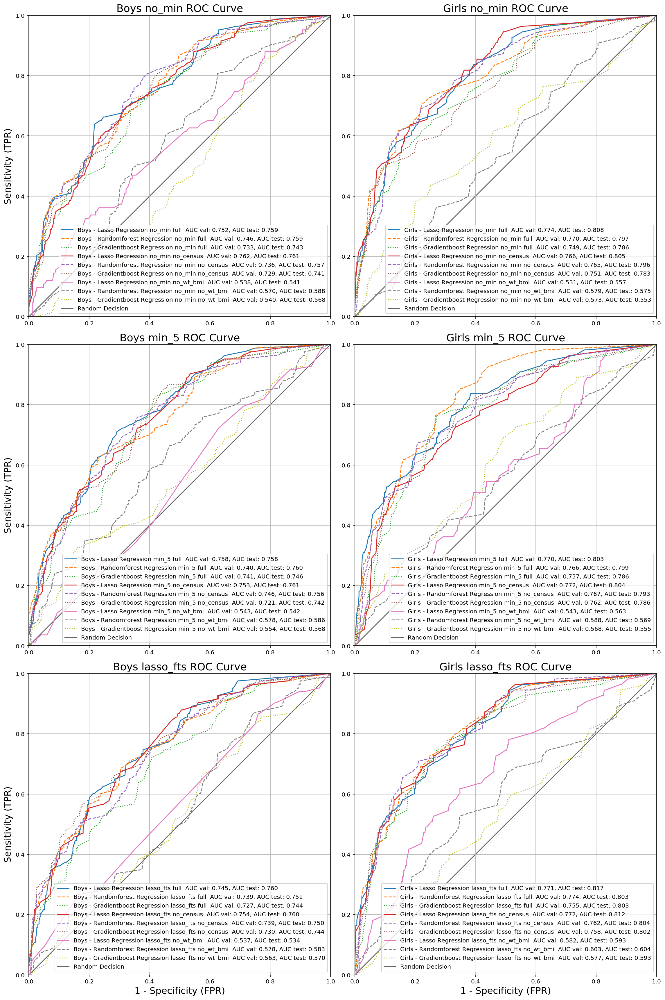

In [17]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['no_min','min_5','lasso_fts'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and all(ff not in t for ff in ('bmi_','wfl')) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    plt.title(f[0]+' '+f[1]+' ROC Curve', fontsize=18)
    if i%2 == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=16)
    if i in range(len(filters)-2,len(filters)):
        plt.xlabel('1 - Specificity (FPR)', fontsize=16)
    plt.grid(True)
    plt.tight_layout()

fig.savefig(temp_dir+'/all_final_multi_feature_regression_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

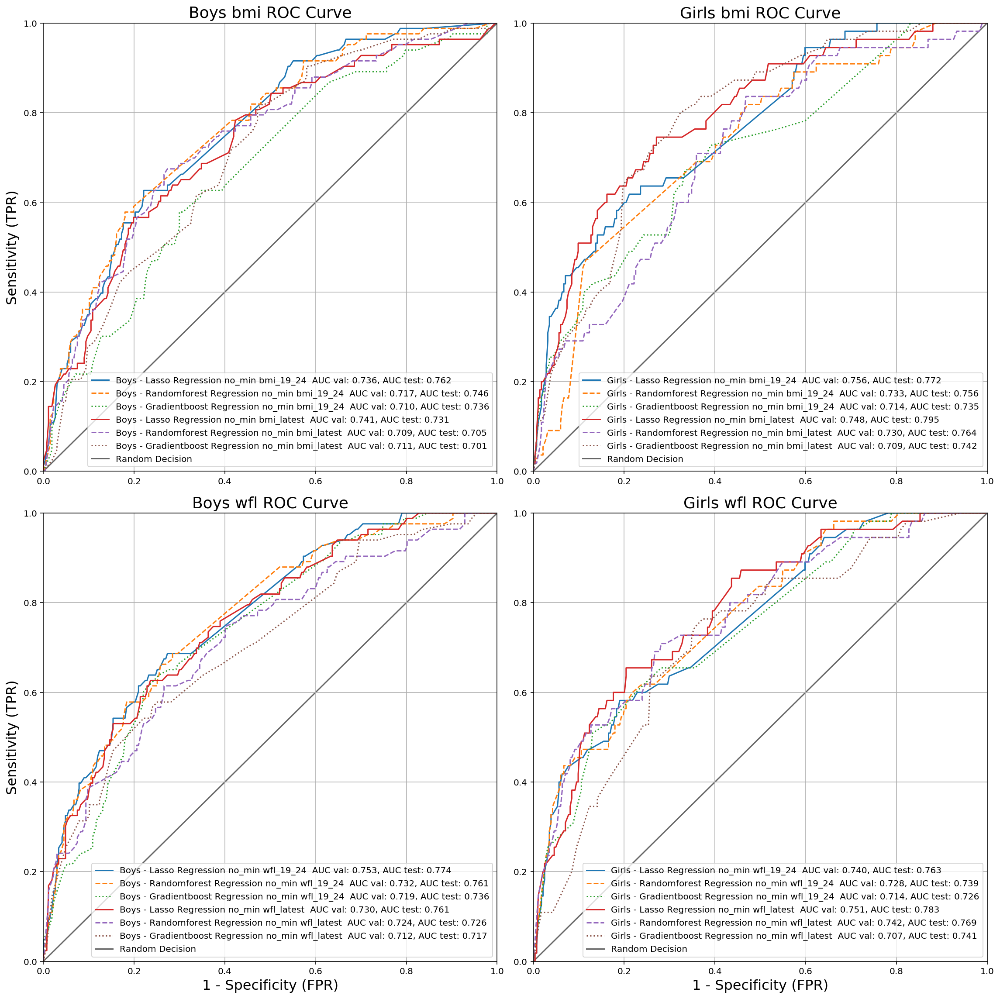

In [18]:
fig = plt.figure(figsize=(16,16))
filters = [(g,f) for f in ['bmi_','wfl'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(221+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    plt.title(f[0]+' '+f[1].strip('_')+' ROC Curve', fontsize=18)
    if i%2 == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=16)
    if i in range(len(filters)-2,len(filters)):
        plt.xlabel('1 - Specificity (FPR)', fontsize=16)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(temp_dir+'/all_final_single_feature_regression_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

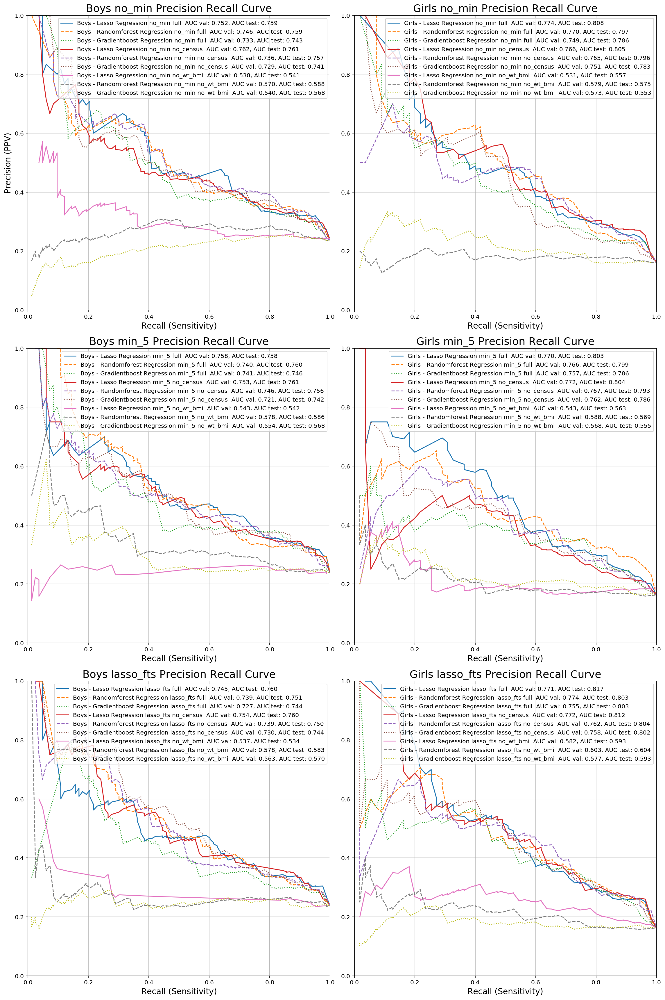

In [19]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['no_min','min_5','lasso_fts'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and all(ff not in t for ff in ('bmi_','wfl')) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            rec = results_list[ix][:,6]
            ppv = results_list[ix][:,5]
            index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
            plt.plot(rec[index:], ppv[index:], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.legend(fontsize=10)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.title(f[0]+' '+f[1]+' Precision Recall Curve', fontsize=18)
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=14)
    plt.xlabel('Recall (Sensitivity)', fontsize=14)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(temp_dir+'/all_final_multi_feature_regression_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

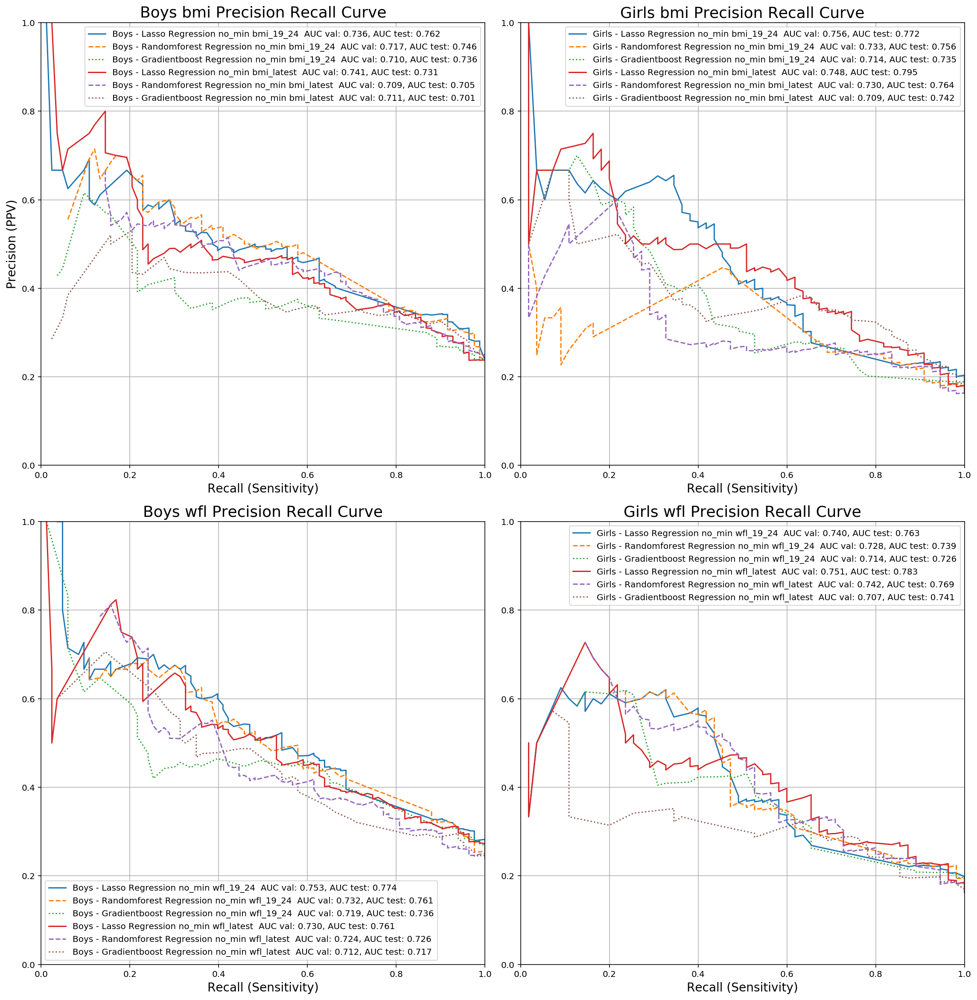

In [20]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['bmi_','wfl'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            rec = results_list[ix][:,6]
            ppv = results_list[ix][:,5]
            index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
            plt.plot(rec[index:], ppv[index:], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.legend(fontsize=10)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.title(f[0]+' '+f[1].strip('_')+' Precision Recall Curve', fontsize=18)
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=14)
    plt.xlabel('Recall (Sensitivity)', fontsize=14)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(temp_dir+'/all_final_single_feature_regression_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

### Plot the ROC and Precision Recall Curves for the best regression model and the best individual feature models

##### Note: these are the paper-ready figures (minus a few formatting bits)

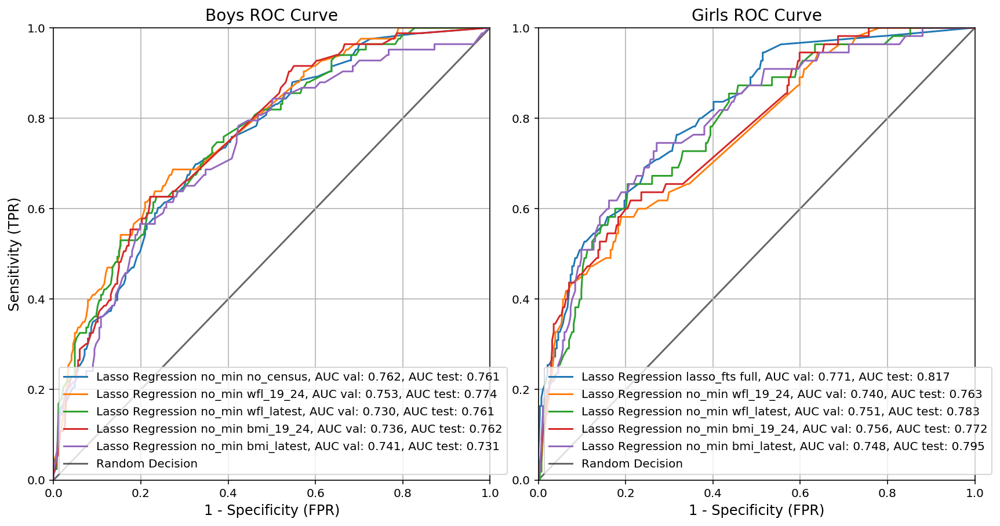

In [21]:
fig = plt.figure(figsize=(12,12))
# top_ix format: ['gender','age','index',title, auc, auc_low, auc_high,specificity,precision,recall]
for i,g in enumerate(['boys','girls']):
    plot_ix = [df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_') & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        ]
    ax = plt.subplot(221+i)
    title = g.title() + ' ROC Curve'
    plt.title(title, fontsize=14)
    for ix in plot_ix:
        w = 1.5
        s = title_list[ix].split(' - ')[1]
        end = s.find('@')
        lab = s[:end-1] + ', AUC val: {0:0.3f}, AUC test: {1:0.3f}'.format(auc_list[ix][0], auc_list[ix][2])
        plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linewidth=w, label=lab)
    plt.grid(True)
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    if i == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=12)
    plt.xlabel('1 - Specificity (FPR)', fontsize=12)
    plt.tight_layout()
            
fig.savefig(temp_dir+'/best_models_regression_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

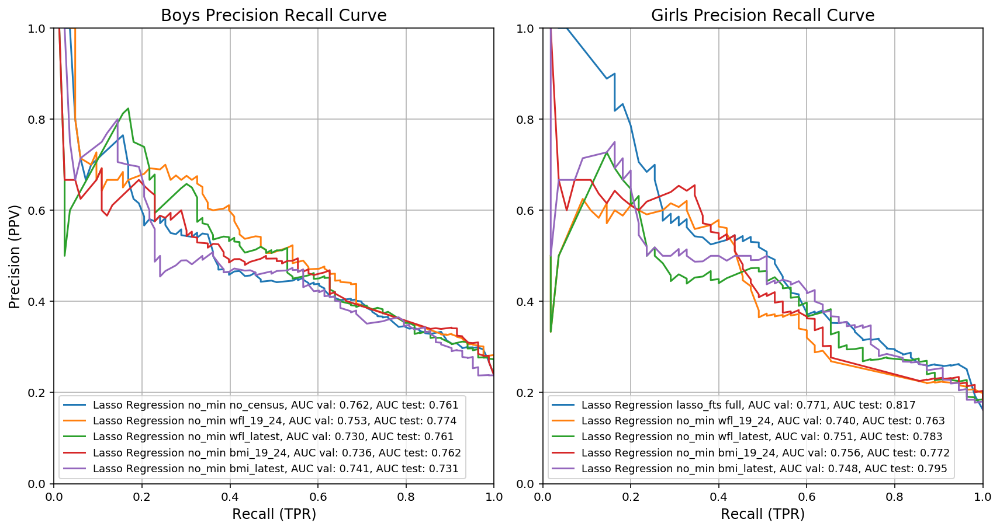

In [22]:
fig = plt.figure(figsize=(12,12))
# top_ix format: ['gender','age','index',title, auc, auc_low, auc_high,specificity,precision,recall]
for i,g in enumerate(['boys','girls']):
    plot_ix = [df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_') & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        ]
    ax = plt.subplot(221+i)
    title = g.title() + ' Precision Recall Curve'
    plt.title(title, fontsize=14)
    for ix in plot_ix:
        w = 1.5
        s = title_list[ix].split(' - ')[1]
        end = s.find('@')
        lab = s[:end-1] + ', AUC val: {0:0.3f}, AUC test: {1:0.3f}'.format(auc_list[ix][0], auc_list[ix][2])
        rec = results_list[ix][:,6]
        ppv = results_list[ix][:,5]
        index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
        plt.plot(rec[index:], ppv[index:], linewidth=w, label=lab)
    plt.grid(True)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.legend(fontsize=9, loc='lower left')
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=12)
    plt.xlabel('Recall (TPR)', fontsize=12)
    plt.tight_layout()
            
fig.savefig(temp_dir+'/best_models_regression_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

### Get the index for the best mult-feature model and display the top features for each of the best boys and girls models

In [23]:
for i,g in enumerate(['boys','girls']):
    if g=='boys':
        boys_ix=df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        print(g, boys_ix)
    else:
        girls_ix=df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        print(g, girls_ix)

boys 3
girls 69


In [24]:
boys_fts = pd.DataFrame(features_list[boys_ix], columns=feature_data_cols)
girls_fts = pd.DataFrame(features_list[girls_ix], columns=feature_data_cols)

In [25]:
print(title_list[boys_ix], auc_list[boys_ix][2], '(', auc_list[boys_ix][2] - auc_list[boys_ix][3], auc_list[boys_ix][2] + auc_list[boys_ix][3], ')')
boys_fts.head(20)

Boys - Lasso Regression no_min no_census @24 obese 0.761345607148 ( 0.759622935794 0.763068278501 )


,feature,significant,occurrences,auc,weight/importance,wt_low,wt_high,OR,OR_low,OR_high,OR_adj,OR_adj_low,OR_adj_high,Top1CorrFeat,Top1CorrVal,Top2CorrFeat,Top2CorrVal,Top3CorrFeat,Top3CorrVal,Top4CorrFeat,Top4CorrVal,Top5CorrFeat,Top5CorrVal,Top6CorrFeat,Top6CorrVal,Top7CorrFeat,Top7CorrVal,Top8CorrFeat,Top8CorrVal,Top9CorrFeat,Top9CorrVal,Top10CorrFeat,Top10CorrVal
0,Vital: BMI-gain0to24,True,1391,0.7487,0.0880,0.0641,0.1119,4.2470,3.3492,5.3855,1.0920,1.0662,1.1184,Newborn Diagnosis:9ccs191:Amnios dx,0.1086,Diagnosis:9ccs58:Ot nutrit dx,0.0963,Newborn Diagnosis:9ccs47:Ot bnign neo,0.0941,Diagnosis:9ccs106:Dysrhythmia,0.0870,Diagnosis:9ccs128:Asthma,0.0846,Diagnosis:9ccs235:Opn wnd head,0.0821,Diagnosis:9ccs95:Oth nerv dx,-0.0746,Diagnosis:9ccs246:FUO,0.0713,Diagnosis:9ccs243:Poisn nonmed,0.0706,Diagnosis:9ccs86:Cataract,-0.0655
1,Vital: BMI-latest,True,1672,0.7311,0.0852,0.0663,0.1041,4.4826,3.4961,5.7474,1.0890,1.0686,1.1098,Diagnosis:9ccs95:Oth nerv dx,-0.0854,Diagnosis:9ccs128:Asthma,0.0829,Diagnosis:9ccs138:Esophgeal dx,-0.0707,Diagnosis:9ccs243:Poisn nonmed,0.0626,Diagnosis:9ccs86:Cataract,-0.0586,Newborn Diagnosis:9ccs166:Oth male gen,-0.0585,Newborn Diagnosis:9ccs191:Amnios dx,0.0564,Diagnosis:9ccs214:GI cong anom,-0.0540,Diagnosis:9ccs133:Oth low resp,0.0531,MatDeliveryAge,-0.0528
2,Vital: Wt-avg19to24,True,1417,0.7489,0.0815,0.0622,0.1007,4.0670,3.2093,5.1540,1.0849,1.0642,1.1060,Newborn Diagnosis:9ccs191:Amnios dx,0.0859,Diagnosis:9ccs128:Asthma,0.0834,Diagnosis:9ccs2618:E Codes: Other specified an...,0.0832,Diagnosis:9ccs120:Hemmorhoids,0.0832,Newborn Diagnosis:9ccs219:Low birth wt,-0.0788,Newborn Diagnosis:9ccs47:Ot bnign neo,0.0721,Diagnosis:9ccs86:Cataract,-0.0647,Diagnosis:9ccs136:Teeth dx,-0.0631,Diagnosis:9ccs58:Ot nutrit dx,0.0631,Diagnosis:9ccs147:Anal/rectal,0.0630
3,Vital: Wt for Length ZScore-latest,True,1665,0.7607,0.0454,0.0285,0.0623,4.5113,3.5029,5.8101,1.0464,1.0289,1.0642,Diagnosis:9ccs128:Asthma,0.1020,Diagnosis:9ccs95:Oth nerv dx,-0.0830,Number of Visits,0.0732,Diagnosis:9ccs86:Cataract,-0.0713,Diagnosis:9ccs138:Esophgeal dx,-0.0707,Diagnosis:9ccs133:Oth low resp,0.0667,Diagnosis:9ccs92:Otitis media,0.0642,Diagnosis:9ccs122:Pneumonia,0.0609,Newborn Diagnosis:9ccs166:Oth male gen,-0.0561,Diagnosis:9ccs125:Bronchitis,0.0548
4,Vital: Wt-gain0to24,True,1411,0.7353,0.0448,0.0298,0.0599,3.9490,3.1183,5.0011,1.0458,1.0302,1.0617,Newborn Diagnosis:9ccs191:Amnios dx,0.0899,Diagnosis:9ccs128:Asthma,0.0837,Diagnosis:9ccs2618:E Codes: Other specified an...,0.0836,Diagnosis:9ccs120:Hemmorhoids,0.0836,Newborn Diagnosis:9ccs219:Low birth wt,-0.0749,Newborn Diagnosis:9ccs47:Ot bnign neo,0.0724,Diagnosis:9ccs106:Dysrhythmia,0.0714,Diagnosis:9ccs86:Cataract,-0.0649,Diagnosis:9ccs136:Teeth dx,-0.0648,Diagnosis:9ccs147:Anal/rectal,0.0634
5,Vital: BMI-avg19to24,True,1397,0.7620,0.0221,0.0085,0.0356,4.3440,3.4234,5.5121,1.0223,1.0085,1.0363,Newborn Diagnosis:9ccs191:Amnios dx,0.1054,Diagnosis:9ccs58:Ot nutrit dx,0.0940,Newborn Diagnosis:9ccs47:Ot bnign neo,0.0937,Diagnosis:9ccs128:Asthma,0.0838,Diagnosis:9ccs235:Opn wnd head,0.0818,Diagnosis:9ccs106:Dysrhythmia,0.0806,Diagnosis:9ccs95:Oth nerv dx,-0.0733,Diagnosis:9ccs243:Poisn nonmed,0.0721,Diagnosis:9ccs246:FUO,0.0709,Diagnosis:9ccs86:Cataract,-0.0655
6,Vital: Wt for Len Percentile-latest,True,1601,0.7511,0.0177,0.0103,0.0251,4.2551,3.2939,5.4968,1.0179,1.0104,1.0254,Diagnosis:9ccs128:Asthma,0.1017,Diagnosis:9ccs95:Oth nerv dx,-0.0745,Diagnosis:9ccs138:Esophgeal dx,-0.0734,MatDeliveryAge,-0.0643,Diagnosis:9ccs214:GI cong anom,-0.0639,Diagnosis:9ccs133:Oth low resp,0.0610,Diagnosis:9ccs243:Poisn nonmed,0.0609,Diagnosis:9ccs122:Pneumonia,0.0599,Diagnosis:9ccs246:FUO,0.0584,Diagnosis:9ccs92:Otitis media,0.0567
7,Vital: BMI-avg16to19,True,1293,0.7232,0.0176,0.0091,0.0260,3.1889,2.5265,4.0249,1.0177,1.0092,1.0264,Diagnosis:9ccs214:GI cong anom,-0.0743,Newborn Diagnosis:9ccs191:Amnios dx,0.0659,Diagnosis:9ccs143:Abdom hernia,0.0621,Diagnosis:9ccs235:Opn wnd head,0.0583,

In [26]:
print(title_list[girls_ix], auc_list[girls_ix][2], '(', auc_list[girls_ix][2] - auc_list[girls_ix][3], auc_list[girls_ix][2] + auc_list[girls_ix][3], ')')
girls_fts.head(20)

Girls - Lasso Regression lasso_fts full @24 obese 0.816852112676 ( 0.814430497946 0.819273727406 )


,feature,significant,occurrences,auc,weight/importance,wt_low,wt_high,OR,OR_low,OR_high,OR_adj,OR_adj_low,OR_adj_high,Top1CorrFeat,Top1CorrVal,Top2CorrFeat,Top2CorrVal,Top3CorrFeat,Top3CorrVal,Top4CorrFeat,Top4CorrVal,Top5CorrFeat,Top5CorrVal,Top6CorrFeat,Top6CorrVal,Top7CorrFeat,Top7CorrVal,Top8CorrFeat,Top8CorrVal,Top9CorrFeat,Top9CorrVal,Top10CorrFeat,Top10CorrVal
0,Maternal Vital: Wt-postPregnancy,True,666,0.5875,0.1331,0.1119,0.1543,1.8455,1.3364,2.5485,1.1423,1.1184,1.1668,Maternal Vital: Wt-postPregnancy,1.0000,MatDeliveryAge,0.1243,Census:Unemployment rate; Estimate; Population...,-0.0218,Number of Visits,-0.0036,Census:Percent; Estimate; Population 25 years ...,0.0012,,0,,0,,0,,0,,0
1,Vital: BMI-avg16to19,True,1269,0.7923,0.1132,0.0845,0.1419,3.1309,2.3848,4.1106,1.1199,1.0882,1.1524,Census:Percent; Estimate; Population 25 years ...,0.0464,Number of Visits,-0.0428,Maternal Vital: Wt-postPregnancy,0.0416,Census:Unemployment rate; Estimate; Population...,0.0257,MatDeliveryAge,-0.0210,,0,,0,,0,,0,,0
2,Vital: BMI-avg19to24,True,1354,0.7724,0.0986,0.0724,0.1249,4.0462,3.0618,5.3473,1.1037,1.0751,1.1331,Maternal Vital: Wt-postPregnancy,0.1044,Census:Percent; Estimate; Population 25 years ...,0.0451,Census:Unemployment rate; Estimate; Population...,0.0391,Number of Visits,-0.0344,MatDeliveryAge,-0.0127,,0,,0,,0,,0,,0
3,Vital: BMI-avg13to16,True,1286,0.7249,0.0952,0.0726,0.1178,3.8142,2.8888,5.0361,1.0998,1.0753,1.1250,Maternal Vital: Wt-postPregnancy,0.0620,Number of Visits,-0.0258,Census:Percent; Estimate; Population 25 years ...,0.0119,MatDeliveryAge,-0.0053,Census:Unemployment rate; Estimate; Population...,-0.0044,,0,,0,,0,,0,,0
4,Vital: BMI-latest,True,1621,0.7952,0.0843,0.0646,0.1041,4.7657,3.5275,6.4384,1.0880,1.0667,1.1097,Maternal Vital: Wt-postPregnancy,0.0982,Census:Percent; Estimate; Population 25 years ...,0.0465,Number of Visits,0.0356,Census:Unemployment rate; Estimate; Population...,0.0102,MatDeliveryAge,0.0006,,0,,0,,0,,0,,0
5,Vital: Wt for Length ZScore-latest,True,1612,0.7832,0.0823,0.0637,0.1009,4.3672,3.2337,5.8979,1.0858,1.0657,1.1062,Maternal Vital: Wt-postPregnancy,0.1057,Number of Visits,0.0698,Census:Percent; Estimate; Population 25 years ...,0.0526,Census:Unemployment rate; Estimate; Population...,0.0143,MatDeliveryAge,-0.0042,,0,,0,,0,,0,,0
6,Vital: BMI-gain0to24,True,1338,0.7783,0.0597,0.0345,0.0849,3.9232,2.9729,5.1774,1.0615,1.0351,1.0886,Maternal Vital: Wt-postPregnancy,0.1033,Census:Percent; Estimate; Population 25 years ...,0.0385,Census:Unemployment rate; Estimate; Population...,0.0338,Number of Visits,-0.0309,MatDeliveryAge,-0.0103,,0,,0,,0,,0,,0
7,Vital: Wt for Length ZScore-avg3to5,True,1299,0.6044,0.0535,0.0419,0.0651,1.9020,1.4550,2.4863,1.0550,1.0428,1.0673,Maternal Vital: Wt-postPregnancy,0.0514,Census:Unemployment rate; Estimate; Population...,-0.0462,Census:Percent; Estimate; Population 25 years ...,0.0234,Number of Visits,-0.0134,MatDeliveryAge,-0.0025,,0,,0,,0,,0,,0
8,Vital: Wt-avg16to19,True,1298,0.7356,0.0499,0.0288,0.0709,3.0603,2.3314,4.0170,1.0511,1.0293,1.0735,Maternal Vital: Wt-postPregnancy,0.0925,Census:Unemployment rate; Estimate; Population...,0.0446,MatDeliveryAge,-0.0399,Census:Percent; Estimate; Population 25 years ...,0.0142,Number of Visits,-0.0139,,0,,0,,0,,0,,0
9,Vital: Wt-latest,True,1626,0.7611,0.0486,0.0382,0.0591,3.5002,2.5707,4.7660,1.0498,1.0389,1.0608,Number of Visits,0.3771,Maternal Vital: Wt-postPregnancy,0.1392,Census:Percent; Estimate; Population 25 years ...,0.0570,MatDeliveryAge,0.0481,Census:Unemployment rate; Estimate; Population...,0.0055,,0,,0,,0,,0,,0


### Print the AUC and explained variance w/CI for the top models

In [27]:
print(title_list[boys_ix], 'AUC:', auc_list[boys_ix][2], '(', auc_list[boys_ix][2] - auc_list[boys_ix][3], auc_list[boys_ix][2] + auc_list[boys_ix][3], ')')
print(title_list[boys_ix], 'Explained Variance', metric3_list[boys_ix][2], '(', metric3_list[boys_ix][2] - metric3_list[boys_ix][3], metric3_list[boys_ix][2] + metric3_list[boys_ix][3], ')')

Boys - Lasso Regression no_min no_census @24 obese AUC: 0.761345607148 ( 0.759622935794 0.763068278501 )
Boys - Lasso Regression no_min no_census @24 obese Explained Variance 0.281326712502 ( 0.277485936557 0.285167488446 )


In [28]:
print(title_list[girls_ix], 'AUC:', auc_list[girls_ix][2], '(', auc_list[girls_ix][2] - auc_list[girls_ix][3], auc_list[girls_ix][2] + auc_list[girls_ix][3], ')')
print(title_list[girls_ix], 'Explained Variance', metric3_list[girls_ix][2], '(', metric3_list[girls_ix][2] - metric3_list[girls_ix][3], metric3_list[girls_ix][2] + metric3_list[girls_ix][3], ')')

Girls - Lasso Regression lasso_fts full @24 obese AUC: 0.816852112676 ( 0.814430497946 0.819273727406 )
Girls - Lasso Regression lasso_fts full @24 obese Explained Variance 0.342658179985 ( 0.336404404967 0.348911955003 )


## Print the sensitivity/specificity/PPV statistics around the key points

In [29]:
boys_results = pd.DataFrame(results_list[boys_ix], columns=results_cols)
boys_results[(boys_results.sensitivity > 0.75) & (boys_results.sensitivity < 0.85)]

,threshold,tp,tn,fn,fp,ppv,sensitivity,specificity,accuracy,f1,mcc,pos,neg
84,-0.0516,63.0000,158.0000,20.0000,109.0000,0.3663,0.7590,0.5918,0.6314,0.4941,0.0038,172.0000,178.0000
85,-0.0552,63.0000,157.0000,20.0000,110.0000,0.3642,0.7590,0.5880,0.6286,0.4922,0.0037,173.0000,177.0000
86,-0.0664,65.0000,143.0000,18.0000,124.0000,0.3439,0.7831,0.5356,0.5943,0.4779,0.0032,189.0000,161.0000
87,-0.0695,66.0000,142.0000,17.0000,125.0000,0.3455,0.7952,0.5318,0.5943,0.4818,0.0032,191.0000,159.0000
88,-0.0860,67.0000,137.0000,16.0000,130.0000,0.3401,0.8072,0.5131,0.5829,0.4786,0.0031,197.0000,153.0000
89,-0.0892,68.0000,136.0000,15.0000,131.0000,0.3417,0.8193,0.5094,0.5829,0.4823,0.0032,199.0000,151.0000
90,-0.1041,69.0000,131.0000,14.0000,136.0000,0.3366,0.8313,0.4906,0.5714,0.4792,0.0031,205.0000,145.0000
91,-0.1048,69.0000,130.0000,14.0000,137.0000,0.3350,0.8313,0.4869,0.5686,0.4775,0.0030,206.0000,144.0000
92,-0.1102,70.0000,126.0000,13.0000,141.0000,0.3318,0.8434,0.4719,0.5600,0.4762,0.0030,211.0000,139.0000
93,-0.1133,70.0000,125.0000,13.0000,142.0000,0.3302,0.8434,0.4682,0.5571,0.4746,0.0029,212.0000,138.0000


In [30]:
boys_results[(boys_results.sensitivity > 0.55) & (boys_results.sensitivity < 0.65)]

,threshold,tp,tn,fn,fp,ppv,sensitivity,specificity,accuracy,f1,mcc,pos,neg
52,0.1934,46.0000,211.0000,37.0000,56.0000,0.4510,0.5542,0.7903,0.7343,0.4973,0.0070,102.0000,248.0000
53,0.1914,46.0000,210.0000,37.0000,57.0000,0.4466,0.5542,0.7865,0.7314,0.4946,0.0068,103.0000,247.0000
54,0.1913,47.0000,210.0000,36.0000,57.0000,0.4519,0.5663,0.7865,0.7343,0.5027,0.0070,104.0000,246.0000
55,0.1889,47.0000,209.0000,36.0000,58.0000,0.4476,0.5663,0.7828,0.7314,0.5000,0.0068,105.0000,245.0000
56,0.1763,48.0000,206.0000,35.0000,61.0000,0.4404,0.5783,0.7715,0.7257,0.5000,0.0065,109.0000,241.0000
57,0.1712,48.0000,205.0000,35.0000,62.0000,0.4364,0.5783,0.7678,0.7229,0.4974,0.0063,110.0000,240.0000
58,0.1647,49.0000,205.0000,34.0000,62.0000,0.4414,0.5904,0.7678,0.7257,0.5052,0.0065,111.0000,239.0000
59,0.1619,49.0000,204.0000,34.0000,63.0000,0.4375,0.5904,0.7640,0.7229,0.5026,0.0063,112.0000,238.0000
60,0.1588,50.0000,203.0000,33.0000,64.0000,0.4386,0.6024,0.7603,0.7229,0.5076,0.0064,114.0000,236.0000
61,0.1491,50.0000,202.0000,33.0000,65.0000,0.4348,0.6024,0.7566,0.7200,0.5051,0.0062,115.0000,235.0000


In [31]:
boys_results[(boys_results.sensitivity > 0.1) & (boys_results.sensitivity < 0.3)]

,threshold,tp,tn,fn,fp,ppv,sensitivity,specificity,accuracy,f1,mcc,pos,neg
7,0.4884,13.0000,263.0000,70.0000,4.0000,0.7647,0.1566,0.9850,0.7886,0.2600,0.0794,17.0000,333.0000
8,0.4610,14.0000,261.0000,69.0000,6.0000,0.7000,0.1687,0.9775,0.7857,0.2718,0.0508,20.0000,330.0000
9,0.4570,14.0000,260.0000,69.0000,7.0000,0.6667,0.1687,0.9738,0.7829,0.2692,0.0415,21.0000,329.0000
10,0.4508,15.0000,258.0000,68.0000,9.0000,0.6250,0.1807,0.9663,0.7800,0.2804,0.0314,24.0000,326.0000
11,0.4428,16.0000,257.0000,67.0000,10.0000,0.6154,0.1928,0.9625,0.7800,0.2936,0.0288,26.0000,324.0000
12,0.4258,17.0000,255.0000,66.0000,12.0000,0.5862,0.2048,0.9551,0.7771,0.3036,0.0236,29.0000,321.0000
13,0.4253,17.0000,254.0000,66.0000,13.0000,0.5667,0.2048,0.9513,0.7743,0.3009,0.0210,30.0000,320.0000
14,0.4240,18.0000,254.0000,65.0000,13.0000,0.5806,0.2169,0.9513,0.7771,0.3158,0.0223,31.0000,319.0000
15,0.4163,19.0000,253.0000,64.0000,14.0000,0.5758,0.2289,0.9476,0.7771,0.3276,0.0211,33.0000,317.0000
16,0.4148,20.0000,253.0000,63.0000,14.0000,0.5882,0.2410,0.9476,0.7800,0.3419,0.0222,34.0000,316.0000


In [32]:
girls_results = pd.DataFrame(results_list[girls_ix], columns=results_cols)
girls_results[(girls_results.sensitivity > 0.75) & (girls_results.sensitivity < 0.85)]

,threshold,tp,tn,fn,fp,ppv,sensitivity,specificity,accuracy,f1,mcc,pos,neg
58,0.1352,42.0000,194.0000,13.0000,90.0000,0.3182,0.7636,0.6831,0.6962,0.4492,0.0047,132.0000,207.0000
59,0.1281,42.0000,193.0000,13.0000,91.0000,0.3158,0.7636,0.6796,0.6932,0.4468,0.0046,133.0000,206.0000
60,0.0774,43.0000,183.0000,12.0000,101.0000,0.2986,0.7818,0.6444,0.6667,0.4322,0.0040,144.0000,195.0000
61,0.0756,43.0000,182.0000,12.0000,102.0000,0.2966,0.7818,0.6408,0.6637,0.4300,0.0040,145.0000,194.0000
62,0.0664,44.0000,179.0000,11.0000,105.0000,0.2953,0.8000,0.6303,0.6578,0.4314,0.0040,149.0000,190.0000
63,0.0649,44.0000,178.0000,11.0000,106.0000,0.2933,0.8000,0.6268,0.6549,0.4293,0.0039,150.0000,189.0000
64,0.0448,45.0000,171.0000,10.0000,113.0000,0.2848,0.8182,0.6021,0.6372,0.4225,0.0036,158.0000,181.0000
65,0.0428,45.0000,170.0000,10.0000,114.0000,0.2830,0.8182,0.5986,0.6342,0.4206,0.0036,159.0000,180.0000
66,0.0409,46.0000,170.0000,9.0000,114.0000,0.2875,0.8364,0.5986,0.6372,0.4279,0.0037,160.0000,179.0000
67,0.0407,46.0000,169.0000,9.0000,115.0000,0.2857,0.8364,0.5951,0.6342,0.4259,0.0037,161.0000,178.0000


In [33]:
girls_results[(girls_results.sensitivity > 0.55) & (girls_results.sensitivity < 0.65)]

,threshold,tp,tn,fn,fp,ppv,sensitivity,specificity,accuracy,f1,mcc,pos,neg
38,0.4820,31.0000,242.0000,24.0000,42.0000,0.4247,0.5636,0.8521,0.8053,0.4844,0.0101,73.0000,266.0000
39,0.4790,31.0000,241.0000,24.0000,43.0000,0.4189,0.5636,0.8486,0.8024,0.4806,0.0097,74.0000,265.0000
40,0.4686,32.0000,239.0000,23.0000,45.0000,0.4156,0.5818,0.8415,0.7994,0.4848,0.0094,77.0000,262.0000
41,0.4588,32.0000,238.0000,23.0000,46.0000,0.4103,0.5818,0.8380,0.7965,0.4812,0.0091,78.0000,261.0000
42,0.3724,33.0000,229.0000,22.0000,55.0000,0.3750,0.6000,0.8063,0.7729,0.4615,0.0072,88.0000,251.0000
43,0.3700,33.0000,228.0000,22.0000,56.0000,0.3708,0.6000,0.8028,0.7699,0.4583,0.0070,89.0000,250.0000
44,0.3661,34.0000,228.0000,21.0000,56.0000,0.3778,0.6182,0.8028,0.7729,0.4690,0.0073,90.0000,249.0000
45,0.3658,34.0000,227.0000,21.0000,57.0000,0.3736,0.6182,0.7993,0.7699,0.4658,0.0071,91.0000,248.0000
46,0.3588,35.0000,227.0000,20.0000,57.0000,0.3804,0.6364,0.7993,0.7729,0.4762,0.0074,92.0000,247.0000
47,0.3568,35.0000,226.0000,20.0000,58.0000,0.3763,0.6364,0.7958,0.7699,0.4730,0.0072,93.0000,246.0000


In [34]:
girls_results[(girls_results.sensitivity > 0.15) & (girls_results.sensitivity < 0.3)]

,threshold,tp,tn,fn,fp,ppv,sensitivity,specificity,accuracy,f1,mcc,pos,neg
4,1.4425,9.0000,283.0000,46.0000,1.0000,0.9000,0.1636,0.9965,0.8614,0.2769,0.3768,10.0000,329.0000
5,1.4385,9.0000,282.0000,46.0000,2.0000,0.8182,0.1636,0.9930,0.8584,0.2727,0.1763,11.0000,328.0000
6,1.4096,10.0000,282.0000,45.0000,2.0000,0.8333,0.1818,0.9930,0.8614,0.2985,0.1884,12.0000,327.0000
7,1.4058,11.0000,281.0000,44.0000,3.0000,0.7857,0.2000,0.9894,0.8614,0.3188,0.1265,14.0000,325.0000
8,1.3093,12.0000,279.0000,43.0000,5.0000,0.7059,0.2182,0.9824,0.8584,0.3333,0.0734,17.0000,322.0000
9,1.2740,13.0000,278.0000,42.0000,6.0000,0.6842,0.2364,0.9789,0.8584,0.3514,0.0624,19.0000,320.0000
10,1.2204,14.0000,278.0000,41.0000,6.0000,0.7000,0.2545,0.9789,0.8614,0.3733,0.0659,20.0000,319.0000
11,1.2031,14.0000,277.0000,41.0000,7.0000,0.6667,0.2545,0.9754,0.8584,0.3684,0.0545,21.0000,318.0000
12,1.1287,15.0000,274.0000,40.0000,10.0000,0.6000,0.2727,0.9648,0.8525,0.3750,0.0365,25.0000,314.0000
13,1.0402,15.0000,273.0000,40.0000,11.0000,0.5769,0.2727,0.9613,0.8496,0.3704,0.0322,26.0000,313.0000


### Get the PPV for applying the grant selection criteria to the test data

In [35]:
# list items: [x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers]
boys_data_comp = data['boys']['no_min']['full']['data']
girls_data_comp = data['girls']['lasso_fts']['full']['data']

# We are starting with the unnormalized data and filtering that to include the test set for both boys and girls
xtest_boys = x1[boys_data_comp[4],:][test_ix_boys,:]
incl_ix_boys = (xtest_boys[:,feature_headers.index('MatDeliveryAge')] >= 18) & \
                       (xtest_boys[:,feature_headers.index('Maternal-ethnicity:HISPANIC/LATINO')] > 0) & \
                       (xtest_boys[:,feature_headers.index('Maternal Diagnosis:9ccs195:Ot compl bir')] == 0)
xtest_boys = xtest_boys[incl_ix_boys,:]
ytest_boys = y1[boys_data_comp[4]][test_ix_boys][incl_ix_boys]
ytestlabel_boys = y1label[boys_data_comp[4],label_ix['obese']][test_ix_boys][incl_ix_boys]

xtest_girls = x1[girls_data_comp[4],:][test_ix_girls,:]
incl_ix_girls = (xtest_girls[:,feature_headers.index('MatDeliveryAge')] >= 18) & \
                       (xtest_girls[:,feature_headers.index('Maternal-ethnicity:HISPANIC/LATINO')] > 0) & \
                       (xtest_girls[:,feature_headers.index('Maternal Diagnosis:9ccs195:Ot compl bir')] == 0)
xtest_girls = xtest_girls[incl_ix_girls,:]
ytest_girls = y1[girls_data_comp[4]][test_ix_girls][incl_ix_girls]
ytestlabel_girls = y1label[girls_data_comp[4],label_ix['obese']][test_ix_girls][incl_ix_girls]


In [36]:
boys_ppv = ytestlabel_boys.sum() / incl_ix_boys.sum()
girls_ppv = ytestlabel_girls.sum() / incl_ix_girls.sum()

print('Boys PPV w/inclusion criteria: {0:4.3f}'.format(boys_ppv))
print('Girls PPV w/inclusion criteria: {0:4.3f}'.format(girls_ppv))


Boys PPV w/inclusion criteria: 0.257
Girls PPV w/inclusion criteria: 0.183


In [37]:
boys_fts.to_csv(temp_dir+'/top_boys_features.csv', index=False)
girls_fts.to_csv(temp_dir+'/top_girls_features.csv', index=False)

In [38]:
boys_results.to_csv(temp_dir+'/top_boys_results.csv', index=False)
girls_results.to_csv(temp_dir+'/top_girls_results.csv', index=False)